In [404]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import matplotlib.dates as mdates
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

231


In [405]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [406]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [407]:
def forecastRRA(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    acoef = [0.00022402, 0.01432195]
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/((acoef[0]*t+acoef[1]))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    ax2.plot(dateSP[t+8], waveform_1, dtt, allmodel, dtt, allmodel_1) 
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.set_ylim([0,1.1*max(max(waveform_1),max(allmodel*(1+3*diffStd0)))])
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    #formatter = mdates.ConciseDateFormatter(locator)
    locator = mdates.AutoDateLocator()
    formatter = mdates.ConciseDateFormatter(locator)
    formatter.formats = ['%y',  # ticks are mostly years
                         '%b',       # ticks are mostly months
                         '%d',       # ticks are mostly days
                         '%H:%M',    # hrs
                         '%H:%M',    # min
                         '%S.%f', ]  # secs
    # these are mostly just the level above...
    formatter.zero_formats = [''] + formatter.formats[:-1]
    # ...except for ticks that are mostly hours, then it is nice to have
    # month-day:
    formatter.zero_formats[3] = '%d-%b'

    formatter.offset_formats = ['',
                                '%Y',
                                '%b %Y',
                                '%d %b %Y',
                                '%d %b %Y',
                                '%d %b %Y %H:%M', ]
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t[-1],tt+8,allmodel 

def forecast2RRA(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a) 
    acoef = [0.00022485, 0.01425859]#[0.00022468, 0.01427208]
    def model(t, coeffs):
        coeffsUS=coeffs2#[5.34712379e+04,  1.87189938e+01, -9.10329896e+01,  2.63753359e-03]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+model0(t, coeffsUS))/(acoef[0]*t+acoef[1])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/(acoef[0]*t+acoef[1])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    #x0 = np.array([5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03], dtype=float)
    x0 = np.array([5.40599372e+03, 4.02558326e+00, 9.34289930e+01, 9.87224726e-01], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
        
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    ax2.plot(dateSP[t+8], waveform_1, dtt, allmodel,dtt, allmodel_1)
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t+8,allmodel 

def forecast2RRD(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases',amc=1.0):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    dtt = pd.to_datetime(dtt.values)
    #years = mdates.YearLocator()   # every year
    #months = mdates.MonthLocator()  # every month
    #years_fmt = mdates.DateFormatter('%Y')
    # format the ticks
    #ax2.xaxis.set_major_locator(years)
    #ax2.xaxis.set_major_formatter(years_fmt)
    #ax2.xaxis.set_minor_locator(months)
    #ax2.format_xdata = mdates.DateFormatter('%Y-%m-%d')
    ax2.plot(dateSP[t[:]+8], waveform_1,dtt, allmodel,dtt, allmodel_1)
    #print (dtt)
    #print (dateSP)
    #print (dateSP[t+8])
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
#    locator = mdates.AutoDateLocator()
#    formatter = mdates.ConciseDateFormatter(locator)
#    formatter.formats = ['%y',  # ticks are mostly years
#                         '%b',       # ticks are mostly months
#                         '%d',       # ticks are mostly days
#                         '%H:%M',    # hrs
#                         '%H:%M',    # min
#                         '%S.%f', ]  # secs
#    # these are mostly just the level above...
#    formatter.zero_formats = [''] + formatter.formats[:-1]
#    # ...except for ticks that are mostly hours, then it is nice to have
#    # month-day:
#    formatter.zero_formats[3] = '%d-%b'
#
#    formatter.offset_formats = ['',
#                                '%Y',
#                                '%b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y %H:%M', ]
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(dateSP[t[:-1]+8], np.diff(waveform_1),dtt[:-1], np.diff(allmodel))
    ax3.plot(dateSP[t[-1]+8], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    locator3 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter3 = mdates.ConciseDateFormatter(locator3)
    ax3.xaxis.set_major_locator(locator3)
    ax3.xaxis.set_major_formatter(formatter3)
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, date')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    #z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ds = 35
    ds = int(ds*amc)
    ttt20=np.array([np.sum(np.diff(allmodel[-ds+i:i])) for i in range(ds,len(allmodel))])
    ttt19=np.array([np.sum(np.diff(allmodel_1[-ds+i:i])) for i in range(ds,len(allmodel_1))])
    ax4.plot(dateSP[t[:]+8], dfSP["active"][:],dtt[ds:], ttt20,dtt[ds:], ttt19)
    #ax4.plot(dateSP[t[:-3]+8],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    #ax4.fill_between(dateSP[t[:-1]+8], 0.8078285535018691, 1.,color='r',alpha=0.2)
    diffStd0a = np.std(1-dfSP["active"].values[ds:]/ttt20[:len(dfSP["active"].values[ds:])])
    print ('diffStd0a',diffStd0a)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+2*diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+3*diffStd0a), alpha=0.2)
    ax4.plot(dateSP[t[-1]+8],dfSP["active"].tail(1).values[0],'ro')
    loc = 'upper left'
    if Cntr=='USA' or Cntr=='Indonesia' or Cntr=='World':
        loc = 'upper right' 
    ax4.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc=loc) 
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('Total actives')
    ax4.set_xlabel('t, days')
    ax4.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    ax4.yaxis.tick_right()
    ax4.set_ylim([0,max(max(dfSP['active'].values),max(ttt20*(1+3*diffStd0a)))])
    locator4 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter4 = mdates.ConciseDateFormatter(locator4)
    ax4.xaxis.set_major_locator(locator4)
    ax4.xaxis.set_major_formatter(formatter4)
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(dateSP[xt],yt,label=Cntr1)
    ax5.plot(dtt[range(x_pred12t)],y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(dtt[range(x_pred12t0)],y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(dateSP[vL], color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    locator5 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter5 = mdates.ConciseDateFormatter(locator5)
    ax5.xaxis.set_major_locator(locator5)
    ax5.xaxis.set_major_formatter(formatter5)
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


In [429]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [430]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [431]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [432]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,13249685,6404.0,376284.0,645.0,8408516.0,"+4,361",4464885,24370.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,15009108,9821.0,264937.0,149.0,13390798.0,"+19,108",1353373,24514.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,10325074,112.0,309404.0,6.0,9311461.0,323,704209,17410.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1975039,NaN,47141.0,NaN,1660128.0,NaN,267770,2609.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [433]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
229,NaN,Total:,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
230,NaN,Total:,1975039,NaN,47141.0,NaN,1660128.0,NaN,267770,2609.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
231,NaN,Total:,42119,20.0,994.0,NaN,32903.0,NaN,8222,26.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
232,NaN,Total:,721,NaN,15.0,NaN,659.0,NaN,47,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
233,NaN,European Union,9217952,11932.0,213626.0,305.0,2503179.0,NaN,4444102,24247.0,20702.844152,479.788329,132440132.0,297450.823381,NaN,Europe,NaN,NaN,NaN


In [434]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,13249685,6404.0,376284.0,645.0,8408516.0,"+4,361",4464885,24370.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,15009108,9821.0,264937.0,149.0,13390798.0,"+19,108",1353373,24514.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,10325074,112.0,309404.0,6.0,9311461.0,323,704209,17410.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1975039,NaN,47141.0,NaN,1660128.0,NaN,267770,2609.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [435]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
94,88.0,Lithuania,33387,0.0,266.0,0.0,7697.0,0,25424,87.0,12330.0,98.0,1176612.0,434523.0,"2,707,822",Europe,81,"10,180",2


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:816: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


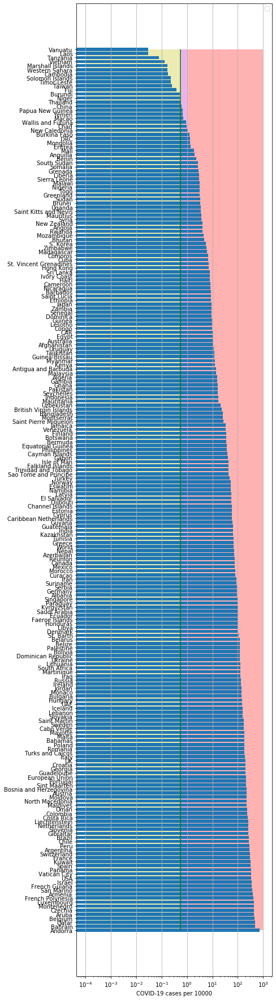

In [436]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:816: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


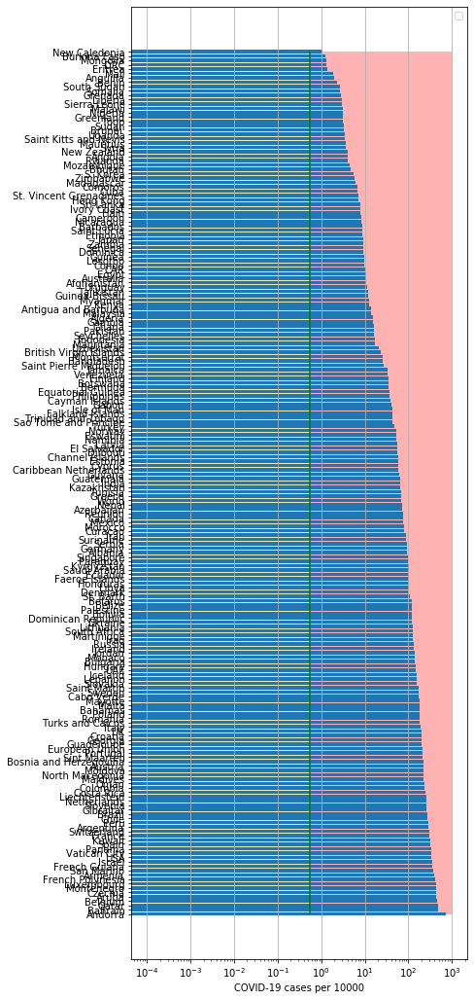

In [437]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

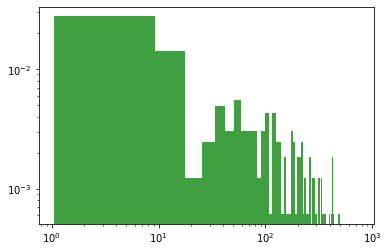

In [438]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [439]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date    cases  active    death
269 2020-11-10  1443997       0  39756.0
270 2020-11-11  1463093       0  40105.0
271 2020-11-12  1484868       0  40461.0
272 2020-11-13  1492608       0  40769.0
273 2020-11-14  1492608       0  40769.0
GB
           date    cases  active    death
258 2020-11-10  1233775       0  49770.0
259 2020-11-11  1256725       0  50365.0
260 2020-11-12  1290195       0  50928.0
261 2020-11-13  1317496       0  51304.0
262 2020-11-14  1344356       0  51766.0
IT
           date    cases  active    death
261 2020-11-10   995463  590110  42330.0
262 2020-11-11  1028424  613358  42953.0
263 2020-11-12  1066401  635054  43589.0
264 2020-11-13  1107303  663926  44139.0
265 2020-11-14  1144552  688435  44683.0
LT
           date    cases  active  death      tests
246 2020-11-10  28262.0   21419  235.0  1132514.0
247 2020-11-11  29812.0   22382  244.0  1146969.0
248 2020-11-12  31878.0   24284  253.0  1162033.0
249 2020-11-13  33387.0   25322  266.0  117661

           date    cases  active  death
248 2020-11-10  23710.0    9418  198.0
249 2020-11-11  24505.0   10205  206.0
250 2020-11-12  25218.0   10209  211.0
251 2020-11-13  25931.0   10284  219.0
252 2020-11-14  26544.0   10894  222.0
TH
           date   cases  active  death
257 2020-11-10  3847.0   102.0   60.0
258 2020-11-11  3852.0    99.0   60.0
259 2020-11-12  3861.0   104.0   60.0
260 2020-11-13  3866.0    99.0   60.0
261 2020-11-14  3874.0    99.0   60.0
IE
           date   cases  active    death
246 2020-11-10  444348   53846  14761.0
247 2020-11-11  452291   55274  14933.0
248 2020-11-12  457735   57604  15037.0
249 2020-11-13  463007   59765  15148.0
250 2020-11-14  463007   59765  15148.0
MX
           date    cases  active    death
247 2020-11-10   978531  156843  95842.0
248 2020-11-11   986177  158279  96430.0
249 2020-11-12   991835  158582  97056.0
250 2020-11-13   997393  158429  97624.0
251 2020-11-14  1003253  159633  98259.0
PM
           date   cases   active   d

In [440]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [441]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5904661523536794
intercept: 1.554507467711351
slope: [0.01688687]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


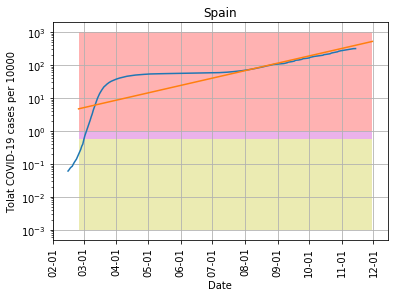

In [442]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-11-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [443]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5610185853174313
intercept: -0.00812633177858757
slope: [0.02282785]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


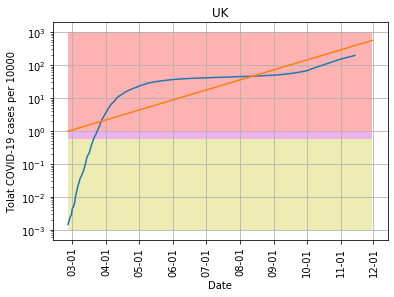

In [444]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-11-30', "pictures/coronaGB.png", model1, 'UK',1000)

In [445]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 7.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6558472065389356
intercept: 1.599317920207068
slope: [-0.00334325]


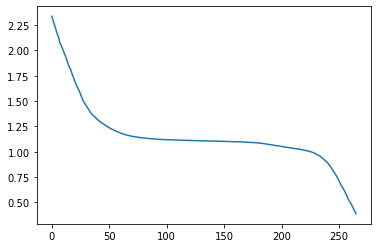

In [446]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


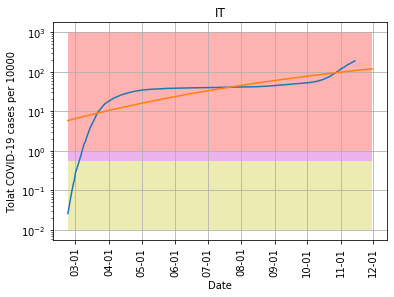

In [447]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-11-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [448]:
cs=y_pred11[-1]/10000.*populationIT

In [449]:
cs

719591.2964648431

In [450]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6404821181536859
intercept: -0.10728650216406455
slope: [0.01649845]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


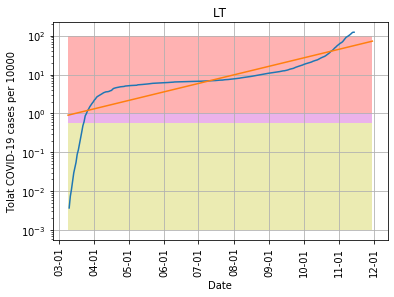

In [451]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-11-30', "pictures/coronaLT.png", model1, 'LT',100)

In [452]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7414227087887968
intercept: -1.974218903622213
slope: [0.03082715]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


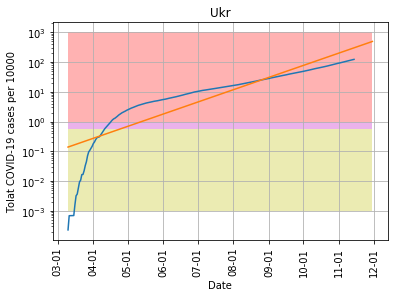

In [453]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-11-30', "pictures/coronaUkr.png", model11, 'Ukr',1000)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


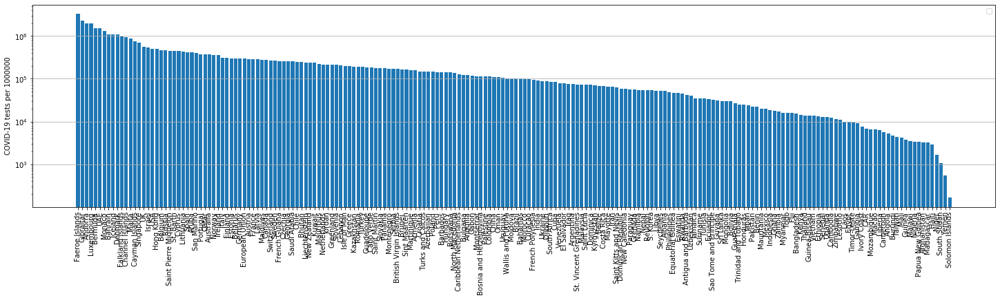

In [454]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [455]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6099877694124474
intercept: 0.5493016711736245
slope: [0.02534181]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


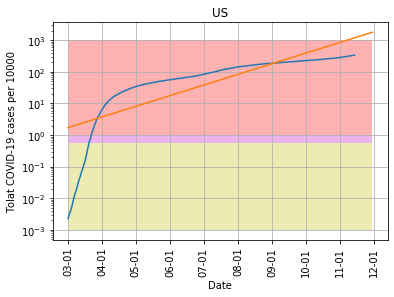

In [456]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-11-30', "pictures/coronaUS.png", model11, 'US',1000)

In [457]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
233  European Union  0.023175


Text(0.5, 1.0, 'Death rate')

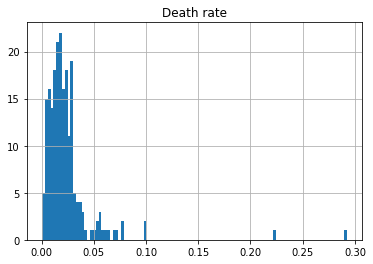

In [458]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

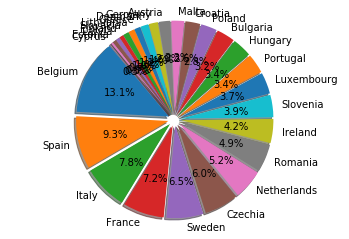

In [459]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [460]:
dfTTh.head()

,Country,Deathsper1Mpop
24,Belgium,1232.0
12,Spain,872.0
16,Italy,739.0
10,France,677.0
44,Sweden,609.0


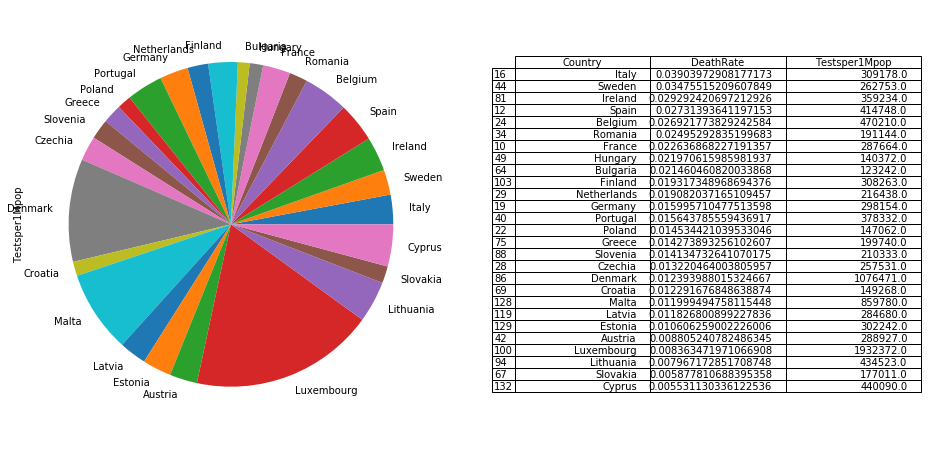

In [461]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

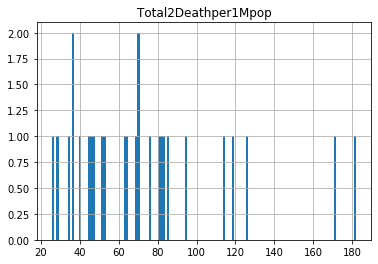

In [462]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [463]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
10,France,29920.0,677.0
12,Spain,31920.0,872.0
16,Italy,18941.0,739.0
19,Germany,9405.0,150.0
22,Poland,18269.0,266.0


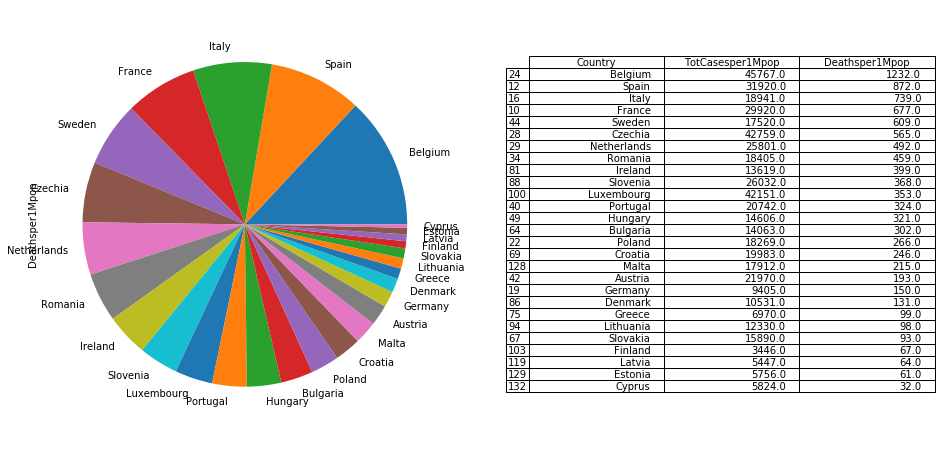

In [464]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [465]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,13249685,6404.0,376284.0,645.0,8408516.0,"+4,361",4464885,24370.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,15009108,9821.0,264937.0,149.0,13390798.0,"+19,108",1353373,24514.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,10325074,112.0,309404.0,6.0,9311461.0,323,704209,17410.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1975039,0.0,47141.0,0.0,1660128.0,0,267770,2609.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [466]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
10,France,0.104010
12,Spain,0.076962
16,Italy,0.061262
19,Germany,0.031544
22,Poland,0.124227


In [467]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
     Czechia             0.166034
     Croatia             0.133873
      Poland             0.124227
    Slovenia             0.123766
 Netherlands             0.119207
    Bulgaria             0.114109
     Hungary             0.104052
      France             0.104010
     Belgium             0.097333
     Romania             0.096289
    Slovakia             0.089768
       Spain             0.076962
     Austria             0.076040
      Sweden             0.066679
       Italy             0.061262
    Portugal             0.054825
     Ireland             0.037911
      Greece             0.034895
     Germany             0.031544
   Lithuania             0.028376
  Luxembourg             0.021813
       Malta             0.020833
      Latvia             0.019134
     Estonia             0.019044
      Cyprus             0.013234
     Finland             0.011179
     Denmark             0.009783


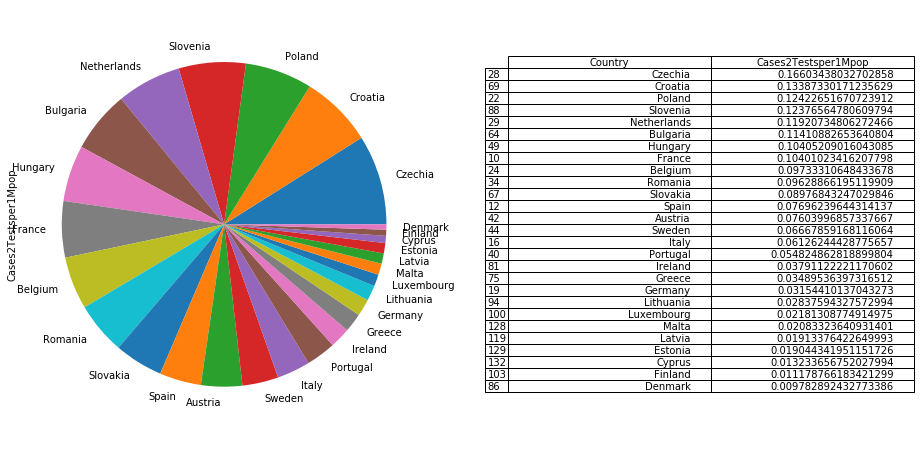

In [468]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [469]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
87,Singapore,0.000482,693124.0
177,Gibraltar,0.001127,2302342.0
169,Curaçao,0.001530,97485.0
181,Burundi,0.001595,4732.0
51,Qatar,0.001726,372132.0
...,...,...,...
109,Sudan,0.077495,0.0
17,Mexico,0.097940,20123.0
219,Western Sahara,0.100000,0.0
220,MS Zaandam,0.222222,0.0


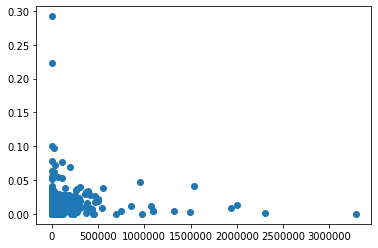

In [470]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


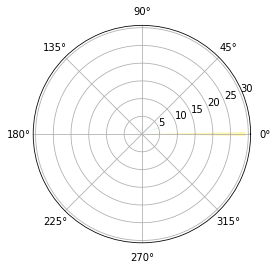

In [471]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

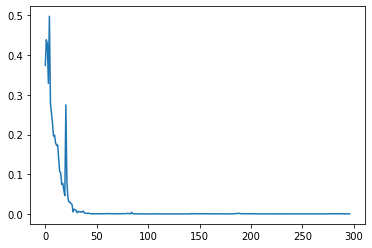

In [472]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [473]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


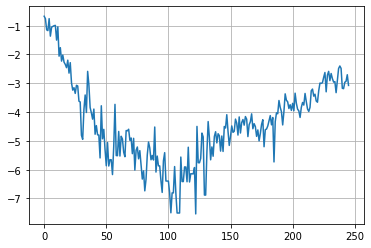

In [474]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

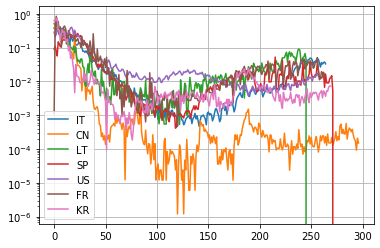

In [475]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

258 258
coefficient of determination: 0.6607753930233016
intercept: -13.527415372552353
slope: [-0.03696338]


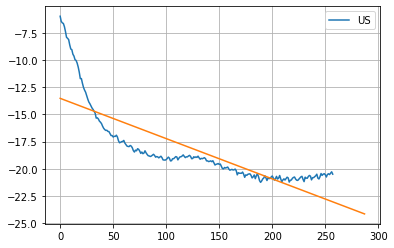

In [476]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [477]:
#np.diff(dfIT["cases"])

265 265
coefficient of determination: 0.27877544321257886
intercept: -14.54836843016272
slope: [-0.01854885]


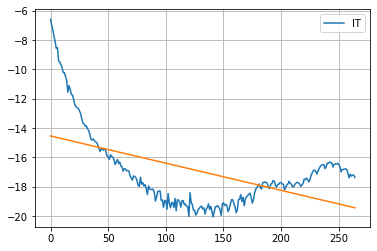

In [478]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [479]:
#model11.coef_

In [480]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

247 247
coefficient of determination: 0.8599338584917031
intercept: -16.845490722497228
slope: [-0.0265811]


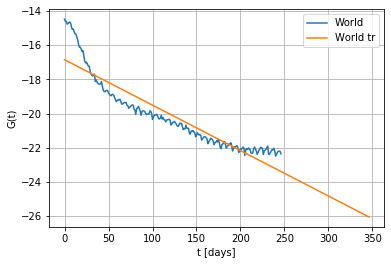

In [481]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

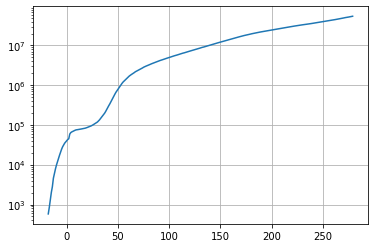

In [482]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [483]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.90235203e+08  3.38627706e-01 -3.57940175e+02  1.74828491e-02]


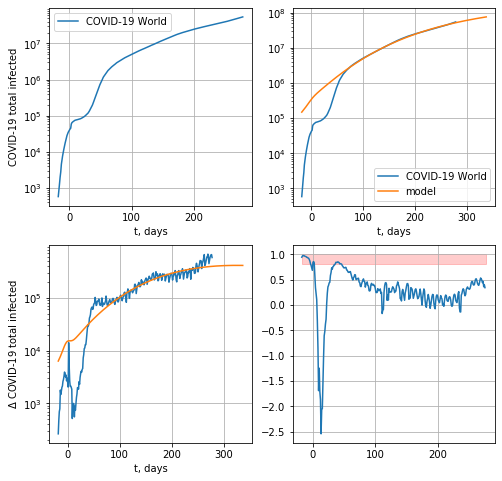

592685.0534596724


In [484]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

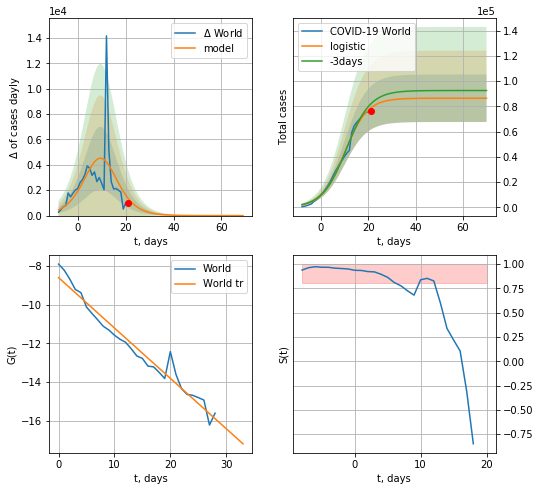

World data at: 2020-11-14
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  86473 ± 18834
	 total death:  2097 ± 1370
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


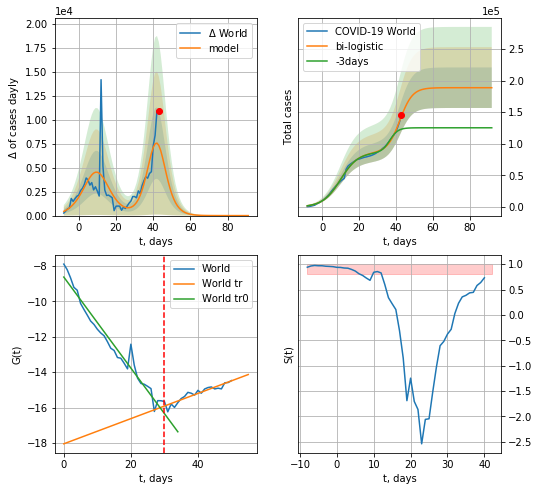

World data at: 2020-11-14
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  188701 ± 32065
	 total death:  4577 ± 2333
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:312: RuntimeWarning: overflow encountered in exp


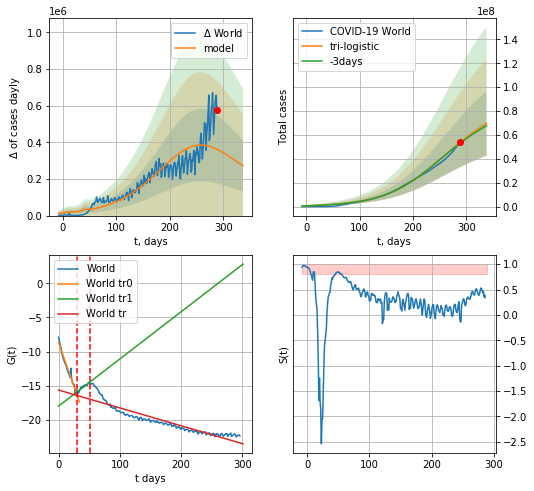

World data at: 2020-11-14
+3 day model MAPE: 0.012830501824848272
model: tri-logistic
coeffs:  [7.53893341e+07 1.88830320e-02 2.50847413e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.3875015269522743
forecast at the end of period: +49 days
	 deltaDaycases:  272236
	 total cases:  69547702 ± 26949840
	 total death:  1687013 ± 1961160
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.862340
 intercept: -15.616668
 slope: -0.026114


In [485]:
vL = 30
T18 = 40
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

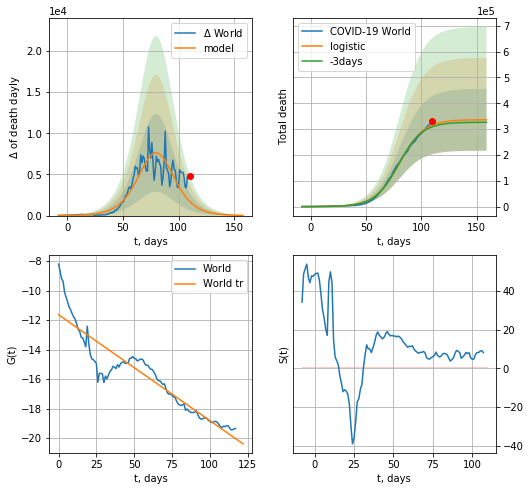

World data at: 2020-11-14
+3 day model MAPE: 0.020621037522772532
model: logistic
coeffs:  [3.36666036e+05 9.06319611e-02 8.01803344e+01]
rational stdev:  0.356220604376718
forecast at the end of period: +49 days
	 total death:  336400 ± 119832
trend coefficient of determination: 0.862243
 intercept: -11.641434
 slope: -0.071737


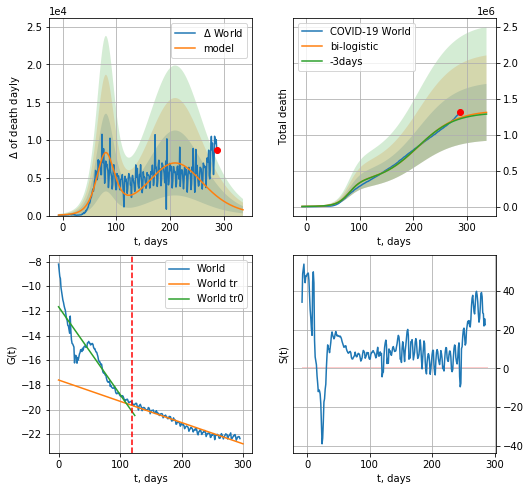

World data at: 2020-11-14
+3 day model MAPE: 0.012038111920842377
model: bi-logistic
coeffs:  [9.99378128e+05 2.78821466e-02 2.09895748e+02] [3.36666036e+05 9.06319611e-02 8.01803344e+01]
rational stdev:  0.30238808168992154
forecast at the end of period: +49 days
	 deltaDaydeath:  770
	 total death:  1307974 ± 395515
bi-logistic approximation splitting point: 120
trend0 coefficient of determination: 0.864805
 intercept: -11.666935
 slope: -0.071086
trend coefficient of determination: 0.941461
 intercept: -17.605809
 slope: -0.017246


In [486]:
vL = 120#30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [487]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


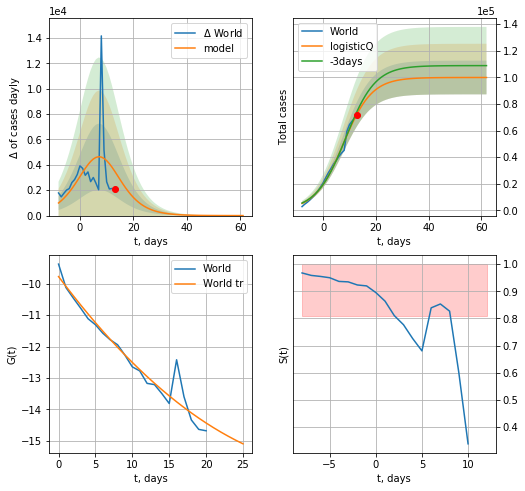

World data at: 2020-11-14
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 99860 ± 12678
	 total death: 2422 ± 922
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


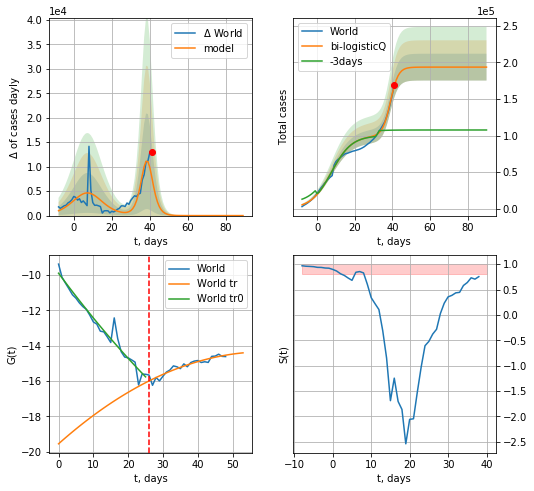

World data at: 2020-11-14
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 193626 ± 18336
	 total death: 4696 ± 1334
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


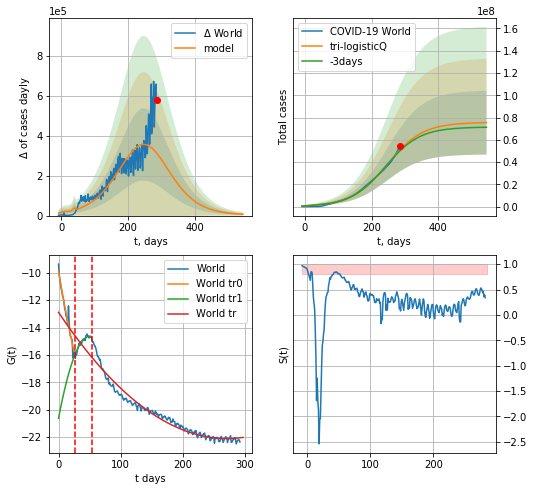

World data at: 2020-11-14
+3 day model MAPE: 0.016844
model: tri-logisticQ
coeffs: [ 7.53572114e+07  9.22604909e-08  2.46818791e+02 -2.04501579e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379805
forecast at the end of period: +259 days
	 deltaDaycases: 6773
	 total cases: 75449390 ± 28656019
	 total death: 1830170 ± 2085320
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.963173
 intercept_: -12.892303493674063
 coeffs_: [ 0.         -0.06790522  0.00012517]


In [488]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [489]:
#vL = 55
#x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RRD("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

298


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


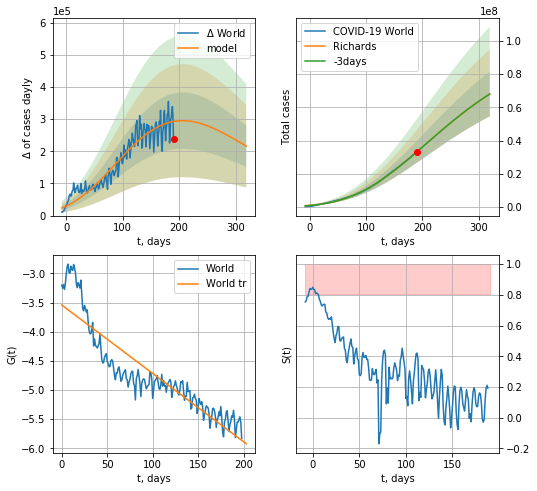

World data at: 2020-11-14
+3 day model MAPE: 0.000153
model: Richards
coeffs: [ 1.00574850e+08  1.59324796e-01 -1.56451036e+02  5.13454148e-02]
rational stdev: 0.198566
forecast at the end of period: +129 days
	 deltaDaycases: 216010
	 total cases: 68013183 ± 13505120
	 total death: 1649790 ± 982777
trend coefficient of determination: 0.817380
 intercept: -3.542094
 slope: -0.011731
diffStd0a 0.11499275378267411


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


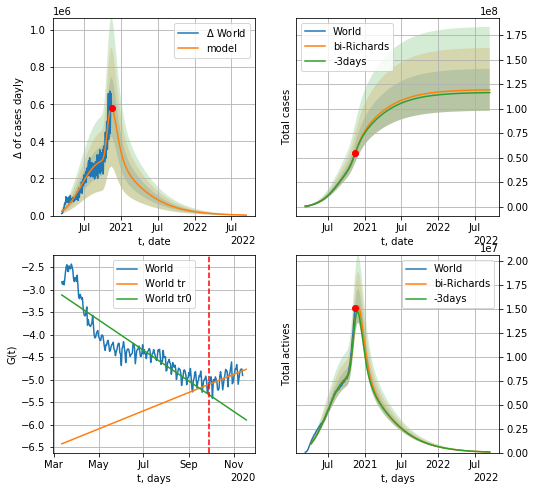

World data at: 2020-11-14
+3 day model MAPE: 0.003183
model: bi-Richards
coeffs: [1.88820374e+07 2.13052693e+00 1.49540697e+02 2.03334687e-02]
rational stdev: 0.179278
forecast at the end of period: +669 days
	 deltaDaycases: 2650
	 total cases: 119133678 ± 21357993
	 total death: 2889817 ± 1554237
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.811462
 intercept: -3.121656
 slope: -0.011049
trend coefficient of determination: 0.294356
 intercept: -6.424610
 slope: 0.006589


In [490]:
print (len(dfW))
vL = 200+50
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("World",dfW[50:],d1,100*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50,amc=0.8)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


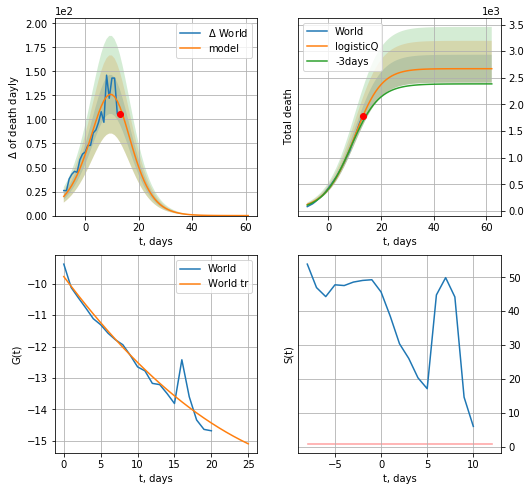

World data at: 2020-11-14
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +49 days
	 total death: 2670 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


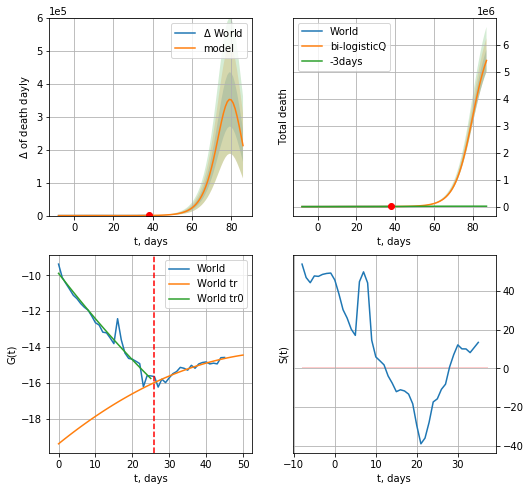

World data at: 2020-11-14
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +49 days
	 total death: 5420485 ± 415156
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


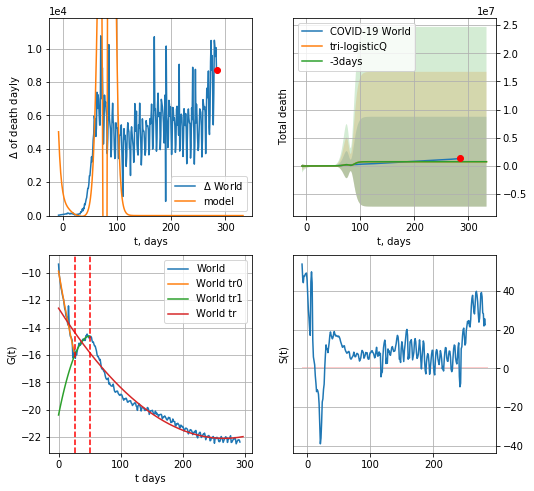

World data at: 2020-11-14
+3 day model MAPE: 0.011718
model: tri-logisticQ
coeffs: [-5.69073332e+06  2.39037693e-03  7.89383675e+01 -3.22444836e+01]
rational stdev: 10.605209
forecast at the end of period: +49 days
	 total death: 752040 ± 7975548
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.961042
 intercept_: -12.590290462834801
 coeffs_: [ 0.         -0.07128629  0.00013378]


In [491]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


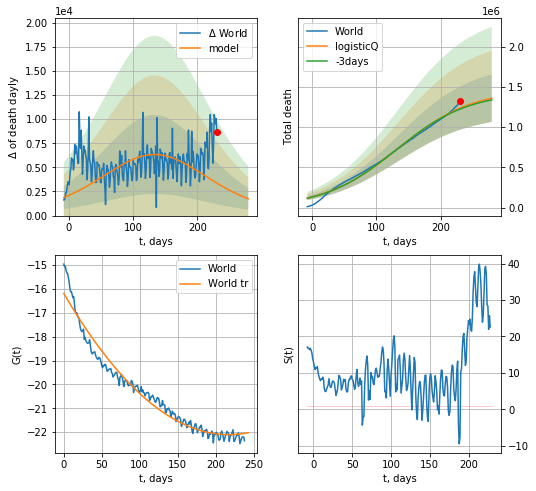

World data at: 2020-11-14
+3 day model MAPE: 0.009670
model: logisticQ
coeffs: [ 1.46687692e+06  9.12463120e-08  1.33470693e+02 -1.89313049e+05]
rational stdev: 0.217687
forecast at the end of period: +49 days
	 total death: 1359139 ± 295867
trend coefficient of determination: 0.963173
 intercept_: -16.194159424867948
 coeffs_: [ 0.         -0.05438723  0.00012517]


In [492]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [493]:
#trend(dfSP,'SP',10)

In [494]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

In [495]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    #x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    #xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

SP
           date    cases  active    death
269 2020-11-10  1443997       0  39756.0
270 2020-11-11  1463093       0  40105.0
271 2020-11-12  1484868       0  40461.0
272 2020-11-13  1492608       0  40769.0
273 2020-11-14  1492608       0  40769.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


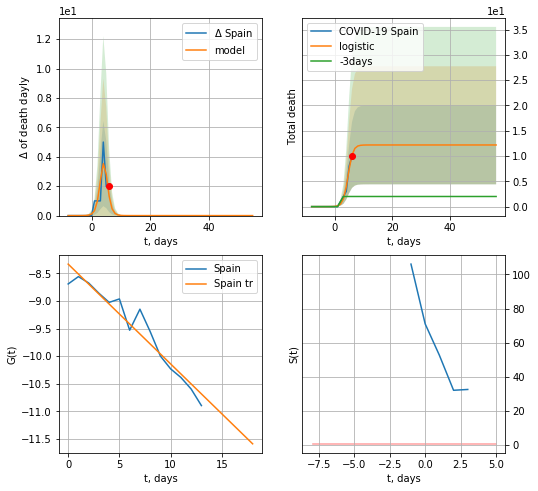

Spain data at: 2020-11-13
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +50 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: invalid value encountered in true_divide


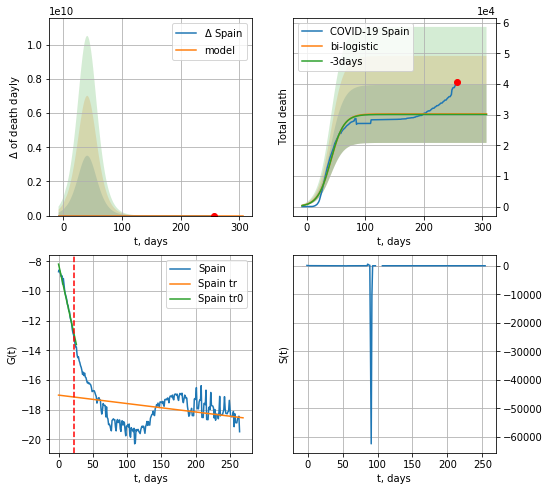

Spain data at: 2020-11-13
+3 day model MAPE: 0.006285190877228022
model: bi-logistic
coeffs:  [3.02263899e+04 8.91899110e-02 4.13015274e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.31291837384355453
forecast at the end of period: +50 days
	 deltaDaydeath:  0
	 total death:  30238 ± 9462
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.097280
 intercept: -17.011342
 slope: -0.005680


In [93]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


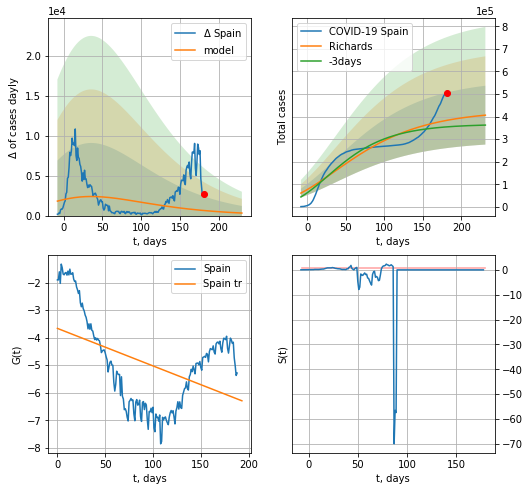

Spain data at: 2020-11-13
+3 day model MAPE: 0.082514
model: Richards
coeffs: [ 4.27280053e+05  3.16489052e+00 -3.13079673e+02  4.82672820e-03]
rational stdev: 0.320945
forecast at the end of period: +50 days
	 deltaDaycases: 317
	 total cases: 406076 ± 130328
	 total death: 11091 ± 10678
trend coefficient of determination: 0.201906
 intercept: -3.664041
 slope: -0.013609
diffStd0a 0.44034278182300374


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


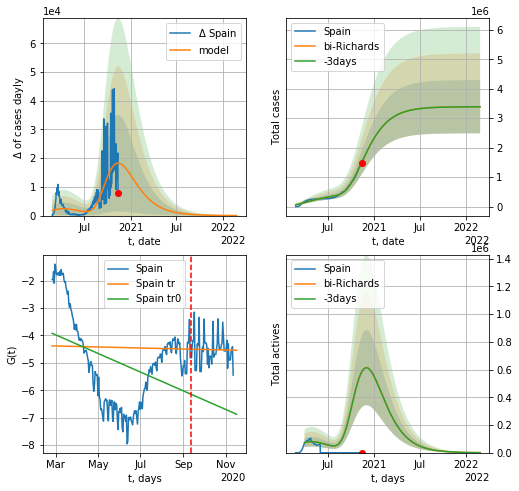

Spain data at: 2020-11-13
+3 day model MAPE: 0.000462
model: bi-Richards
coeffs: [ 2.96340439e+06  1.29114454e+00 -6.16640486e+00  1.29136758e-02]
rational stdev: 0.266206
forecast at the end of period: +470 days
	 deltaDaycases: 20
	 total cases: 3389488 ± 902302
	 total death: 92580 ± 73936
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.156562
 intercept: -3.920250
 slope: -0.011105
trend coefficient of determination: 0.000454
 intercept: -4.378962
 slope: -0.000604


In [94]:
iL = 10
vL = 200+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Spain',dfSP[iL:],d12f(1),7*100-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


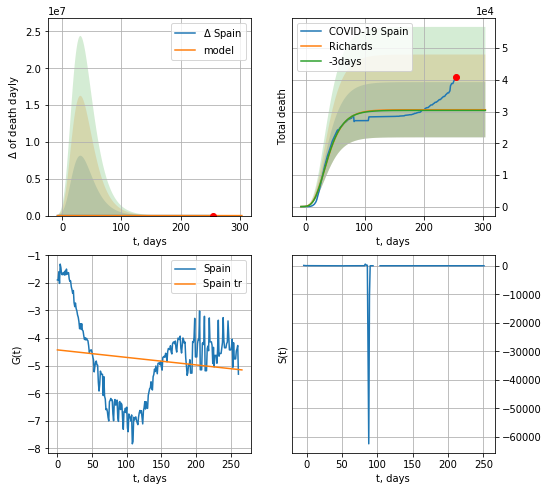

Spain data at: 2020-11-13
+3 day model MAPE: 0.007015
model: Richards
coeffs: [ 3.05723426e+04  1.71803333e+01 -7.03458352e+01  3.27901919e-03]
rational stdev: 0.284947
forecast at the end of period: +50 days
	 total death: 30572 ± 8711
trend coefficient of determination: 0.020260
 intercept: -4.428550
 slope: -0.002725


In [95]:
x = forecastRR('Spain',dfSP[10:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

In [96]:
#x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
#xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


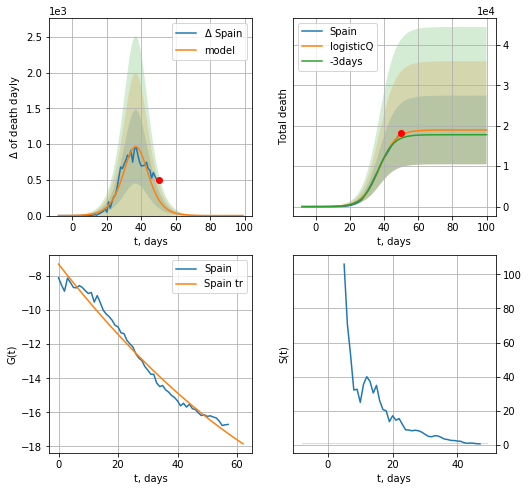

Spain data at: 2020-11-13
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +50 days
	 total death: 18971 ± 8493
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


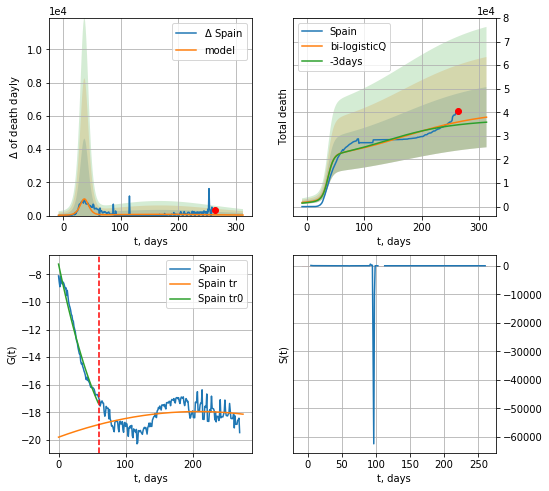

Spain data at: 2020-11-13
+3 day model MAPE: 0.034754
model: bi-logisticQ
coeffs: [ 2.10381584e+04  1.38282774e-08  1.67074919e+02 -1.00510981e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336552
forecast at the end of period: +50 days
	 total death: 37940 ± 12768
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.105210
 intercept_: -19.81069587053362
 coeffs_: [ 0.00000000e+00  1.78648472e-02 -4.28833754e-05]


In [97]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [98]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

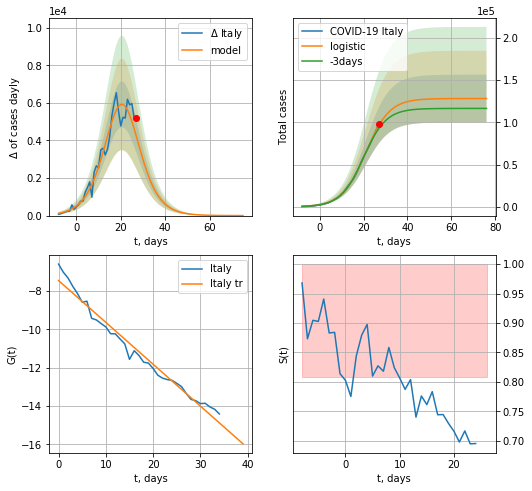

Italy data at: 2020-11-14
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  128134 ± 28273
	 total death:  5002 ± 3311
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


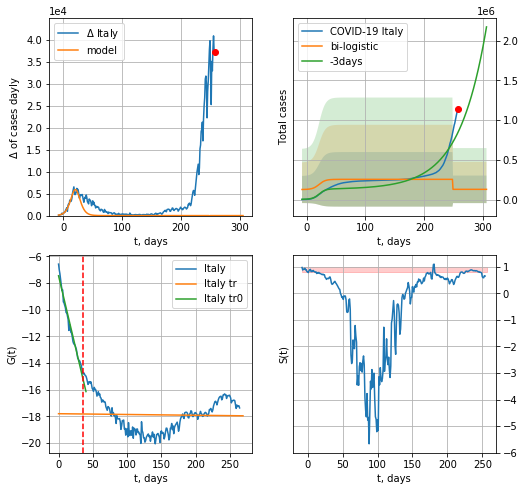

Italy data at: 2020-11-14
+3 day model MAPE: 0.8497480824545808
model: bi-logistic
coeffs:  [ 1.25765316e+05 -9.67698528e+01  2.48510549e+02] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  1.3507375106432054
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  128139 ± 173082
	 total death:  5002 ± 20269
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.000954
 intercept: -17.810118
 slope: -0.000584


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp


In [496]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

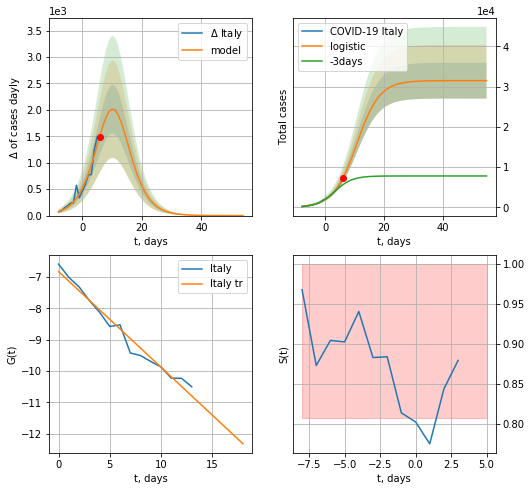

Italy data at: 2020-11-14
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  31497 ± 4456
	 total death:  1229 ± 521
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


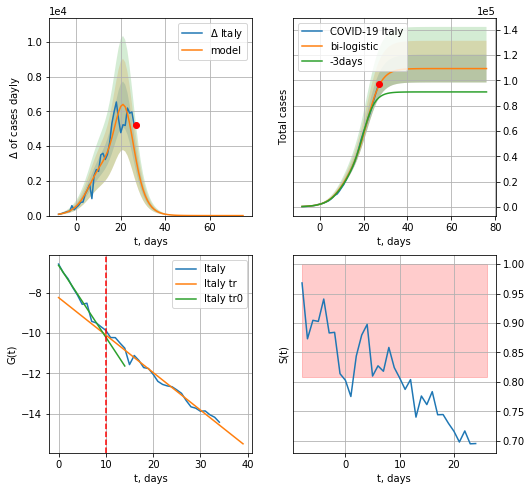

Italy data at: 2020-11-14
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  109362 ± 10990
	 total death:  4269 ± 1287
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:312: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


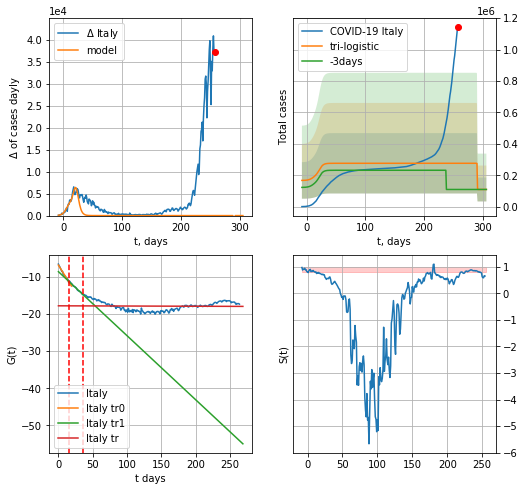

Italy data at: 2020-11-14
+3 day model MAPE: 1.5244753543022973
model: tri-logistic
coeffs:  [ 1.66720098e+05 -9.89233111e+00  2.90479127e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.6958686793841498
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  109362 ± 76101
	 total death:  4269 ± 8911
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.000954
 intercept: -17.810118
 slope: -0.000584


In [497]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

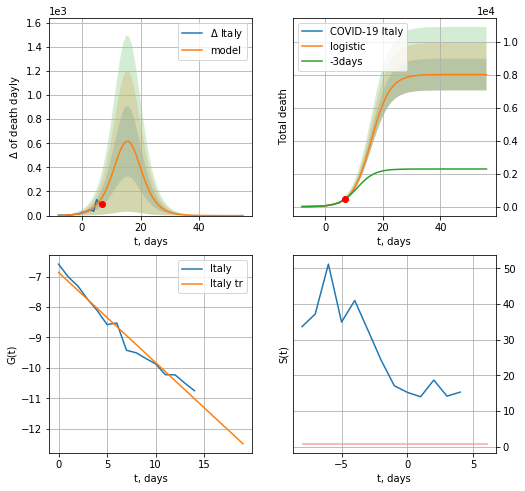

Italy data at: 2020-11-14
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +49 days
	 total death:  8021 ± 963
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


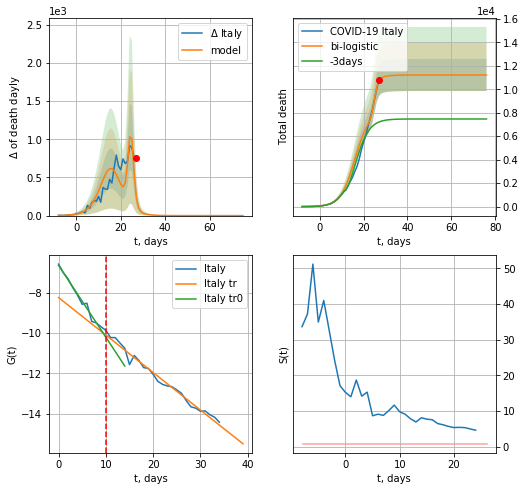

Italy data at: 2020-11-14
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +49 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


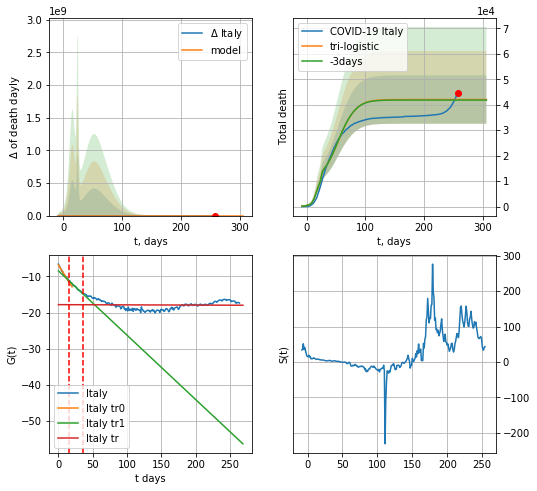

Italy data at: 2020-11-14
+3 day model MAPE: 0.0049517977070573675
model: tri-logistic
coeffs:  [2.46670979e+04 8.18335163e-02 5.10595387e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.22606680346441482
forecast at the end of period: +49 days
	 deltaDaydeath:  0
	 total death:  42045 ± 9505
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.000954
 intercept: -17.810118
 slope: -0.000584


In [498]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


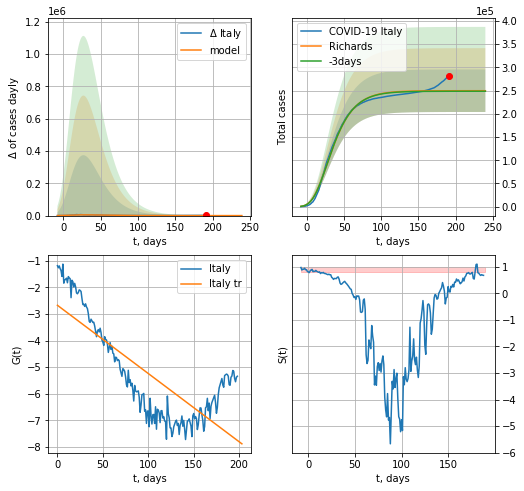

Italy data at: 2020-11-14
+3 day model MAPE: 0.004445
model: Richards
coeffs: [ 2.49818271e+05  1.03928665e+01 -7.87445552e+01  4.83991521e-03]
rational stdev: 0.183409
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 249812 ± 45817
	 total death: 9752 ± 5365
trend coefficient of determination: 0.624507
 intercept: -2.673566
 slope: -0.025683
diffStd0a 1.1606591914911322


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


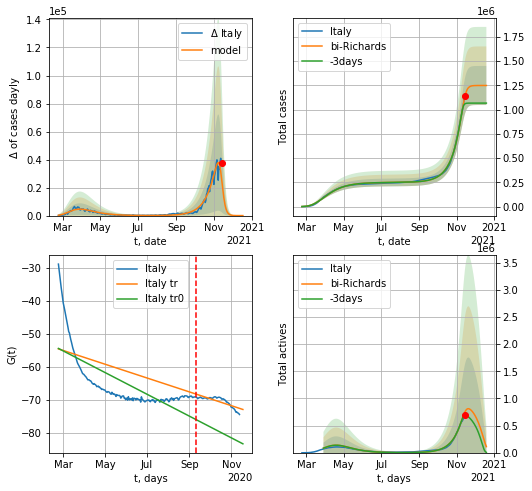

Italy data at: 2020-11-14
+3 day model MAPE: 0.090871
model: bi-Richards
coeffs: [9.98659611e+05 6.47487001e-02 2.56515609e+02 5.09477961e+00]
rational stdev: 0.161196
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 1248475 ± 201249
	 total death: 48740 ± 23570
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.516983
 intercept: -54.440294
 slope: -0.107655
trend coefficient of determination: 0.665497
 intercept: -54.584358
 slope: -0.068350


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


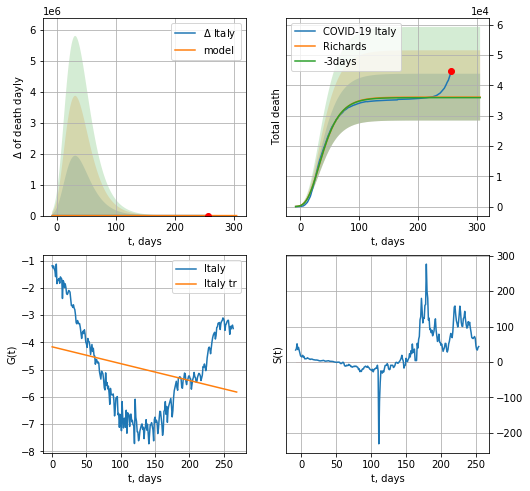

Italy data at: 2020-11-14
+3 day model MAPE: 0.004744
model: Richards
coeffs: [ 3.61341324e+04  1.04935920e+01 -7.78030615e+01  4.67767687e-03]
rational stdev: 0.213784
forecast at the end of period: +49 days
	 total death: 36134 ± 7724
trend coefficient of determination: 0.075019
 intercept: -4.161325
 slope: -0.006174


In [499]:
vL=200#152
x = forecastRR('Italy',dfIT[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Italy',dfIT[:],d1,38*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

In [500]:
#x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


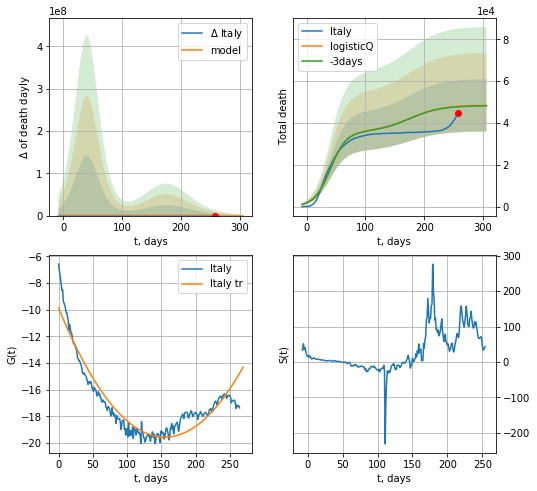

Italy data at: 2020-11-14
+3 day model MAPE: 0.003633
model: logisticQ
coeffs: [ 3.58095014e+04  1.04043550e-07  4.01929815e+01 -7.01795989e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258472
forecast at the end of period: +49 days
	 total death: 48389 ± 12507
trend coefficient of determination: 0.895626
 intercept_: -9.881834898693336
 coeffs_: [ 0.         -0.12500985  0.00040326]


In [501]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [502]:
dT

231

FR
           date      cases   active    death
269 2020-11-10  1829659.0  1655532  42207.0
270 2020-11-11  1865538.0  1689307  42535.0
271 2020-11-12  1898710.0  1720796  42960.0
272 2020-11-13  1922504.0  1741457  43892.0
273 2020-11-14  1954599.0  1771213  44246.0


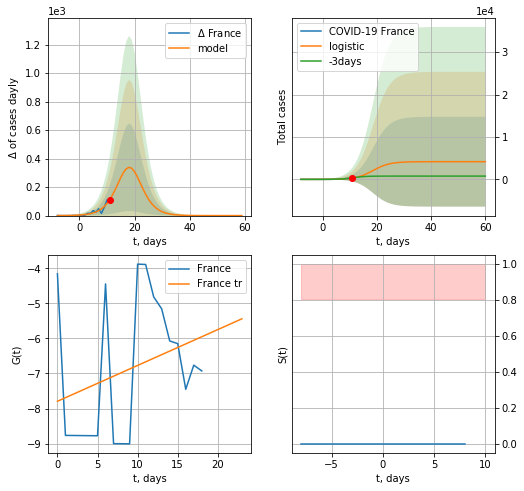

France data at: 2020-11-14
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  4173 ± 10597
	 total death:  94 ± 716
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


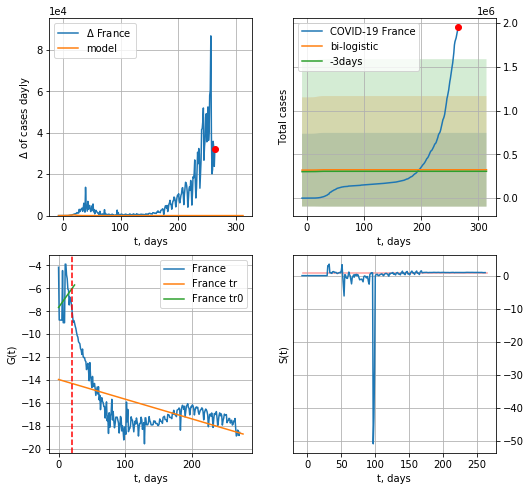

France data at: 2020-11-14
+3 day model MAPE: 0.057856192623663885
model: bi-logistic
coeffs:  [ 3.19918367e+05 -1.78494336e+01  4.34180618e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  1.298091988820031
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  324092 ± 420701
	 total death:  7336 ± 28568
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.328469
 intercept: -13.965223
 slope: -0.017202


In [503]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [504]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

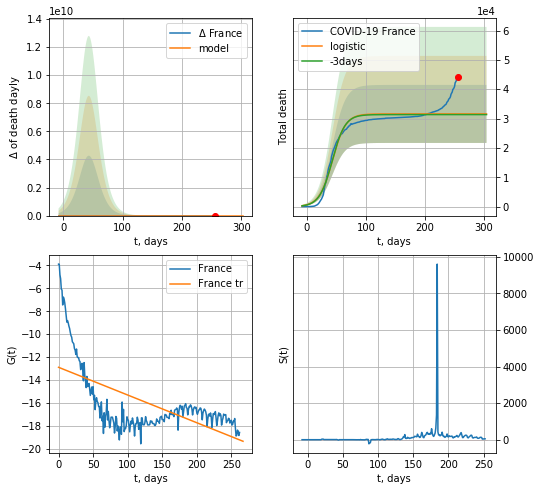

France data at: 2020-11-14
+3 day model MAPE: 0.007340664588310534
model: logistic
coeffs:  [3.15809163e+04 9.02180599e-02 4.34349984e+01]
rational stdev:  0.31294505605558454
forecast at the end of period: +49 days
	 total death:  31580 ± 9883
trend coefficient of determination: 0.383024
 intercept: -12.900352
 slope: -0.024213


In [505]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


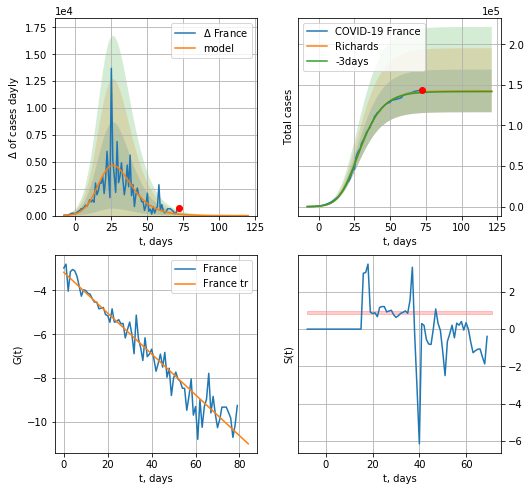

France data at: 2020-11-14
+3 day model MAPE: 0.005042
model: Richards
coeffs: [1.42540738e+05 3.12476603e-01 1.59919989e+01 3.30748014e-01]
rational stdev: 0.184343
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 142532 ± 26274
	 total death: 3226 ± 1784
trend coefficient of determination: 0.942455
 intercept: -3.170576
 slope: -0.093180
diffStd0a 0.31295769915440796


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


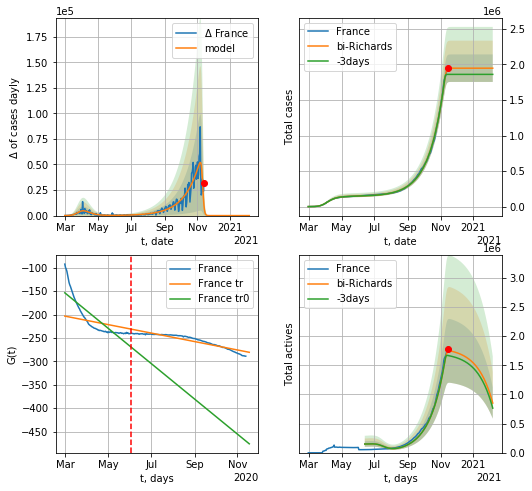

France data at: 2020-11-14
+3 day model MAPE: 0.043723
model: bi-Richards
coeffs: [1.80498688e+06 3.53728632e-02 2.48071097e+02 1.96630213e+01]
rational stdev: 0.099391
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 1947527 ± 193566
	 total death: 44085 ± 13144
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.723071
 intercept: -153.686434
 slope: -1.225750
trend coefficient of determination: 0.878341
 intercept: -203.393599
 slope: -0.293764


In [509]:
vL = 95+14#100+14#86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('France',dfFR[14:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14,amc=3.0)

In [510]:
#x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


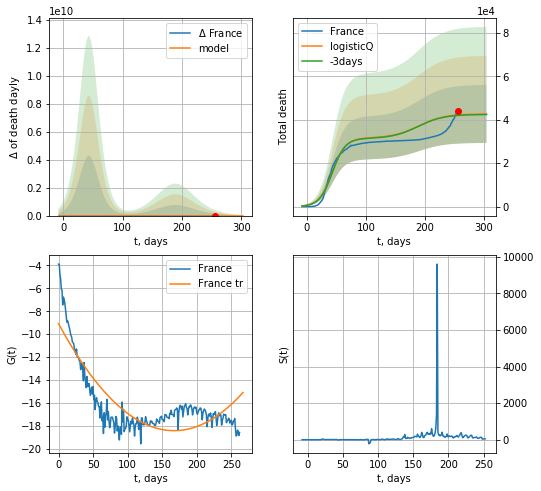

France data at: 2020-11-14
+3 day model MAPE: 0.005782
model: logisticQ
coeffs: [ 3.15809925e+04  1.06441238e-07  4.34360606e+01 -8.47429968e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312956
forecast at the end of period: +49 days
	 total death: 42704 ± 13364
trend coefficient of determination: 0.720325
 intercept_: -9.086819703194976
 coeffs_: [ 0.         -0.11188038  0.00033461]


In [511]:
x = forecastRRR('France',dfFR[10:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [512]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [513]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

In [514]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

GR
           date   cases  active    death
260 2020-11-10  705640  252580  11860.0
261 2020-11-11  726176  259294  12082.0
262 2020-11-12  749638  269562  12276.0
263 2020-11-13  772822  278619  12503.0
264 2020-11-14  788899  273980  12619.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


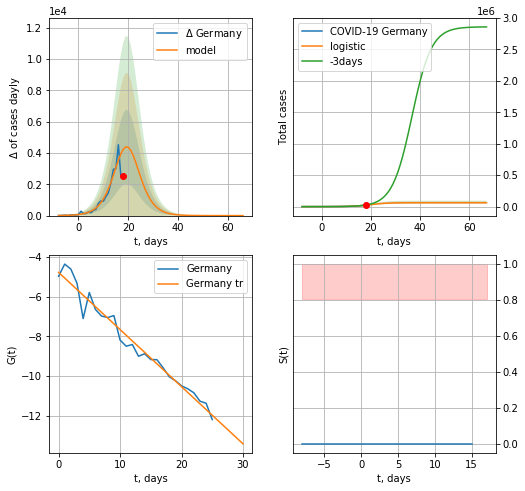

Germany data at: 2020-11-14
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  61550 ± 10963
	 total death:  984 ± 525
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


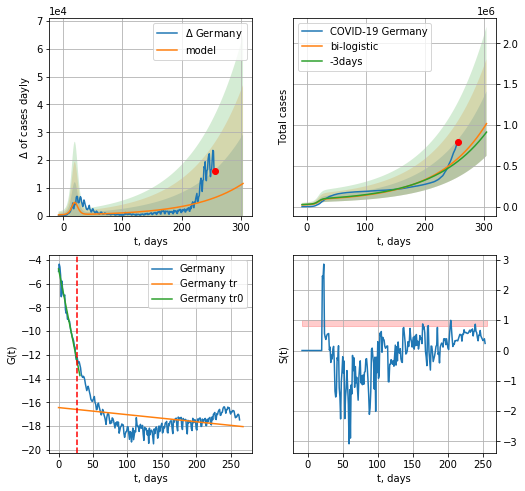

Germany data at: 2020-11-14
+3 day model MAPE: 0.06469944935584464
model: bi-logistic
coeffs:  [3.70777489e+09 1.21757115e-02 9.83765848e+02] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.38847248662710077
forecast at the end of period: +49 days
	 deltaDaycases:  11550
	 total cases:  1016269 ± 394792
	 total death:  16255 ± 18943
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.099222
 intercept: -16.433938
 slope: -0.005981


In [515]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [516]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active    death
260 2020-11-10  705640  252580  11860.0
261 2020-11-11  726176  259294  12082.0
262 2020-11-12  749638  269562  12276.0
263 2020-11-13  772822  278619  12503.0
264 2020-11-14  788899  273980  12619.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


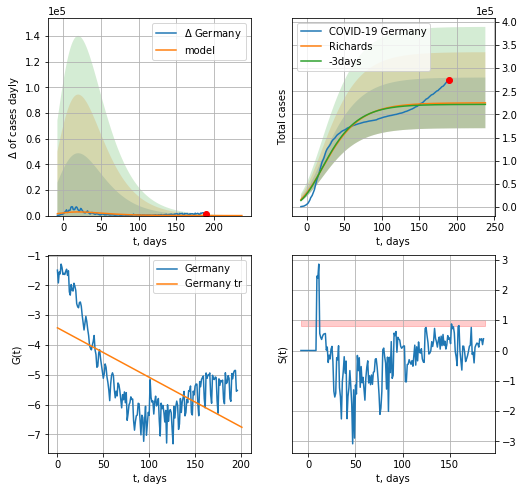

Germany data at: 2020-11-14
+3 day model MAPE: 0.014202
model: Richards
coeffs: [ 2.24991639e+05  1.08201736e+01 -1.45898747e+02  3.19943345e-03]
rational stdev: 0.243260
forecast at the end of period: +49 days
	 deltaDaycases: 4
	 total cases: 224872 ± 54702
	 total death: 3596 ± 2624
trend coefficient of determination: 0.409079
 intercept: -3.423509
 slope: -0.016610
diffStd0a 0.61059390422101


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


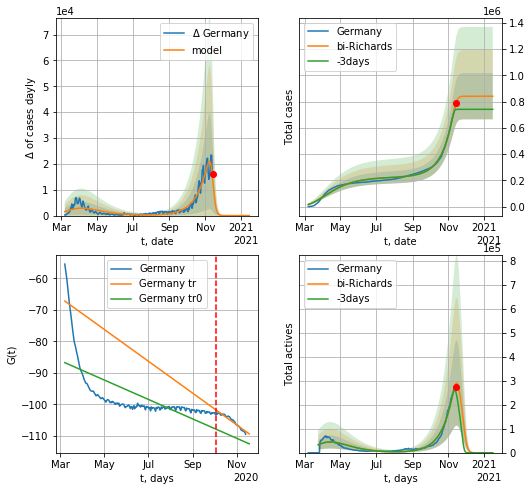

Germany data at: 2020-11-14
+3 day model MAPE: 0.080166
model: bi-Richards
coeffs: [6.16189573e+05 5.08781379e-02 2.44155972e+02 7.77272659e+00]
rational stdev: 0.209094
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 841170 ± 175883
	 total death: 13455 ± 8440
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.456763
 intercept: -86.723967
 slope: -0.100617
trend coefficient of determination: 0.925470
 intercept: -67.168089
 slope: -0.164731


In [517]:
vL = 210+12#94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Germany',dfGR[12:],d1,42*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12,amc=0.5)

In [518]:
#x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


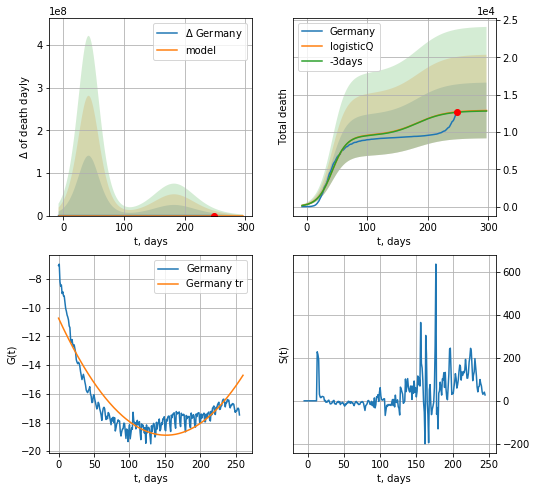

Germany data at: 2020-11-14
+3 day model MAPE: 0.004676
model: logisticQ
coeffs: [ 9.52551128e+03  1.16090651e-07  4.19264221e+01 -7.08165983e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289899
forecast at the end of period: +49 days
	 total death: 12869 ± 3730
trend coefficient of determination: 0.808671
 intercept_: -10.72339533026959
 coeffs_: [ 0.         -0.10768762  0.00035529]


In [519]:
x = forecastRRR('Germany',dfGR[8:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date     cases   active     death
254 2020-11-10  10568714  3720254  245943.0
255 2020-11-11  10708728  3812625  247398.0
256 2020-11-12  10873936  3897231  248585.0
257 2020-11-13  11066546  4026404  249998.0
258 2020-11-14  11226218  4083931  251256.0


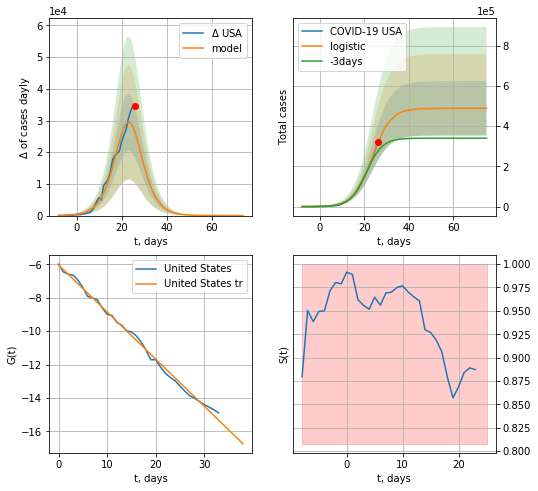

USA data at: 2020-11-14
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  489023 ± 135004
	 total death:  10944 ± 9063
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


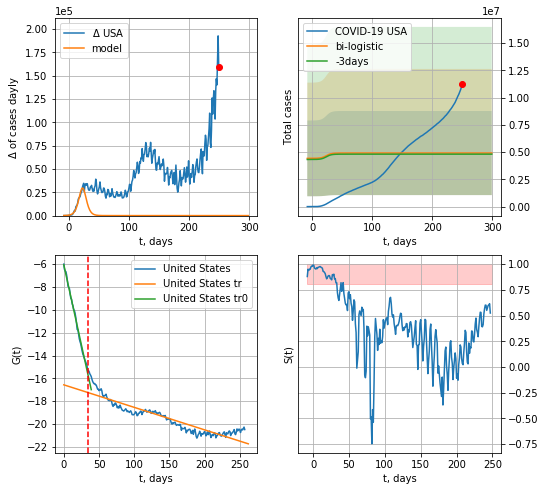

USA data at: 2020-11-14
+3 day model MAPE: 0.021367696985450314
model: bi-logistic
coeffs:  [ 3.54301848e+06 -3.98002292e+01  9.49829018e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7848798024430251
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  4917798 ± 3859881
	 total death:  110066 ± 259165
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.845584
 intercept: -16.567594
 slope: -0.019726


In [520]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

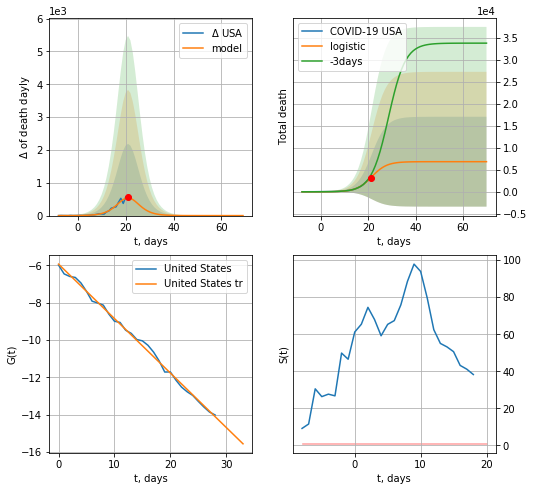

USA data at: 2020-11-14
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +49 days
	 total death:  6833 ± 10202
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


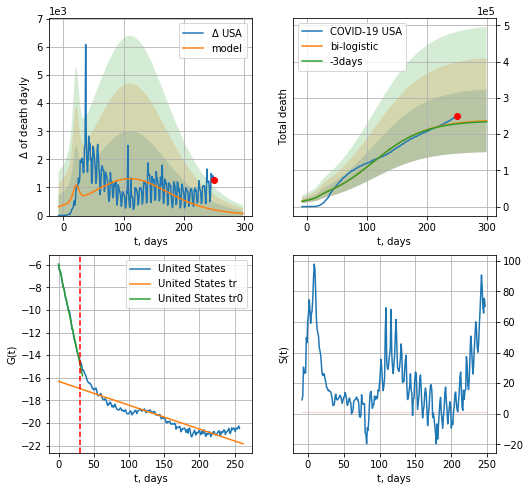

USA data at: 2020-11-14
+3 day model MAPE: 0.008658155715853983
model: bi-logistic
coeffs:  [2.33219574e+05 2.25375971e-02 1.10962708e+02] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.3650590153818552
forecast at the end of period: +49 days
	 deltaDaydeath:  74
	 total death:  236734 ± 86421
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.825537
 intercept: -16.318369
 slope: -0.021093


In [521]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


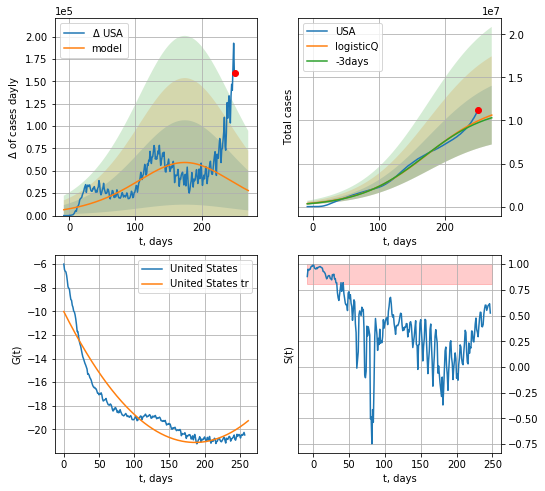

USA data at: 2020-11-14
+3 day model MAPE: 0.022919
model: logisticQ
coeffs: [ 1.22143159e+07  7.32842983e-08  1.74571886e+02 -2.64443699e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321207
forecast at the end of period: +21 days
	 deltaDaycases: 27957
	 total cases: 10620244 ± 3411298
	 total death: 237693 ± 229046
trend coefficient of determination: 0.880895
 intercept_: -10.015636612419348
 coeffs_: [ 0.         -0.11927086  0.00032026]


In [522]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


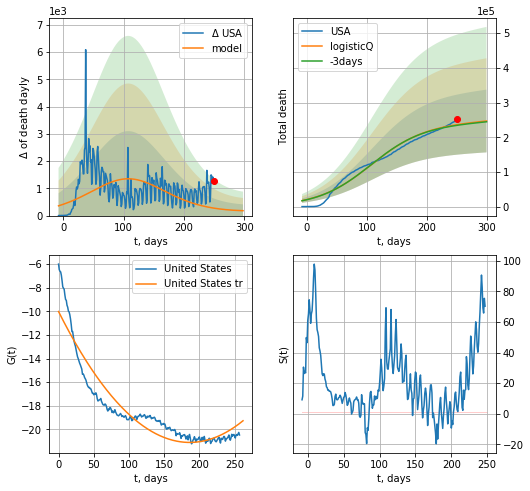

USA data at: 2020-11-14
+3 day model MAPE: 0.008058
model: logisticQ
coeffs: [ 2.39175408e+05  2.92606111e-08  1.07501238e+02 -7.62521923e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366333
forecast at the end of period: +49 days
	 total death: 246880 ± 90440
trend coefficient of determination: 0.880895
 intercept_: -10.015636612419348
 coeffs_: [ 0.         -0.11927086  0.00032026]


In [523]:
x = forecastRRR('USA',dfUS[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


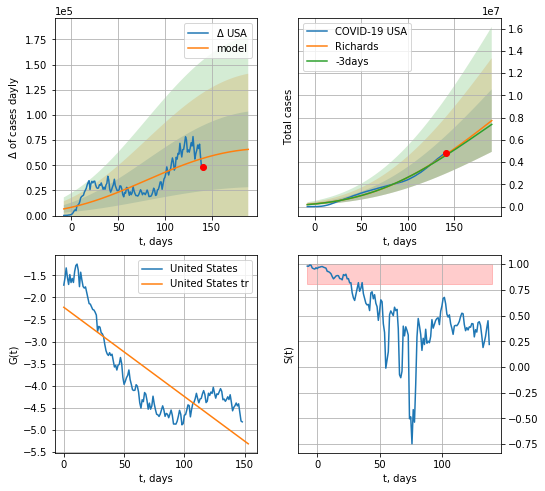

USA data at: 2020-11-14
+3 day model MAPE: 0.016216
model: Richards
coeffs: [ 2.47409672e+07  5.19275109e-01 -3.65221654e+02  1.42046904e-02]
rational stdev: 0.363080
forecast at the end of period: +49 days
	 deltaDaycases: 65753
	 total cases: 7737044 ± 2809166
	 total death: 173164 ± 188617
trend coefficient of determination: 0.669873
 intercept: -2.223519
 slope: -0.020248
diffStd0a 0.13801080196114096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


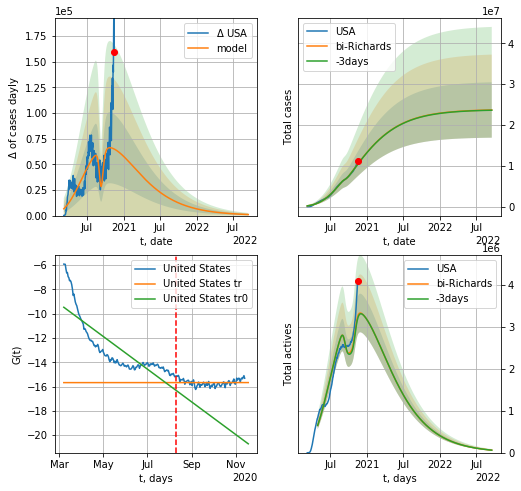

USA data at: 2020-11-14
+3 day model MAPE: 0.005716
model: bi-Richards
coeffs: [-9.18379213e+05  2.09445245e-01  1.76766927e+02  6.81208801e-01]
rational stdev: 0.286540
forecast at the end of period: +672 days
	 deltaDaycases: 1008
	 total cases: 23685979 ± 6786989
	 total death: 530120 ± 455702
bi-Richards approximation splitting point: 156
trend coefficient of determination: 0.703666
 intercept: -9.468757
 slope: -0.043915
trend coefficient of determination: 0.000003
 intercept: -15.673210
 slope: 0.000015


In [524]:
iL = 6
vL = 156+iL#193+iL#90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('USA',dfUS[iL:],d1,7*129-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.5)

In [525]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date    cases  active    death
258 2020-11-10  1233775       0  49770.0
259 2020-11-11  1256725       0  50365.0
260 2020-11-12  1290195       0  50928.0
261 2020-11-13  1317496       0  51304.0
262 2020-11-14  1344356       0  51766.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


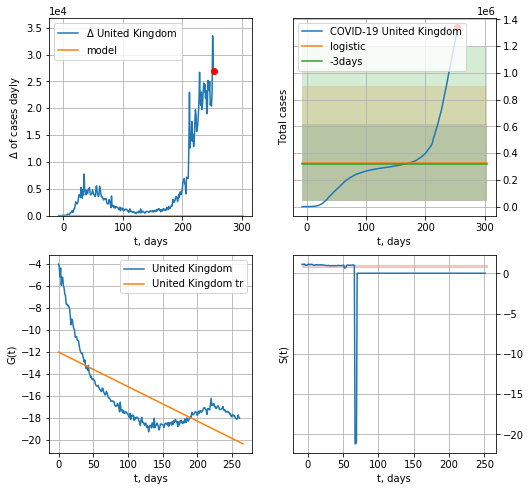

United Kingdom data at: 2020-11-14
+3 day model MAPE: 0.036046515700703746
model: logistic
coeffs:  [ 3.28079167e+05 -1.72655785e+01  4.26559905e+02]
rational stdev:  0.8775050869951251
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  328079 ± 287891
	 total death:  12633 ± 33256
trend coefficient of determination: 0.489642
 intercept: -12.025835
 slope: -0.031312


In [526]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [527]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


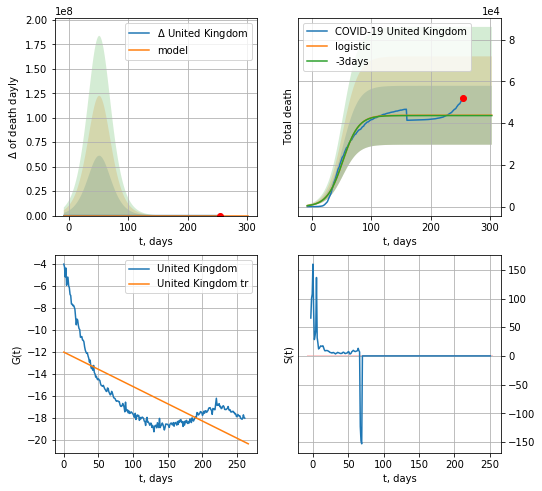

United Kingdom data at: 2020-11-14
+3 day model MAPE: 0.0035805732036426154
model: logistic
coeffs:  [4.37343179e+04 7.49857903e-02 5.20171892e+01]
rational stdev:  0.3223722140778516
forecast at the end of period: +49 days
	 total death:  43734 ± 14098
trend coefficient of determination: 0.489642
 intercept: -12.025835
 slope: -0.031312


In [528]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


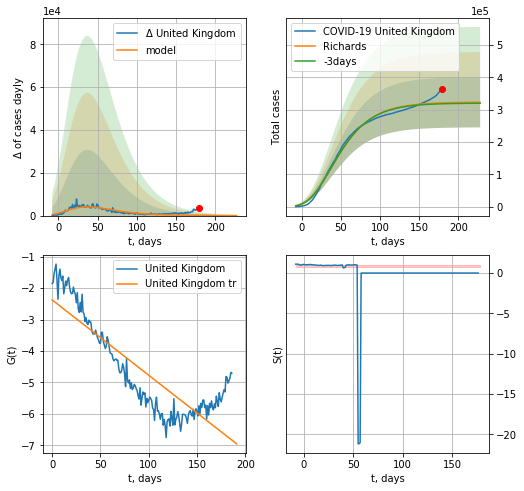

United Kingdom data at: 2020-11-14
+3 day model MAPE: 0.008801
model: Richards
coeffs: [ 3.23415604e+05  7.89136664e+00 -1.20373121e+02  4.36893740e-03]
rational stdev: 0.240393
forecast at the end of period: +49 days
	 deltaDaycases: 15
	 total cases: 322965 ± 77638
	 total death: 12436 ± 8968
trend coefficient of determination: 0.735594
 intercept: -2.373746
 slope: -0.023973


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 0.4355144646978579


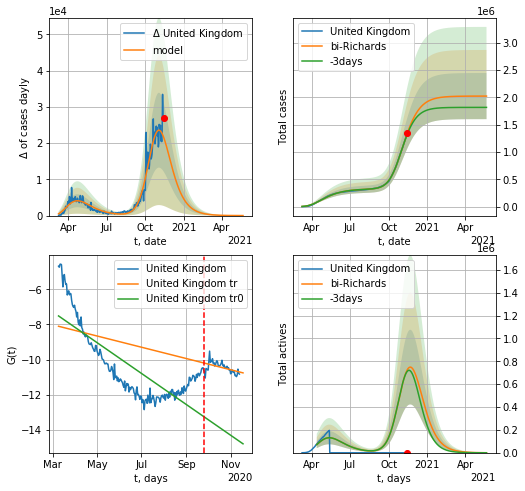

United Kingdom data at: 2020-11-14
+3 day model MAPE: 0.013367
model: bi-Richards
coeffs: [1.69810275e+06 9.52185761e-02 2.15531106e+02 4.89826204e-01]
rational stdev: 0.208615
forecast at the end of period: +189 days
	 deltaDaycases: 7
	 total cases: 2021368 ± 421687
	 total death: 77835 ± 48712
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.627224
 intercept: -7.514287
 slope: -0.028677
trend coefficient of determination: 0.247777
 intercept: -8.102879
 slope: -0.010451


In [529]:
vL = 200+12#143+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('United Kingdom',dfGB[12:],d1,60*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


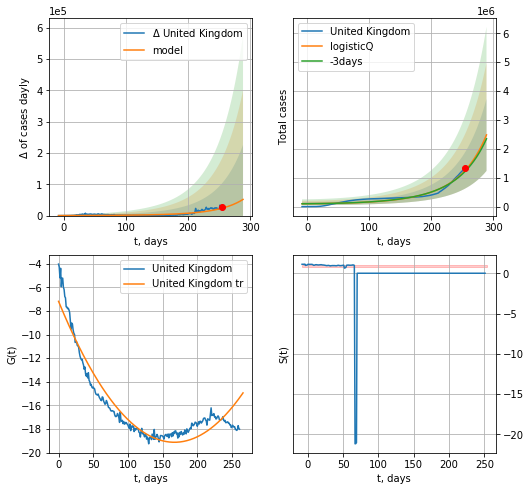

United Kingdom data at: 2020-11-14
+3 day model MAPE: 0.028599
model: logisticQ
coeffs: [ 3.47722999e+09  3.44319496e-05  5.34647376e+02 -5.67446326e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.501944
forecast at the end of period: +35 days
	 deltaDaycases: 51548
	 total cases: 2482716 ± 1246184
	 total death: 95599 ± 143955
trend coefficient of determination: 0.907869
 intercept_: -7.18757107327821
 coeffs_: [ 0.         -0.14296433  0.00042779]


In [530]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


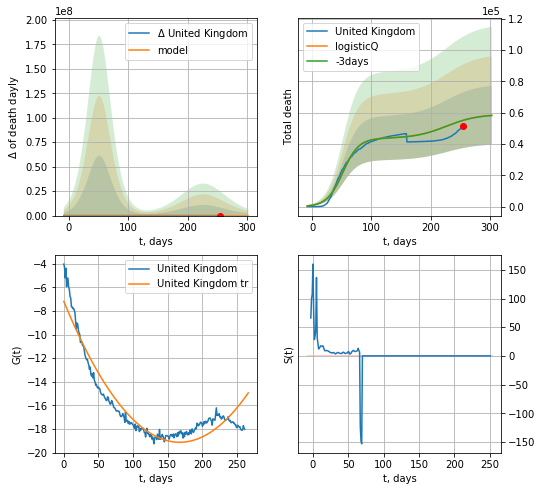

United Kingdom data at: 2020-11-14
+3 day model MAPE: 0.001608
model: logisticQ
coeffs: [ 4.37342394e+04  1.36556207e-07  5.20177672e+01 -5.48870485e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322393
forecast at the end of period: +49 days
	 total death: 58397 ± 18826
trend coefficient of determination: 0.907869
 intercept_: -7.18757107327821
 coeffs_: [ 0.         -0.14296433  0.00042779]


In [531]:
x = forecastRRR('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [532]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [533]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [534]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [535]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [536]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
257 2020-11-10  56958.0   13959  750.0
258 2020-11-11  57952.0   13716  753.0
259 2020-11-12  58963.0   13515  755.0
260 2020-11-13  60000.0   13539  756.0
261 2020-11-14  61078.0   13547  757.0


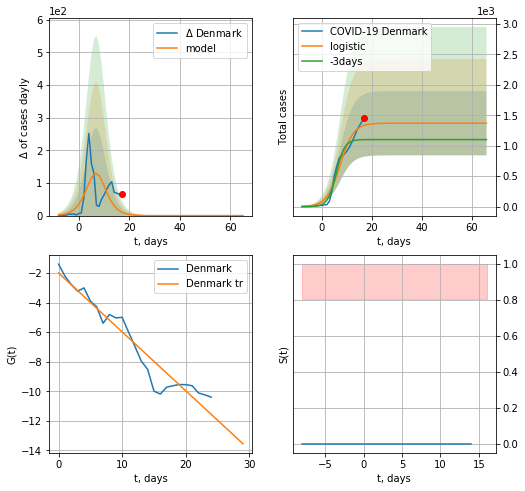

Denmark data at: 2020-11-14
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  16 ± 18
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


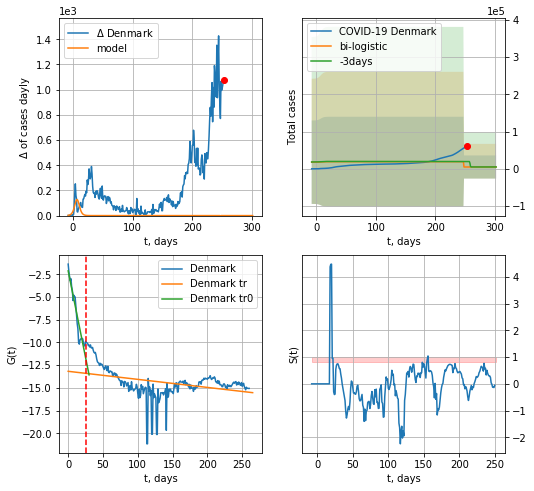

Denmark data at: 2020-11-14
+3 day model MAPE: 0.7506147824240309
model: bi-logistic
coeffs:  [14236.89639021  -138.53558329   247.59428844] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  6.285346760670069
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  4928 ± 30979
	 total death:  61 ± 1150
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.134323
 intercept: -13.176753
 slope: -0.008862


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp


In [537]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [538]:
d12f(4)

'2020-11-11'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


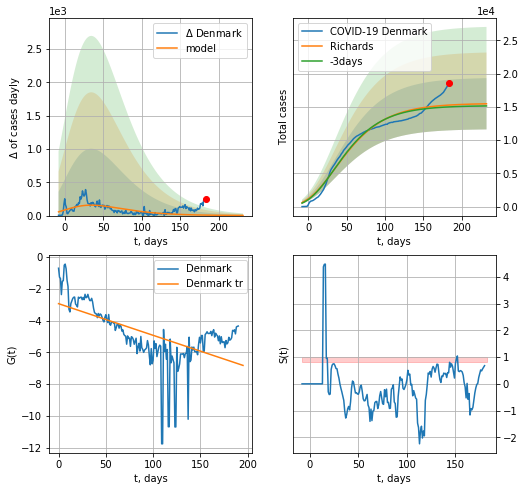

Denmark data at: 2020-11-14
+3 day model MAPE: 0.018367
model: Richards
coeffs: [ 1.55387411e+04  7.02926074e+00 -1.66867960e+02  3.90987733e-03]
rational stdev: 0.249168
forecast at the end of period: +49 days
	 deltaDaycases: 1
	 total cases: 15469 ± 3854
	 total death: 191 ± 142
trend coefficient of determination: 0.355292
 intercept: -2.934034
 slope: -0.019949
diffStd0a 0.4131558501641082


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


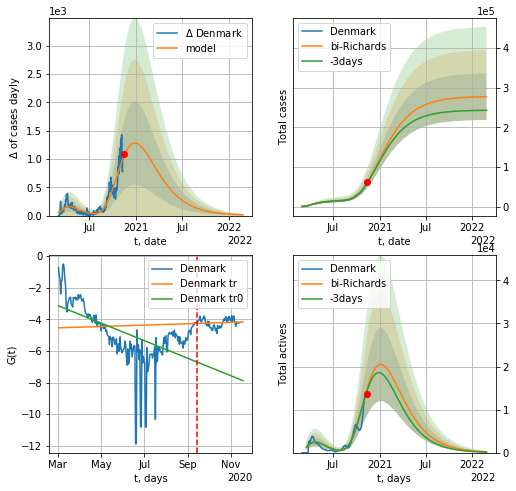

Denmark data at: 2020-11-14
+3 day model MAPE: 0.009516
model: bi-Richards
coeffs: [ 2.62316860e+05  8.51993397e-01 -1.79104869e+01  1.57041039e-02]
rational stdev: 0.211569
forecast at the end of period: +469 days
	 deltaDaycases: 11
	 total cases: 276972 ± 58598
	 total death: 3432 ± 2178
bi-Richards approximation splitting point: 196
trend coefficient of determination: 0.312507
 intercept: -3.148373
 slope: -0.018133
trend coefficient of determination: 0.008541
 intercept: -4.539165
 slope: 0.001410


In [539]:
vL = 200#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Denmark',dfDK[4:],d1,100*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4,amc=0.5)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

In [540]:
#x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
#x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
258 2020-11-10  25887.0   13739  285.0
259 2020-11-11  26511.0   14363  285.0
260 2020-11-12  27228.0   15074  291.0
261 2020-11-13  27916.0   15759  294.0
262 2020-11-14  28434.0   16277  294.0


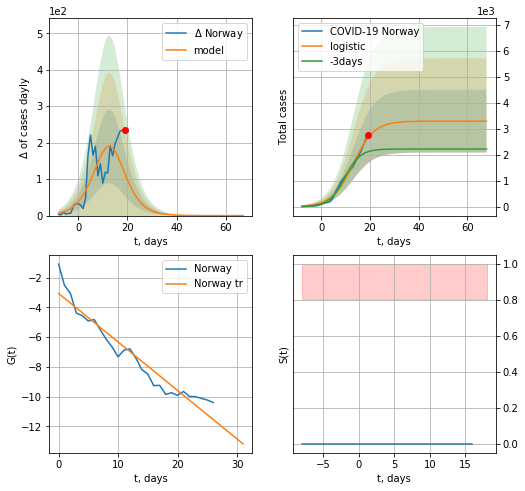

Norway data at: 2020-11-14
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  3297 ± 1211
	 total death:  34 ± 37
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


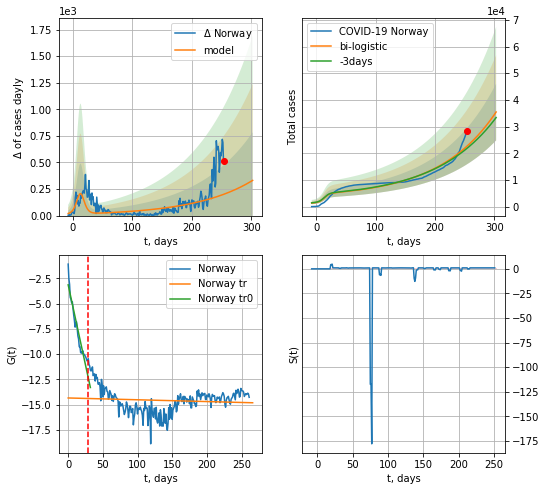

Norway data at: 2020-11-14
+3 day model MAPE: 0.0377119566292913
model: bi-logistic
coeffs:  [8.17313362e+07 1.03473560e-02 1.06068248e+03] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2997816519090709
forecast at the end of period: +49 days
	 deltaDaycases:  330
	 total cases:  35460 ± 10630
	 total death:  366 ± 329
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.009265
 intercept: -14.325686
 slope: -0.001777


In [541]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

In [542]:
vL = 28#len(dfNG)-13-dT
#x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
#xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


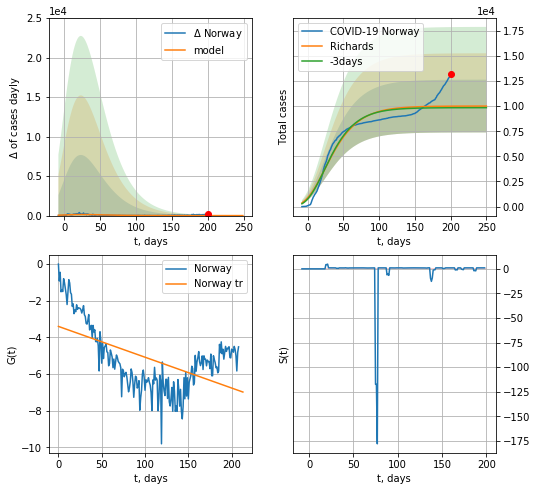

Norway data at: 2020-11-14
+3 day model MAPE: 0.015762
model: Richards
coeffs: [ 1.00040704e+04  1.30654907e+01 -1.29861253e+02  2.91049631e-03]
rational stdev: 0.262498
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 10002 ± 2625
	 total death: 103 ± 81
trend coefficient of determination: 0.314756
 intercept: -3.399379
 slope: -0.016798
diffStd0a 0.6355298240213811


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


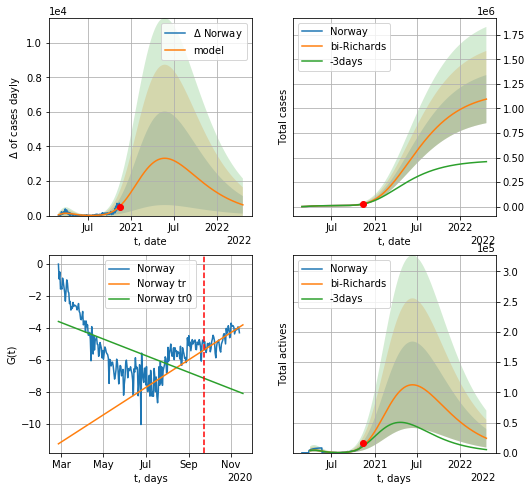

Norway data at: 2020-11-14
+3 day model MAPE: 0.030490
model: bi-Richards
coeffs: [1.16671187e+06 2.55297818e-01 1.35856012e+00 3.07280950e-02]
rational stdev: 0.223854
forecast at the end of period: +525 days
	 deltaDaycases: 621
	 total cases: 1094714 ± 245056
	 total death: 11319 ± 7601
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.313181
 intercept: -3.618282
 slope: -0.016895
trend coefficient of determination: 0.586858
 intercept: -11.257970
 slope: 0.027931


In [543]:
vL = 210#96+22#170#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Norway',dfNG[:],d1,108*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

In [544]:
#x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


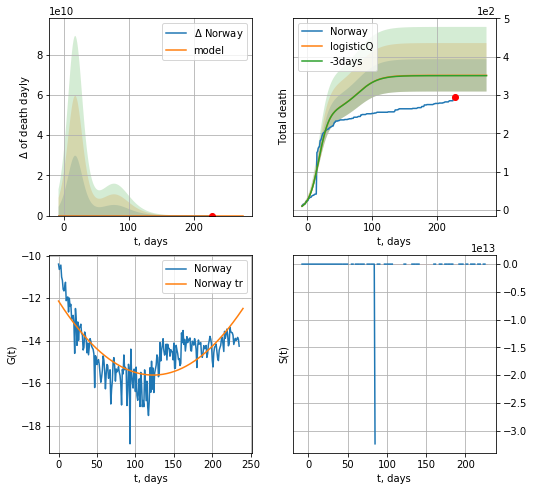

Norway data at: 2020-11-14
+3 day model MAPE: 0.002365
model: logisticQ
coeffs: [ 2.59463051e+02  1.32530876e-07  1.80198678e+01 -9.55703974e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.120064
forecast at the end of period: +49 days
	 total death: 351 ± 42
trend coefficient of determination: 0.559082
 intercept_: -12.138746656038037
 coeffs_: [ 0.         -0.05654689  0.00022957]


In [545]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date   cases  active   death
259 2020-11-10  162240       0  6057.0
260 2020-11-11  166707       0  6082.0
261 2020-11-12  171365       0  6122.0
262 2020-11-13  177355       0  6164.0
263 2020-11-14  177355       0  6164.0


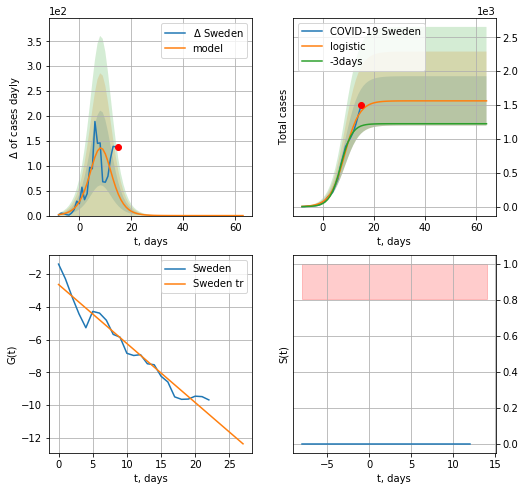

Sweden data at: 2020-11-14
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1562 ± 363
	 total death:  54 ± 37
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:486: RuntimeWarning: divide by zero encountered in log


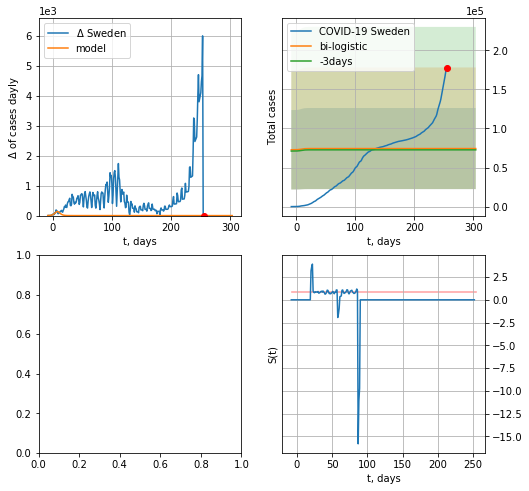

In [546]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date   cases  active   death
258 2020-11-09  158142       0  6022.0
259 2020-11-10  162240       0  6057.0
260 2020-11-11  166707       0  6082.0
261 2020-11-12  171365       0  6122.0
262 2020-11-13  177355       0  6164.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


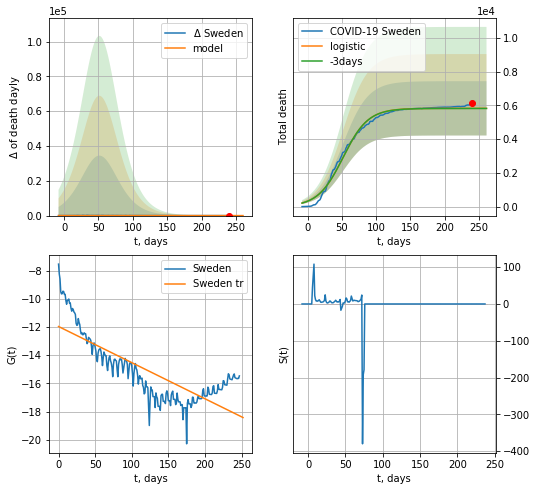

Sweden data at: 2020-11-13
+3 day model MAPE: 0.0013726209212770112
model: logistic
coeffs:  [5.82336237e+03 5.48713290e-02 5.17828457e+01]
rational stdev:  0.27618760712150897
forecast at the end of period: +21 days
	 total death:  5823 ± 1608
trend coefficient of determination: 0.628566
 intercept: -11.969063
 slope: -0.025625


In [147]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


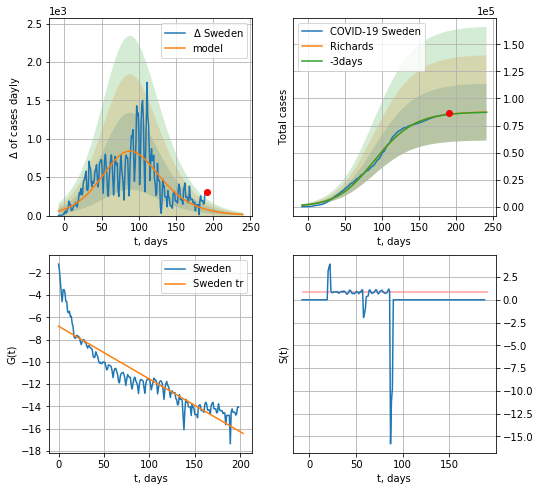

Sweden data at: 2020-11-13
+3 day model MAPE: 0.001624
model: Richards
coeffs: [8.78275804e+04 4.73720199e-02 8.00051782e+01 7.42307087e-01]
rational stdev: 0.300484
forecast at the end of period: +50 days
	 deltaDaycases: 14
	 total cases: 87417 ± 26267
	 total death: 3038 ± 2738
trend coefficient of determination: 0.834538
 intercept: -6.794116
 slope: -0.047468
diffStd0a 0.5459869827985799


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


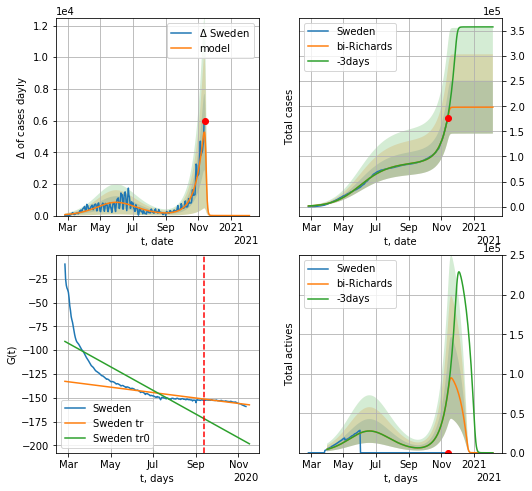

Sweden data at: 2020-11-13
+3 day model MAPE: 0.007132
model: bi-Richards
coeffs: [1.10389524e+05 6.34052977e-02 2.57205299e+02 1.28919945e+01]
rational stdev: 0.266030
forecast at the end of period: +85 days
	 deltaDaycases: 0
	 total cases: 198203 ± 52728
	 total death: 6888 ± 5497
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.678258
 intercept: -90.868171
 slope: -0.404366
trend coefficient of determination: 0.801061
 intercept: -132.782995
 slope: -0.092848


In [148]:
iL = 0
vL = 200+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Sweden',dfSW[iL:],d12f(1),45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


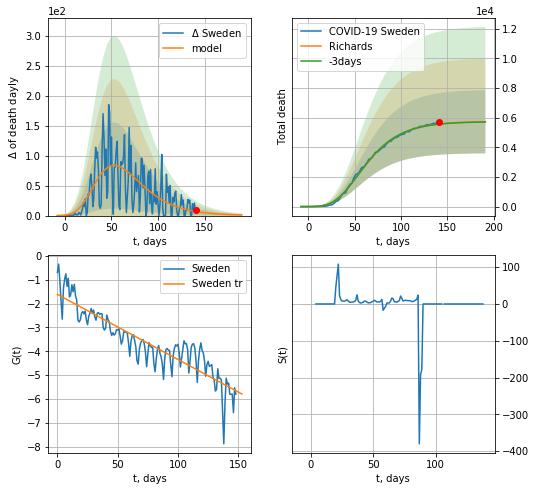

Sweden data at: 2020-11-13
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +50 days
	 total death: 5726 ± 2132
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247
diffStd0a 4.28741436394397


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


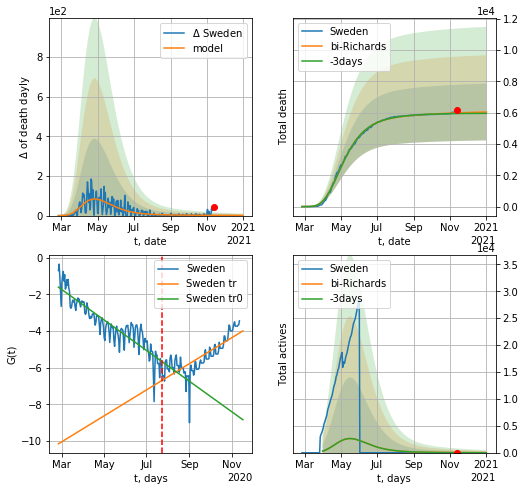

Sweden data at: 2020-11-13
+3 day model MAPE: 0.007371
model: bi-Richards
coeffs: [ 3.51624278e+02  3.38966631e+00 -1.91907004e+02  4.22797778e-03]
rational stdev: 0.299953
forecast at the end of period: +50 days
	 total death: 6040 ± 1811
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.817557
 intercept: -1.599485
 slope: -0.027192
trend coefficient of determination: 0.638658
 intercept: -10.145863
 slope: 0.023149


In [149]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RRD('Sweden',dfSW[:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

In [150]:
#x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


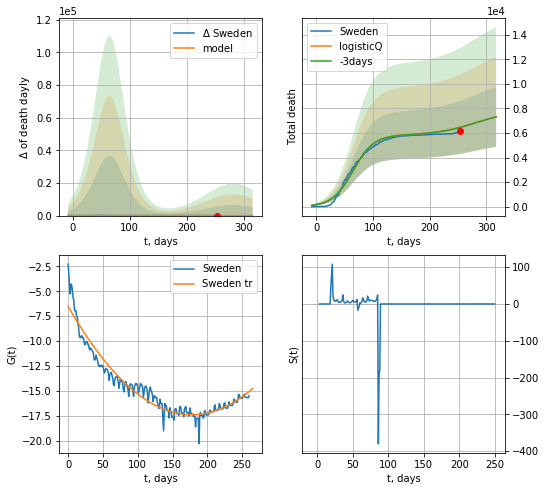

Sweden data at: 2020-11-13
+3 day model MAPE: 0.000864
model: logisticQ
coeffs: [ 5.82035268e+03  6.96442227e-08  6.47835457e+01 -7.94466583e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333889
forecast at the end of period: +64 days
	 total death: 7312 ± 2441
trend coefficient of determination: 0.933427
 intercept_: -6.52423414584902
 coeffs_: [ 0.         -0.12220094  0.00034404]


In [151]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
293 2020-11-10  86284.0     422  4634.0
294 2020-11-11  86299.0     413  4634.0
295 2020-11-12  86307.0     394  4634.0
296 2020-11-13  86325.0     388  4634.0
297 2020-11-14  86338.0     385  4634.0


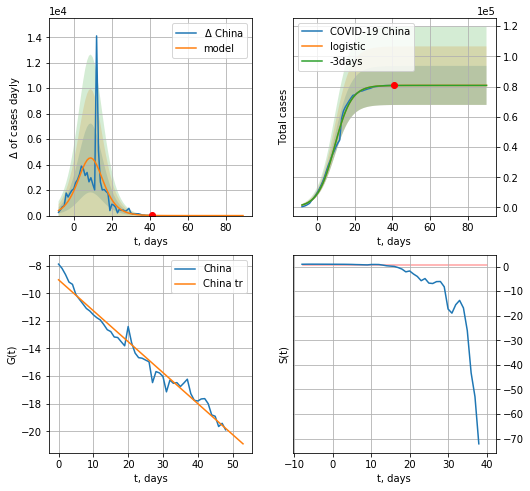

China data at: 2020-11-14
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  80810 ± 12906
	 total death:  4337 ± 2078
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


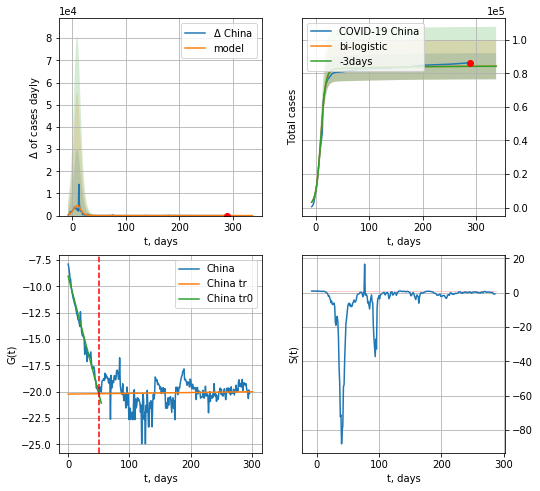

China data at: 2020-11-14
+3 day model MAPE: 0.00040553326173374044
model: bi-logistic
coeffs:  [3.56686750e+03 1.19837785e-02 1.02521789e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.0926765661249347
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  84308 ± 7813
	 total death:  4525 ± 1258
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.002113
 intercept: -20.235473
 slope: 0.000751


In [547]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [548]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

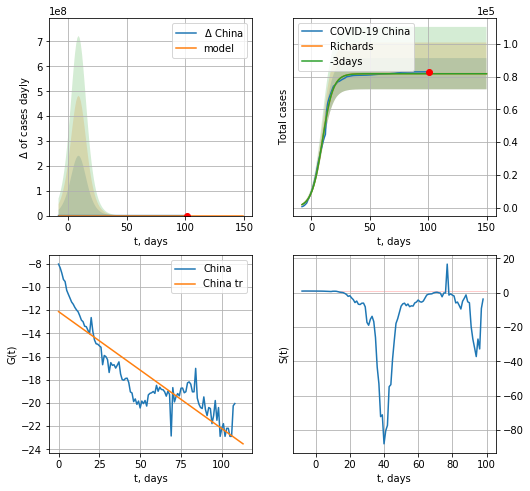

China data at: 2020-11-14
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4389 ± 1533
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960
diffStd0a 3.638656477495795


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


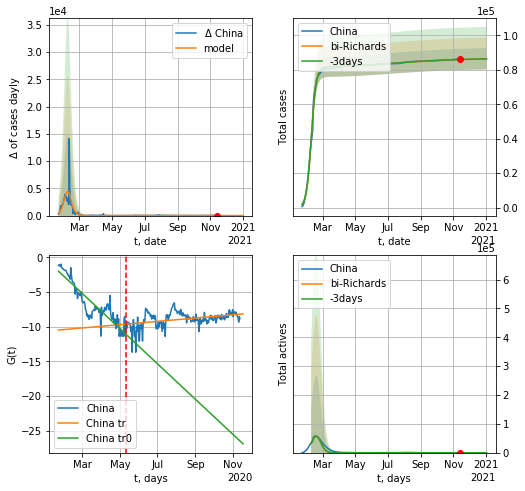

China data at: 2020-11-14
+3 day model MAPE: 0.000315
model: bi-Richards
coeffs: [ 5.16483252e+03  2.10453954e+00 -2.48348567e+02  6.02060817e-03]
rational stdev: 0.071437
forecast at the end of period: +49 days
	 deltaDaycases: 5
	 total cases: 86453 ± 6175
	 total death: 4640 ± 994
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820987
 intercept: -2.013541
 slope: -0.082739
trend coefficient of determination: 0.155322
 intercept: -10.499785
 slope: 0.007744


In [549]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RRD('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=vL,amc=0.5)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

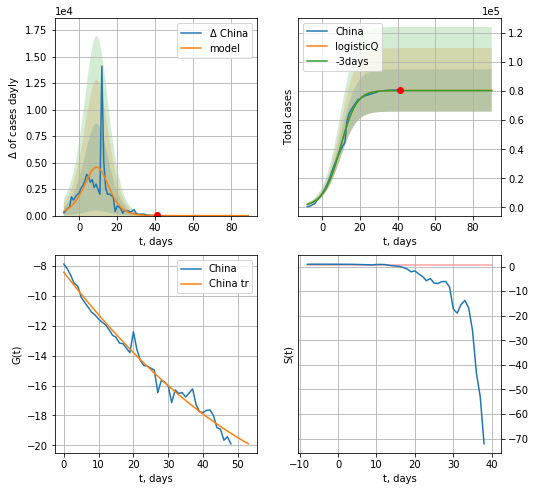

China data at: 2020-11-14
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4316 ± 2343
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


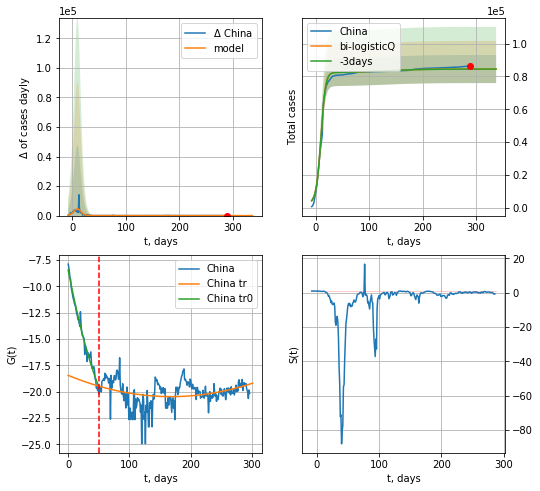

China data at: 2020-11-14
+3 day model MAPE: 0.000494
model: bi-logisticQ
coeffs: [ 4.14080566e+03  7.64803976e-05  2.47724431e+01 -5.22242662e-02]
rational stdev: 0.101354
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 84557 ± 8570
	 total death: 4538 ± 1379
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.080664
 intercept_: -18.452150057676658
 coeffs_: [ 0.00000000e+00 -2.40844715e-02  7.17780644e-05]


In [550]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [551]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
269 2020-11-10  27799  2046.0  487.0
270 2020-11-11  27942  2051.0  487.0
271 2020-11-12  28133  2108.0  488.0
272 2020-11-13  28338  2210.0  492.0
273 2020-11-14  28546  2362.0  493.0


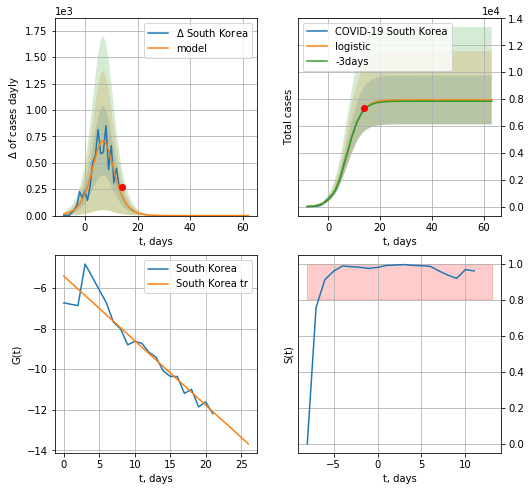

South Korea data at: 2020-11-14
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  7941 ± 1807
	 total death:  137 ± 93
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


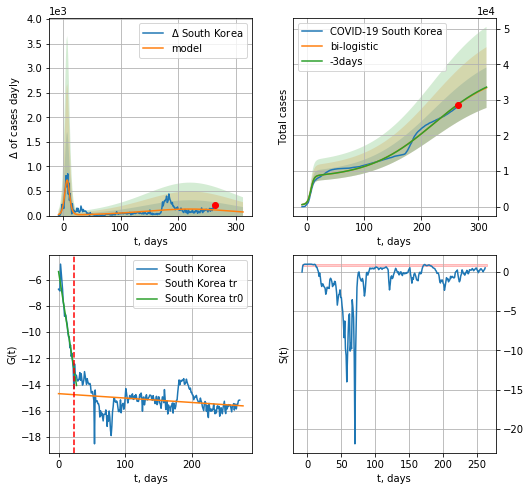

South Korea data at: 2020-11-14
+3 day model MAPE: 0.002315001152781726
model: bi-logistic
coeffs:  [3.05339074e+04 1.74079919e-02 2.21011316e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.17013395909776519
forecast at the end of period: +49 days
	 deltaDaycases:  73
	 total cases:  33425 ± 5686
	 total death:  577 ± 294
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.073480
 intercept: -14.688818
 slope: -0.003358


In [552]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [553]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

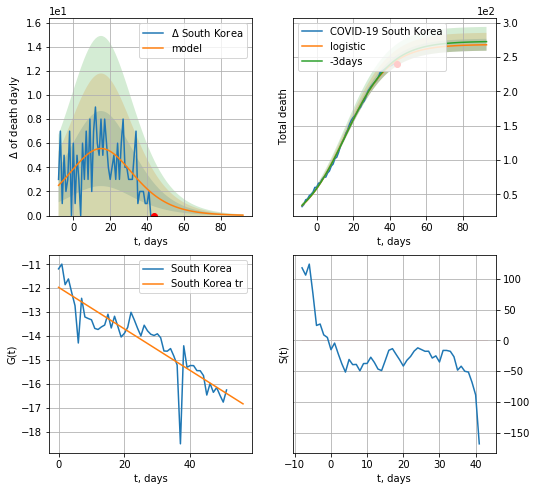

South Korea data at: 2020-11-14
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +49 days
	 total death:  268 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in true_divide


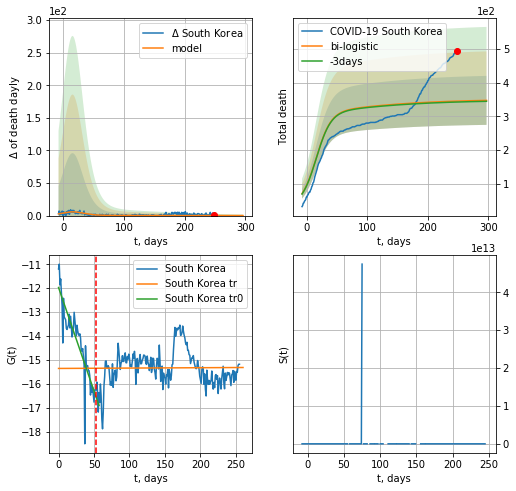

South Korea data at: 2020-11-14
+3 day model MAPE: 0.007789099739025831
model: bi-logistic
coeffs:  [8.23164345e+01 1.09990166e-02 9.75948315e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.2092930300991117
forecast at the end of period: +49 days
	 deltaDaydeath:  0
	 total death:  347 ± 72
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.000158
 intercept: -15.357235
 slope: 0.000151


In [554]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


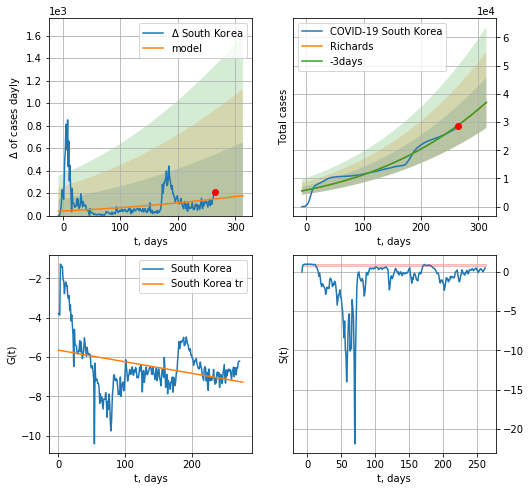

South Korea data at: 2020-11-14
+3 day model MAPE: 0.002504
model: Richards
coeffs: [ 8.01696897e+05  1.50643005e-02 -9.00063113e+01  1.24694421e-01]
rational stdev: 0.243217
forecast at the end of period: +49 days
	 deltaDaycases: 176
	 total cases: 36855 ± 8963
	 total death: 636 ± 464
trend coefficient of determination: 0.110946
 intercept: -5.647468
 slope: -0.005879


In [555]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


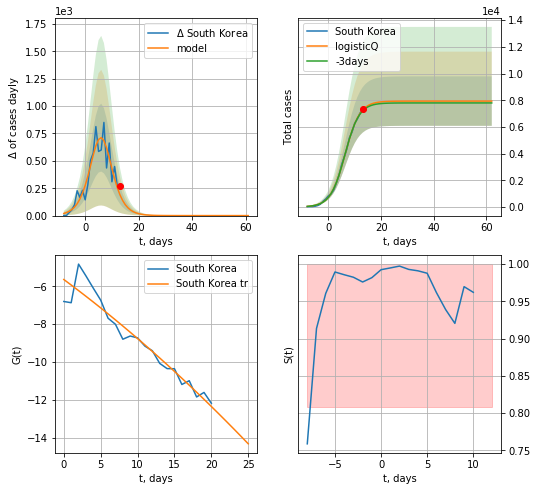

South Korea data at: 2020-11-14
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 137 ± 95
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


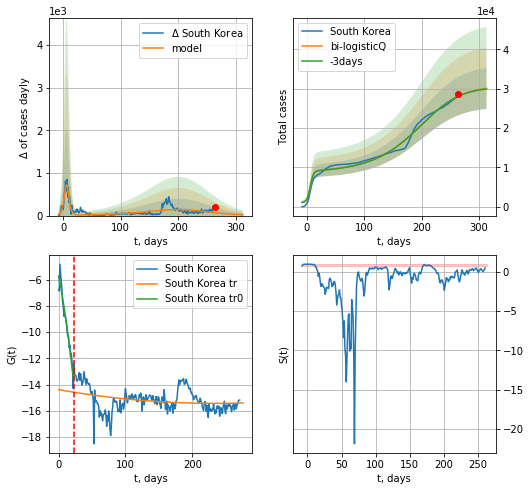

South Korea data at: 2020-11-14
+3 day model MAPE: 0.002415
model: bi-logisticQ
coeffs: [ 2.26761836e+04  4.55178056e-05  1.88941298e+02 -3.47315219e+02]
rational stdev: 0.173137
forecast at the end of period: +49 days
	 deltaDaycases: 18
	 total cases: 30080 ± 5208
	 total death: 519 ± 269
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.080645
 intercept_: -14.387024041798682
 coeffs_: [ 0.00000000e+00 -8.92294034e-03  1.90849663e-05]


In [556]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [557]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [558]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


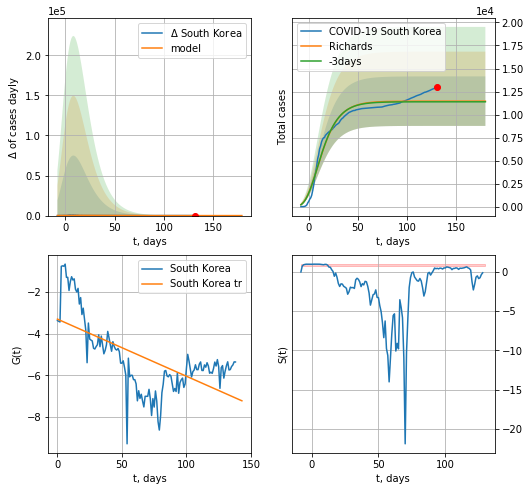

South Korea data at: 2020-11-14
+3 day model MAPE: 0.006245
model: Richards
coeffs: [ 1.14621909e+04  2.64955361e+01 -6.29475021e+01  3.05260511e-03]
rational stdev: 0.234092
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 11462 ± 2683
	 total death: 197 ± 138
trend coefficient of determination: 0.403266
 intercept: -3.307543
 slope: -0.027367
diffStd0a 1.1361264097934232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


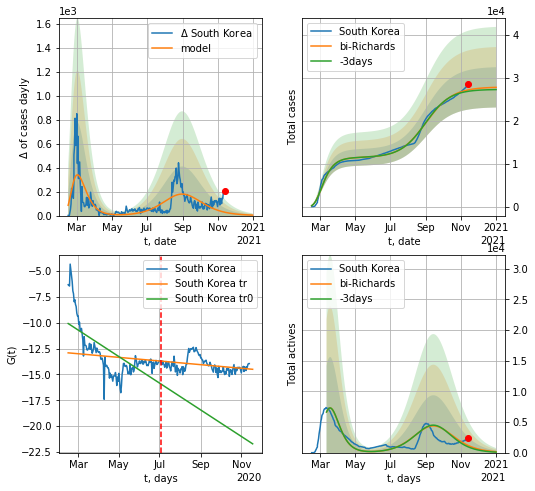

South Korea data at: 2020-11-14
+3 day model MAPE: 0.012231
model: bi-Richards
coeffs: [1.64327824e+04 4.78686887e-02 1.87783958e+02 8.79908669e-01]
rational stdev: 0.168742
forecast at the end of period: +49 days
	 deltaDaycases: 3
	 total cases: 27803 ± 4691
	 total death: 480 ± 242
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.454699
 intercept: -10.079401
 slope: -0.041959
trend coefficient of determination: 0.103266
 intercept: -12.911815
 slope: -0.005737


In [559]:
iL = 0
vL = 140+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RRD('South Korea',dfKR[iL:],d1,T18*7-dT,x,1.0,vL=vL-iL,amc=0.75)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [560]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [561]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
292 2020-11-10  58091.0      78   28.0
293 2020-11-11  58102.0      84   28.0
294 2020-11-12  58114.0      84   28.0
295 2020-11-13  58116.0      80   28.0
296 2020-11-14  58119.0      72   28.0


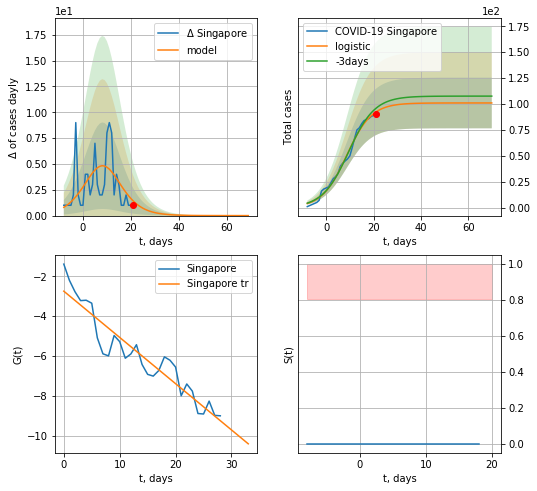

Singapore data at: 2020-11-14
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  101 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


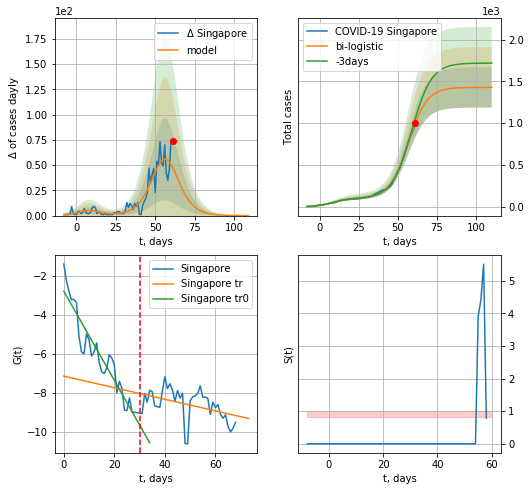

Singapore data at: 2020-11-14
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


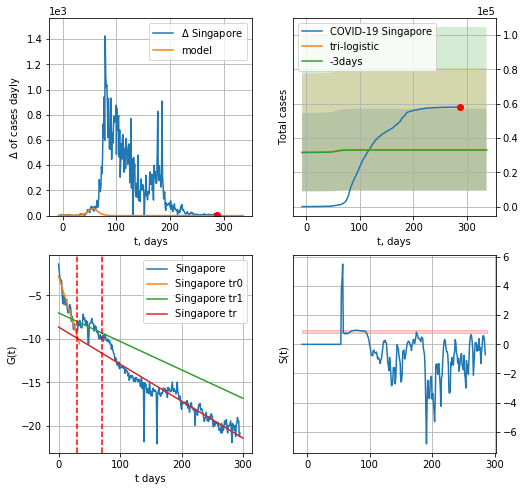

Singapore data at: 2020-11-14
+3 day model MAPE: 0.007712377466001383
model: tri-logistic
coeffs:  [ 3.17808091e+04 -1.97911883e+01  4.76799503e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.7186116851056404
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  33208 ± 23864
	 total death:  15 ± 32
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.875100
 intercept: -8.639996
 slope: -0.042660


In [562]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

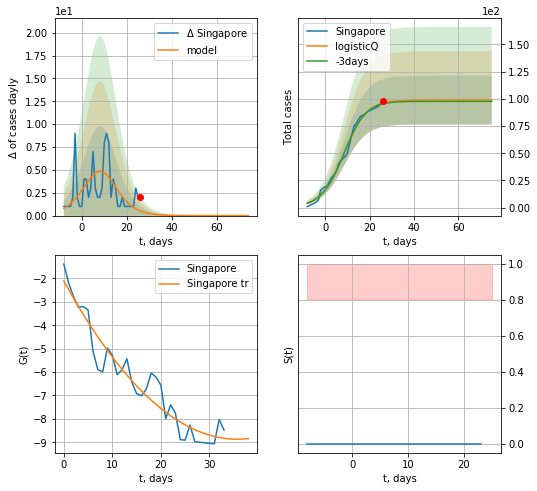

Singapore data at: 2020-11-14
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


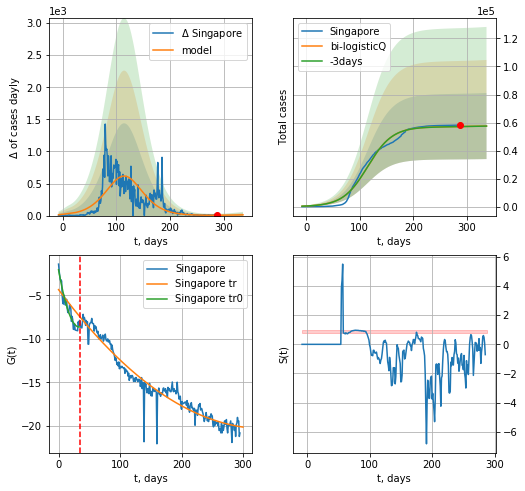

Singapore data at: 2020-11-14
+3 day model MAPE: 0.000792
model: bi-logisticQ
coeffs: [ 5.68540087e+04  5.03893460e-08  1.14721261e+02 -8.60885804e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410036
forecast at the end of period: +49 days
	 deltaDaycases: 11
	 total cases: 57507 ± 23579
	 total death: 27 ± 33
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.940604
 intercept_: -4.32563708176971
 coeffs_: [ 0.         -0.09520226  0.00014136]


In [563]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d12f(1),T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [564]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


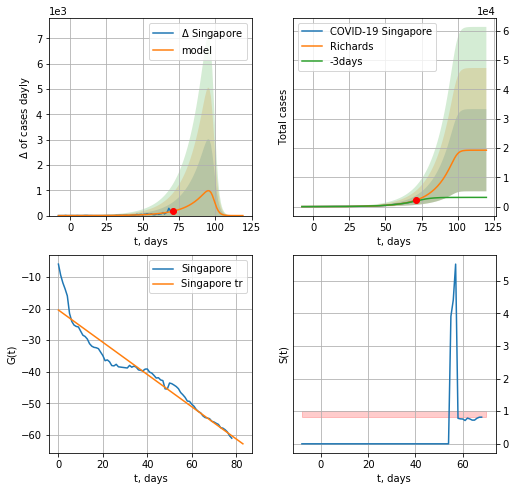

Singapore data at: 2020-11-14
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 19230 ± 14005
	 total death: 9 ± 19
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333
diffStd0a 0.448197637377704


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


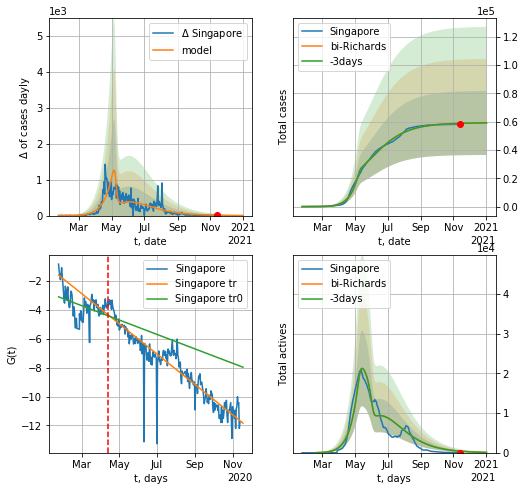

Singapore data at: 2020-11-14
+3 day model MAPE: 0.000732
model: bi-Richards
coeffs: [3.98996394e+04 1.60307217e-01 6.22795087e+01 1.76303488e-01]
rational stdev: 0.382767
forecast at the end of period: +49 days
	 deltaDaycases: 2
	 total cases: 59033 ± 22596
	 total death: 28 ± 32
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.133856
 intercept: -3.085236
 slope: -0.016271
trend coefficient of determination: 0.858170
 intercept: -1.575004
 slope: -0.034223


In [565]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RRD('Singapore',dfSG[iL:],d12f(1),T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

In [566]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    #x = forecast('Estonia',dfES[1:7],d1,17,1.)
    #xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

ES
           date   cases  active  death
243 2020-11-10  6441.0    2081   76.0
244 2020-11-11  6508.0    2054   76.0
245 2020-11-12  6881.0    2352   76.0
246 2020-11-13  7412.0    2624   80.0
247 2020-11-14  7637.0    2815   81.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


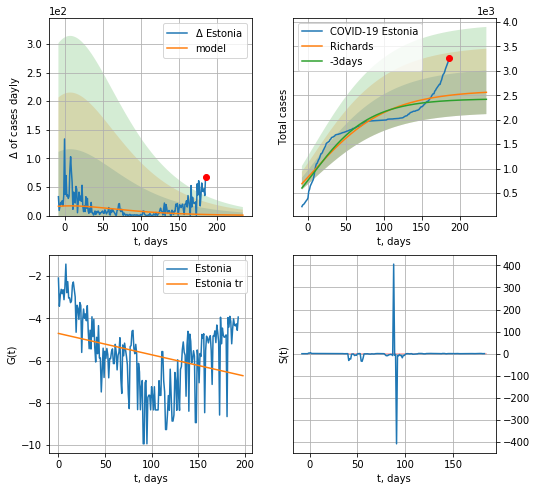

Estonia data at: 2020-11-14
+3 day model MAPE: 0.045435
model: Richards
coeffs: [ 2.60588093e+03  2.79002184e+00 -2.75729567e+02  6.38503599e-03]
rational stdev: 0.174012
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 2560 ± 445
	 total death: 27 ± 14
trend coefficient of determination: 0.100431
 intercept: -4.712830
 slope: -0.010110
diffStd0a 0.9424815242395094


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


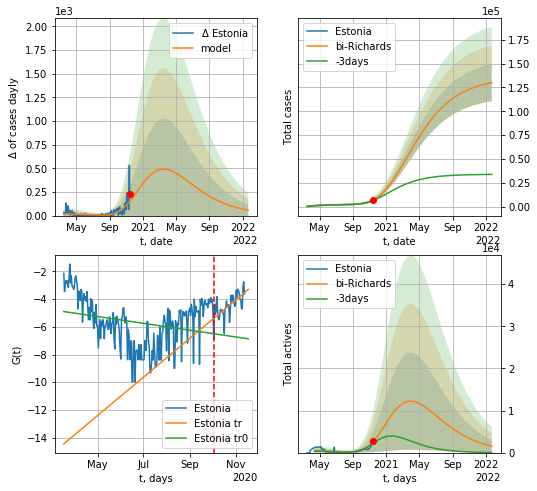

Estonia data at: 2020-11-14
+3 day model MAPE: 0.062511
model: bi-Richards
coeffs: [ 1.33102567e+05  7.92032269e-01 -7.50793221e+01  1.27412846e-02]
rational stdev: 0.149418
forecast at the end of period: +434 days
	 deltaDaycases: 56
	 total cases: 130049 ± 19431
	 total death: 1379 ± 618
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.067398
 intercept: -4.896299
 slope: -0.008002
trend coefficient of determination: 0.434375
 intercept: -14.448599
 slope: 0.045316


In [567]:
iL = 5
vL=200+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RRD('Estonia',dfES[iL:],d12f(1),7*95-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

In [568]:
#x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date    cases  active  death
248 2020-11-10   8395.0    6821  103.0
249 2020-11-11   8848.0    7272  105.0
250 2020-11-12   9381.0    7759  107.0
251 2020-11-13   9836.0    8205  116.0
252 2020-11-14  10231.0    8595  121.0


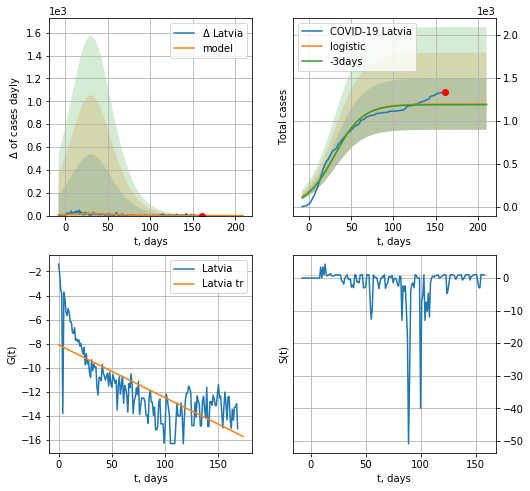

Latvia data at: 2020-11-14
+3 day model MAPE: 0.006385594006530808
model: logistic
coeffs:  [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.2505192877675996
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1194 ± 299
	 total death:  14 ± 10
trend coefficient of determination: 0.548772
 intercept: -8.111036
 slope: -0.044049


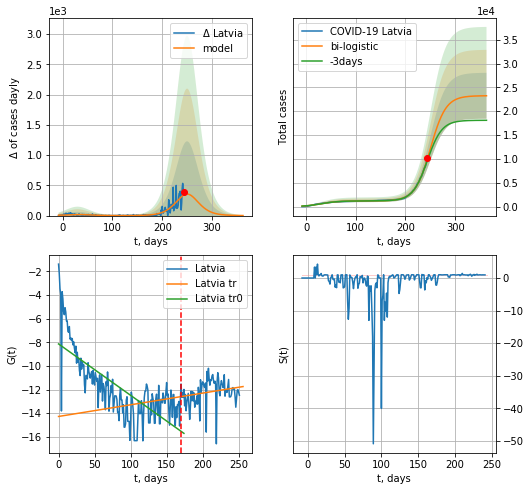

Latvia data at: 2020-11-14
+3 day model MAPE: 0.03976030951472039
model: bi-logistic
coeffs:  [2.20563637e+04 6.46160694e-02 2.50284252e+02] [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.2071027674566607
forecast at the end of period: +119 days
	 deltaDaycases:  1
	 total cases:  23235 ± 4812
	 total death:  274 ± 170
bi-logistic approximation splitting point: 170
trend0 coefficient of determination: 0.544306
 intercept: -8.141730
 slope: -0.043501
trend coefficient of determination: 0.048473
 intercept: -14.281734
 slope: 0.009885


In [569]:
vL=170
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,50*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


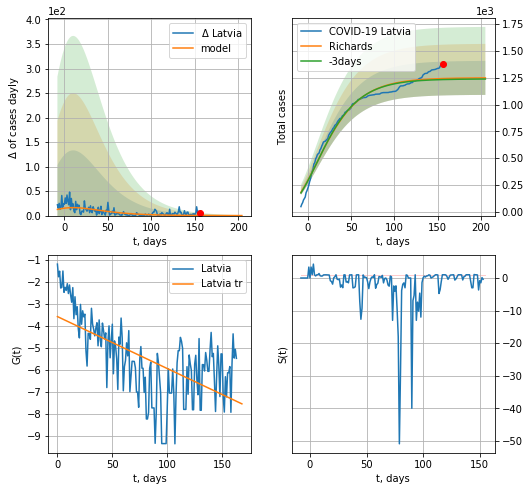

Latvia data at: 2020-11-14
+3 day model MAPE: 0.007772
model: Richards
coeffs: [ 1.24930626e+03  6.40625024e+00 -1.35573848e+02  5.54745387e-03]
rational stdev: 0.126894
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1248 ± 158
	 total death: 14 ± 5
trend coefficient of determination: 0.384319
 intercept: -3.580648
 slope: -0.023612
diffStd0a 1.089820460372807


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


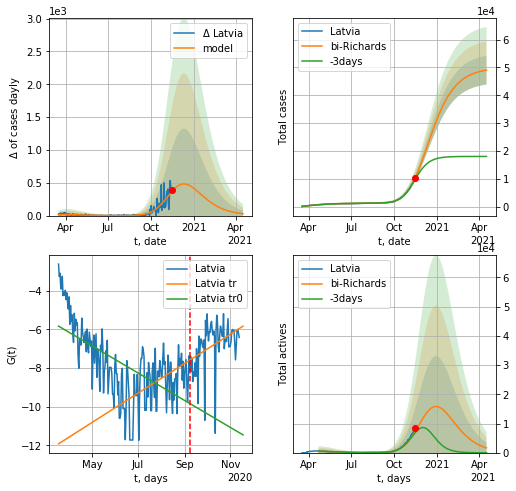

Latvia data at: 2020-11-14
+3 day model MAPE: 0.049844
model: bi-Richards
coeffs: [4.86657450e+04 9.15949767e-02 2.26890745e+02 3.43349344e-01]
rational stdev: 0.105519
forecast at the end of period: +154 days
	 deltaDaycases: 27
	 total cases: 49032 ± 5173
	 total death: 579 ± 183
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.372957
 intercept: -5.838298
 slope: -0.022844
trend coefficient of determination: 0.171692
 intercept: -11.919215
 slope: 0.024704


In [570]:
iL=10
vL = 175+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Latvia',dfLV[iL:],d12f(1),7*55-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

In [571]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
#x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


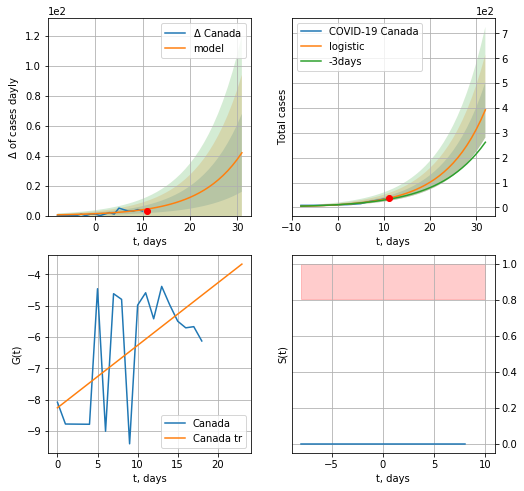

Canada data at: 2020-11-14
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  14 ± 11
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


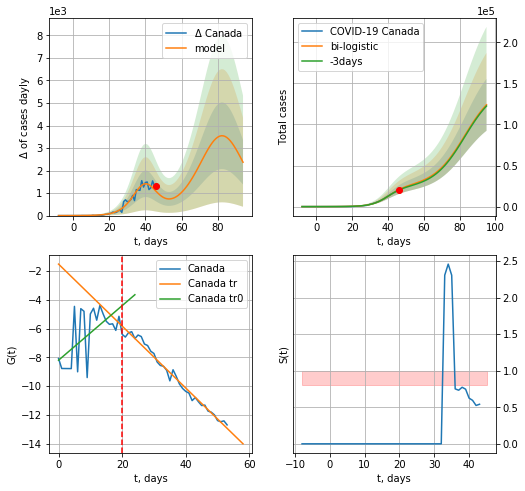

Canada data at: 2020-11-14
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +49 days
	 deltaDaycases:  2370
	 total cases:  123956 ± 31600
	 total death:  4624 ± 3536
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


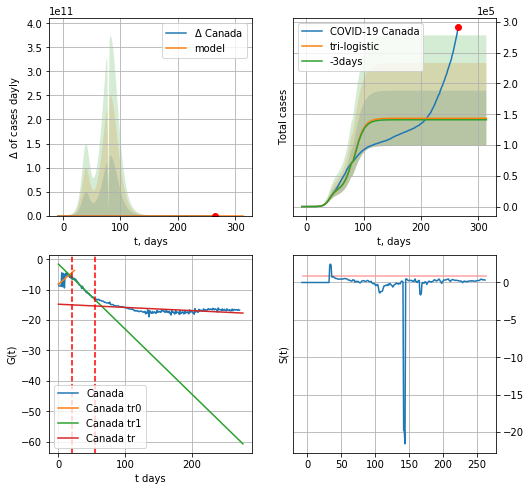

Canada data at: 2020-11-14
+3 day model MAPE: 0.016864509230783507
model: tri-logistic
coeffs:  [-5.89933719e+03  2.45779856e+00  7.94410085e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  0.3129990610072037
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  143459 ± 44902
	 total death:  5351 ± 5024
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.314532
 intercept: -14.773650
 slope: -0.010504


In [572]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active    death
269 2020-11-10  273037.0   41126  10632.0
270 2020-11-11  277061.0   43177  10685.0
271 2020-11-12  282577.0   45034  10768.0
272 2020-11-13  287318.0   45844  10828.0
273 2020-11-14  291931.0   48125  10891.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


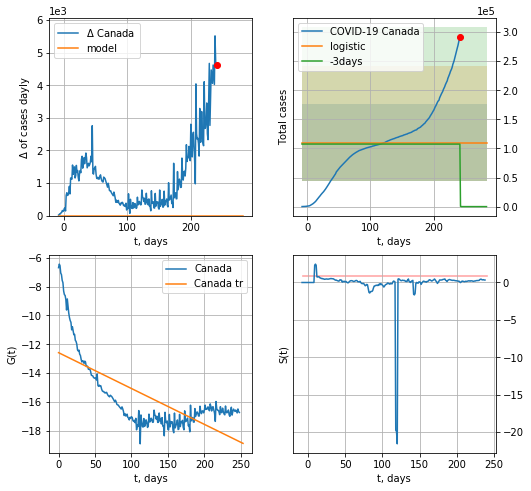

Canada data at: 2020-11-14
+3 day model MAPE: 259.022021815118
model: logistic
coeffs:  [109679.26792813   -150.08321474    580.74482409]
rational stdev:  0.6054315267454603
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  109679 ± 66403
	 total death:  4091 ± 7430
trend coefficient of determination: 0.492556
 intercept: -12.585354
 slope: -0.024854


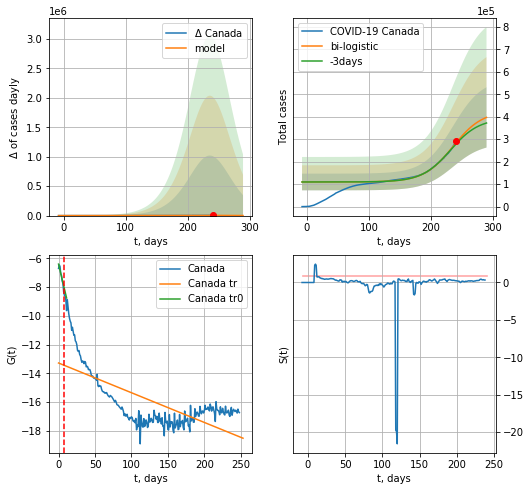

Canada data at: 2020-11-14
+3 day model MAPE: 0.018114288603170454
model: bi-logistic
coeffs:  [3.16489204e+05 4.23826875e-02 2.36044396e+02] [109679.26792813   -150.08321474    580.74482409]
rational stdev:  0.33811647351796176
forecast at the end of period: +49 days
	 deltaDaycases:  1142
	 total cases:  396980 ± 134225
	 total death:  14810 ± 15022
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.470612
 intercept: -13.277957
 slope: -0.020698


In [573]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

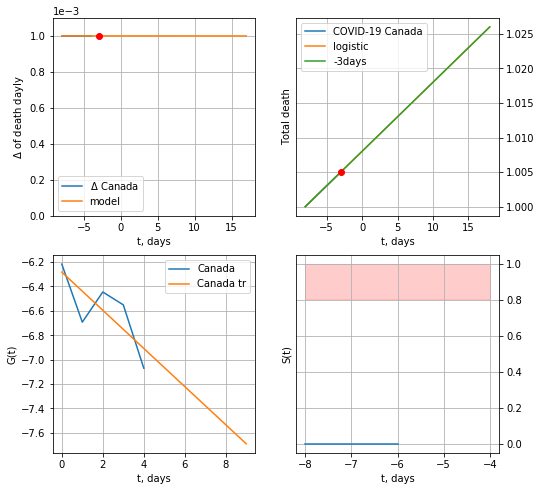

Canada data at: 2020-11-14
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


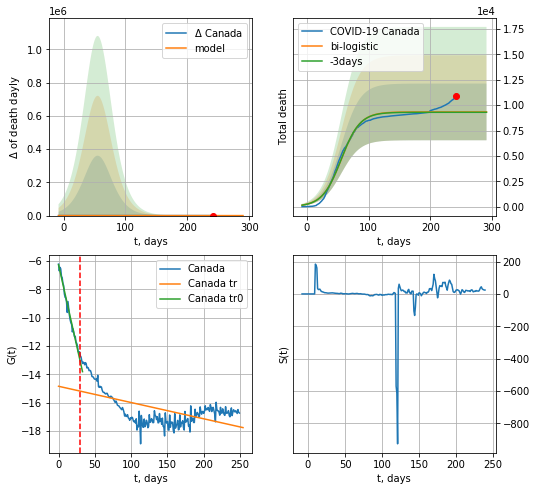

Canada data at: 2020-11-14
+3 day model MAPE: 0.003984247984594144
model: bi-logistic
coeffs:  [9.33544424e+03 6.51751105e-02 5.56099185e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.29920272678645965
forecast at the end of period: +49 days
	 deltaDaydeath:  0
	 total death:  9336 ± 2793
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.341941
 intercept: -14.841870
 slope: -0.011488


In [574]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


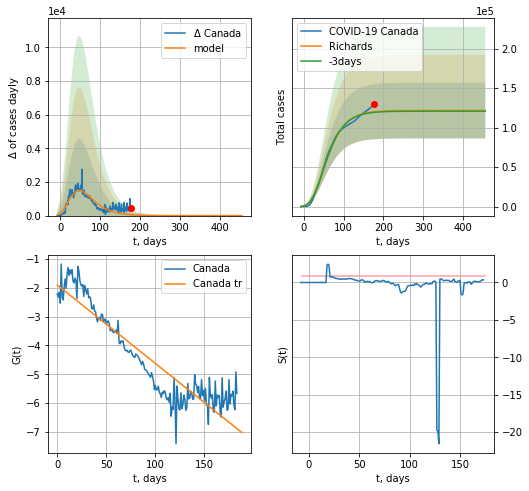

Canada data at: 2020-11-14
+3 day model MAPE: 0.006183
model: Richards
coeffs: [ 1.21659605e+05  6.14824851e+00 -1.08149315e+02  5.44441705e-03]
rational stdev: 0.289891
forecast at the end of period: +280 days
	 deltaDaycases: 0
	 total cases: 121659 ± 35267
	 total death: 4538 ± 3946
trend coefficient of determination: 0.846084
 intercept: -1.903764
 slope: -0.027207
diffStd0a 0.9871725819501117


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


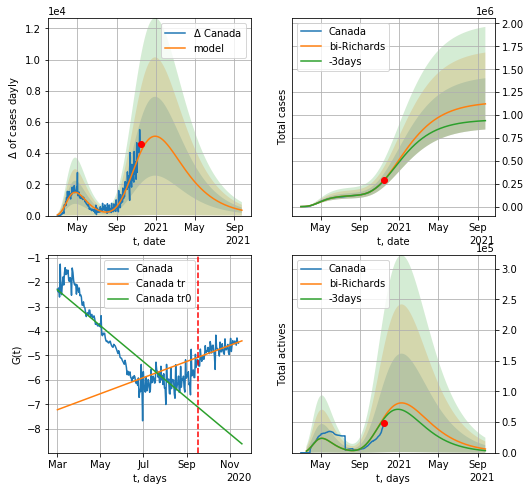

Canada data at: 2020-11-14
+3 day model MAPE: 0.009283
model: bi-Richards
coeffs: [1.02591695e+06 4.95741584e-01 3.29026105e+01 2.75794956e-02]
rational stdev: 0.249660
forecast at the end of period: +315 days
	 deltaDaycases: 345
	 total cases: 1122140 ± 280153
	 total death: 41863 ± 31354
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.775187
 intercept: -2.319645
 slope: -0.024006
trend coefficient of determination: 0.375995
 intercept: -7.216441
 slope: 0.010742


In [575]:
iL = 15
vL = 200 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Canada',dfCA[iL:],d1,78*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

In [576]:
#x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date   cases  active   death
253 2020-11-10  187237   77338  3021.0
254 2020-11-11  192172   78716  3103.0
255 2020-11-12  198011   81141  3181.0
256 2020-11-13  204664   84032  3250.0
257 2020-11-14  211266   85444  3305.0


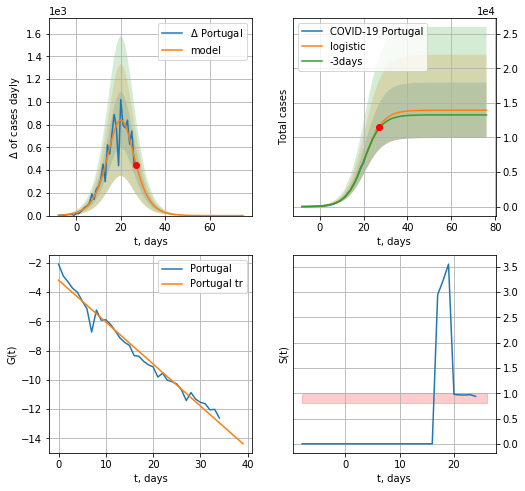

Portugal data at: 2020-11-14
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  13943 ± 4016
	 total death:  218 ± 188
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


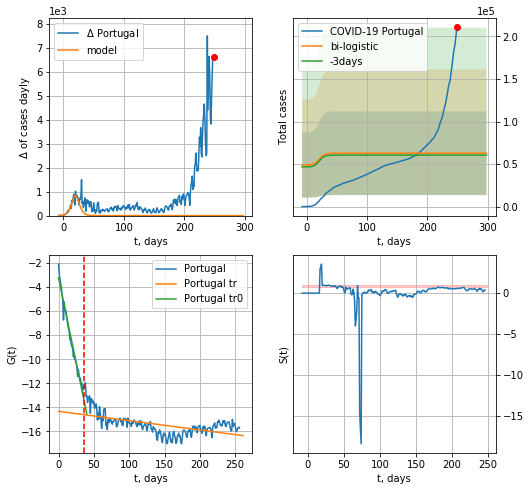

Portugal data at: 2020-11-14
+3 day model MAPE: 0.036850576887405874
model: bi-logistic
coeffs:  [ 3.90464952e+04 -1.40371827e+01  3.44098983e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.7837509817484528
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  62751 ± 49181
	 total death:  981 ± 2306
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.322228
 intercept: -14.336846
 slope: -0.007759


In [577]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


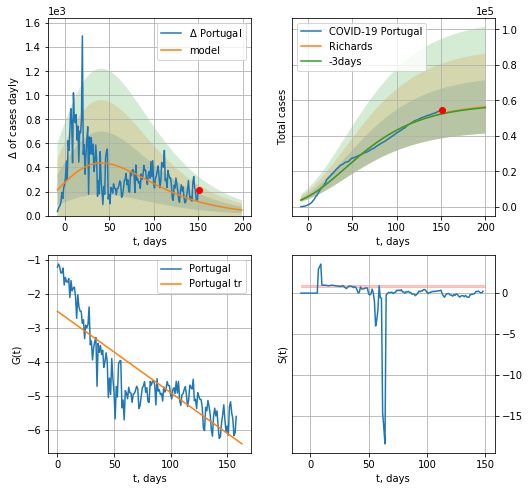

Portugal data at: 2020-11-14
+3 day model MAPE: 0.005487
model: Richards
coeffs: [ 5.85732808e+04  3.00313335e+00 -2.03470726e+02  6.78095718e-03]
rational stdev: 0.266912
forecast at the end of period: +49 days
	 deltaDaycases: 46
	 total cases: 56285 ± 15023
	 total death: 880 ± 704
trend coefficient of determination: 0.725401
 intercept: -2.517362
 slope: -0.023928
diffStd0a 0.4890547748766466


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


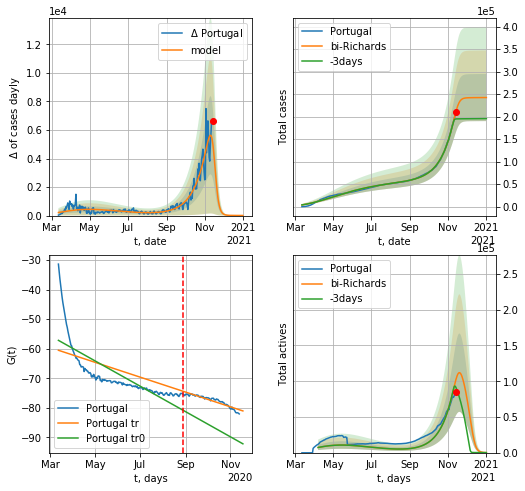

Portugal data at: 2020-11-14
+3 day model MAPE: 0.103689
model: bi-Richards
coeffs: [1.84151024e+05 4.81589665e-02 2.41741886e+02 6.40956629e+00]
rational stdev: 0.215843
forecast at the end of period: +49 days
	 deltaDaycases: 7
	 total cases: 242336 ± 52306
	 total death: 3791 ± 2454
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.613710
 intercept: -57.159141
 slope: -0.139465
trend coefficient of determination: 0.876675
 intercept: -60.519758
 slope: -0.081746


In [578]:
iL = 10
vL=170+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

In [579]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

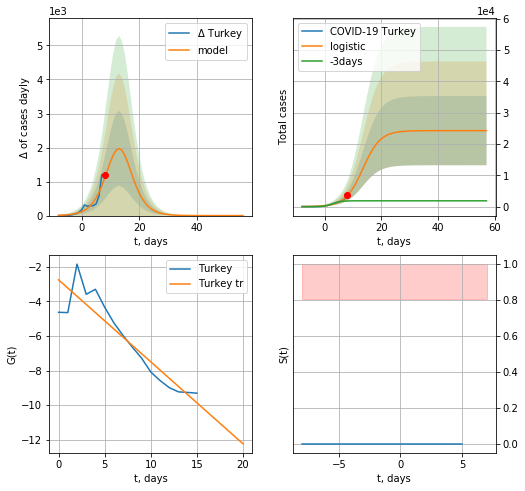

Turkey data at: 2020-11-14
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  24267 ± 11046
	 total death:  674 ± 920
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


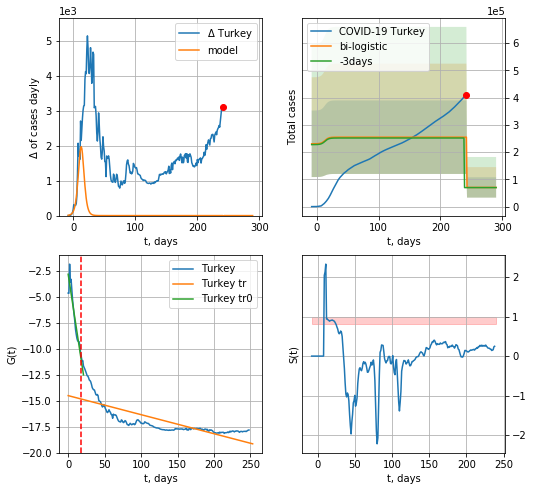

Turkey data at: 2020-11-14
+3 day model MAPE: 2.652195823236895
model: bi-logistic
coeffs:  [ 1.84453129e+05 -1.12285192e+02  2.42361660e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5294863932594387
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  70380 ± 37265
	 total death:  1954 ± 3103
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.584400
 intercept: -14.496439
 slope: -0.018339


In [580]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


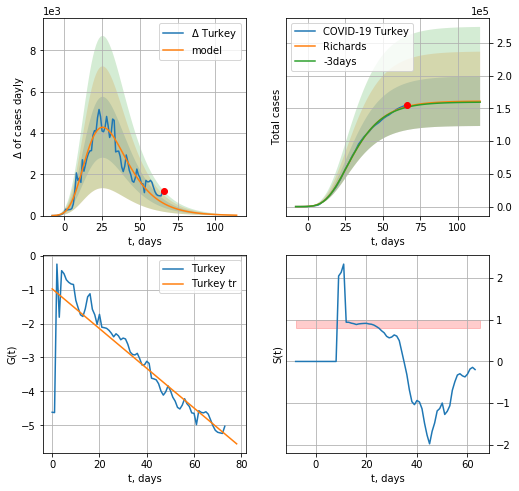

Turkey data at: 2020-11-14
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +49 days
	 deltaDaycases: 18
	 total cases: 160985 ± 37843
	 total death: 4471 ± 3153
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549
diffStd0a 0.41786655322704175


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


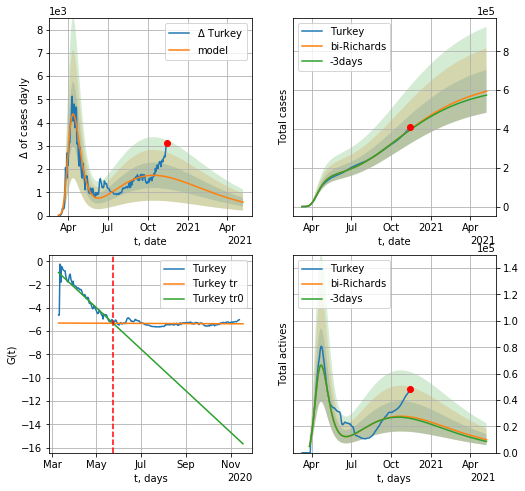

Turkey data at: 2020-11-14
+3 day model MAPE: 0.006793
model: bi-Richards
coeffs: [ 4.97646237e+05  8.90412749e-01 -2.66501579e+02  1.06979281e-02]
rational stdev: 0.186259
forecast at the end of period: +175 days
	 deltaDaycases: 579
	 total cases: 593754 ± 110592
	 total death: 16492 ± 9215
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.778422
 intercept: -0.974380
 slope: -0.058087
trend coefficient of determination: 0.005772
 intercept: -5.305451
 slope: -0.000256


In [581]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [582]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

In [583]:
#x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [584]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0],dfTT[dfTT.Country=='%s'%("Lithuania")][0].values[0]

(0.011826800899227836, 0.007967172851708748)

In [585]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date     cases  active    death
251 2020-11-10  593592.0  354556   8375.0
252 2020-11-11  618813.0  367133   8805.0
253 2020-11-12  641496.0  378067   9080.0
254 2020-11-13  665547.0  373833   9499.0
255 2020-11-14  691118.0  386290  10045.0


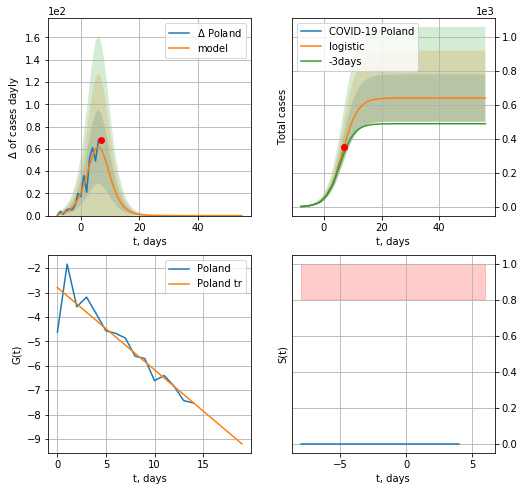

Poland data at: 2020-11-14
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  641 ± 139
	 total death:  9 ± 5
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


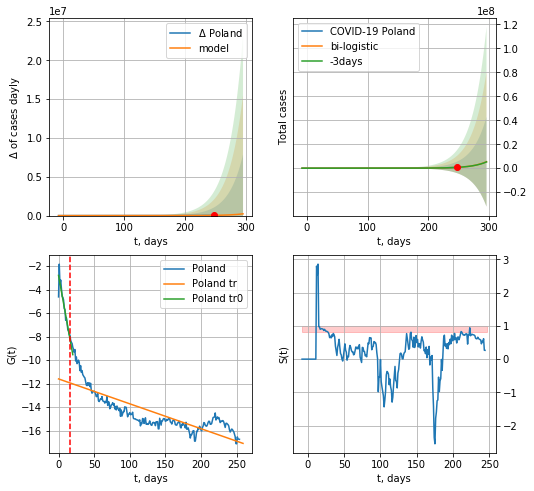

Poland data at: 2020-11-14
+3 day model MAPE: 0.010560753788158668
model: bi-logistic
coeffs:  [2.72140259e+09 4.23320647e-02 4.42738401e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  6.877883384382284
forecast at the end of period: +49 days
	 deltaDaycases:  225358
	 total cases:  5448155 ± 37471779
	 total death:  79185 ± 1633875
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.660436
 intercept: -11.603791
 slope: -0.021178


In [586]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


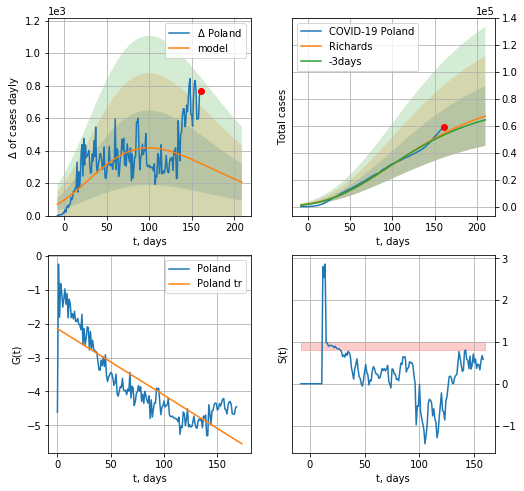

Poland data at: 2020-11-14
+3 day model MAPE: 0.021663
model: Richards
coeffs: [ 8.41741058e+04  1.47966569e+00 -2.46676717e+02  9.14859854e-03]
rational stdev: 0.328700
forecast at the end of period: +49 days
	 deltaDaycases: 206
	 total cases: 67171 ± 22079
	 total death: 976 ± 962
trend coefficient of determination: 0.711205
 intercept: -2.146265
 slope: -0.019650
diffStd0a 0.32349668816294164


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


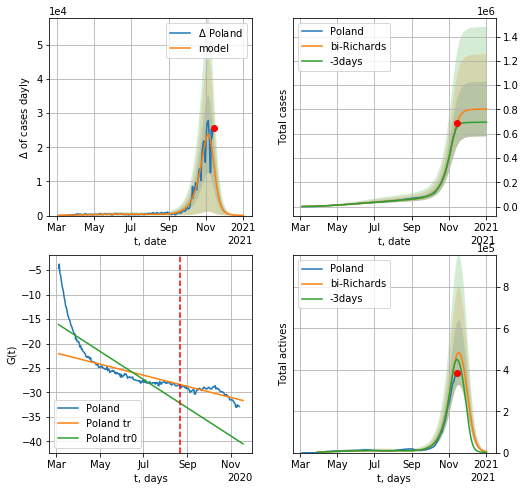

Poland data at: 2020-11-14
+3 day model MAPE: 0.054815
model: bi-Richards
coeffs: [7.24919242e+05 8.07329630e-02 2.42795935e+02 2.19847310e+00]
rational stdev: 0.280523
forecast at the end of period: +49 days
	 deltaDaycases: 80
	 total cases: 803338 ± 225354
	 total death: 11676 ± 9826
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.691062
 intercept: -16.122298
 slope: -0.094100
trend coefficient of determination: 0.581341
 intercept: -22.061839
 slope: -0.037027


In [587]:
vL = 170
x =  forecastRR('Poland',dfPL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RRD('Poland',dfPL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

In [588]:
#x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
262 2020-11-10  320912.0    8167  2684.0
263 2020-11-11  321326.0    8021  2700.0
264 2020-11-12  322159.0    8848  2706.0
265 2020-11-13  322695.0    7848  2716.0
266 2020-11-14  323460.0    7916  2721.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


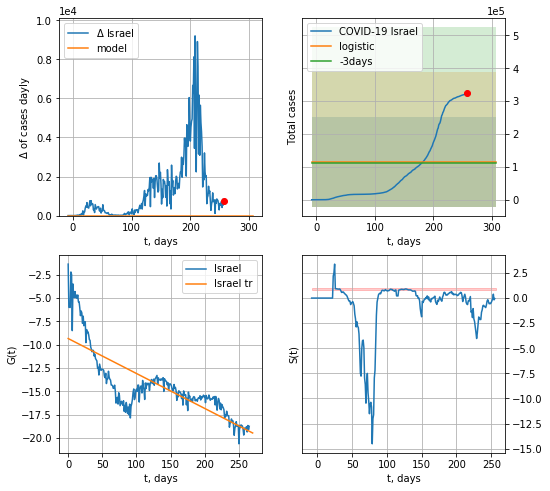

Israel data at: 2020-11-14
+3 day model MAPE: 0.02905449969227035
model: logistic
coeffs:  [ 9.26277801e+04 -3.91712299e+01  9.41483854e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.180081589268789
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  115784 ± 136635
	 total death:  974 ± 3448
trend coefficient of determination: 0.639309
 intercept: -9.344366
 slope: -0.037404


In [589]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


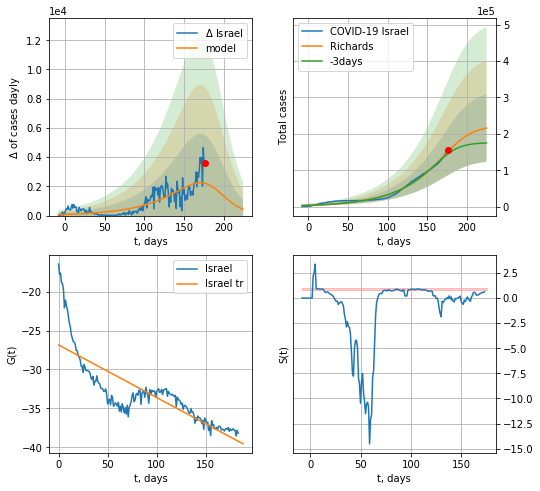

Israel data at: 2020-11-14
+3 day model MAPE: 0.043052
model: Richards
coeffs: [2.22982517e+05 2.18053289e-02 1.87753593e+02 2.87495191e+00]
rational stdev: 0.429268
forecast at the end of period: +49 days
	 deltaDaycases: 427
	 total cases: 215929 ± 92691
	 total death: 1816 ± 2338
trend coefficient of determination: 0.666990
 intercept: -26.852072
 slope: -0.067481
diffStd0a 2.0375546137922105


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


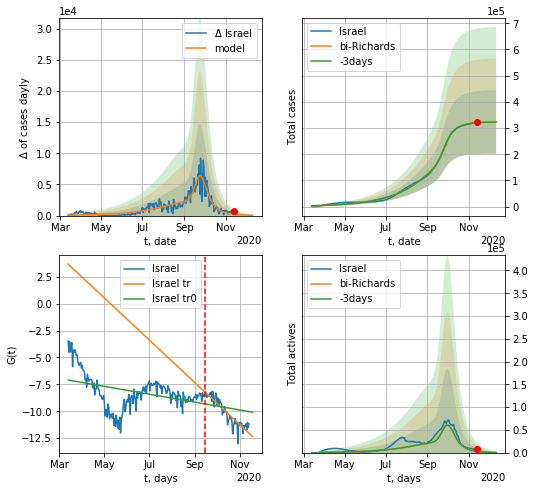

Israel data at: 2020-11-14
+3 day model MAPE: 0.001204
model: bi-Richards
coeffs: [1.00943450e+05 3.57569837e-01 1.81646466e+02 4.01538514e-01]
rational stdev: 0.373903
forecast at the end of period: +28 days
	 deltaDaycases: 37
	 total cases: 323352 ± 120902
	 total death: 2720 ± 3051
bi-Richards approximation splitting point: 185
trend coefficient of determination: 0.155977
 intercept: -7.103280
 slope: -0.011952
trend coefficient of determination: 0.825027
 intercept: 3.674869
 slope: -0.064153


In [590]:
vL = 185+20
x = forecastRR('Israel',dfIS[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Israel',dfIS[20:],d1,37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.33)

In [591]:
#x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [592]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date     cases  active   death
259 2020-11-10  235202.0  109589  3013.0
260 2020-11-11  243472.0  110359  3113.0
261 2020-11-12  250396.0  106180  3216.0
262 2020-11-13  257135.0  112820  3315.0
263 2020-11-14  257135.0  112784  3351.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


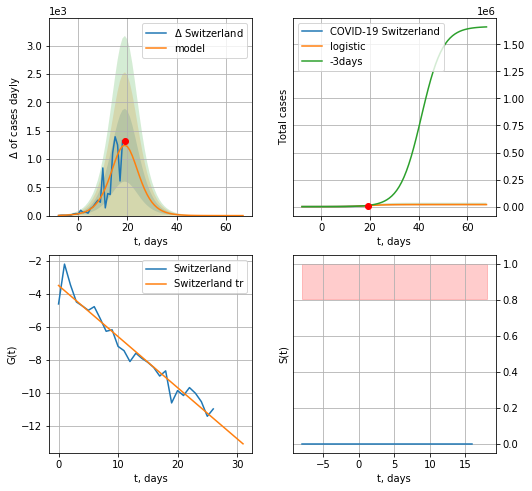

Switzerland data at: 2020-11-14
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  18706 ± 5724
	 total death:  243 ± 223
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:486: RuntimeWarning: divide by zero encountered in log


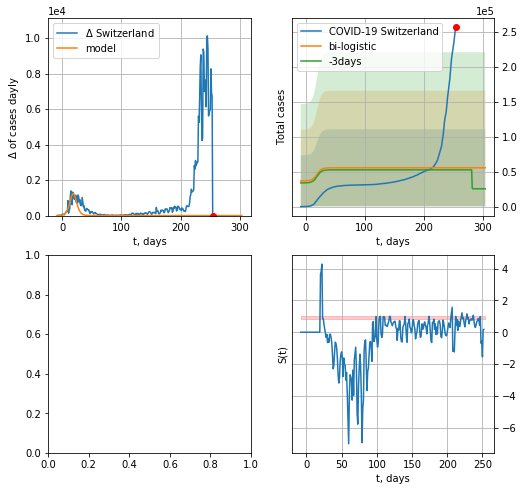

In [593]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


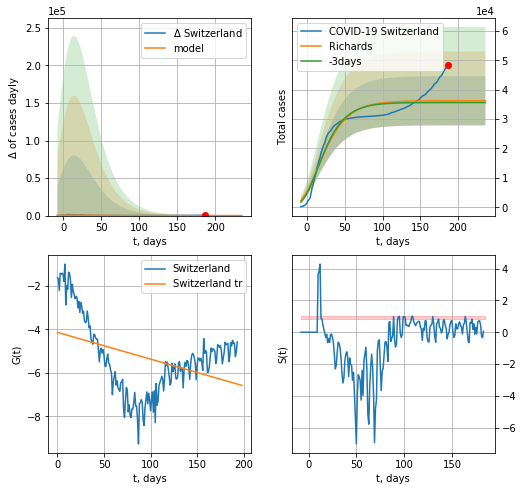

Switzerland data at: 2020-11-13
+3 day model MAPE: 0.017011
model: Richards
coeffs: [ 3.62432935e+04  1.60636037e+01 -1.13737864e+02  2.85003887e-03]
rational stdev: 0.231139
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 36241 ± 8376
	 total death: 467 ± 323
trend coefficient of determination: 0.162726
 intercept: -4.134057
 slope: -0.012335
diffStd0a 2.16376787252037


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


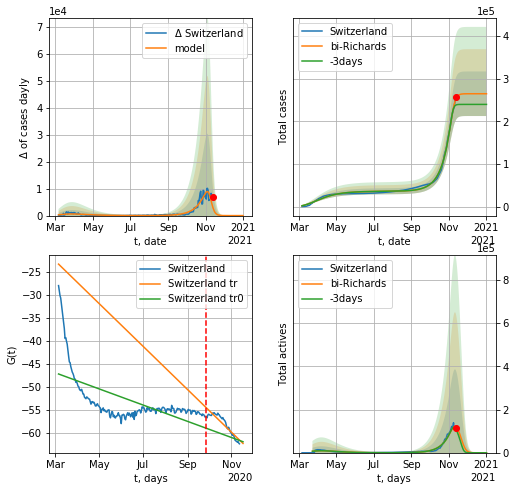

Switzerland data at: 2020-11-13
+3 day model MAPE: 0.071174
model: bi-Richards
coeffs: [2.28522949e+05 6.86854893e-02 2.40091119e+02 4.71109833e+00]
rational stdev: 0.197222
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 264766 ± 52217
	 total death: 3413 ± 2019
bi-Richards approximation splitting point: 205
trend coefficient of determination: 0.379733
 intercept: -47.151376
 slope: -0.057533
trend coefficient of determination: 0.846099
 intercept: -23.269714
 slope: -0.152276


In [201]:
iL = 10
vL = 205 + iL#175 + iL#85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Switzerland',dfSZ[iL:],d12f(1),7*40-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [202]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [203]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
245 2020-11-10  489808.0  259402  8947.0
246 2020-11-11  500865.0  264026  9145.0
247 2020-11-12  512652.0  269486  9317.0
248 2020-11-13  525176.0  276857  9508.0
249 2020-11-14  535857.0  284810  9603.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


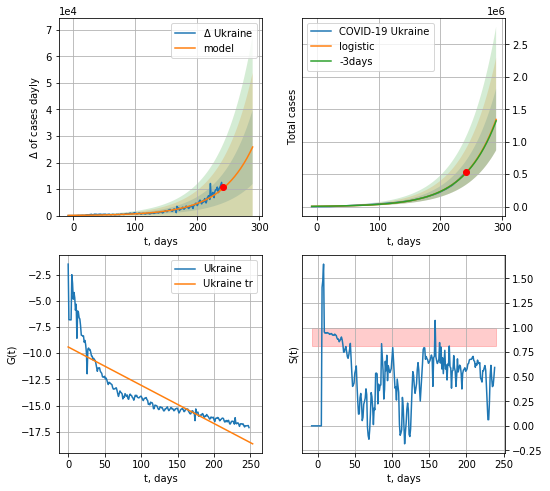

Ukraine data at: 2020-11-14
+3 day model MAPE: 0.00871136244393208
model: logistic
coeffs:  [6.23730898e+08 1.94628618e-02 6.05351516e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35373688705214024
forecast at the end of period: +49 days
	 deltaDaycases:  25857
	 total cases:  1344362 ± 475550
	 total death:  24092 ± 25566
trend coefficient of determination: 0.730857
 intercept: -9.411188
 slope: -0.036536


In [594]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


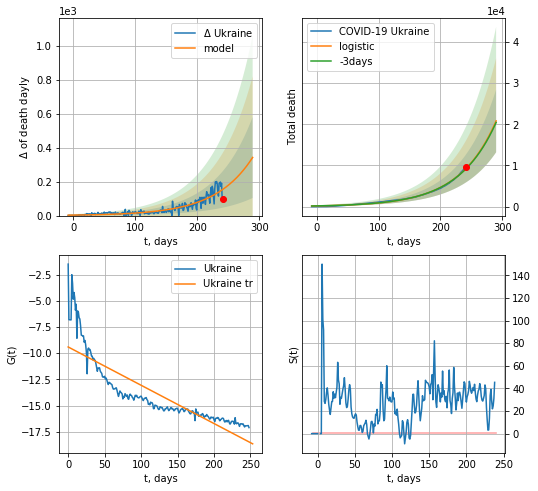

Ukraine data at: 2020-11-14
+3 day model MAPE: 0.010375880949132499
model: logistic
coeffs:  [1.07261284e+07 1.66381810e-02 6.65151480e+02]
rational stdev:  0.3656014866220681
forecast at the end of period: +49 days
	 total death:  20835 ± 7617
trend coefficient of determination: 0.730857
 intercept: -9.411188
 slope: -0.036536


In [595]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


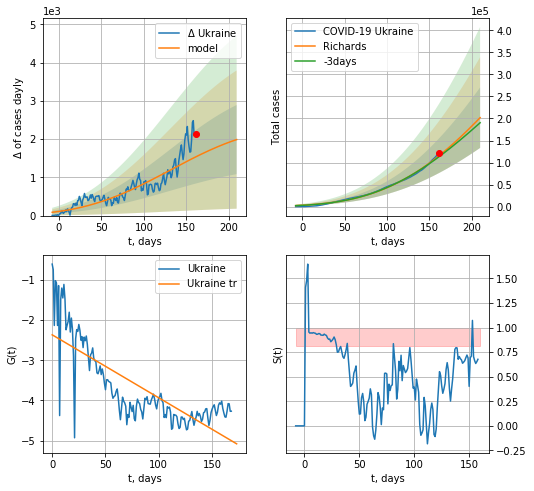

Ukraine data at: 2020-11-14
+3 day model MAPE: 0.020951
model: Richards
coeffs: [ 9.71556496e+05  3.24855332e-01 -3.33588886e+02  1.96162664e-02]
rational stdev: 0.340033
forecast at the end of period: +49 days
	 deltaDaycases: 1986
	 total cases: 201849 ± 68635
	 total death: 3617 ± 3689
trend coefficient of determination: 0.622475
 intercept: -2.366387
 slope: -0.015671
diffStd0a 0.15268212306696144


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


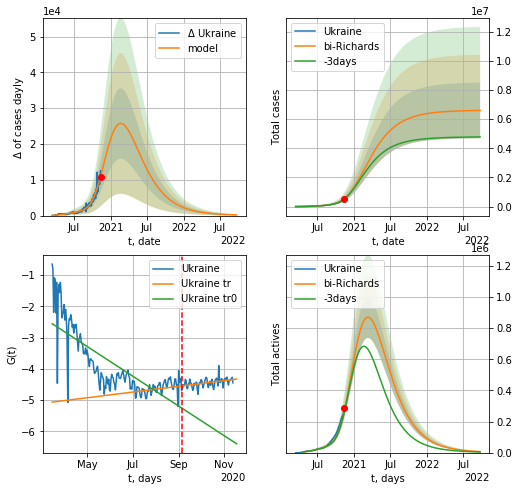

Ukraine data at: 2020-11-14
+3 day model MAPE: 0.005727
model: bi-Richards
coeffs: [5.64482093e+06 2.85843509e-01 5.99343271e+01 4.05473791e-02]
rational stdev: 0.289666
forecast at the end of period: +679 days
	 deltaDaycases: 189
	 total cases: 6592273 ± 1909559
	 total death: 118138 ± 102661
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.615385
 intercept: -2.556459
 slope: -0.015503
trend coefficient of determination: 0.189880
 intercept: -5.066830
 slope: 0.002976


In [596]:
vL = 180#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RRD('Ukraine',dfUR[5:],d1,7*130-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [597]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [598]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

In [599]:
dfIN = read_df(pd.DataFrame(),"IN")
#x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
#xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

IN
           date   cases  active    death
265 2020-11-10  703288  133392  39202.0
266 2020-11-11  715068  139299  39664.0
267 2020-11-12  726585  144898  40121.0
268 2020-11-13  738322  151098  40582.0
269 2020-11-14  749525  155744  41034.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


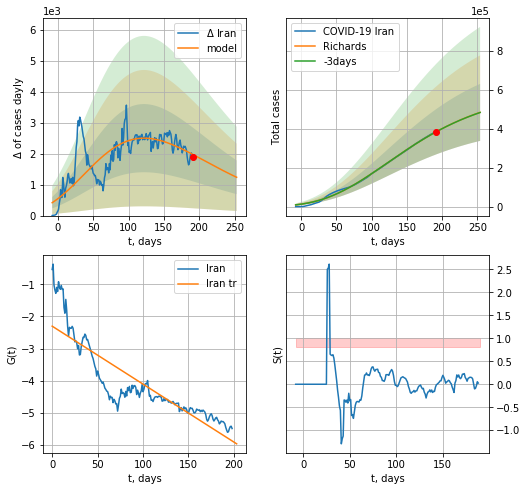

Iran data at: 2020-11-14
+3 day model MAPE: 0.000431
model: Richards
coeffs: [ 6.07518429e+05  7.96228644e-01 -2.54493530e+02  1.41818761e-02]
rational stdev: 0.302382
forecast at the end of period: +63 days
	 deltaDaycases: 1239
	 total cases: 484684 ± 146559
	 total death: 26534 ± 24070
trend coefficient of determination: 0.763759
 intercept: -2.302474
 slope: -0.018078
diffStd0a 0.3564023207772342


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


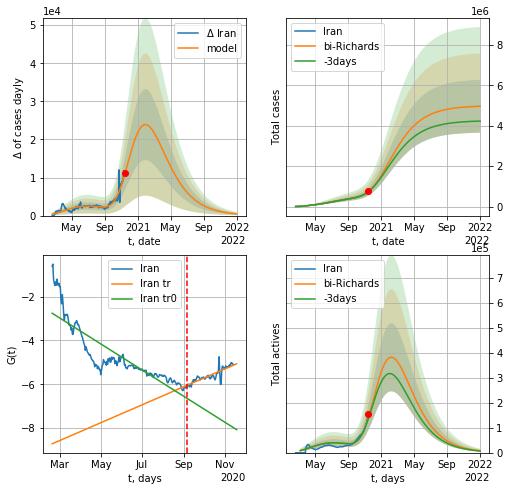

Iran data at: 2020-11-14
+3 day model MAPE: 0.006946
model: bi-Richards
coeffs: [4.38618147e+06 2.23524117e-01 1.56757601e+02 6.68787946e-02]
rational stdev: 0.263502
forecast at the end of period: +413 days
	 deltaDaycases: 443
	 total cases: 4963848 ± 1307984
	 total death: 271754 ± 214823
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.759266
 intercept: -2.759017
 slope: -0.019442
trend coefficient of determination: 0.717560
 intercept: -8.712498
 slope: 0.013360


In [600]:
vL = 200
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Iran',dfIN[:],d12f(1),92*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [601]:
#x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
255 2020-11-10  1817109.0  436010  31593.0
256 2020-11-11  1836960.0  438368  32032.0
257 2020-11-12  1858568.0  441205  32443.0
258 2020-11-13  1880551.0  444890  32834.0
259 2020-11-14  1903253.0  452654  33186.0


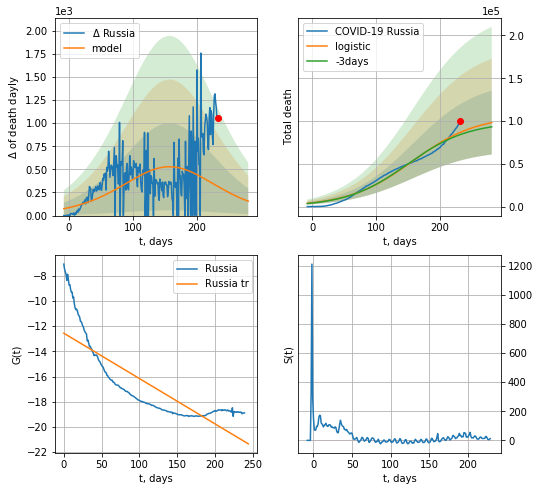

Russia data at: 2020-11-14
+3 day model MAPE: 0.03131992096285802
model: logistic
coeffs:  [1.06635843e+05 1.98236779e-02 1.57354294e+02]
rational stdev:  0.3796924288745035
forecast at the end of period: +49 days
	 total death:  98173 ± 37275
trend coefficient of determination: 0.684371
 intercept: -12.560264
 slope: -0.035980


In [603]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


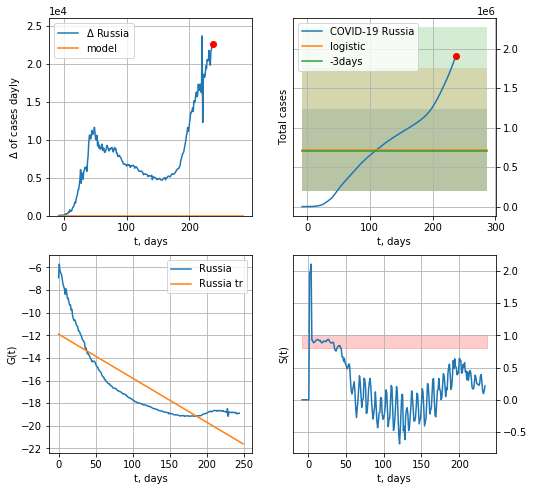

Russia data at: 2020-11-14
+3 day model MAPE: 0.0202716347697869
model: logistic
coeffs:  [ 7.20781300e+05 -1.80029959e+01  4.40707984e+02]
rational stdev:  0.7186198679094931
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  720781 ± 517967
	 total death:  12420 ± 26775
trend coefficient of determination: 0.684379
 intercept: -11.895630
 slope: -0.038942


In [604]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


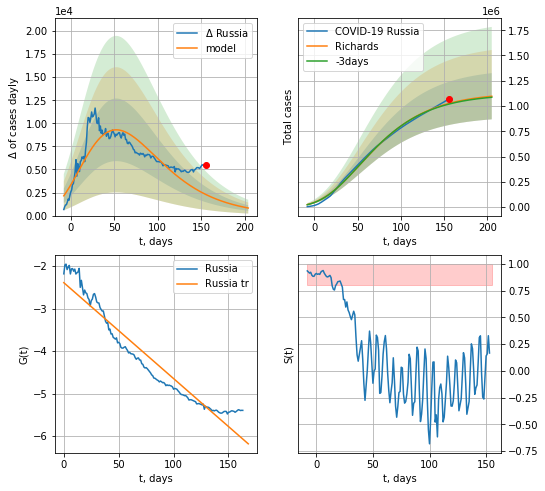

Russia data at: 2020-11-14
+3 day model MAPE: 0.006482
model: Richards
coeffs: [ 1.13371514e+06  2.45412243e+00 -1.57034582e+02  9.12424388e-03]
rational stdev: 0.208462
forecast at the end of period: +49 days
	 deltaDaycases: 820
	 total cases: 1096868 ± 228655
	 total death: 18901 ± 11820
trend coefficient of determination: 0.926508
 intercept: -2.389804
 slope: -0.022577
diffStd0a 0.17810886449347751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


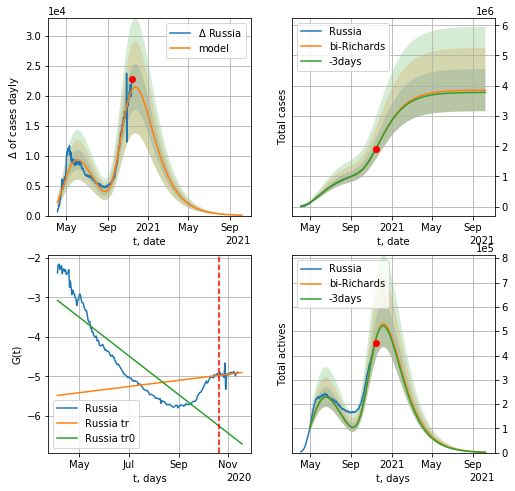

Russia data at: 2020-11-14
+3 day model MAPE: 0.001235
model: bi-Richards
coeffs: [2.72419237e+06 6.65980370e-01 6.41124398e+01 3.18251809e-02]
rational stdev: 0.180756
forecast at the end of period: +329 days
	 deltaDaycases: 69
	 total cases: 3854684 ± 696759
	 total death: 66424 ± 36019
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.731640
 intercept: -3.071324
 slope: -0.015936
trend coefficient of determination: 0.029016
 intercept: -5.479083
 slope: 0.002548


In [605]:
vL = 200 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RRD('Russia',dfRS[35:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35,amc=0.75)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

In [606]:
#x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date     cases  active   death
293 2020-11-10  108983.0    8880  1829.0
294 2020-11-11  110156.0    9207  1841.0
295 2020-11-12  111711.0    9855  1851.0
296 2020-11-13  113298.0   10413  1867.0
297 2020-11-14  114983.0   11114  1880.0


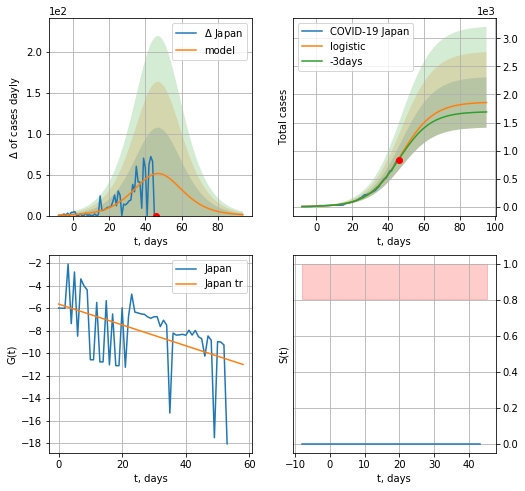

Japan data at: 2020-11-14
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +49 days
	 deltaDaycases:  1
	 total cases:  1856 ± 449
	 total death:  30 ± 21
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


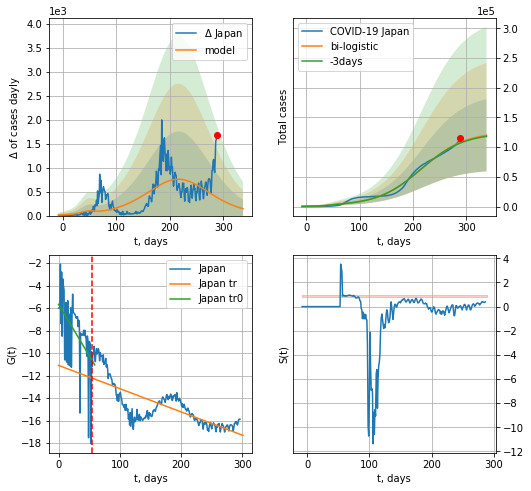

Japan data at: 2020-11-14
+3 day model MAPE: 0.009891545245537928
model: bi-logistic
coeffs:  [1.24338296e+05 2.44500720e-02 2.16664512e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5056973697500368
forecast at the end of period: +49 days
	 deltaDaycases:  143
	 total cases:  120118 ± 60743
	 total death:  1963 ± 2978
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.583034
 intercept: -11.096471
 slope: -0.020677


In [607]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


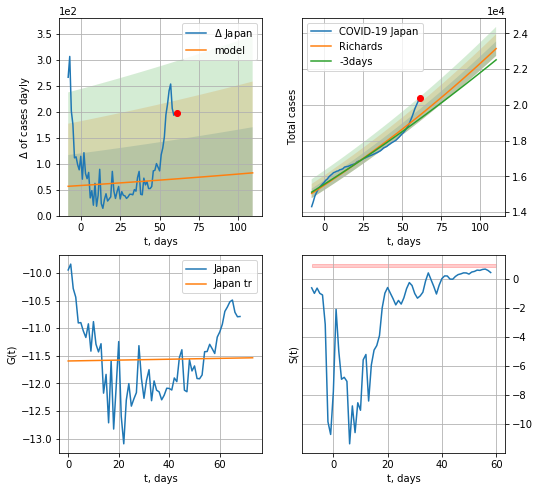

Japan data at: 2020-11-14
+3 day model MAPE: 0.010772
model: Richards
coeffs: [3.67644970e+05 4.33696686e-03 6.73727229e+02 6.19728498e-01]
rational stdev: 0.017509
forecast at the end of period: +49 days
	 deltaDaycases: 82
	 total cases: 23142 ± 405
	 total death: 378 ± 19
trend coefficient of determination: 0.000525
 intercept: -11.593639
 slope: 0.000790
diffStd0a 1.789567486693809


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


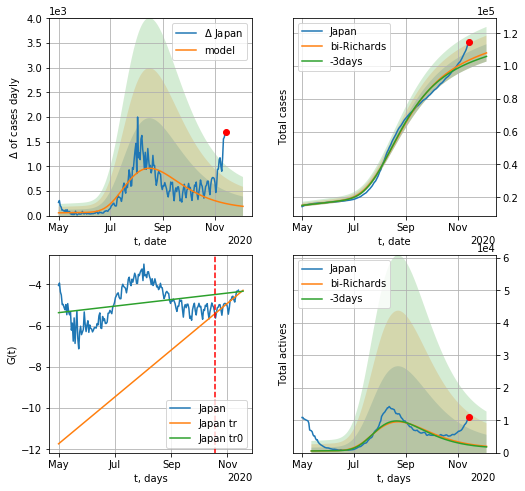

Japan data at: 2020-11-14
+3 day model MAPE: 0.016928
model: bi-Richards
coeffs: [ 7.78872132e+04  5.87384936e+00 -7.14817053e+01  5.24284844e-03]
rational stdev: 0.048910
forecast at the end of period: +21 days
	 deltaDaycases: 187
	 total cases: 108099 ± 5287
	 total death: 1767 ± 259
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.085244
 intercept: -5.372753
 slope: 0.005165
trend coefficient of determination: 0.673043
 intercept: -11.731594
 slope: 0.037023


In [608]:
iL = 50+50
vL = 170+iL
x = forecastRR('Japan',dfJP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Japan',dfJP[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)

In [609]:
#x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date     cases  active   death
257 2020-11-10  419412.0       0  8141.0
258 2020-11-11  424819.0       0  8215.0
259 2020-11-12  430453.0       0  8304.0
260 2020-11-13  436544.0       0  8358.0
261 2020-11-14  442458.0       0  8443.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


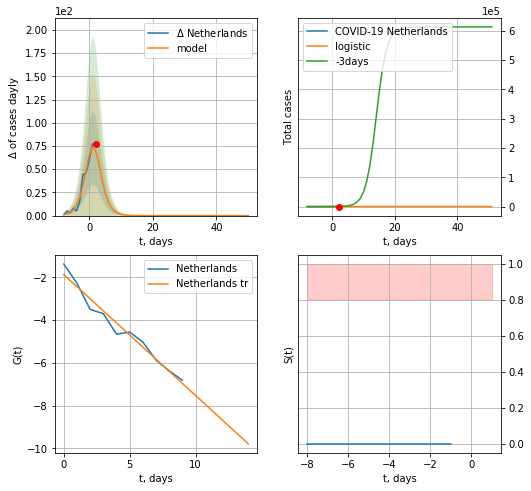

Netherlands data at: 2020-11-14
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  9 ± 6
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


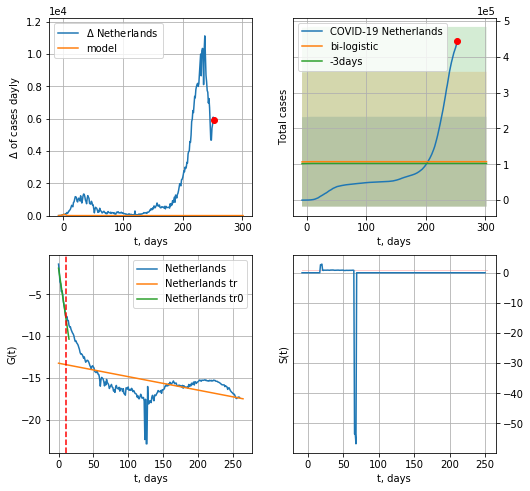

Netherlands data at: 2020-11-14
+3 day model MAPE: 0.04971303111103371
model: bi-logistic
coeffs:  [ 8.53671018e+04 -1.69777962e+01  4.32192802e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.1679917796209422
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  107196 ± 125204
	 total death:  2045 ± 7165
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.278802
 intercept: -13.226075
 slope: -0.016039


In [610]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


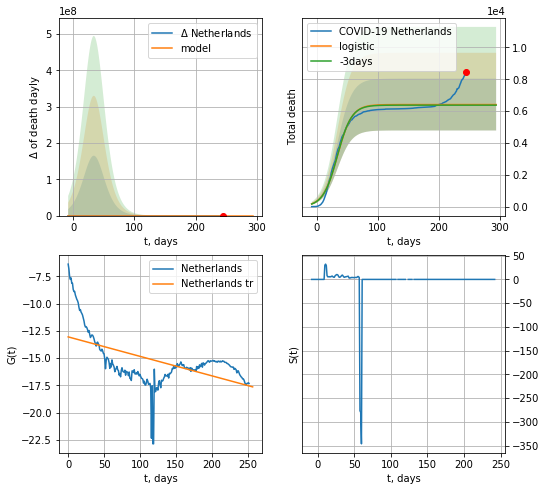

Netherlands data at: 2020-11-14
+3 day model MAPE: 0.005829098608772701
model: logistic
coeffs:  [6.41079830e+03 8.48240323e-02 3.43050760e+01]
rational stdev:  0.2535732071290183
forecast at the end of period: +49 days
	 total death:  6410 ± 1625
trend coefficient of determination: 0.303204
 intercept: -13.051197
 slope: -0.017837


In [611]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


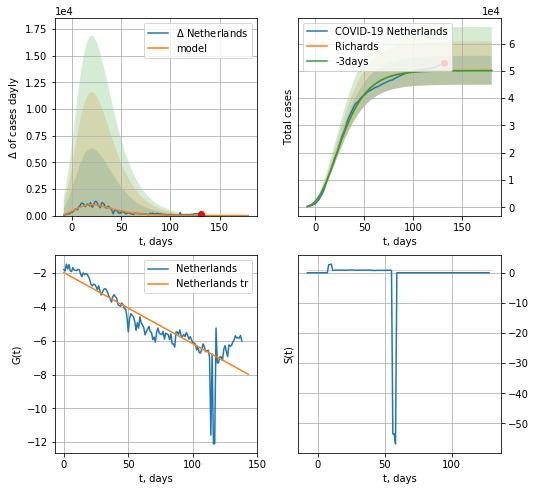

Netherlands data at: 2020-11-14
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 50234 ± 5290
	 total death: 958 ± 302
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068
diffStd0a 0.4185186870150208


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


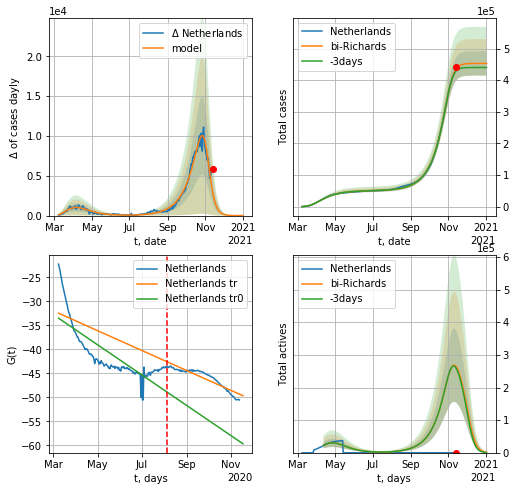

Netherlands data at: 2020-11-14
+3 day model MAPE: 0.016991
model: bi-Richards
coeffs: [4.02902877e+05 4.90709827e-02 2.32615621e+02 3.55543797e+00]
rational stdev: 0.084880
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 453140 ± 38462
	 total death: 8646 ± 2201
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.638347
 intercept: -33.520682
 slope: -0.102502
trend coefficient of determination: 0.851750
 intercept: -32.473756
 slope: -0.067389


In [612]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Netherlands',dfNL[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [613]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


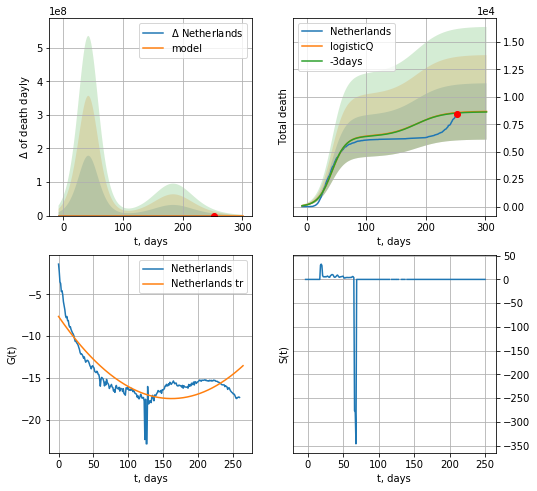

Netherlands data at: 2020-11-14
+3 day model MAPE: 0.004672
model: logisticQ
coeffs: [ 6.40972151e+03  1.25928568e-07  4.23061801e+01 -6.76869690e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.296263
forecast at the end of period: +49 days
	 total death: 8665 ± 2567
trend coefficient of determination: 0.733088
 intercept_: -7.640689300023205
 coeffs_: [ 0.         -0.12088519  0.00037238]


In [614]:
#x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [615]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date     cases  active   death
258 2020-11-10  164866.0   64704  1499.0
259 2020-11-11  172380.0   67057  1564.0
260 2020-11-12  181642.0   72159  1608.0
261 2020-11-13  191228.0   76839  1661.0
262 2020-11-14  198291.0   77130  1746.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


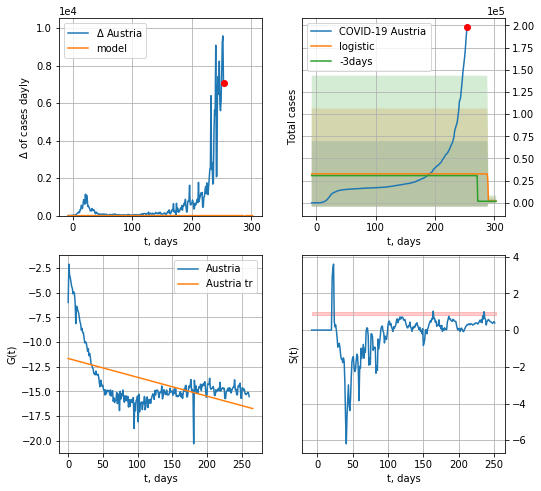

Austria data at: 2020-11-14
+3 day model MAPE: 0.06375360506434725
model: logistic
coeffs:  [ 3.07365058e+04 -1.06150914e+01  2.89085725e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  1.129282661998086
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1921 ± 2169
	 total death:  16 ± 54
trend coefficient of determination: 0.262215
 intercept: -11.672802
 slope: -0.019047


In [616]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


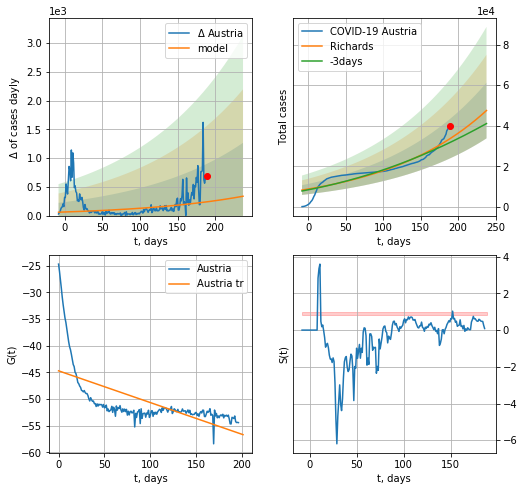

Austria data at: 2020-11-14
+3 day model MAPE: 0.060222
model: Richards
coeffs: [7.79127383e+05 7.10721944e-03 6.31550628e+02 4.75199089e+00]
rational stdev: 0.289325
forecast at the end of period: +49 days
	 deltaDaycases: 336
	 total cases: 47518 ± 13748
	 total death: 418 ± 362
trend coefficient of determination: 0.406393
 intercept: -44.706119
 slope: -0.059607


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 1.376231745789949


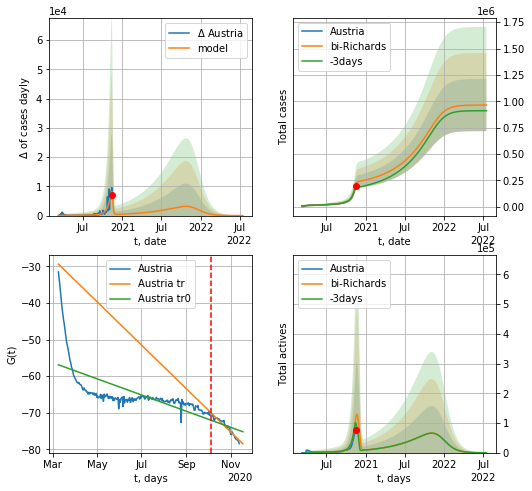

Austria data at: 2020-11-14
+3 day model MAPE: 0.140099
model: bi-Richards
coeffs: [1.84419927e+05 6.75444189e-02 2.44359771e+02 6.15652734e+00]
rational stdev: 0.256746
forecast at the end of period: +609 days
	 deltaDaycases: 3
	 total cases: 963448 ± 247361
	 total death: 8483 ± 6533
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.448350
 intercept: -56.882413
 slope: -0.071974
trend coefficient of determination: 0.932770
 intercept: -29.404401
 slope: -0.193108


In [617]:
vL=210+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Austria',dfAT[12:],d12f(1),120*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12,amc=0.65)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

In [618]:
#vL = 68
#x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date     cases  active    death
254 2020-11-10  507475.0  463410  13561.0
255 2020-11-11  515391.0  470503  13758.0
256 2020-11-12  520393.0  475130  13891.0
257 2020-11-13  525012.0  478873  14106.0
258 2020-11-14  531280.0  484271  14303.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


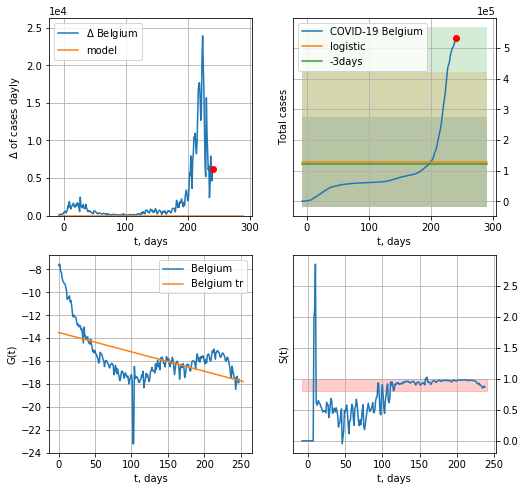

Belgium data at: 2020-11-14
+3 day model MAPE: 0.0521685958854036
model: logistic
coeffs:  [ 1.03411240e+05 -2.64653180e+01  6.93387875e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  1.1338822335890149
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  129264 ± 146570
	 total death:  3480 ± 11837
trend coefficient of determination: 0.283918
 intercept: -13.502840
 slope: -0.016944


In [619]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

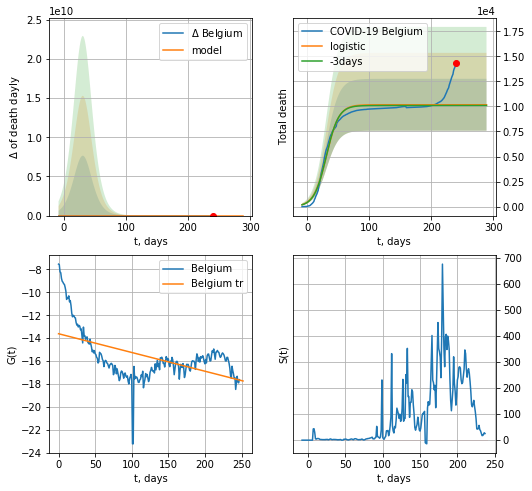

Belgium data at: 2020-11-14
+3 day model MAPE: 0.007205812476860263
model: logistic
coeffs:  [1.01648818e+04 9.97905469e-02 3.13503710e+01]
rational stdev:  0.25468963751339946
forecast at the end of period: +49 days
	 total death:  10164 ± 2588
trend coefficient of determination: 0.275292
 intercept: -13.614206
 slope: -0.016370


In [620]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


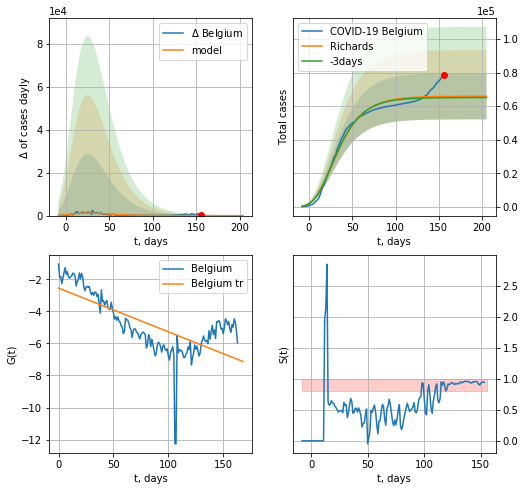

Belgium data at: 2020-11-14
+3 day model MAPE: 0.011690
model: Richards
coeffs: [ 6.59502350e+04  1.16564107e+01 -8.64901843e+01  4.18089404e-03]
rational stdev: 0.209120
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 65939 ± 13789
	 total death: 1775 ± 1113
trend coefficient of determination: 0.496391
 intercept: -2.551765
 slope: -0.027253
diffStd0a 5.769660364290138


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


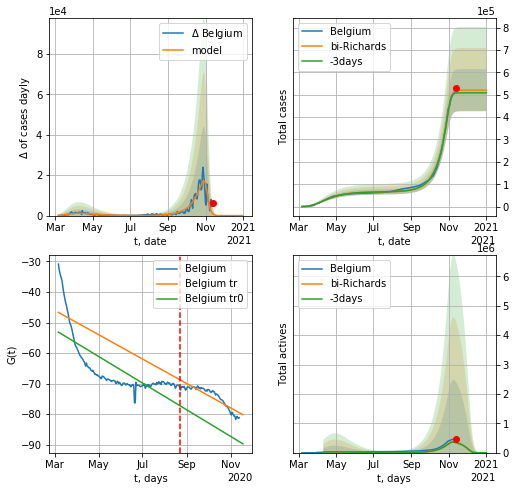

Belgium data at: 2020-11-14
+3 day model MAPE: 0.022295
model: bi-Richards
coeffs: [4.54477137e+05 6.17618038e-02 2.34649173e+02 5.81890037e+00]
rational stdev: 0.180829
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 520427 ± 94108
	 total death: 14010 ± 7600
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.555168
 intercept: -53.144884
 slope: -0.142248
trend coefficient of determination: 0.810548
 intercept: -46.684744
 slope: -0.130268


In [621]:
iL = 5
vL = 170+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Belgium',dfBG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [622]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [623]:
dfBZ.tail()

,date,cases,active,death
259,2020-11-10,5701283.0,474097,162842.0
260,2020-11-11,5749007.0,521257,163406.0
261,2020-11-12,5783647.0,362548,164332.0
262,2020-11-13,5819496.0,386983,164946.0
263,2020-11-14,5848959.0,391775,165673.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


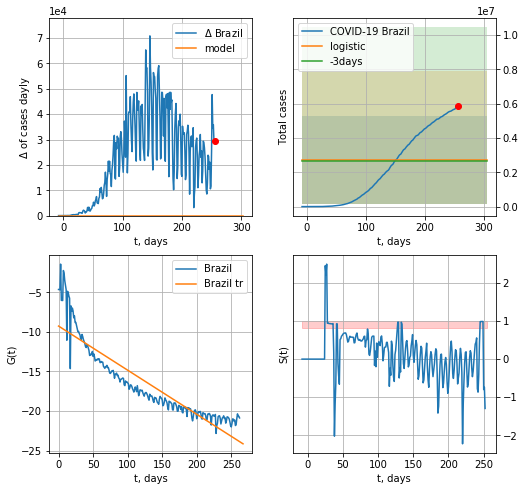

Brazil data at: 2020-11-14
+3 day model MAPE: 0.019544251226675698
model: logistic
coeffs:  [ 2.18062293e+06 -3.80879107e+01  9.07549129e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9469874829226558
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  2725778 ± 2581278
	 total death:  77208 ± 219345
trend coefficient of determination: 0.828070
 intercept: -9.253104
 slope: -0.055784


In [624]:
x = forecast('Brazil',dfBZ[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


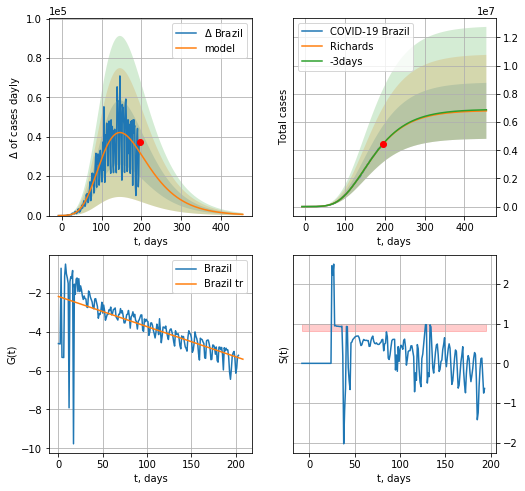

Brazil data at: 2020-11-14
+3 day model MAPE: 0.002583
model: Richards
coeffs: [ 6.82795585e+06  5.83841281e-01 -6.12360298e+01  2.91606457e-02]
rational stdev: 0.292338
forecast at the end of period: +259 days
	 deltaDaycases: 609
	 total cases: 6792367 ± 1985665
	 total death: 192395 ± 168732
trend coefficient of determination: 0.490475
 intercept: -2.194254
 slope: -0.015503
diffStd0a 0.3287994550035789


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


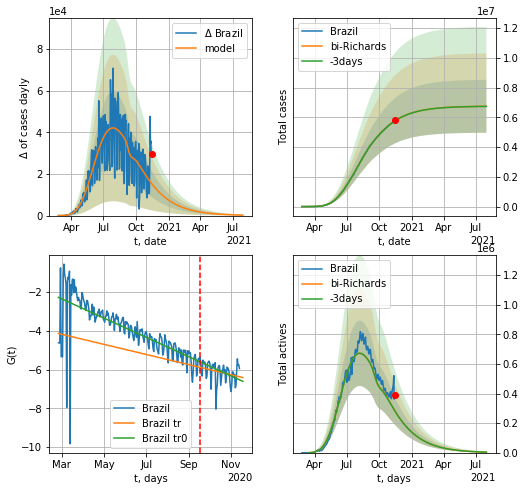

Brazil data at: 2020-11-14
+3 day model MAPE: 0.001147
model: bi-Richards
coeffs: [-6.89781203e+04  3.27829405e+00  1.72766414e+02  4.22096605e-02]
rational stdev: 0.263743
forecast at the end of period: +259 days
	 deltaDaycases: 223
	 total cases: 6745921 ± 1779190
	 total death: 191079 ± 151187
bi-Richards approximation splitting point: 205
trend coefficient of determination: 0.520826
 intercept: -2.274153
 slope: -0.016238
trend coefficient of determination: 0.076048
 intercept: -4.137987
 slope: -0.008527


In [625]:
vL = 205
x = forecastRR('Brazil',dfBZ[:vL],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Brazil',dfBZ[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

In [626]:
#x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [627]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
269 2020-11-10  27686.0    1320  907.0
270 2020-11-11  27699.0    1328  907.0
271 2020-11-12  27702.0    1327  907.0
272 2020-11-13  27711.0    1326  907.0
273 2020-11-14  27728.0    1331  907.0


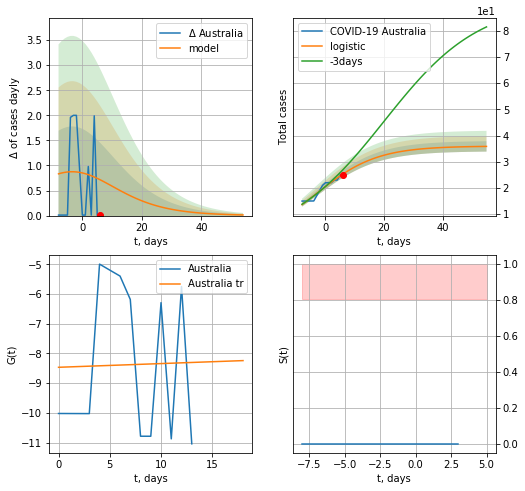

Australia data at: 2020-11-14
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  35 ± 1
	 total death:  1 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


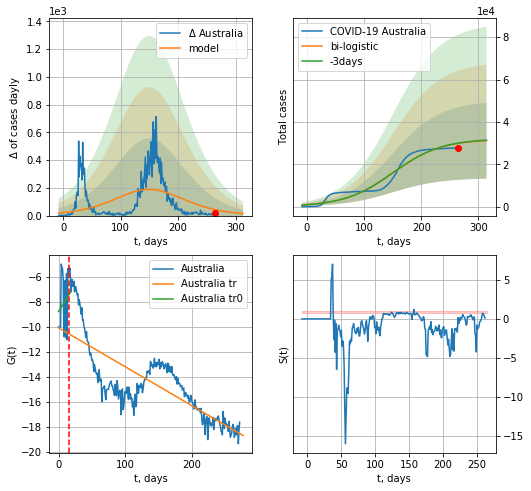

Australia data at: 2020-11-14
+3 day model MAPE: 0.006274037377773062
model: bi-logistic
coeffs:  [3.17078973e+04 2.38429287e-02 1.49989154e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5752161526686066
forecast at the end of period: +49 days
	 deltaDaycases:  14
	 total cases:  31121 ± 17901
	 total death:  1017 ± 1754
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.609328
 intercept: -10.087154
 slope: -0.031081


In [628]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


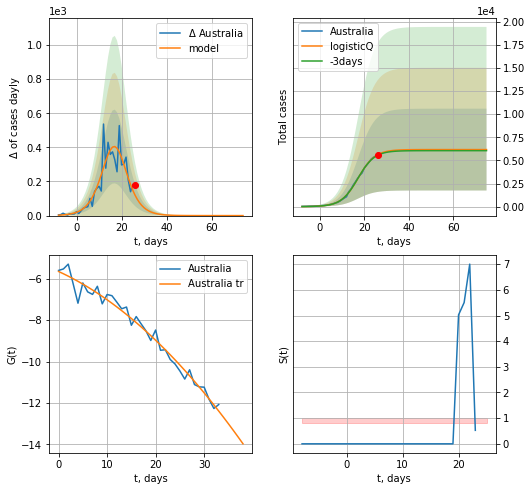

Australia data at: 2020-11-14
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 6168 ± 4420
	 total death: 201 ± 432
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


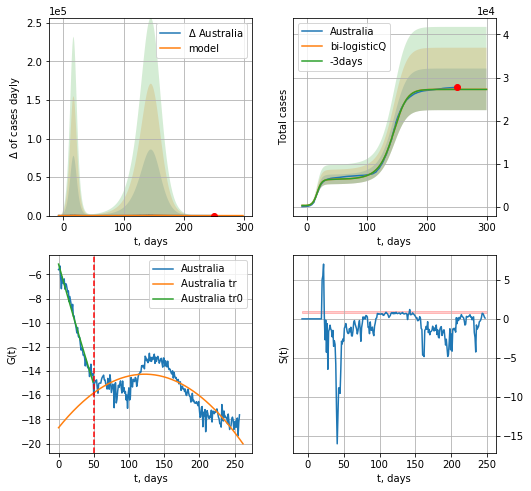

Australia data at: 2020-11-14
+3 day model MAPE: 0.000772
model: bi-logisticQ
coeffs: [ 2.10858084e+04  3.67039016e-04  1.43122647e+02 -8.48880106e+01]
rational stdev: 0.177328
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 27254 ± 4832
	 total death: 891 ± 473
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.707289
 intercept_: -18.693152009110168
 coeffs_: [ 0.          0.07241489 -0.0002958 ]


In [629]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,T18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


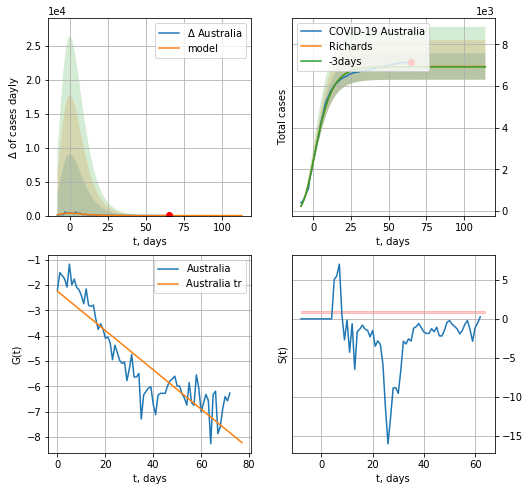

Australia data at: 2020-11-14
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 226 ± 61
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557
diffStd0a 9.611305344442894


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


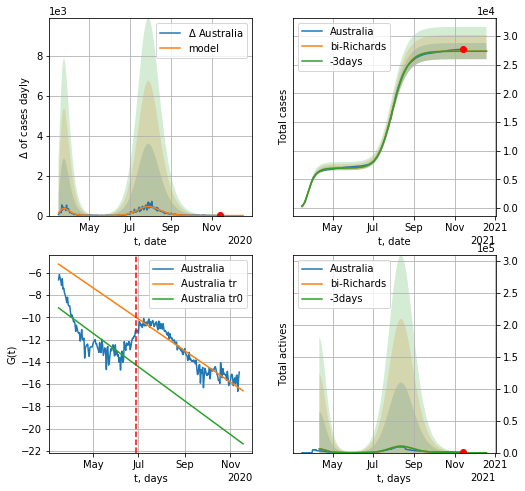

Australia data at: 2020-11-14
+3 day model MAPE: 0.000754
model: bi-Richards
coeffs: [2.04447356e+04 1.11279681e-01 1.23571265e+02 7.36044662e-01]
rational stdev: 0.051508
forecast at the end of period: +35 days
	 deltaDaycases: 0
	 total cases: 27378 ± 1410
	 total death: 895 ± 138
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544252
 intercept: -9.155951
 slope: -0.049477
trend coefficient of determination: 0.900115
 intercept: -5.219599
 slope: -0.046120


In [630]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Australia',dfAS[iL:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

ML
           date    cases  active  death
257 2020-11-10  42050.0   11446  300.0
258 2020-11-11  42872.0   11497  302.0
259 2020-11-12  43791.0   11419  303.0
260 2020-11-13  45095.0   11822  304.0
261 2020-11-14  46209.0   12131  306.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


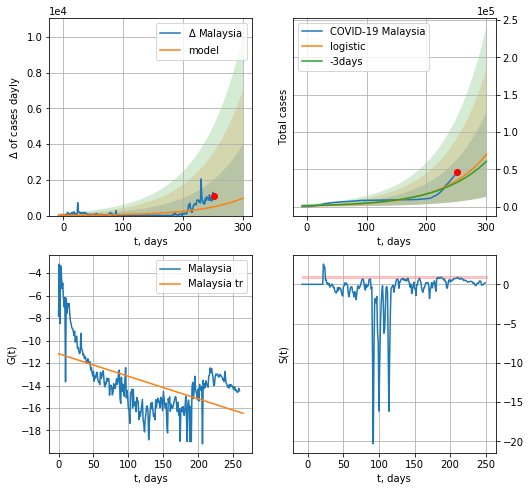

Malaysia data at: 2020-11-14
+3 day model MAPE: 0.08253082997989067
model: logistic
coeffs:  [3.65479232e+08 1.40373186e-02 9.10793419e+02]
rational stdev:  0.8119464572163001
forecast at the end of period: +49 days
	 deltaDaycases:  975
	 total cases:  70028 ± 56859
	 total death:  463 ± 1127
trend coefficient of determination: 0.298365
 intercept: -11.171017
 slope: -0.020086


In [631]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


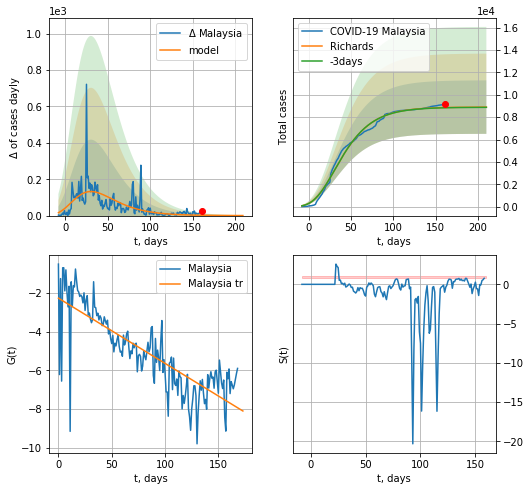

Malaysia data at: 2020-11-14
+3 day model MAPE: 0.002240
model: Richards
coeffs: [ 8.90988900e+03  9.44653085e+00 -1.04060324e+02  4.28353192e-03]
rational stdev: 0.268624
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 8903 ± 2391
	 total death: 58 ± 46
trend coefficient of determination: 0.661509
 intercept: -2.276525
 slope: -0.033689
diffStd0a 0.8232875484211727


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


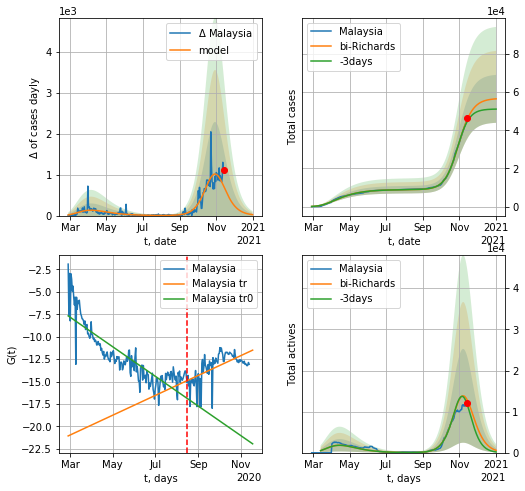

Malaysia data at: 2020-11-14
+3 day model MAPE: 0.026765
model: bi-Richards
coeffs: [4.78024015e+04 9.38807774e-02 2.36820786e+02 8.71231986e-01]
rational stdev: 0.222456
forecast at the end of period: +49 days
	 deltaDaycases: 22
	 total cases: 56448 ± 12557
	 total death: 373 ± 248
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.732284
 intercept: -7.682099
 slope: -0.053826
trend coefficient of determination: 0.383074
 intercept: -21.066135
 slope: 0.036082


In [632]:
vL = 170
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Malaysia',dfML[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.45)

In [633]:
#x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
256 2020-11-10  1988.0      52   25.0
257 2020-11-11  1991.0      53   25.0
258 2020-11-12  1995.0      53   25.0
259 2020-11-13  1998.0      55   25.0
260 2020-11-14  2001.0      58   25.0


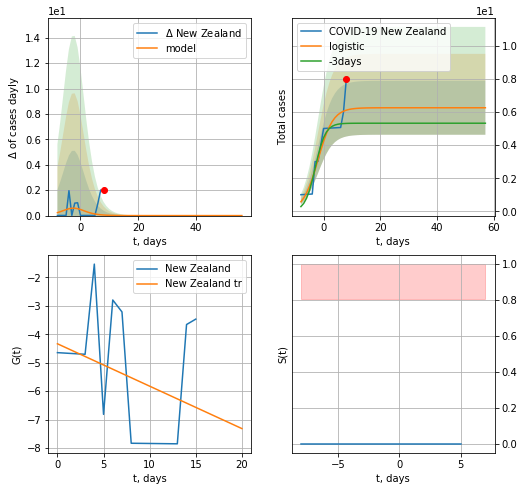

New Zealand data at: 2020-11-14
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


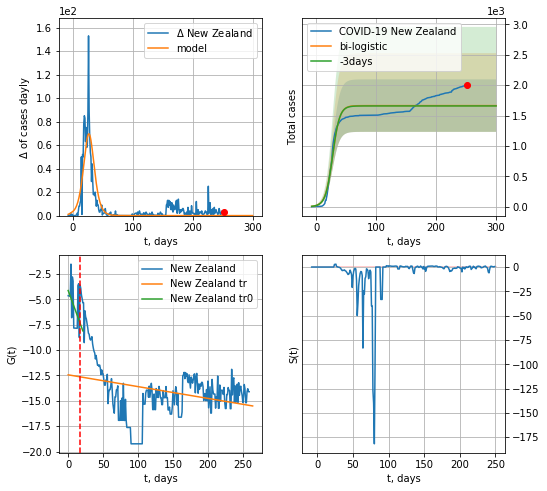

New Zealand data at: 2020-11-14
+3 day model MAPE: 0.0031448112783547754
model: bi-logistic
coeffs:  [1.65762395e+03 1.68106144e-01 2.70691433e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.25966868862055853
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1663 ± 432
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.082601
 intercept: -12.440403
 slope: -0.011614


In [634]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

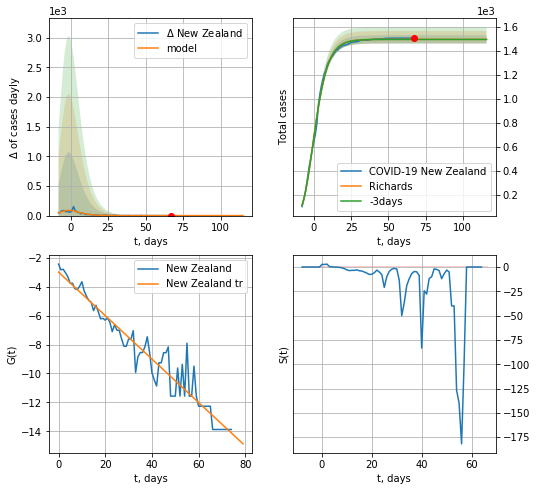

New Zealand data at: 2020-11-14
+3 day model MAPE: 0.000505
model: Richards
coeffs: [ 1.49487953e+03  6.79159620e-01 -8.03485752e+00  2.67314239e-01]
rational stdev: 0.023076
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1494 ± 34
	 total death: 18 ± 1
trend coefficient of determination: 0.938641
 intercept: -2.993592
 slope: -0.150300
diffStd0a 1.778995606331188


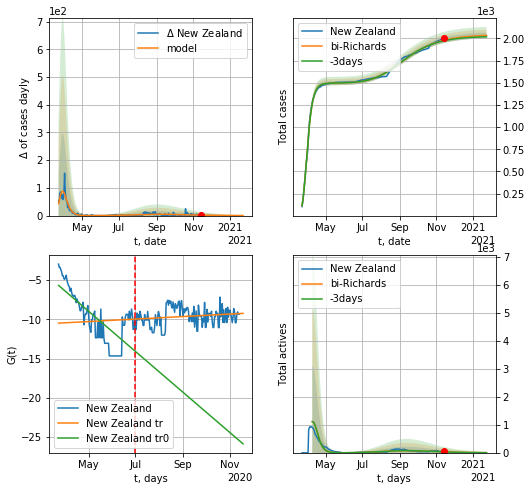

New Zealand data at: 2020-11-14
+3 day model MAPE: 0.003170
model: bi-Richards
coeffs: [5.47377095e+02 7.71431677e-02 1.21972420e+02 3.75738604e-01]
rational stdev: 0.015733
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 2033 ± 31
	 total death: 25 ± 1
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.544446
 intercept: -5.697117
 slope: -0.083990
trend coefficient of determination: 0.030542
 intercept: -10.498130
 slope: 0.005182


In [635]:
iL = 24
vL = 100+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('New Zealand',dfZL[iL:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [636]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [637]:
dfBR = read_df(pd.DataFrame(),"BR")
#x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
#xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date     cases  active   death
256 2020-11-10  108300.0   15638  1016.0
257 2020-11-11  109357.0   16069  1022.0
258 2020-11-12  110455.0   16585  1027.0
259 2020-11-13  111622.0   17019  1033.0
260 2020-11-14  112870.0   17494  1039.0


BR
           date     cases  active   death
256 2020-11-10  108300.0   15638  1016.0
257 2020-11-11  109357.0   16069  1022.0
258 2020-11-12  110455.0   16585  1027.0
259 2020-11-13  111622.0   17019  1033.0
260 2020-11-14  112870.0   17494  1039.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


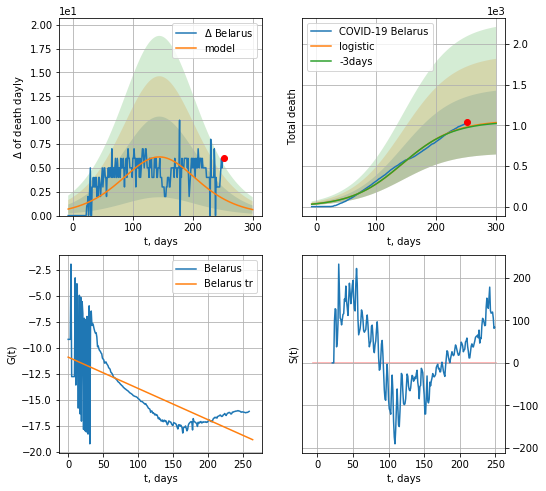

Belarus data at: 2020-11-14
+3 day model MAPE: 0.0075328369735094625
model: logistic
coeffs:  [1.06178112e+03 2.31601026e-02 1.44642939e+02]
rational stdev:  0.3795971698634934
forecast at the end of period: +49 days
	 total death:  1034 ± 392
trend coefficient of determination: 0.471210
 intercept: -10.922829
 slope: -0.030062


In [638]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


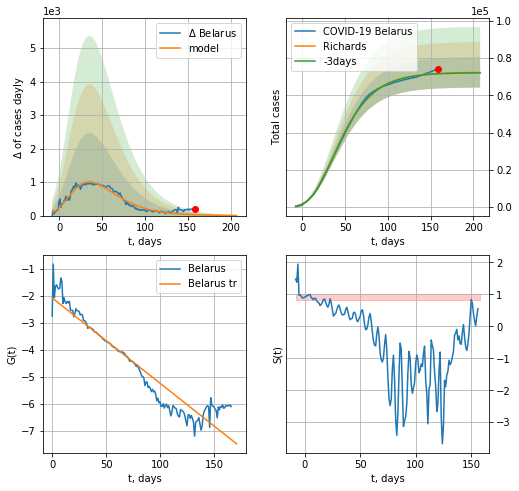

Belarus data at: 2020-11-14
+3 day model MAPE: 0.002728
model: Richards
coeffs: [ 7.24389440e+04  3.51273037e+00 -8.31196937e+01  1.08274995e-02]
rational stdev: 0.112826
forecast at the end of period: +49 days
	 deltaDaycases: 4
	 total cases: 72335 ± 8161
	 total death: 665 ± 225
trend coefficient of determination: 0.901412
 intercept: -2.084164
 slope: -0.031594
diffStd0a 0.358920596349901


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


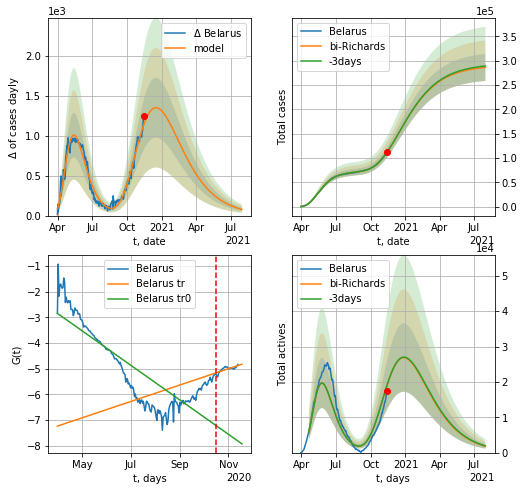

Belarus data at: 2020-11-14
+3 day model MAPE: 0.000004
model: bi-Richards
coeffs: [2.18508692e+05 6.00577484e-01 4.29380689e+01 2.83535476e-02]
rational stdev: 0.096935
forecast at the end of period: +259 days
	 deltaDaycases: 77
	 total cases: 286404 ± 27762
	 total death: 2636 ± 766
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.690774
 intercept: -2.846913
 slope: -0.021886
trend coefficient of determination: 0.550228
 intercept: -7.234975
 slope: 0.010385


In [639]:
iL=32
vL = 200+iL#145+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Belarus',dfBR[iL:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.625)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


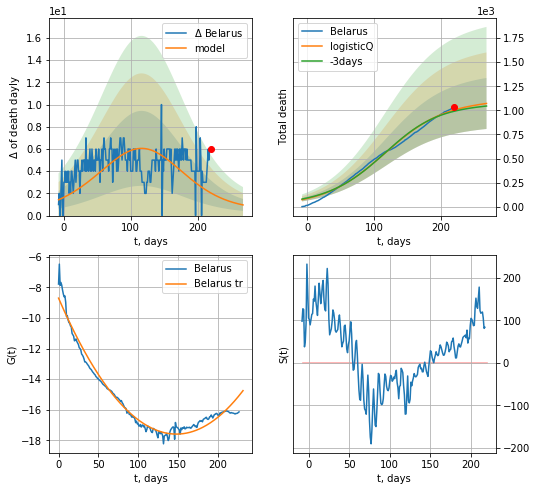

Belarus data at: 2020-11-14
+3 day model MAPE: 0.012840
model: logisticQ
coeffs: [ 1.07091933e+03  6.22810313e-06  1.13987288e+02 -3.47718412e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.247126
forecast at the end of period: +49 days
	 total death: 1071 ± 264
trend coefficient of determination: 0.968609
 intercept_: -8.708327124293255
 coeffs_: [ 0.         -0.11984025  0.0004043 ]


In [640]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

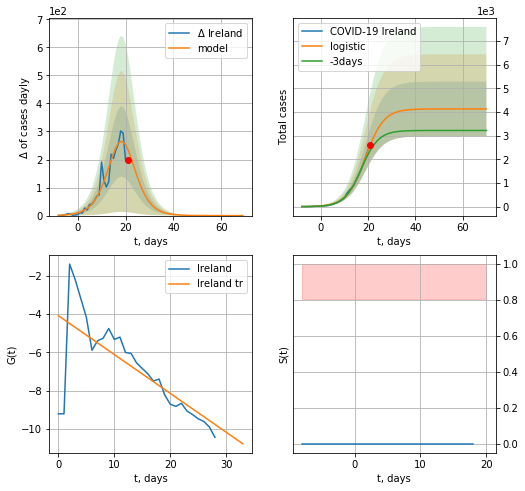

Ireland data at: 2020-11-14
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  120 ± 100
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


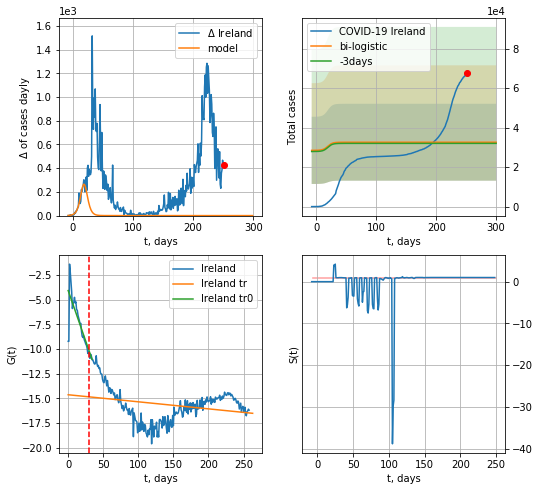

Ireland data at: 2020-11-14
+3 day model MAPE: 0.018295467055127232
model: bi-logistic
coeffs:  [ 2.27935628e+04 -1.67737659e+01  4.11866297e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5970338403014793
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  32619 ± 19474
	 total death:  955 ± 1710
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.066416
 intercept: -14.623028
 slope: -0.007149


In [641]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


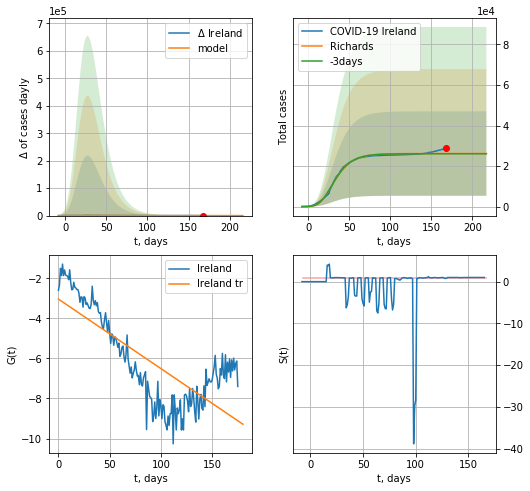

Ireland data at: 2020-11-14
+3 day model MAPE: 0.004030
model: Richards
coeffs: [ 2.61775984e+04  9.17020717e-01 -6.58016651e+00  8.00580200e-02]
rational stdev: 0.795180
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 26177 ± 20815
	 total death: 766 ± 1827
trend coefficient of determination: 0.587901
 intercept: -3.038276
 slope: -0.034699
diffStd0a 0.7168765093949915


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


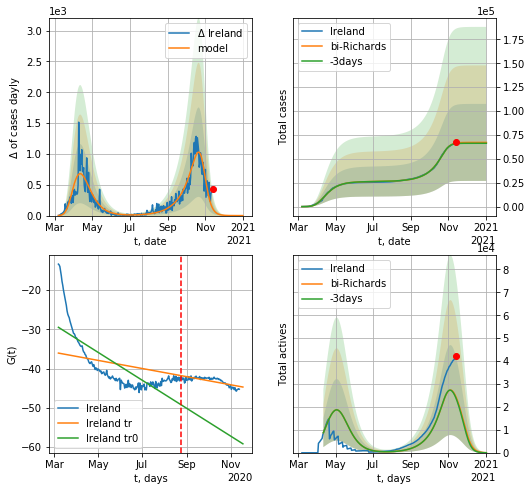

Ireland data at: 2020-11-14
+3 day model MAPE: 0.010275
model: bi-Richards
coeffs: [4.10061662e+04 4.89344912e-02 2.27686262e+02 3.61312489e+00]
rational stdev: 0.599813
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 67183 ± 40297
	 total death: 1967 ± 3539
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.589603
 intercept: -29.464126
 slope: -0.116032
trend coefficient of determination: 0.574666
 intercept: -36.035687
 slope: -0.033805


In [642]:
ivL = 7
vL = 170 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL+ivL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Ireland',dfIR[ivL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
252 2020-11-10  523907    9154  14611.0
253 2020-11-11  524804    8745  14633.0
254 2020-11-12  526438    9264  14699.0
255 2020-11-13  528030    9752  14738.0
256 2020-11-14  529676    9656  14777.0


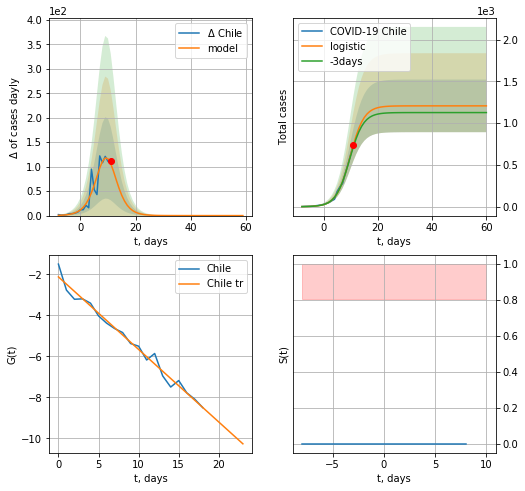

Chile data at: 2020-11-14
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


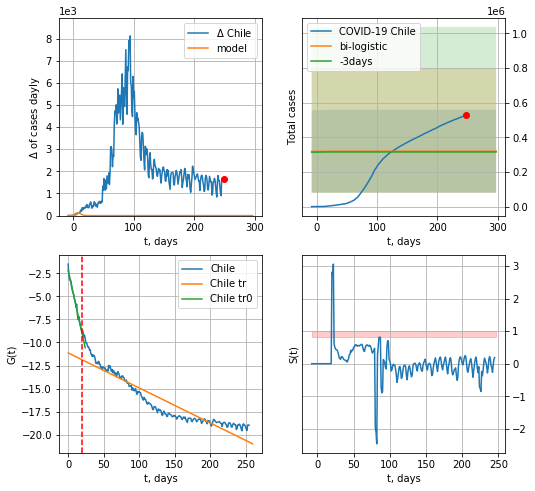

Chile data at: 2020-11-14
+3 day model MAPE: 0.012723988708556665
model: bi-logistic
coeffs:  [ 2.54783556e+05 -4.94295011e+01  1.17944567e+03] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7487655551166944
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  319687 ± 239370
	 total death:  8918 ± 20032
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.868349
 intercept: -11.133472
 slope: -0.037902


In [643]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


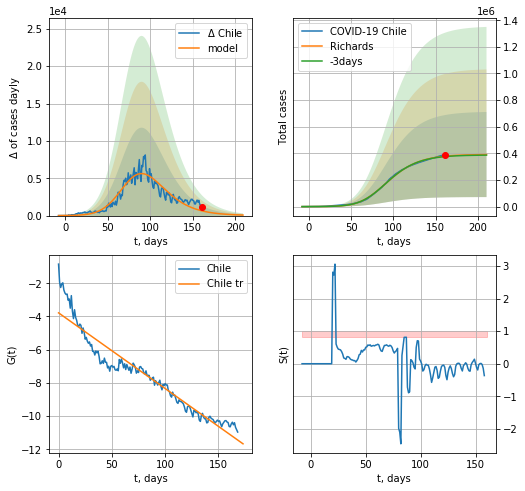

Chile data at: 2020-11-14
+3 day model MAPE: 0.007583
model: Richards
coeffs: [3.92652491e+05 1.16049666e-01 7.04582771e+01 4.00939983e-01]
rational stdev: 0.816952
forecast at the end of period: +49 days
	 deltaDaycases: 70
	 total cases: 391173 ± 319569
	 total death: 10913 ± 26746
trend coefficient of determination: 0.916357
 intercept: -3.781163
 slope: -0.045598
diffStd0a 0.7384167442527834


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:339: RuntimeWarning: overflow encountered in power


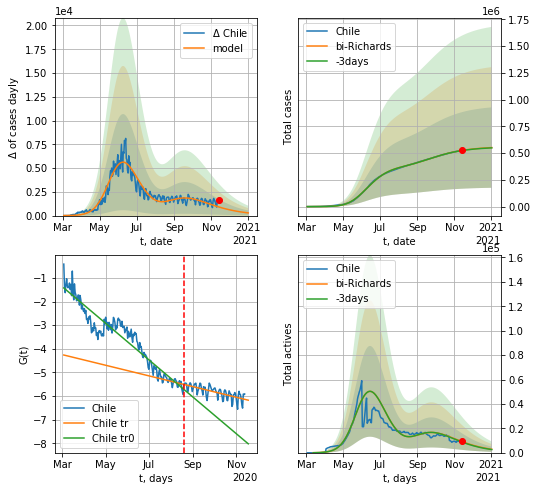

Chile data at: 2020-11-14
+3 day model MAPE: 0.002318
model: bi-Richards
coeffs: [1.69646723e+05 2.61119587e+00 3.25634888e+01 1.05923396e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.681304
forecast at the end of period: +49 days
	 deltaDaycases: 281
	 total cases: 551935 ± 376035
	 total death: 15398 ± 31472
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.913088
 intercept: -1.425686
 slope: -0.025368
trend coefficient of determination: 0.484692
 intercept: -4.263553
 slope: -0.007352


In [644]:
vL = 170
x = forecastRR('Chile',dfCL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL,amc=0.3)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

In [645]:
#x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

CH
           date     cases  active   death
254 2020-11-10  429880.0  147084  5323.0
255 2020-11-11  438805.0  147994  5570.0
256 2020-11-12  446675.0  140201  5755.0
257 2020-11-13  454030.0  131752  5926.0
258 2020-11-14  458229.0  129788  6058.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


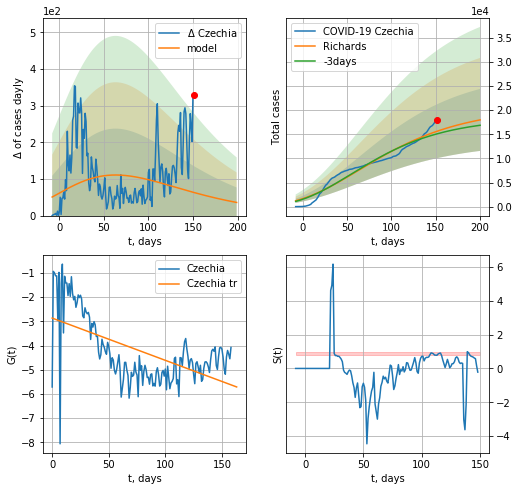

Czechia data at: 2020-11-14
+3 day model MAPE: 0.036194
model: Richards
coeffs: [ 2.05903469e+04  1.92716393e+00 -2.68842410e+02  7.61388243e-03]
rational stdev: 0.357386
forecast at the end of period: +49 days
	 deltaDaycases: 35
	 total cases: 17989 ± 6429
	 total death: 237 ± 254
trend coefficient of determination: 0.344405
 intercept: -2.865835
 slope: -0.017469


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 0.8986981535716256


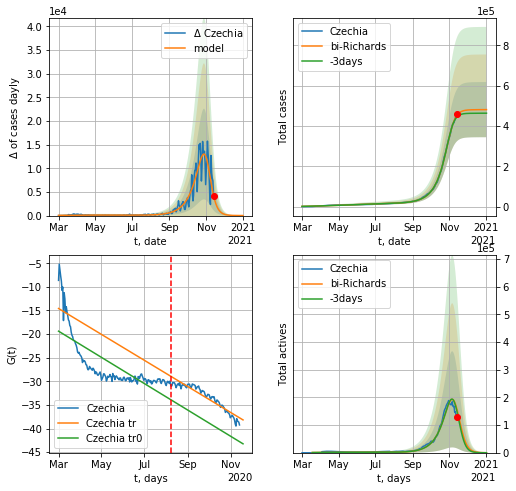

Czechia data at: 2020-11-14
+3 day model MAPE: 0.020606
model: bi-Richards
coeffs: [4.61487493e+05 6.31969322e-02 2.39487313e+02 2.64983900e+00]
rational stdev: 0.284333
forecast at the end of period: +49 days
	 deltaDaycases: 10
	 total cases: 481429 ± 136886
	 total death: 6364 ± 5428
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.566165
 intercept: -19.382546
 slope: -0.091024
trend coefficient of determination: 0.893611
 intercept: -14.579507
 slope: -0.090044


In [646]:
vL= 160
dfCH = read_df(pd.DataFrame(),"CH")
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Czechia',dfCH[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

In [647]:
dfMX = read_df(pd.DataFrame(),"MX")
#x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

MX
           date    cases  active    death
247 2020-11-10   978531  156843  95842.0
248 2020-11-11   986177  158279  96430.0
249 2020-11-12   991835  158582  97056.0
250 2020-11-13   997393  158429  97624.0
251 2020-11-14  1003253  159633  98259.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


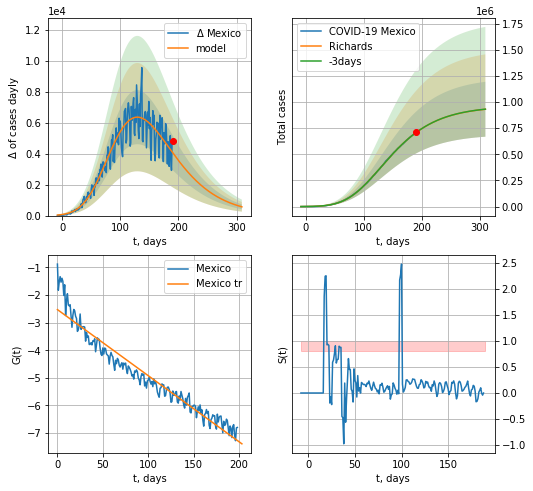

Mexico data at: 2020-11-14
+3 day model MAPE: 0.000227
model: Richards
coeffs: [9.60430195e+05 1.43865442e-01 2.46288519e+01 1.33315498e-01]
rational stdev: 0.281932
forecast at the end of period: +119 days
	 deltaDaycases: 564
	 total cases: 930723 ± 262400
	 total death: 91155 ± 77098
trend coefficient of determination: 0.932535
 intercept: -2.525774
 slope: -0.023953
diffStd0a 0.5405119929255225


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


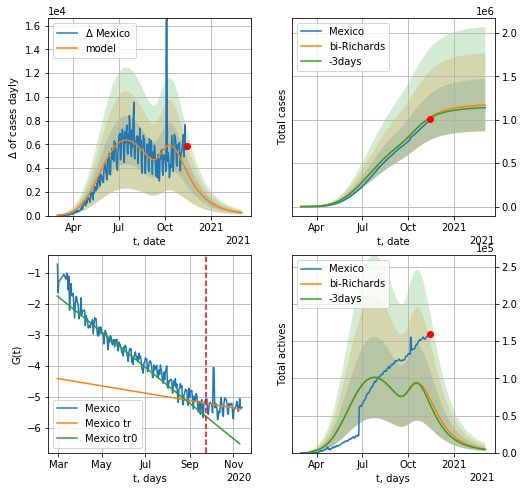

Mexico data at: 2020-11-14
+3 day model MAPE: 0.005964
model: bi-Richards
coeffs: [2.19227851e+05 2.79379161e+00 1.20248912e+02 1.45901457e-02]
rational stdev: 0.256885
forecast at the end of period: +119 days
	 deltaDaycases: 245
	 total cases: 1167789 ± 299987
	 total death: 114373 ± 88141
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.945837
 intercept: -1.747545
 slope: -0.018732
trend coefficient of determination: 0.035083
 intercept: -4.412220
 slope: -0.003852


In [648]:
vL = 200#60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RRD('Mexico',dfMX[:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date    cases  active  death      tests
246 2020-11-10  28262.0   21419  235.0  1132514.0
247 2020-11-11  29812.0   22382  244.0  1146969.0
248 2020-11-12  31878.0   24284  253.0  1162033.0
249 2020-11-13  33387.0   25322  266.0  1176612.0
250 2020-11-14  34758.0   26620  277.0  1183216.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


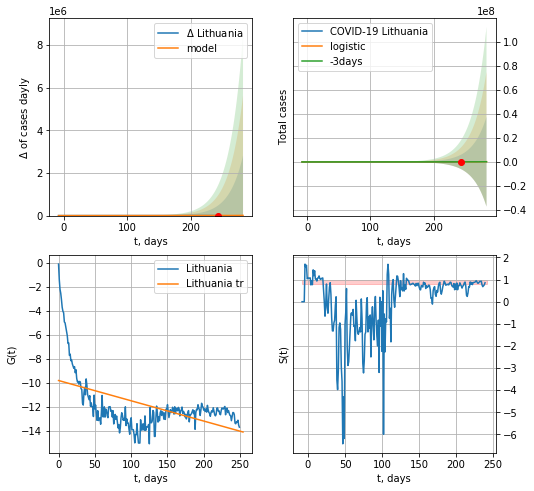

Lithuania data at: 2020-11-14
+3 day model MAPE: 0.09450347652121709
model: logistic
coeffs:  [1.86839823e+08 4.54780571e-02 4.32497297e+02]
rational stdev:  179.41024103951807
forecast at the end of period: +41 days
	 deltaDaycases:  9242
	 total cases:  208105 ± 37336286
	 total death:  1658 ± 892386
trend coefficient of determination: 0.265901
 intercept: -9.800147
 slope: -0.016890


In [775]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [776]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [777]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


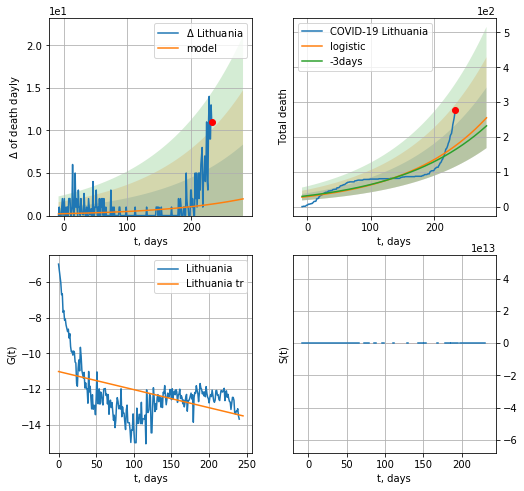

Lithuania data at: 2020-11-14
+3 day model MAPE: 0.06723472718530762
model: logistic
coeffs:  [5.17173863e+05 7.73892520e-03 1.26597703e+03]
rational stdev:  0.3412319085444878
forecast at the end of period: +49 days
	 total death:  254 ± 86
trend coefficient of determination: 0.193007
 intercept: -11.022302
 slope: -0.010141


In [778]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


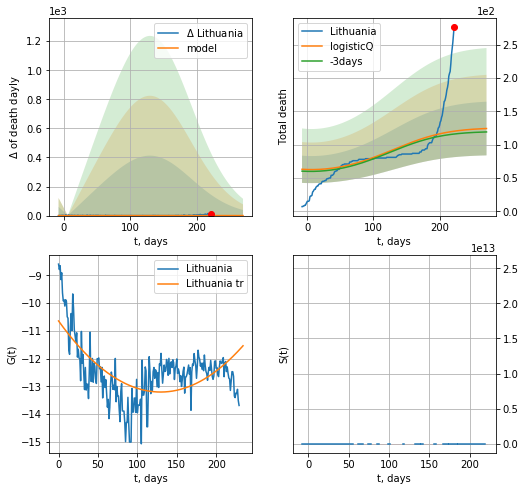

Lithuania data at: 2020-11-14
+3 day model MAPE: 0.036739
model: logisticQ
coeffs: [1.25362993e+02 6.82635378e-05 1.10528954e+01 1.97768528e+00]
rational stdev: 0.324308
forecast at the end of period: +49 days
	 total death: 124 ± 40
trend coefficient of determination: 0.384275
 intercept_: -10.640459401470286
 coeffs_: [ 0.         -0.0395973   0.00015286]


In [779]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
#x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


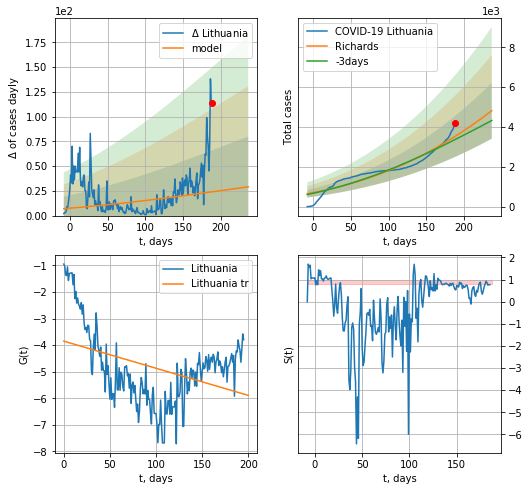

Lithuania data at: 2020-11-14
+3 day model MAPE: 0.047775
model: Richards
coeffs: [ 5.54183199e+04  1.08265666e-01 -8.74523027e+02  2.35063639e-02]
rational stdev: 0.291066
forecast at the end of period: +49 days
	 deltaDaycases: 29
	 total cases: 4819 ± 1402
	 total death: 38 ± 33
trend coefficient of determination: 0.159230
 intercept: -3.851608
 slope: -0.010200
diffStd0a 0.697764843844595


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


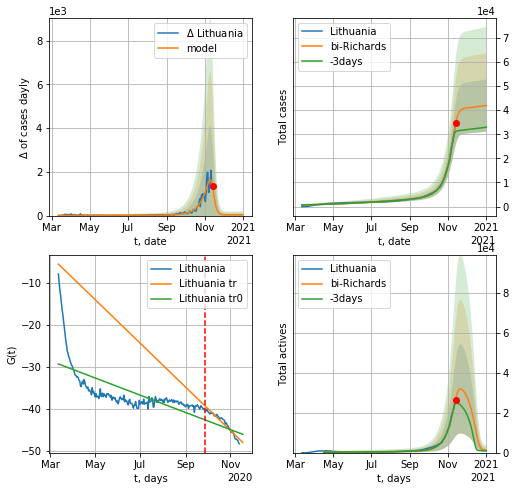

Lithuania data at: 2020-11-14
+3 day model MAPE: 0.148141
model: bi-Richards
coeffs: [3.54639270e+04 8.22034191e-02 2.39288844e+02 4.31029999e+00]
rational stdev: 0.259109
forecast at the end of period: +49 days
	 deltaDaycases: 34
	 total cases: 41904 ± 10857
	 total death: 333 ± 258
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.465849
 intercept: -29.272535
 slope: -0.066824
trend coefficient of determination: 0.931260
 intercept: -5.482958
 slope: -0.169377


In [780]:
iL = 3
vL =200+iL#170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RRD('Lithuania',dfLT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

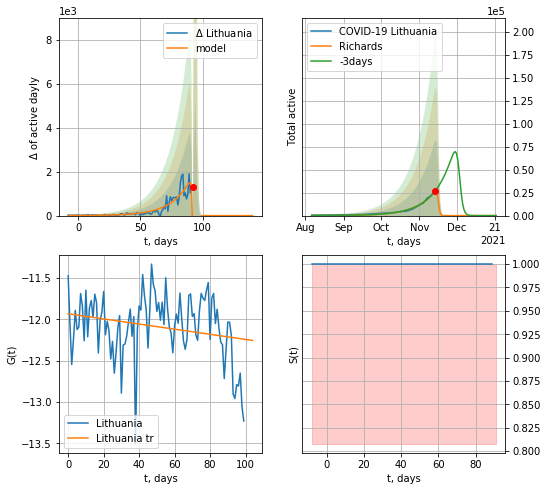

Lithuania data at: 2020-11-14
+3 day model MAPE: 0.113333
model: Richards
coeffs: [689.47884061   1.6364496   94.3276948    0.95617593]
rational stdev: 2.122016
forecast at the end of period: +49 days
	 total active: 0 ± 0
trend coefficient of determination: 0.052146
 intercept: -11.932872
 slope: -0.003102


In [781]:
iL = 150
vL =120+iL
RAkoreaCoeffs = [5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03]
x, t, tt, allmodel = forecastRRA('Lithuania',dfLT[iL:],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='active')#
#xx = forecast2RRA('Lithuania',dfLT[iL:],d1,90*7-dT,x,addpred=False,xcoef=RAkoreaCoeffs,vL=vL-iL,cases='active')#

In [782]:
import datetime
a=zip(tt, allmodel)
print (t)
i = -1
stdevc = 0.867612
for a1,a2 in a:
    i = i + 1
    #print (i)
    if i<t+8: continue
    start_date = "11/4/20"
    date_1 = datetime.datetime.strptime(start_date, "%m/%d/%y")
    end_date = date_1 + datetime.timedelta(days=int(a1)-82-8)
    print('active',(end_date.strftime("%Y/%m/%d)"),int(a2),'±',int(a2*stdevc)))
    print('5%',(end_date.strftime("%Y/%m/%d)"),int(a2*0.05),'±',int(0.05*a2*stdevc)))
    print('8%',(end_date.strftime("%Y/%m/%d)"),int(a2*0.08),'±',int(0.08*a2*stdevc)))
#dfLT['date'][tt]

92
active ('2020/11/14)', 26604, '±', 23082)
5% ('2020/11/14)', 1330, '±', 1154)
8% ('2020/11/14)', 2128, '±', 1846)
active ('2020/11/15)', 25791, '±', 22377)
5% ('2020/11/15)', 1289, '±', 1118)
8% ('2020/11/15)', 2063, '±', 1790)
active ('2020/11/16)', 19068, '±', 16543)
5% ('2020/11/16)', 953, '±', 827)
8% ('2020/11/16)', 1525, '±', 1323)
active ('2020/11/17)', 8091, '±', 7019)
5% ('2020/11/17)', 404, '±', 350)
8% ('2020/11/17)', 647, '±', 561)
active ('2020/11/18)', 2136, '±', 1853)
5% ('2020/11/18)', 106, '±', 92)
8% ('2020/11/18)', 170, '±', 148)
active ('2020/11/19)', 470, '±', 408)
5% ('2020/11/19)', 23, '±', 20)
8% ('2020/11/19)', 37, '±', 32)
active ('2020/11/20)', 99, '±', 85)
5% ('2020/11/20)', 4, '±', 4)
8% ('2020/11/20)', 7, '±', 6)
active ('2020/11/21)', 20, '±', 17)
5% ('2020/11/21)', 1, '±', 0)
8% ('2020/11/21)', 1, '±', 1)
active ('2020/11/22)', 4, '±', 3)
5% ('2020/11/22)', 0, '±', 0)
8% ('2020/11/22)', 0, '±', 0)
active ('2020/11/23)', 0, '±', 0)
5% ('2020/11/23)', 0

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


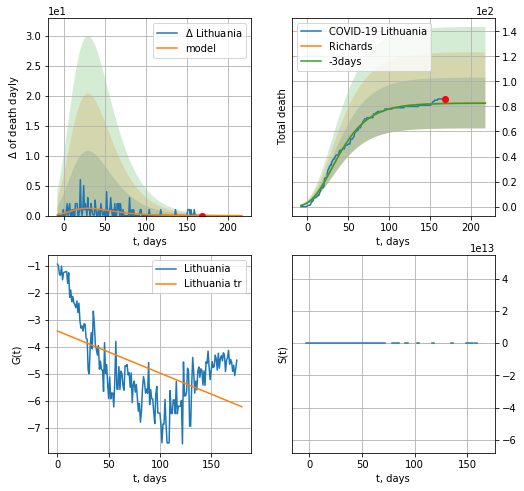

Lithuania data at: 2020-11-13
+3 day model MAPE: 0.002495
model: Richards
coeffs: [ 8.28105392e+01  6.19948354e+00 -9.53688137e+01  6.48963991e-03]
rational stdev: 0.244736
forecast at the end of period: +50 days
	 total death: 82 ± 20
trend coefficient of determination: 0.280445
 intercept: -3.404567
 slope: -0.015594
diffStd0a 134.36446689489253


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


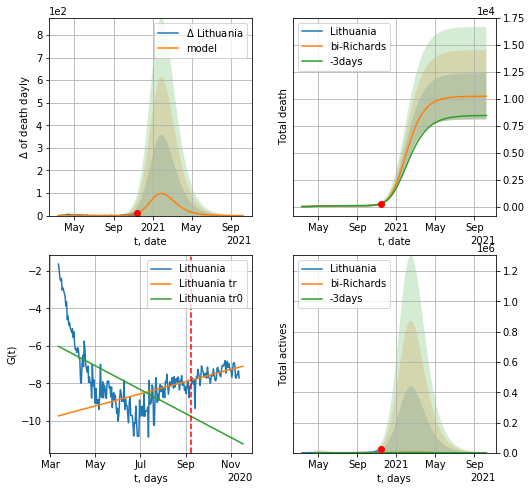

Lithuania data at: 2020-11-13
+3 day model MAPE: 0.015990
model: bi-Richards
coeffs: [1.01615472e+04 7.20365872e-02 2.88223928e+02 4.43397909e-01]
rational stdev: 0.209700
forecast at the end of period: +330 days
	 total death: 10241 ± 2147
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.342325
 intercept: -6.023604
 slope: -0.020849
trend coefficient of determination: 0.255607
 intercept: -9.743142
 slope: 0.010631


In [272]:
iL = 3
vL =180+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='death')#
xx = forecast2RRD('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,cases='death')#

In [273]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date    cases  active  death
248 2020-11-10  23710.0    9418  198.0
249 2020-11-11  24505.0   10205  206.0
250 2020-11-12  25218.0   10209  211.0
251 2020-11-13  25931.0   10284  219.0
252 2020-11-14  26544.0   10894  222.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


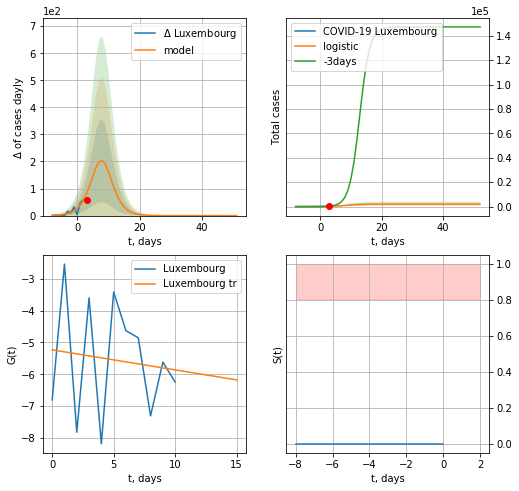

Luxembourg data at: 2020-11-14
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1877 ± 672
	 total death:  15 ± 16
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


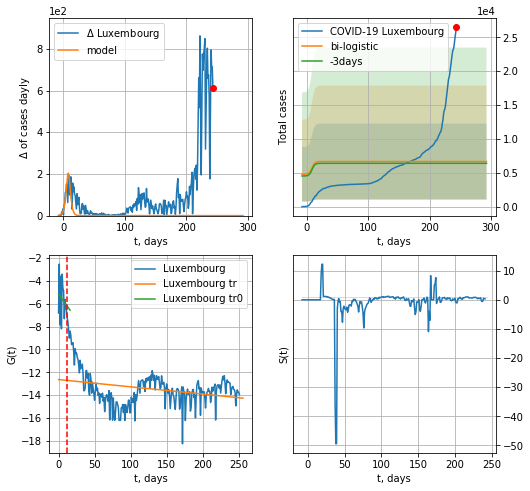

Luxembourg data at: 2020-11-14
+3 day model MAPE: 0.04172871621399897
model: bi-logistic
coeffs:  [4252.76941246  -24.58248629  613.23497054] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.841955341385446
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  6661 ± 5609
	 total death:  55 ± 138
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.082182
 intercept: -12.633495
 slope: -0.006346


In [650]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


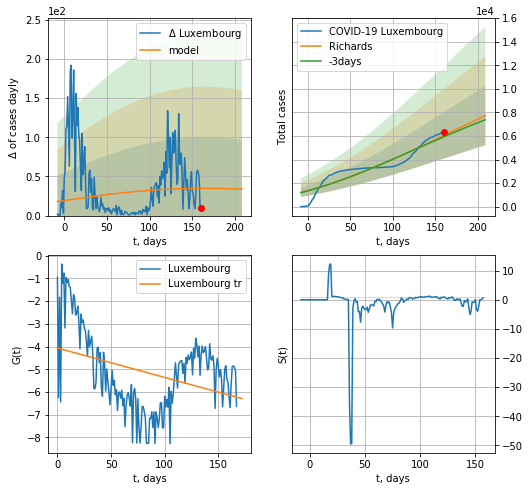

Luxembourg data at: 2020-11-14
+3 day model MAPE: 0.019794
model: Richards
coeffs: [ 1.66800613e+04  3.06060203e-01 -5.31170358e+02  1.86938235e-02]
rational stdev: 0.324841
forecast at the end of period: +49 days
	 deltaDaycases: 33
	 total cases: 7729 ± 2510
	 total death: 64 ± 62
trend coefficient of determination: 0.129435
 intercept: -4.066706
 slope: -0.012924
diffStd0a 1.2855364688834152


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


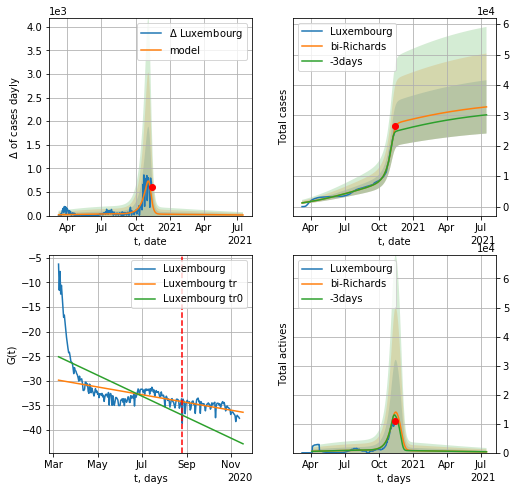

Luxembourg data at: 2020-11-14
+3 day model MAPE: 0.066801
model: bi-Richards
coeffs: [1.85333280e+04 7.64644275e-02 2.38017301e+02 3.32079815e+00]
rational stdev: 0.267303
forecast at the end of period: +245 days
	 deltaDaycases: 12
	 total cases: 32793 ± 8765
	 total death: 274 ± 219
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.406572
 intercept: -25.099378
 slope: -0.069364
trend coefficient of determination: 0.269257
 intercept: -29.853517
 slope: -0.025571


In [651]:
iL=1
vL = 170+iL#105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Luxembourg",dfLX[iL:],d1,68*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


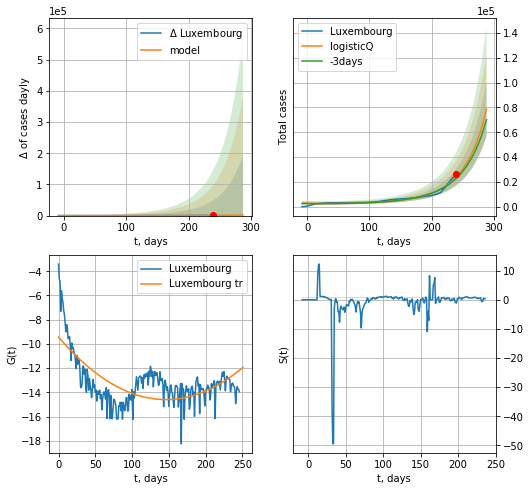

Luxembourg data at: 2020-11-14
+3 day model MAPE: 0.046879
model: logisticQ
coeffs: [ 7.61887389e+07  5.28982391e-05  4.73860066e+02 -4.11129697e+02]
rational stdev: 0.280448
forecast at the end of period: +49 days
	 deltaDaycases: 2103
	 total cases: 78753 ± 22086
	 total death: 658 ± 553
trend coefficient of determination: 0.452527
 intercept_: -9.443122275278544
 coeffs_: [ 0.         -0.07062212  0.00024177]


In [652]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [653]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases   active    death
255 2020-11-10  175711.0   7906.0  12849.0
256 2020-11-11  176630.0   8754.0  12920.0
257 2020-11-12  177513.0   9611.0  12946.0
258 2020-11-13  178674.0  10741.0  12977.0
259 2020-11-14  179627.0  11674.0  12997.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


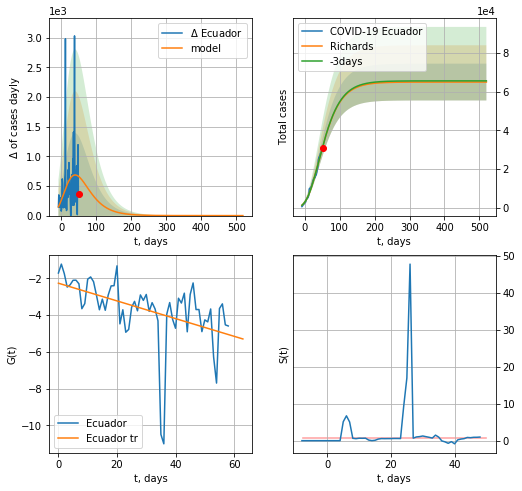

Ecuador data at: 2020-11-14
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +469 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 4696 ± 2060
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096
diffStd0a 0.7288346482413081


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


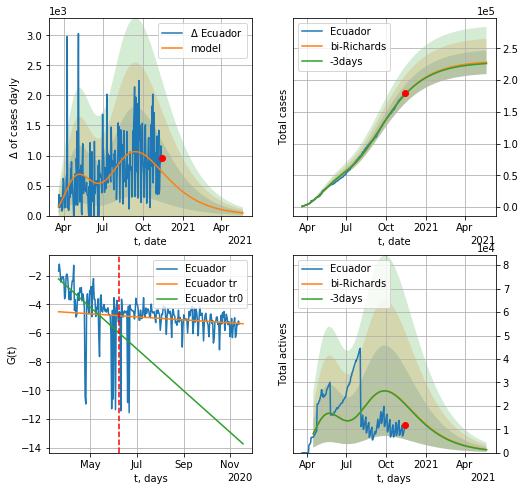

Ecuador data at: 2020-11-14
+3 day model MAPE: 0.002503
model: bi-Richards
coeffs: [ 1.65870007e+05  1.66711669e+00 -9.78424095e+01  1.01227160e-02]
rational stdev: 0.081456
forecast at the end of period: +189 days
	 deltaDaycases: 43
	 total cases: 228167 ± 18585
	 total death: 16509 ± 4034
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.273818
 intercept: -2.222093
 slope: -0.047328
trend coefficient of determination: 0.021543
 intercept: -4.514753
 slope: -0.003430


In [654]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Ecuador",dfED[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.75)

In [655]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date    cases  active  death
259 2020-11-10  18107.0    5044  363.0
260 2020-11-11  18345.0    3980  365.0
261 2020-11-12  18542.0    4177  365.0
262 2020-11-13  18858.0    4489  369.0
263 2020-11-14  19102.0    4733  369.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


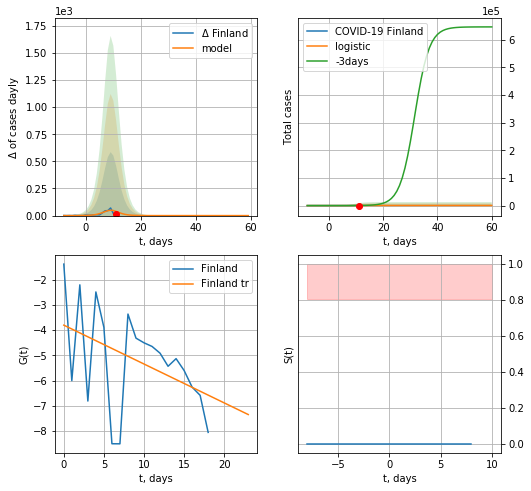

Finland data at: 2020-11-14
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  7 ± 231
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


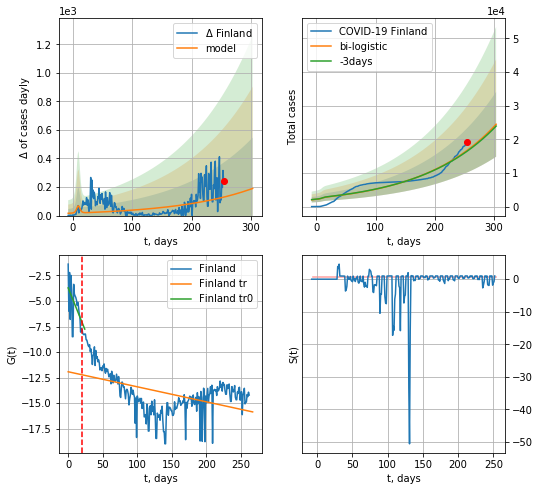

Finland data at: 2020-11-14
+3 day model MAPE: 0.015489318796031456
model: bi-logistic
coeffs:  [2.16373517e+07 7.91847926e-03 1.16251992e+03] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3940475648100087
forecast at the end of period: +49 days
	 deltaDaycases:  190
	 total cases:  24493 ± 9651
	 total death:  473 ± 559
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.229856
 intercept: -11.933556
 slope: -0.014733


In [656]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


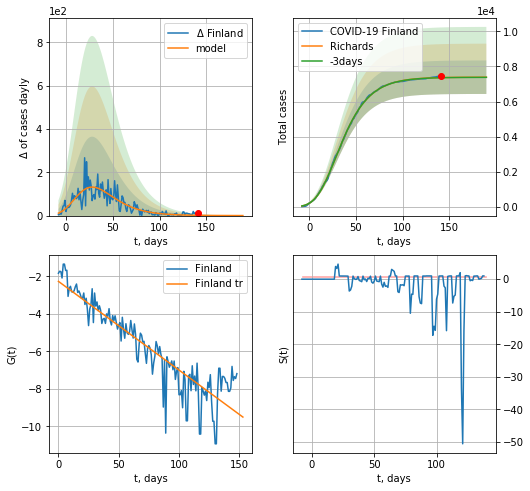

Finland data at: 2020-11-14
+3 day model MAPE: 0.001103
model: Richards
coeffs: [ 7.38854164e+03  5.39963308e-01 -1.81801816e+01  9.38814747e-02]
rational stdev: 0.129256
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 7386 ± 954
	 total death: 142 ± 55
trend coefficient of determination: 0.823115
 intercept: -2.267352
 slope: -0.047318
diffStd0a 0.29512096546285393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


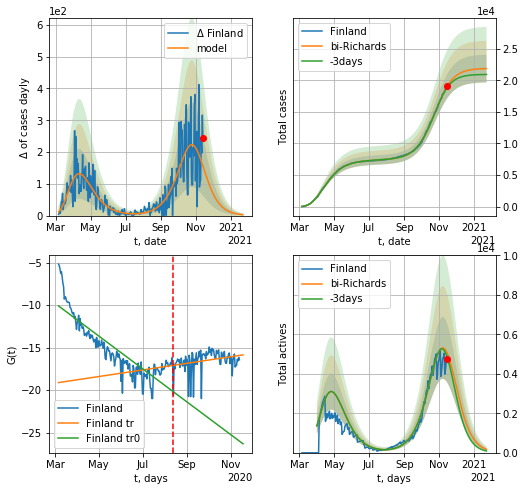

Finland data at: 2020-11-14
+3 day model MAPE: 0.010648
model: bi-Richards
coeffs: [1.44976959e+04 5.36967848e-02 2.28172678e+02 1.22452493e+00]
rational stdev: 0.100461
forecast at the end of period: +70 days
	 deltaDaycases: 2
	 total cases: 21847 ± 2194
	 total death: 422 ± 127
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.748400
 intercept: -10.089574
 slope: -0.063165
trend coefficient of determination: 0.078430
 intercept: -19.112946
 slope: 0.012683


In [657]:
vL = 170#96 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Finland",dfFI[10:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10,amc=0.75)

In [658]:
## x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases   active   death
245 2020-11-10  83366  55716.0  1851.0
246 2020-11-11  87311  58699.0  1898.0
247 2020-11-12  90725  61168.0  1970.0
248 2020-11-13  94937  64613.0  2055.0
249 2020-11-14  97435  66539.0  2091.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


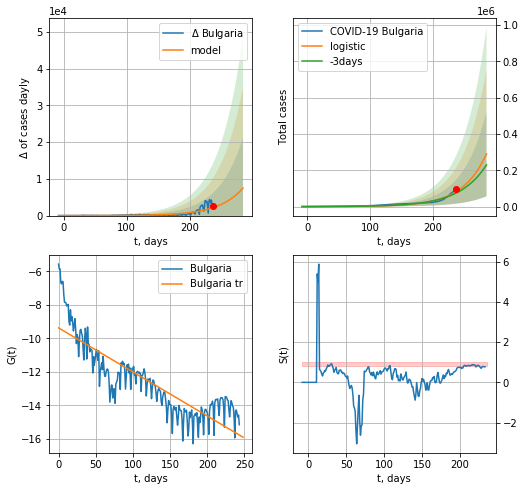

Bulgaria data at: 2020-11-14
+3 day model MAPE: 0.10451574667972062
model: logistic
coeffs:  [6.64475650e+08 2.60943743e-02 5.81407137e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.8025606587238683
forecast at the end of period: +49 days
	 deltaDaycases:  7480
	 total cases:  290544 ± 233179
	 total death:  6235 ± 15011
trend coefficient of determination: 0.737274
 intercept: -9.368968
 slope: -0.026313


In [659]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,T18*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


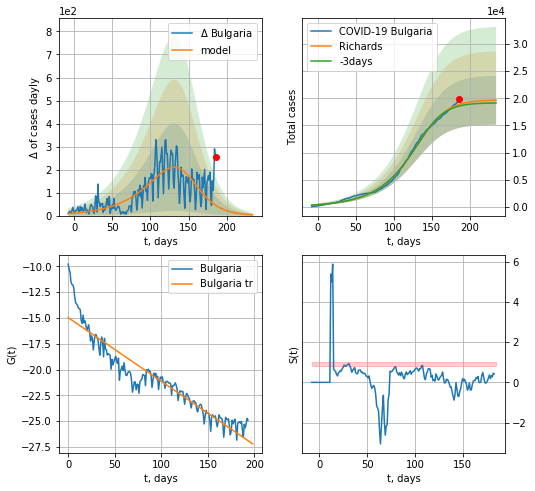

Bulgaria data at: 2020-11-14
+3 day model MAPE: 0.015854
model: Richards
coeffs: [1.96955662e+04 2.71935660e-02 1.44494444e+02 2.07644343e+00]
rational stdev: 0.229297
forecast at the end of period: +49 days
	 deltaDaycases: 3
	 total cases: 19638 ± 4503
	 total death: 421 ± 289
trend coefficient of determination: 0.884878
 intercept: -14.971872
 slope: -0.061709
diffStd0a 0.35214669957738465


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


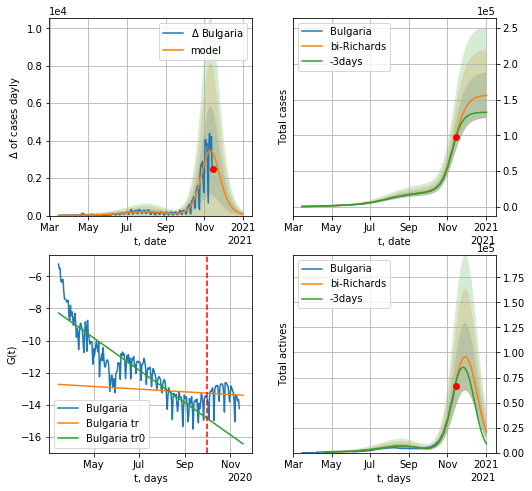

Bulgaria data at: 2020-11-14
+3 day model MAPE: 0.021654
model: bi-Richards
coeffs: [1.37121703e+05 1.07478939e-01 2.32103499e+02 9.19309971e-01]
rational stdev: 0.204647
forecast at the end of period: +49 days
	 deltaDaycases: 82
	 total cases: 156017 ± 31928
	 total death: 3348 ± 2055
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.810117
 intercept: -8.283479
 slope: -0.032802
trend coefficient of determination: 0.003039
 intercept: -12.724377
 slope: -0.002717


In [660]:
vL = 200+5#71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Bulgaria',dfBL[5:],d1,40*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [661]:
#x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
257 2020-11-10  3847.0   102.0   60.0
258 2020-11-11  3852.0    99.0   60.0
259 2020-11-12  3861.0   104.0   60.0
260 2020-11-13  3866.0    99.0   60.0
261 2020-11-14  3874.0    99.0   60.0


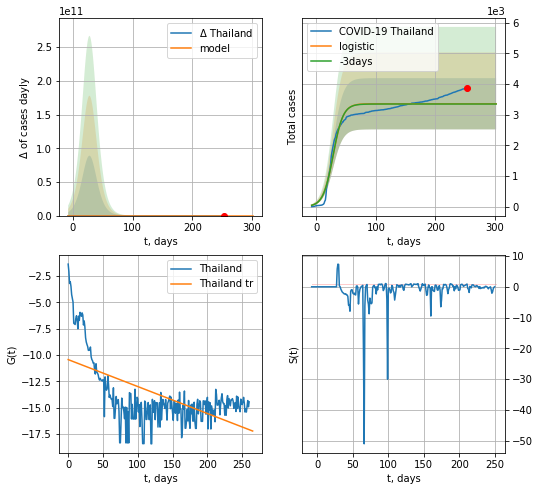

Thailand data at: 2020-11-14
+3 day model MAPE: 0.002545835397866267
model: logistic
coeffs:  [3.35796160e+03 1.19071942e-01 2.80944776e+01]
rational stdev:  0.24895362518623435
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  3357 ± 835
	 total death:  52 ± 38
trend coefficient of determination: 0.360250
 intercept: -10.438417
 slope: -0.025544


In [662]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [663]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


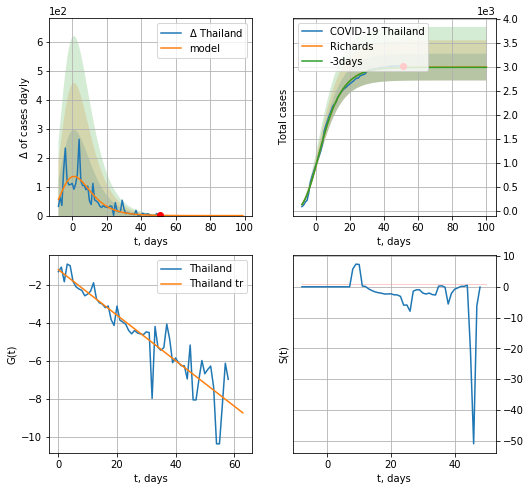

Thailand data at: 2020-11-14
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 46 ± 12
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672
diffStd0a 0.42765358576148826


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


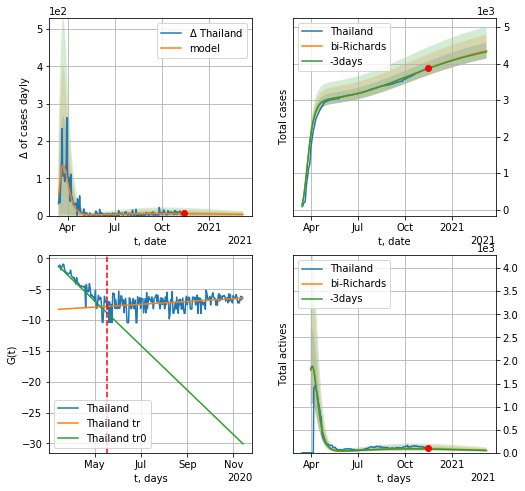

Thailand data at: 2020-11-14
+3 day model MAPE: 0.001663
model: bi-Richards
coeffs: [ 1.77434966e+03  9.24253347e-01 -3.51182284e+02  9.22940509e-03]
rational stdev: 0.049899
forecast at the end of period: +119 days
	 deltaDaycases: 3
	 total cases: 4352 ± 217
	 total death: 67 ± 10
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843398
 intercept: -1.258455
 slope: -0.117605
trend coefficient of determination: 0.113238
 intercept: -8.249766
 slope: 0.007393


In [664]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Thailand",dfTH[20:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.5)

In [665]:
#x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

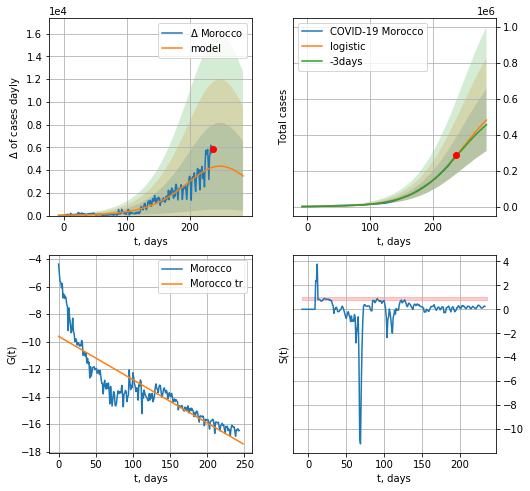

Morocco data at: 2020-11-14
+3 day model MAPE: 0.015314341821177488
model: logistic
coeffs:  [6.62591095e+05 2.62882023e-02 2.47887367e+02]
rational stdev:  0.3585162683430522
forecast at the end of period: +49 days
	 deltaDaycases:  3483
	 total cases:  481199 ± 172517
	 total death:  7842 ± 8434
trend coefficient of determination: 0.765715
 intercept: -9.613802
 slope: -0.031521


In [666]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


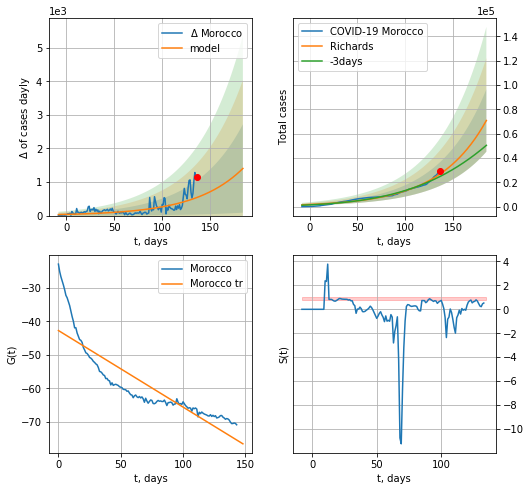

Morocco data at: 2020-11-14
+3 day model MAPE: 0.084312
model: Richards
coeffs: [2.79033948e+05 2.00180443e-02 2.53488041e+02 6.56605643e+00]
rational stdev: 0.361985
forecast at the end of period: +49 days
	 deltaDaycases: 1403
	 total cases: 70832 ± 25640
	 total death: 1154 ± 1253
trend coefficient of determination: 0.761351
 intercept: -42.734375
 slope: -0.228487
diffStd0a 1.3155240117980604


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


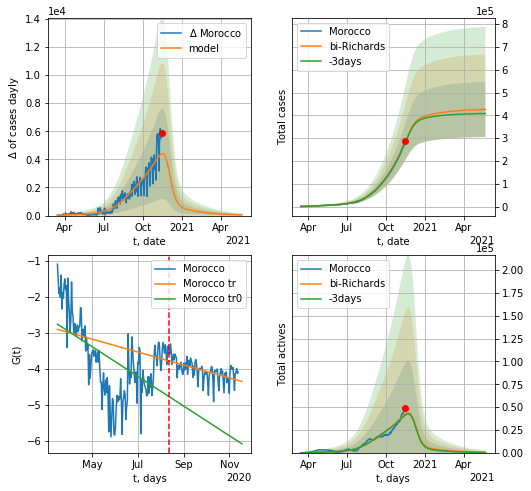

Morocco data at: 2020-11-14
+3 day model MAPE: 0.010153
model: bi-Richards
coeffs: [ 1.49580804e+05  1.17725802e+00 -2.57780629e+01  1.54445930e-02]
rational stdev: 0.283031
forecast at the end of period: +189 days
	 deltaDaycases: 48
	 total cases: 425968 ± 120562
	 total death: 6942 ± 5894
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.300477
 intercept: -2.754688
 slope: -0.013437
trend coefficient of determination: 0.326729
 intercept: -2.898070
 slope: -0.005849


In [667]:
vL = 155 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Morocco",dfMR[5:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5,amc=0.33)

In [668]:
#x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [669]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases  active   death
258 2020-11-10  314295.0   94701  8186.0
259 2020-11-11  324094.0   97619  8389.0
260 2020-11-12  334236.0  100810  8510.0
261 2020-11-13  343725.0  103233  8684.0
262 2020-11-14  353185.0  105321  8813.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


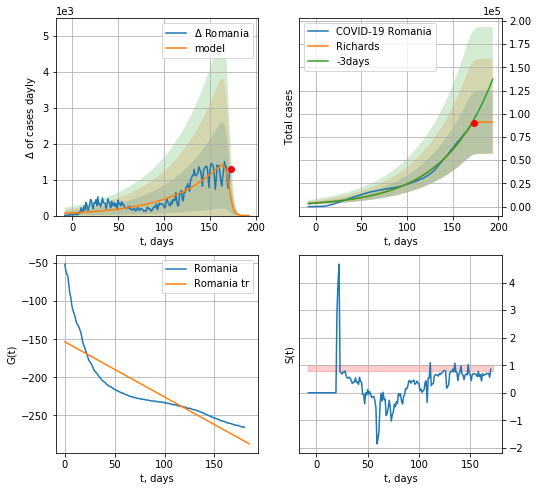

Romania data at: 2020-11-14
+3 day model MAPE: 0.053954
model: Richards
coeffs: [9.10483361e+04 1.84517813e-02 1.71468019e+02 2.28787361e+01]
rational stdev: 0.374976
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 91048 ± 34140
	 total death: 2271 ± 2554
trend coefficient of determination: 0.713660
 intercept: -153.246272
 slope: -0.723824
diffStd0a 0.9404154950269763


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


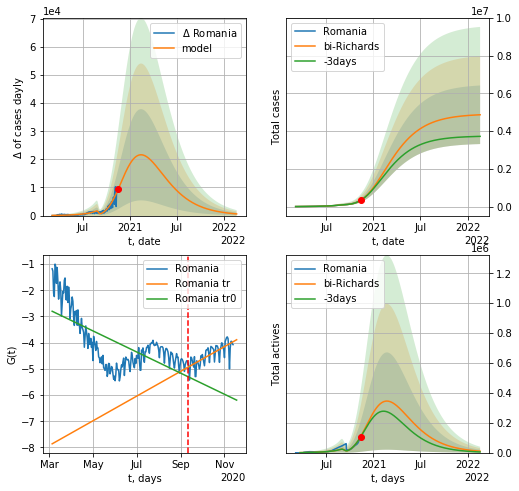

Romania data at: 2020-11-14
+3 day model MAPE: 0.010727
model: bi-Richards
coeffs: [4.82645431e+06 3.46971629e-01 6.82979383e+01 3.57503639e-02]
rational stdev: 0.318877
forecast at the end of period: +462 days
	 deltaDaycases: 596
	 total cases: 4869426 ± 1552746
	 total death: 121506 ± 116236
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.477111
 intercept: -2.801820
 slope: -0.013140
trend coefficient of determination: 0.547539
 intercept: -7.859539
 slope: 0.015391


In [670]:
vL = 190+8#87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Romania",dfRM[8:],d12f(1),99*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8,amc=0.5)

In [671]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [672]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

In [673]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
#x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
#xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

EU
           date    cases   active     death
276 2020-11-10  8434606  4092417  201374.0
277 2020-11-11  8639459  4194745  204530.0
278 2020-11-12  8851422  4291074  207469.0
279 2020-11-13  9045499  4364154  211071.0
280 2020-11-14  9217952  4444102  213626.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


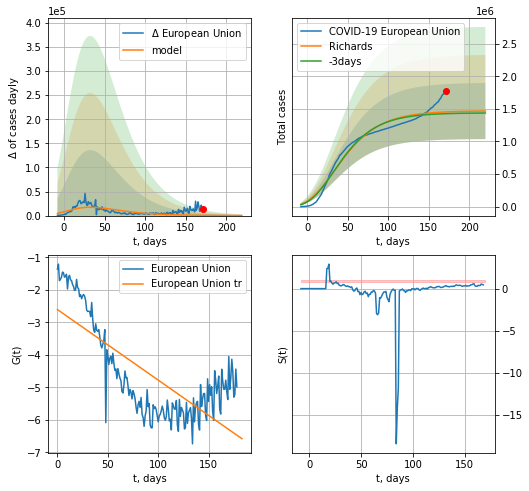

European Union data at: 2020-11-14
+3 day model MAPE: 0.018821
model: Richards
coeffs: [ 1.47108264e+06  9.68553883e+00 -1.45516242e+02  3.30701527e-03]
rational stdev: 0.293203
forecast at the end of period: +49 days
	 deltaDaycases: 118
	 total cases: 1467425 ± 430254
	 total death: 34007 ± 29912
trend coefficient of determination: 0.571524
 intercept: -2.605625
 slope: -0.021726
diffStd0a 0.3063814595188117


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


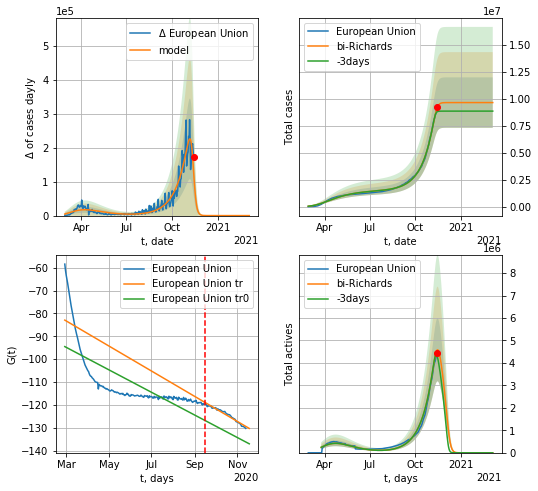

European Union data at: 2020-11-14
+3 day model MAPE: 0.052288
model: bi-Richards
coeffs: [8.16169022e+06 4.12503320e-02 2.50424565e+02 7.87848300e+00]
rational stdev: 0.242413
forecast at the end of period: +112 days
	 deltaDaycases: 1
	 total cases: 9632736 ± 2335105
	 total death: 223238 ± 162347
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.534496
 intercept: -94.503967
 slope: -0.161243
trend coefficient of determination: 0.963423
 intercept: -82.906400
 slope: -0.179674


In [674]:
vL = 200+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("European Union",dfEU[20:],d1,49*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.75)

In [675]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [676]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [677]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [678]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [679]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [680]:
#dfIC[:]

IC
           date   cases  active  death
254 2020-11-10  5114.0     569   24.0
255 2020-11-11  5142.0     542   24.0
256 2020-11-12  5160.0     472   25.0
257 2020-11-13  5170.0     447   25.0
258 2020-11-14  5186.0     394   25.0


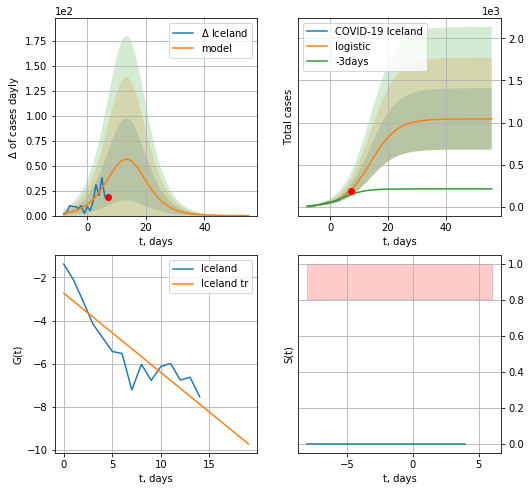

Iceland data at: 2020-11-14
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1042 ± 364
	 total death:  5 ± 5
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


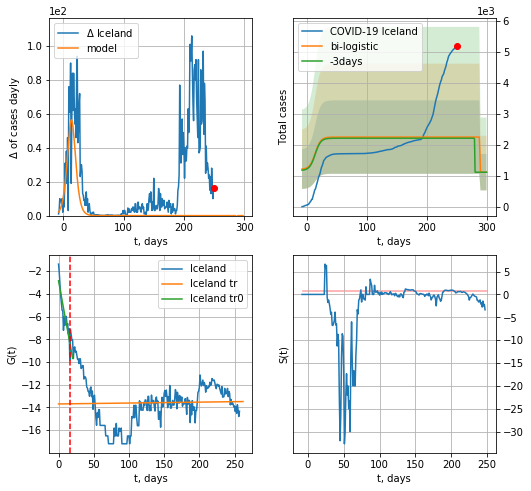

Iceland data at: 2020-11-14
+3 day model MAPE: 0.016859179978569627
model: bi-logistic
coeffs:  [1134.88464292  -10.62991041  288.01880465] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.5276687217879762
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1113 ± 587
	 total death:  5 ± 7
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.000770
 intercept: -13.690224
 slope: 0.000800


In [681]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


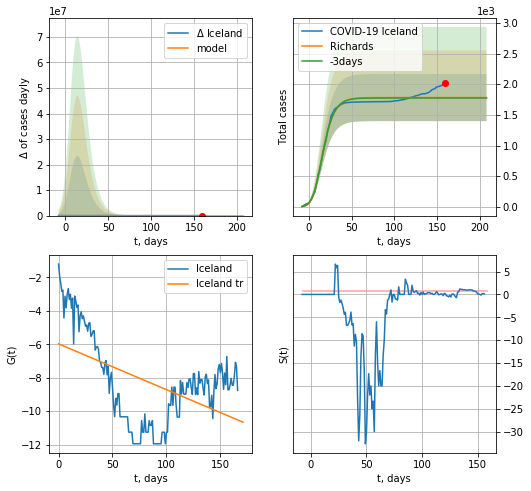

Iceland data at: 2020-11-14
+3 day model MAPE: 0.003798
model: Richards
coeffs: [1.78218704e+03 4.15281218e-01 4.51711528e+00 2.96176572e-01]
rational stdev: 0.215516
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1782 ± 384
	 total death: 8 ± 5
trend coefficient of determination: 0.246093
 intercept: -5.976231
 slope: -0.027410
diffStd0a 0.5837739979633613


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


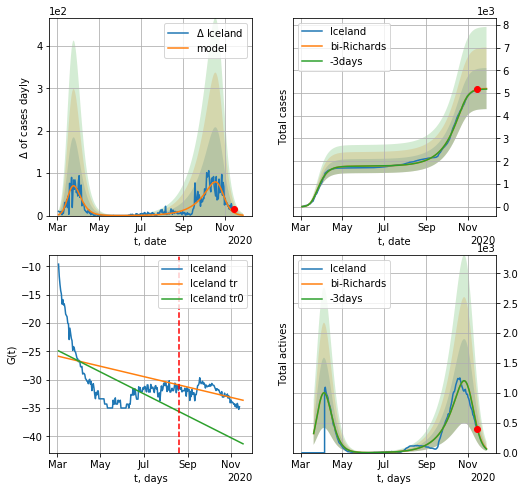

Iceland data at: 2020-11-14
+3 day model MAPE: 0.003750
model: bi-Richards
coeffs: [3.41998106e+03 4.65734618e-02 2.28897435e+02 3.38909943e+00]
rational stdev: 0.173904
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 5196 ± 903
	 total death: 25 ± 13
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.358556
 intercept: -24.897716
 slope: -0.063105
trend coefficient of determination: 0.346634
 intercept: -25.856150
 slope: -0.029833


In [682]:
vL = 170+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Iceland",dfIC[2:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2,amc=0.5)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [683]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
245 2020-11-10  141302  18778.0  2817.0
246 2020-11-11  142465  18819.0  2823.0
247 2020-11-12  143352  18452.0  2830.0
248 2020-11-13  144477  18392.0  2856.0
249 2020-11-14  145309  18171.0  2867.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


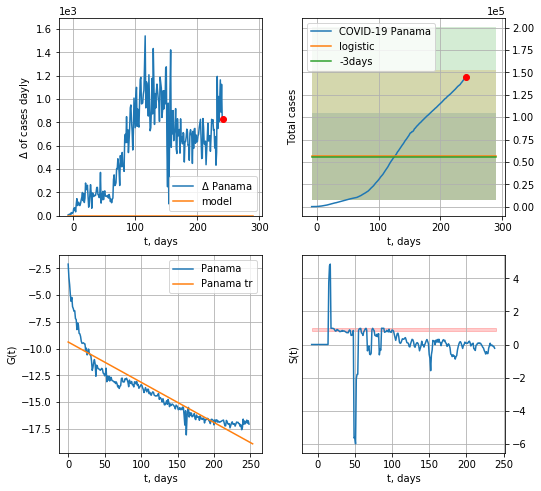

Panama data at: 2020-11-14
+3 day model MAPE: 0.01953785804067628
model: logistic
coeffs:  [ 5.60089480e+04 -4.67058054e+01  1.12806244e+03]
rational stdev:  0.8619833555765726
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  56008 ± 48278
	 total death:  1105 ± 2857
trend coefficient of determination: 0.819347
 intercept: -9.376334
 slope: -0.037600


In [684]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


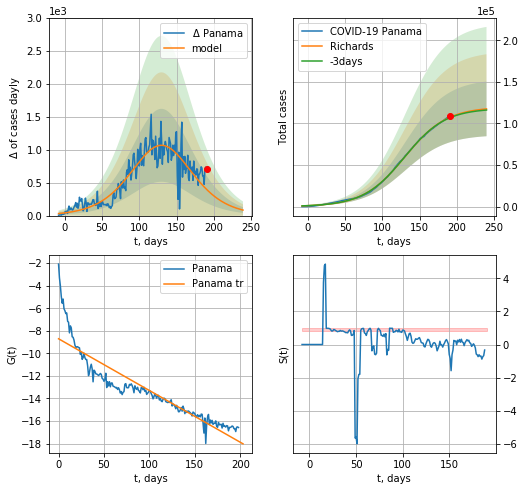

Panama data at: 2020-11-14
+3 day model MAPE: 0.005567
model: Richards
coeffs: [1.19896601e+05 3.57923760e-02 1.30053496e+02 9.93824719e-01]
rational stdev: 0.279661
forecast at the end of period: +49 days
	 deltaDaycases: 83
	 total cases: 117528 ± 32868
	 total death: 2318 ± 1944
trend coefficient of determination: 0.824637
 intercept: -8.707636
 slope: -0.045883
diffStd0a 0.43314775708557784


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


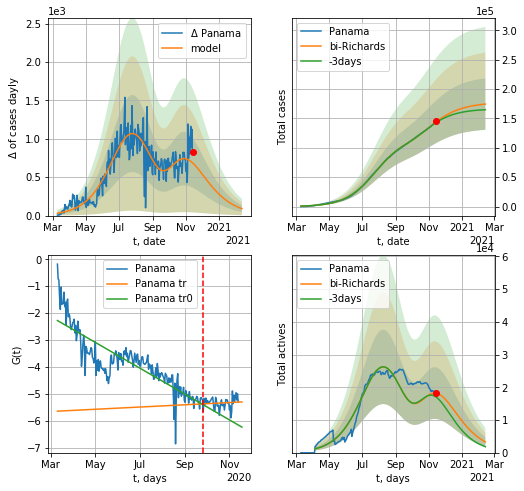

Panama data at: 2020-11-14
+3 day model MAPE: 0.008116
model: bi-Richards
coeffs: [5.76446843e+04 2.37884641e+00 8.43802231e+01 1.24271785e-02]
rational stdev: 0.250827
forecast at the end of period: +91 days
	 deltaDaycases: 90
	 total cases: 174460 ± 43759
	 total death: 3442 ± 2590
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.737732
 intercept: -2.276761
 slope: -0.015667
trend coefficient of determination: 0.008648
 intercept: -5.648472
 slope: 0.001360


In [686]:
vL = 200#70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)

In [687]:
#x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


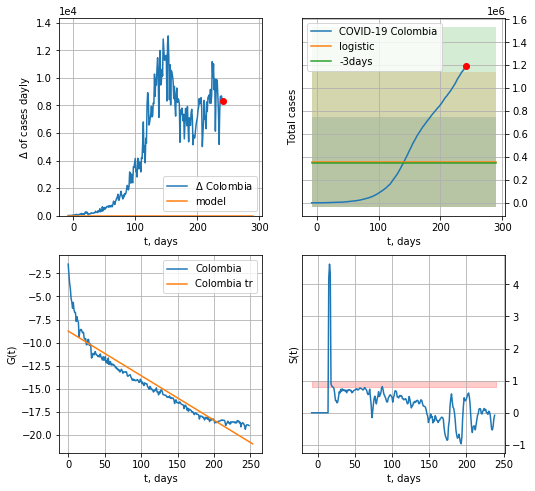

Colombia data at: 2020-11-14
+3 day model MAPE: 0.02868571358910452
model: logistic
coeffs:  [ 3.58797311e+05 -2.62034648e+01  6.28807666e+02]
rational stdev:  1.0918936715394914
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  358797 ± 391768
	 total death:  10191 ± 33382
trend coefficient of determination: 0.895743
 intercept: -8.741755
 slope: -0.048180


In [688]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


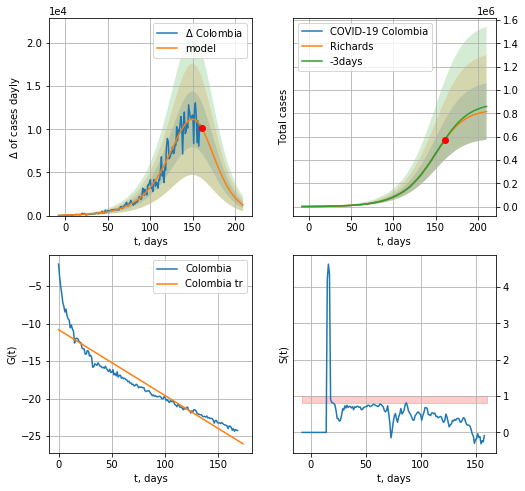

Colombia data at: 2020-11-14
+3 day model MAPE: 0.007195
model: Richards
coeffs: [8.34733445e+05 4.05910499e-02 1.56797482e+02 1.52613261e+00]
rational stdev: 0.296867
forecast at the end of period: +49 days
	 deltaDaycases: 1216
	 total cases: 815075 ± 241968
	 total death: 23151 ± 20618
trend coefficient of determination: 0.889696
 intercept: -10.819712
 slope: -0.087917
diffStd0a 0.5345107854928475


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


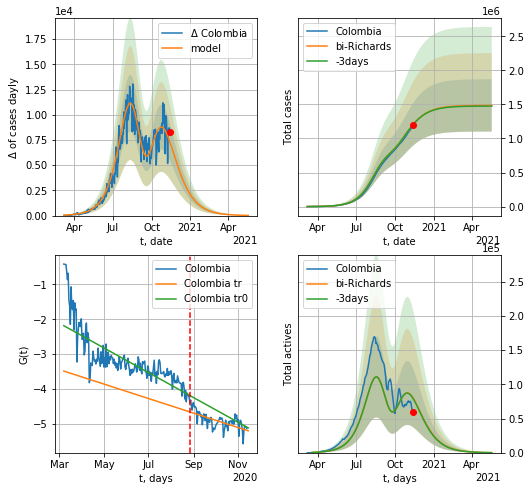

Colombia data at: 2020-11-14
+3 day model MAPE: 0.001030
model: bi-Richards
coeffs: [6.51786767e+05 2.85343813e+00 9.99572483e+01 1.22038226e-02]
rational stdev: 0.258427
forecast at the end of period: +189 days
	 deltaDaycases: 19
	 total cases: 1485975 ± 384015
	 total death: 42207 ± 32722
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.634594
 intercept: -2.185068
 slope: -0.011584
trend coefficient of determination: 0.436470
 intercept: -3.486457
 slope: -0.006775


In [689]:
vL = 170#41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Colombia",dfCB[:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.333)

In [690]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active   death
251 2020-11-10  63446.0   18743  2077.0
252 2020-11-11  64257.0   19184  2093.0
253 2020-11-12  65108.0   20017  2111.0
254 2020-11-13  65975.0   20072  2124.0
255 2020-11-14  66819.0   20481  2139.0


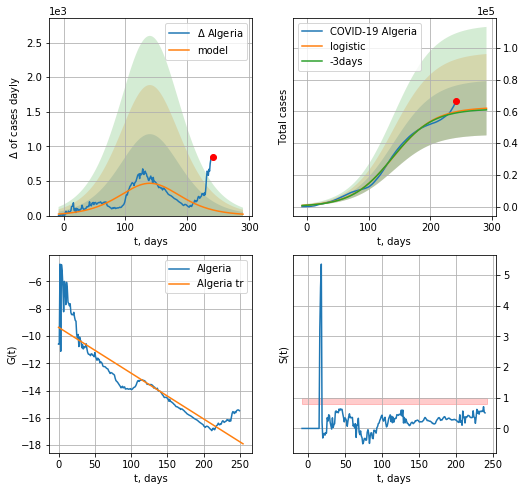

Algeria data at: 2020-11-14
+3 day model MAPE: 0.012636875311368454
model: logistic
coeffs:  [6.26450839e+04 2.98133182e-02 1.39982020e+02]
rational stdev:  0.27567534875875177
forecast at the end of period: +49 days
	 deltaDaycases:  20
	 total cases:  61958 ± 17080
	 total death:  1983 ± 1639
trend coefficient of determination: 0.827567
 intercept: -9.365485
 slope: -0.033635


In [691]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


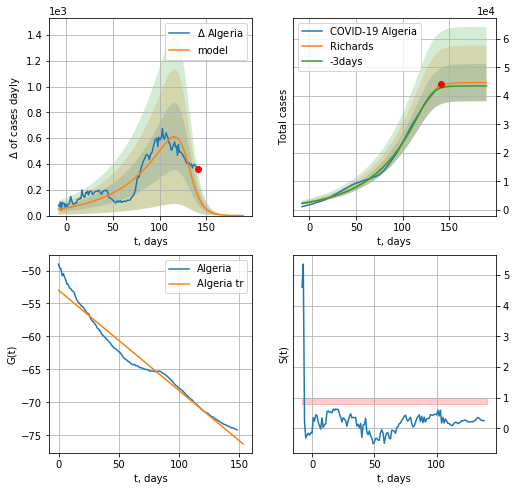

Algeria data at: 2020-11-14
+3 day model MAPE: 0.015957
model: Richards
coeffs: [4.46472187e+04 2.15635914e-02 1.29583000e+02 6.48850976e+00]
rational stdev: 0.145963
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 44645 ± 6516
	 total death: 1429 ± 625
trend coefficient of determination: 0.966080
 intercept: -52.986797
 slope: -0.152377
diffStd0a 0.627964419381963


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


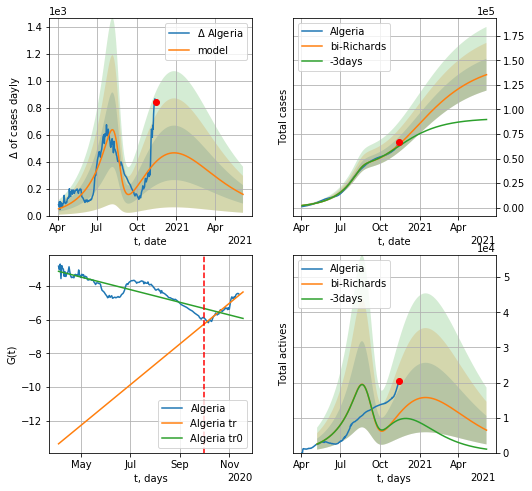

Algeria data at: 2020-11-14
+3 day model MAPE: 0.025576
model: bi-Richards
coeffs: [ 1.04575349e+05  1.25981817e+00 -1.21177891e+02  9.66313442e-03]
rational stdev: 0.119670
forecast at the end of period: +203 days
	 deltaDaycases: 157
	 total cases: 135346 ± 16196
	 total death: 4332 ± 1555
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.703533
 intercept: -3.124540
 slope: -0.012217
trend coefficient of determination: 0.909423
 intercept: -13.372234
 slope: 0.039385


In [692]:
iL = 30
vL = 180+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Algeria",dfAR[iL:],d1,62*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [693]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases  active    death
246 2020-11-10  444348   53846  14761.0
247 2020-11-11  452291   55274  14933.0
248 2020-11-12  457735   57604  15037.0
249 2020-11-13  463007   59765  15148.0
250 2020-11-14  467113   59911  15211.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


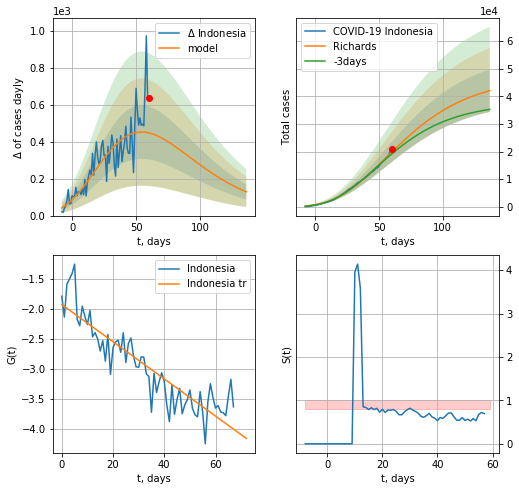

Indonesia data at: 2020-11-14
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +77 days
	 deltaDaycases: 128
	 total cases: 42011 ± 7685
	 total death: 1374 ± 754
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064
diffStd0a 0.36950119995067743


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


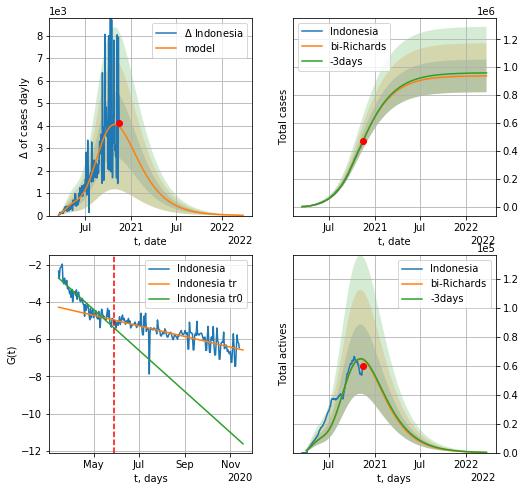

Indonesia data at: 2020-11-14
+3 day model MAPE: 0.001371
model: bi-Richards
coeffs: [8.91072662e+05 9.87528916e-02 6.41616649e+01 1.32930951e-01]
rational stdev: 0.124996
forecast at the end of period: +497 days
	 deltaDaycases: 13
	 total cases: 937166 ± 117142
	 total death: 30660 ± 11497
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.837085
 intercept: -2.718751
 slope: -0.035907
trend coefficient of determination: 0.570840
 intercept: -4.286841
 slope: -0.009270


In [695]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Indonesia",dfIE[6:],d12f(1),104*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6,amc=0.5)
except:
    print ("Exception occurs")

In [696]:
#x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

In [697]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH").fillna(0)
    #x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    #xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

PH
           date   cases   active   death
248 2020-11-10  401416  31489.0  7710.0
249 2020-11-11  402820  32682.0  7721.0
250 2020-11-12  404713  34058.0  7752.0
251 2020-11-13  406337  35478.0  7791.0
252 2020-11-14  407838  25677.0  7832.0


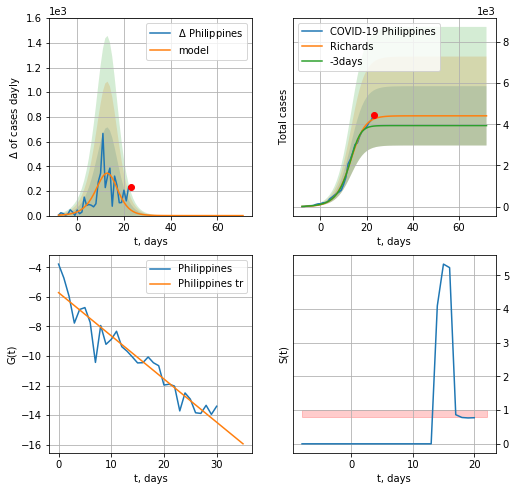

Philippines data at: 2020-11-14
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 84 ± 82
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234
diffStd0a 0.7895900870941657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


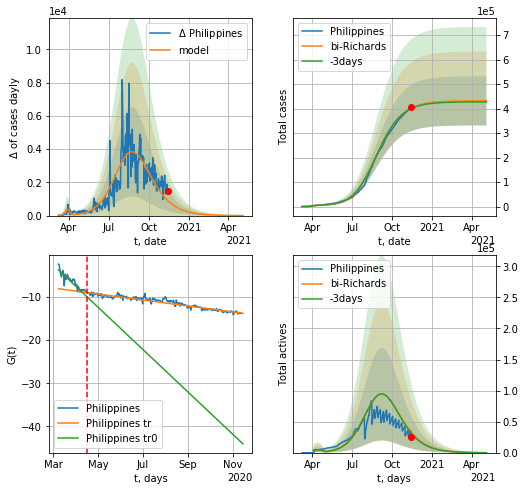

Philippines data at: 2020-11-14
+3 day model MAPE: 0.005020
model: bi-Richards
coeffs: [4.27800020e+05 5.01475835e-02 1.46751205e+02 6.33698985e-01]
rational stdev: 0.232838
forecast at the end of period: +175 days
	 deltaDaycases: 4
	 total cases: 432074 ± 100603
	 total death: 8297 ± 5795
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.830132
 intercept: -3.709533
 slope: -0.159955
trend coefficient of determination: 0.920278
 intercept: -8.084231
 slope: -0.022589


In [698]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Philippines",dfPH[4:],d12f(1),58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4,amc=0.75)

In [699]:
#x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

In [700]:
dfGC = read_df(pd.DataFrame(),"GC")
#x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
#xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

GC
           date    cases  active   death
255 2020-11-10  60570.0   49715   866.0
256 2020-11-11  63321.0   52423   909.0
257 2020-11-12  66637.0   55689   959.0
258 2020-11-13  69675.0   58689   997.0
259 2020-11-14  72510.0   61486  1035.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


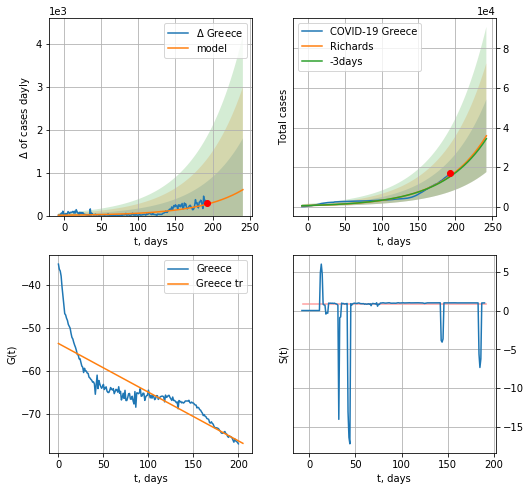

Greece data at: 2020-11-14
+3 day model MAPE: 0.022680
model: Richards
coeffs: [1.22839764e+05 1.69681107e-02 3.14569453e+02 7.48237291e+00]
rational stdev: 0.511475
forecast at the end of period: +49 days
	 deltaDaycases: 603
	 total cases: 35855 ± 18339
	 total death: 511 ± 784
trend coefficient of determination: 0.729021
 intercept: -53.624106
 slope: -0.113112


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


diffStd0a 0.40123143262536803


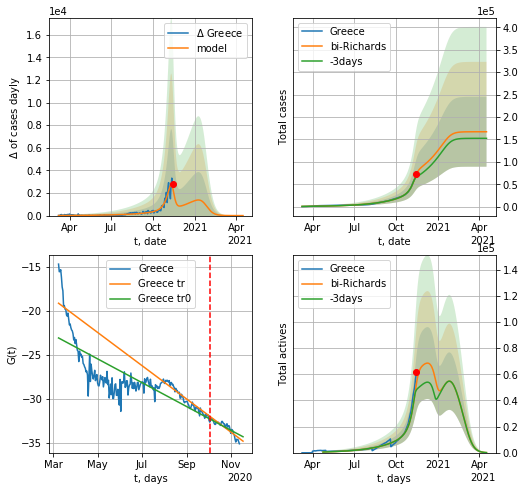

Greece data at: 2020-11-14
+3 day model MAPE: 0.115701
model: bi-Richards
coeffs: [4.42688271e+04 1.06419403e-01 2.42539749e+02 2.84684817e+00]
rational stdev: 0.466769
forecast at the end of period: +154 days
	 deltaDaycases: 0
	 total cases: 167108 ± 78000
	 total death: 2385 ± 3339
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.618596
 intercept: -23.051622
 slope: -0.044104
trend coefficient of determination: 0.813164
 intercept: -19.099554
 slope: -0.061563


In [701]:
iL = 8
vL = 210+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Greece",dfGC[iL:],d1,55*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.33)

In [702]:
#x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [703]:
dfHG = read_df(pd.DataFrame(),"HG").fillna(0)
#try:
#    x = forecast("Hungary",dfHG[:],d1,T18*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#except:
#    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

HG
           date     cases  active   death
249 2020-11-10  122863.0   91358  2697.0
250 2020-11-11  126790.0   94704  2784.0
251 2020-11-12  131887.0   99202  2883.0
252 2020-11-13  136723.0  102607  2990.0
253 2020-11-14  140961.0  106265  3097.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


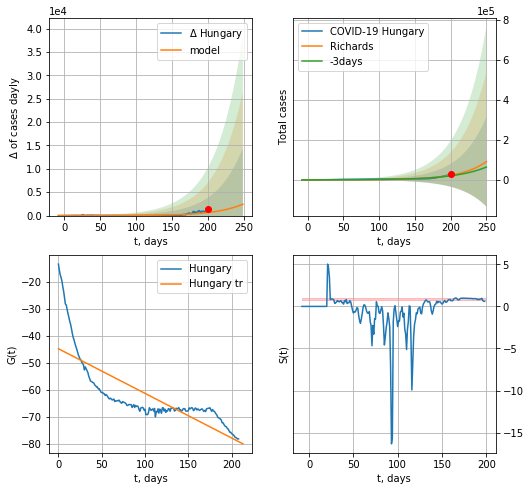

Hungary data at: 2020-11-14
+3 day model MAPE: 0.145721
model: Richards
coeffs: [1.69960015e+05 2.73419286e-02 2.72689391e+02 7.30777798e+00]
rational stdev: 2.462186
forecast at the end of period: +49 days
	 deltaDaycases: 2438
	 total cases: 91261 ± 224702
	 total death: 2005 ± 14810
trend coefficient of determination: 0.621950
 intercept: -44.694459
 slope: -0.165218
diffStd0a 2.9650341945028402


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


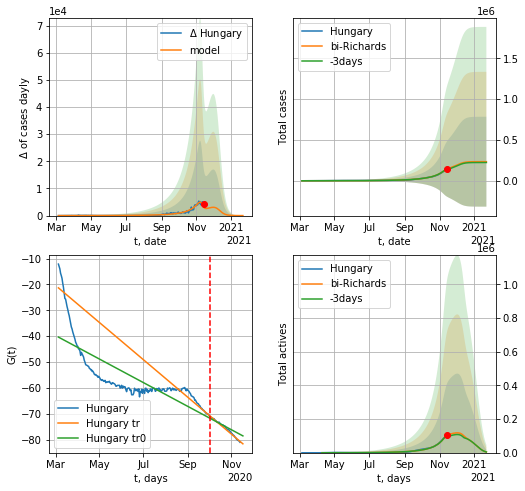

Hungary data at: 2020-11-14
+3 day model MAPE: 0.059470
model: bi-Richards
coeffs: [6.37442583e+04 7.64294913e-02 2.43102619e+02 6.53887519e+00]
rational stdev: 2.354326
forecast at the end of period: +70 days
	 deltaDaycases: 1
	 total cases: 233699 ± 550204
	 total death: 5134 ± 36261
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.621651
 intercept: -40.360658
 slope: -0.148666
trend coefficient of determination: 0.984861
 intercept: -21.315100
 slope: -0.234709


In [704]:
vL = 210#130
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Hungary",dfHG[:],d1,43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [705]:
#x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


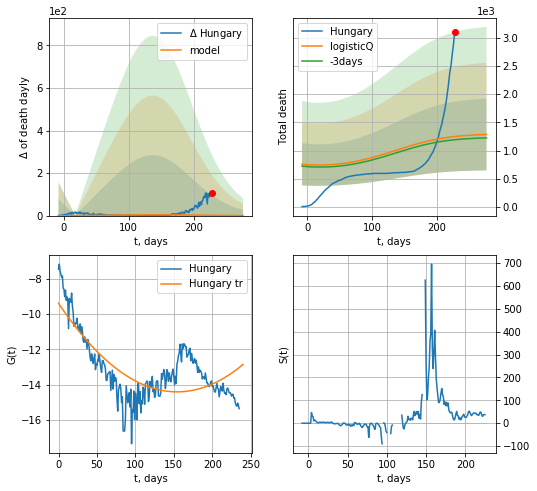

Hungary data at: 2020-11-14
+3 day model MAPE: 0.047513
model: logisticQ
coeffs: [1.09582384e+03 7.25098235e-05 2.44507074e+01 9.53225289e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.494225
forecast at the end of period: +49 days
	 total death: 1284 ± 634
trend coefficient of determination: 0.557070
 intercept_: -9.39778619377755
 coeffs_: [ 0.         -0.06498009  0.00021065]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


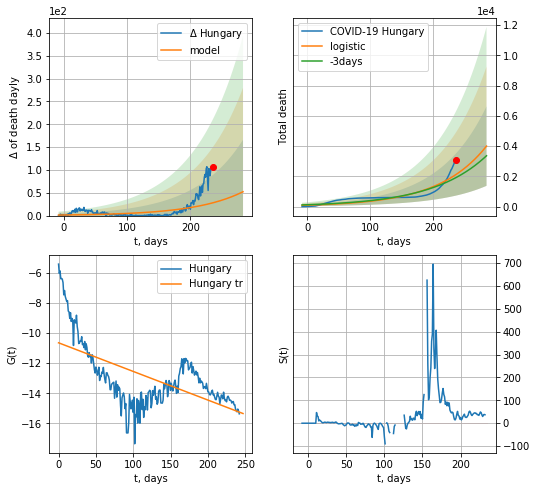

Hungary data at: 2020-11-14
+3 day model MAPE: 0.10651825143841215
model: logistic
coeffs:  [2.06923955e+07 1.31327699e-02 9.35084029e+02]
rational stdev:  0.6563691150848174
forecast at the end of period: +49 days
	 total death:  4001 ± 2626
trend coefficient of determination: 0.383086
 intercept: -10.646829
 slope: -0.019001


In [706]:
x = forecastRRR("Hungary",dfHG[17:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

In [707]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    #x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    #xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

MT
           date   cases  active  death
247 2020-11-10  7396.0    2041   81.0
248 2020-11-11  7537.0    2078   88.0
249 2020-11-12  7646.0    2079   88.0
250 2020-11-13  7796.0    2124   92.0
251 2020-11-14  7917.0    2120   95.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


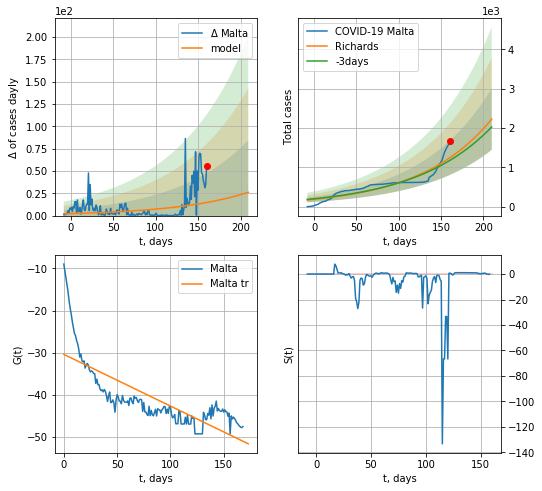

Malta data at: 2020-11-14
+3 day model MAPE: 0.058506
model: Richards
coeffs: [1.79480999e+04 1.17638464e-02 3.87365718e+02 5.94374794e+00]
rational stdev: 0.350416
forecast at the end of period: +49 days
	 deltaDaycases: 26
	 total cases: 2227 ± 780
	 total death: 26 ± 27
trend coefficient of determination: 0.590889
 intercept: -30.386213
 slope: -0.122562
diffStd0a 1.748224912252883


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


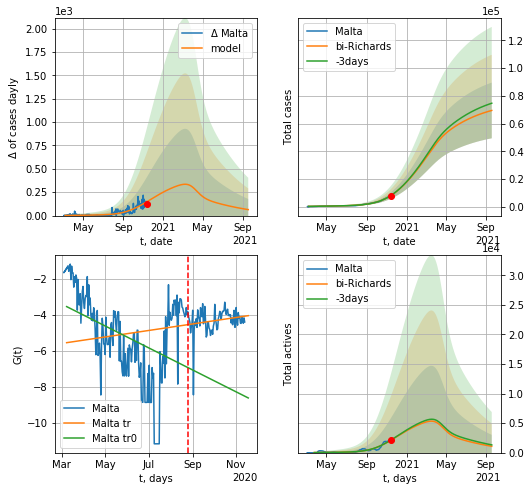

Malta data at: 2020-11-14
+3 day model MAPE: 0.003824
model: bi-Richards
coeffs: [ 5.84543414e+04  4.18246906e-01 -4.24533857e+01  2.34414727e-02]
rational stdev: 0.289626
forecast at the end of period: +308 days
	 deltaDaycases: 64
	 total cases: 69450 ± 20114
	 total death: 833 ± 723
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.173253
 intercept: -3.532785
 slope: -0.019972
trend coefficient of determination: 0.047018
 intercept: -5.544291
 slope: 0.005906


In [708]:
vL = 170#112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Malta",dfMT[:],d12f(1),77*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [709]:
#x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
#xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

In [710]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
#try:
#    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
#    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
#except:
#    print("Exception ocurs")

SL
           date    cases   active  death
245 2020-11-10  77123.0  55015.0  390.0
246 2020-11-11  79181.0  55520.0  414.0
247 2020-11-12  81772.0  56994.0  464.0
248 2020-11-13  83796.0  56866.0  491.0
249 2020-11-14  86767.0  55738.0  510.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


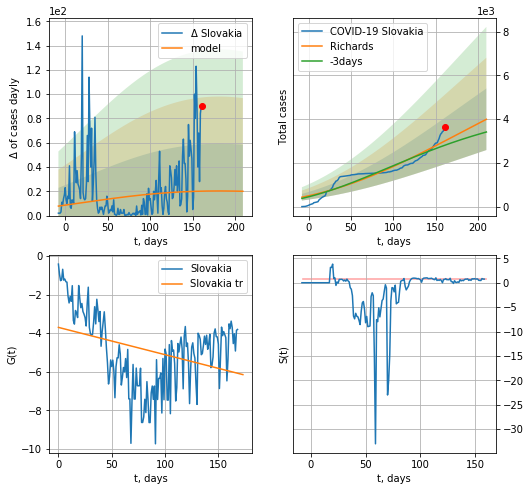

Slovakia data at: 2020-11-14
+3 day model MAPE: 0.071099
model: Richards
coeffs: [ 9.22154238e+03  4.41676744e-01 -5.31921240e+02  1.36332717e-02]
rational stdev: 0.352489
forecast at the end of period: +49 days
	 deltaDaycases: 20
	 total cases: 3993 ± 1407
	 total death: 23 ± 24
trend coefficient of determination: 0.127387
 intercept: -3.700946
 slope: -0.014153
diffStd0a 0.7091606068645306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


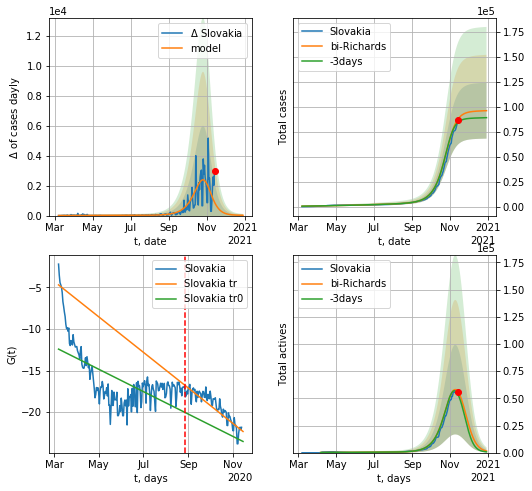

Slovakia data at: 2020-11-14
+3 day model MAPE: 0.030972
model: bi-Richards
coeffs: [9.04963956e+04 7.67712169e-02 2.28909435e+02 1.62231564e+00]
rational stdev: 0.291142
forecast at the end of period: +49 days
	 deltaDaycases: 20
	 total cases: 95961 ± 27938
	 total death: 564 ± 492
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.382688
 intercept: -12.413739
 slope: -0.043901
trend coefficient of determination: 0.812207
 intercept: -4.686389
 slope: -0.069693


In [711]:
vL = 170
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Slovakia",dfSL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.875)

In [712]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [713]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
#try:
#    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
#    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
#except:
#    print ("Exception occurs")

SV
           date    cases   active  death
250 2020-11-10  46717.0  21105.0  605.0
251 2020-11-11  48939.0  20717.0  645.0
252 2020-11-12  50870.0  20157.0  686.0
253 2020-11-13  52385.0  19869.0  724.0
254 2020-11-14  54122.0  19809.0  765.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


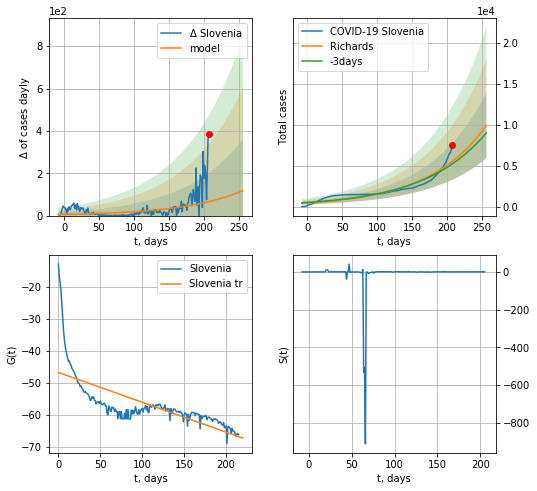

Slovenia data at: 2020-11-14
+3 day model MAPE: 0.060013
model: Richards
coeffs: [5.24917158e+04 1.19600587e-02 3.96197868e+02 7.08990650e+00]
rational stdev: 0.404213
forecast at the end of period: +49 days
	 deltaDaycases: 118
	 total cases: 9932 ± 4014
	 total death: 140 ± 169
trend coefficient of determination: 0.505548
 intercept: -46.753226
 slope: -0.093465
diffStd0a 2.8343467865628575


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


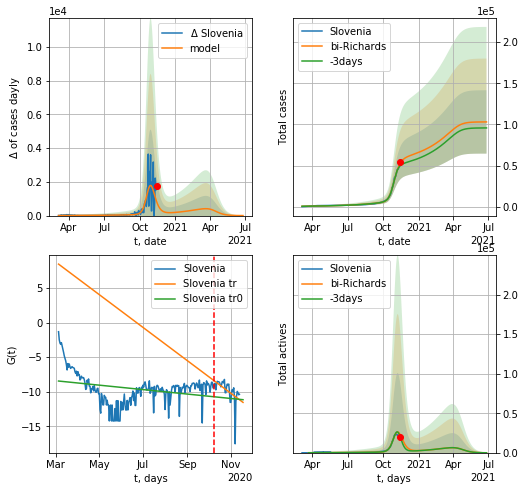

Slovenia data at: 2020-11-14
+3 day model MAPE: 0.061459
model: bi-Richards
coeffs: [5.05447681e+04 1.87733146e-01 2.26532894e+02 6.35469082e-01]
rational stdev: 0.374015
forecast at the end of period: +224 days
	 deltaDaycases: 1
	 total cases: 103022 ± 38531
	 total death: 1456 ± 1633
bi-Richards approximation splitting point: 217
trend coefficient of determination: 0.084080
 intercept: -8.454619
 slope: -0.010455
trend coefficient of determination: 0.277779
 intercept: 8.447822
 slope: -0.077471


In [716]:
vL = 217
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Slovenia",dfSV[:],d12f(1),65*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [717]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases   active  death
245 2020-11-10  66888  34437.0  915.0
246 2020-11-11  70424  37952.0  936.0
247 2020-11-12  73765  41274.0  955.0
248 2020-11-13  77264  44756.0  972.0
249 2020-11-14  81086  48561.0  989.0


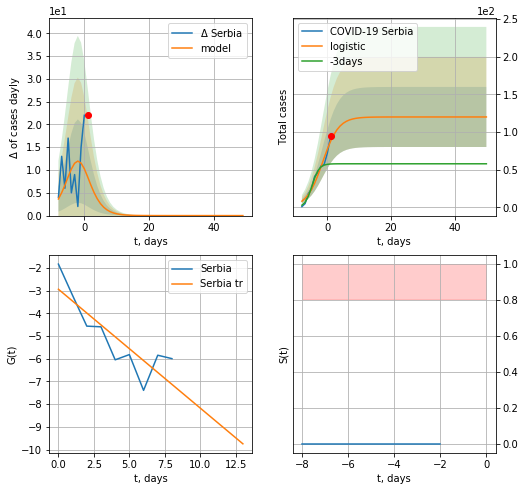

Serbia data at: 2020-11-14
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


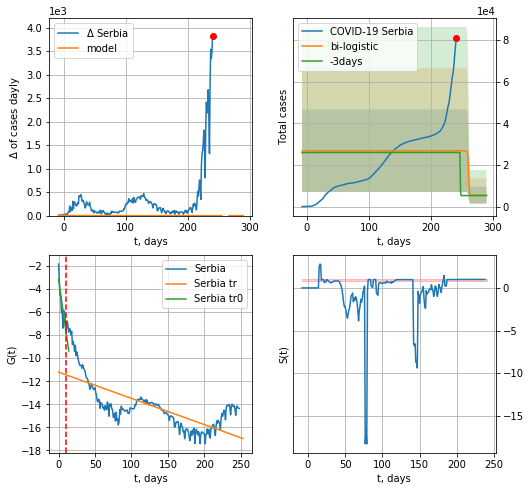

Serbia data at: 2020-11-14
+3 day model MAPE: 0.03258918131044669
model: bi-logistic
coeffs:  [ 2.13985706e+04 -1.63959591e+00  2.61009283e+02] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.738405512719474
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  5469 ± 4038
	 total death:  66 ± 146
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.527022
 intercept: -11.208216
 slope: -0.022786


In [718]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


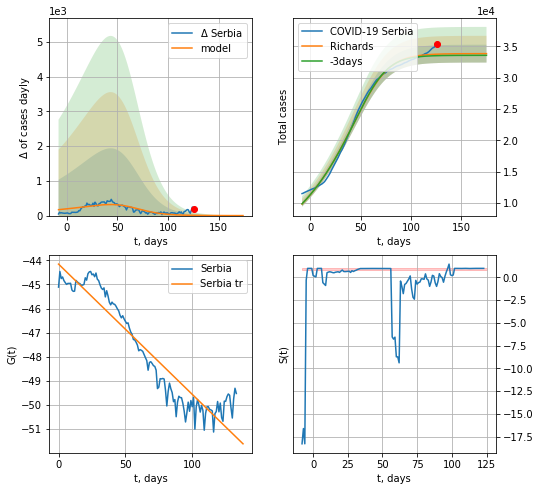

Serbia data at: 2020-11-14
+3 day model MAPE: 0.007213
model: Richards
coeffs: [3.38502992e+04 1.71762320e-02 6.37510211e+01 4.23525933e+00]
rational stdev: 0.042000
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 33847 ± 1421
	 total death: 412 ± 51
trend coefficient of determination: 0.897677
 intercept: -44.154427
 slope: -0.054115
diffStd0a 0.49022149688561933


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


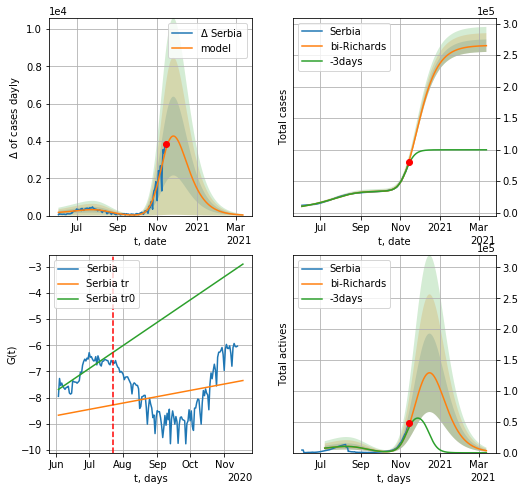

Serbia data at: 2020-11-14
+3 day model MAPE: 0.063452
model: bi-Richards
coeffs: [2.31668308e+05 2.14412743e-01 1.44575902e+02 2.63352249e-01]
rational stdev: 0.037492
forecast at the end of period: +119 days
	 deltaDaycases: 32
	 total cases: 264962 ± 9934
	 total death: 3231 ± 363
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.690126
 intercept: -7.685612
 slope: 0.028467
trend coefficient of determination: 0.062854
 intercept: -8.666696
 slope: 0.007871


In [719]:
iL=85
vL=50+iL
x = forecastRR("Serbia",dfSB[iL:vL+iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Serbia",dfSB[iL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [720]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

In [721]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    #x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    #xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

CT
           date    cases   active   death
255 2020-11-10  70243.0  14524.0   865.0
256 2020-11-11  72840.0  15513.0   893.0
257 2020-11-12  75922.0  16348.0   925.0
258 2020-11-13  78978.0  16746.0   968.0
259 2020-11-14  81844.0  17090.0  1006.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


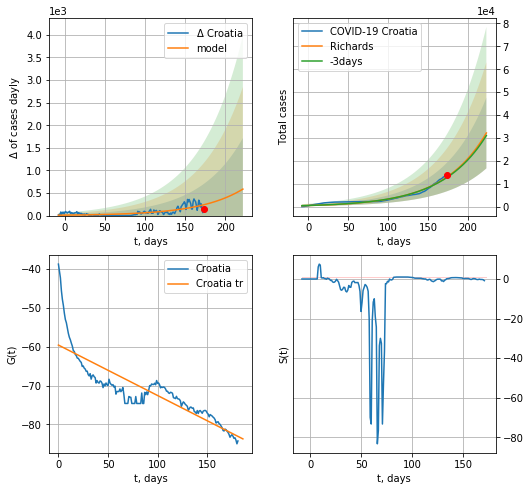

Croatia data at: 2020-11-14
+3 day model MAPE: 0.018027
model: Richards
coeffs: [1.05375743e+05 1.83779062e-02 2.87513636e+02 8.37165434e+00]
rational stdev: 0.479243
forecast at the end of period: +49 days
	 deltaDaycases: 586
	 total cases: 32197 ± 15430
	 total death: 395 ± 567
trend coefficient of determination: 0.727056
 intercept: -59.566484
 slope: -0.130027
diffStd0a 2.4099637728005687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


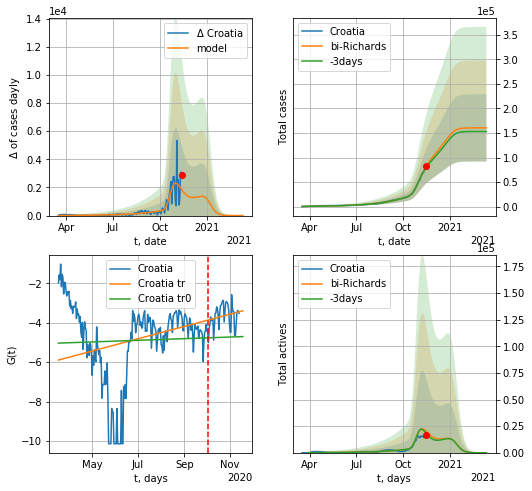

Croatia data at: 2020-11-14
+3 day model MAPE: 0.029055
model: bi-Richards
coeffs: [5.50515090e+04 5.68367530e+00 1.71876733e+02 1.51775587e-02]
rational stdev: 0.427179
forecast at the end of period: +119 days
	 deltaDaycases: 0
	 total cases: 160426 ± 68530
	 total death: 1971 ± 2525
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.001513
 intercept: -5.033049
 slope: 0.001349
trend coefficient of determination: 0.043218
 intercept: -5.891154
 slope: 0.010162


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


In [722]:
iL = 17
vL = 200+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Croatia",dfCT[iL:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)

In [723]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [724]:
dfEG = read_df(pd.DataFrame(),"EG")
#x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
#xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

EG
           date   cases  active   death
249 2020-11-10  109654    2720  6394.0
250 2020-11-11  109881    2814  6405.0
251 2020-11-12  110095    2918  6417.0
252 2020-11-13  110319    3043  6429.0
253 2020-11-14  110547    3159  6442.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


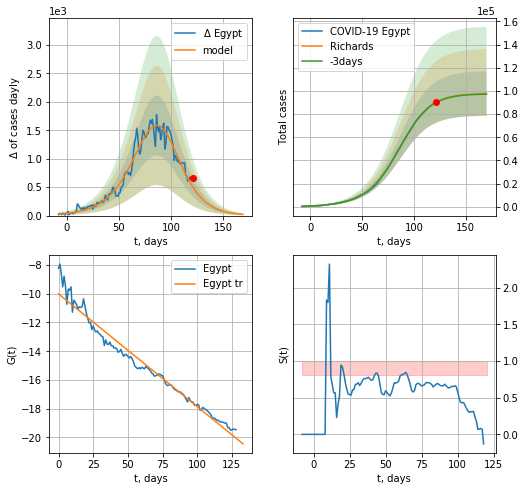

Egypt data at: 2020-11-14
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +49 days
	 deltaDaycases: 20
	 total cases: 97760 ± 19177
	 total death: 5696 ± 3352
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415
diffStd0a 0.4840688021836179


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


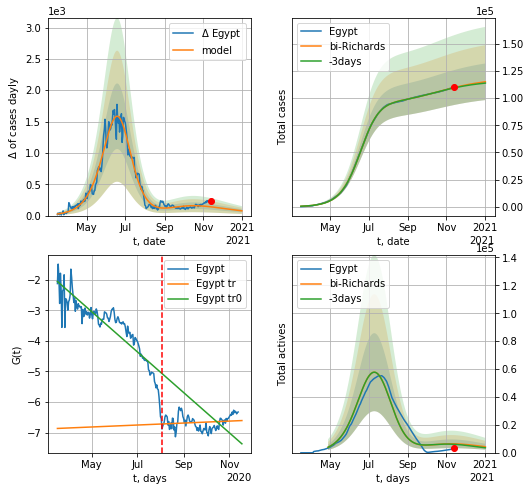

Egypt data at: 2020-11-14
+3 day model MAPE: 0.002928
model: bi-Richards
coeffs: [ 2.12494602e+04  1.63356022e+00 -9.41941335e+00  1.23360999e-02]
rational stdev: 0.146434
forecast at the end of period: +49 days
	 deltaDaycases: 75
	 total cases: 115116 ± 16856
	 total death: 6708 ± 2946
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.799231
 intercept: -2.055924
 slope: -0.021508
trend coefficient of determination: 0.018677
 intercept: -6.865272
 slope: 0.001044


In [725]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Egypt",dfEG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.25)

In [726]:
#x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active    death
252 2020-11-10  505310  59213.0  11432.0
253 2020-11-11  508508  60369.0  11482.0
254 2020-11-12  511806  61046.0  11532.0
255 2020-11-13  514496  61060.0  11580.0
256 2020-11-14  516915  61066.0  11623.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


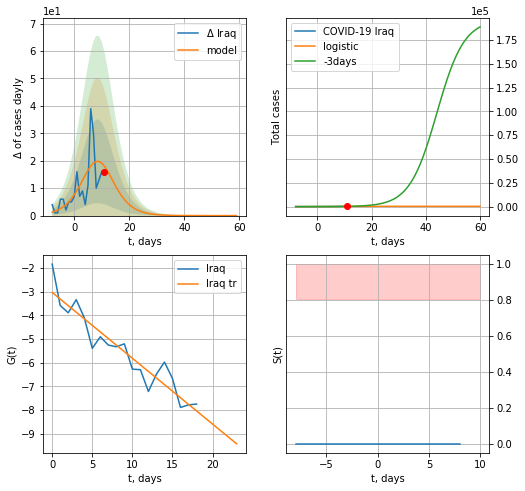

Iraq data at: 2020-11-14
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  317 ± 65
	 total death:  7 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


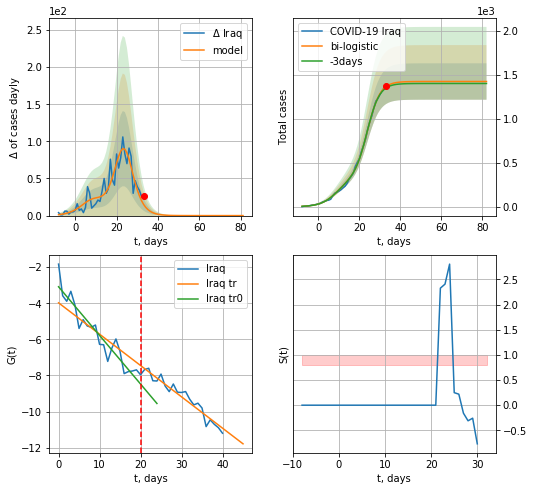

Iraq data at: 2020-11-14
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  32 ± 13
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


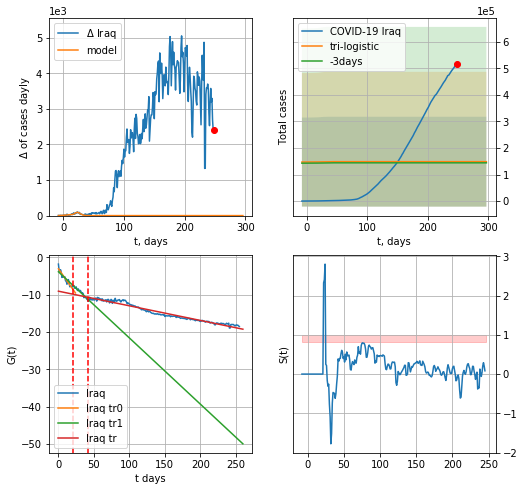

Iraq data at: 2020-11-14
+3 day model MAPE: 0.029974694941161083
model: tri-logistic
coeffs:  [ 1.47074626e+05 -1.34935171e+01  3.28834497e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  1.1405374290403598
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  148500 ± 169370
	 total death:  3339 ± 11424
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.958938
 intercept: -9.079902
 slope: -0.039133


In [727]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


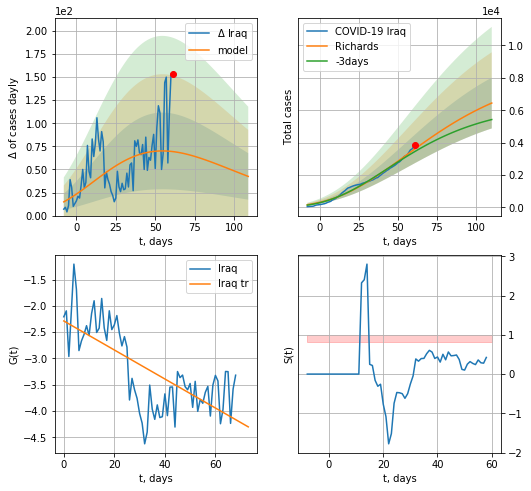

Iraq data at: 2020-11-14
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +49 days
	 deltaDaycases: 42
	 total cases: 6446 ± 1566
	 total death: 144 ± 104
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573
diffStd0a 0.2710735914053583


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


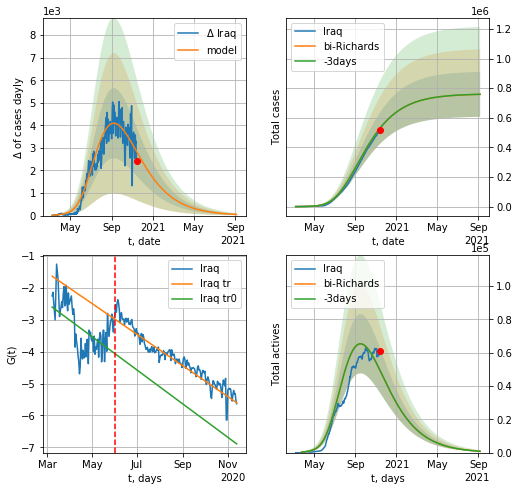

Iraq data at: 2020-11-14
+3 day model MAPE: 0.000131
model: bi-Richards
coeffs: [ 7.53097470e+05  7.33036619e-01 -8.64501308e+01  2.03094223e-02]
rational stdev: 0.200246
forecast at the end of period: +301 days
	 deltaDaycases: 50
	 total cases: 758422 ± 151871
	 total death: 17053 ± 10244
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.285638
 intercept: -2.604524
 slope: -0.017147
trend coefficient of determination: 0.928724
 intercept: -1.634681
 slope: -0.015862


In [728]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [729]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [730]:
#len(dfAR)

AR
           date    cases  active   death
251 2020-11-10  63446.0   18743  2077.0
252 2020-11-11  64257.0   19184  2093.0
253 2020-11-12  65108.0   20017  2111.0
254 2020-11-13  65975.0   20072  2124.0
255 2020-11-14  66819.0   20481  2139.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


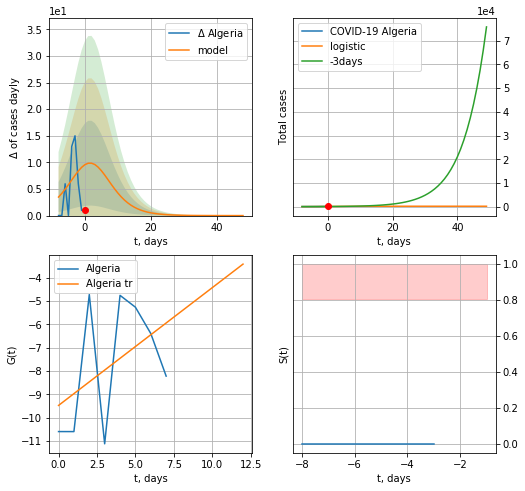

Algeria data at: 2020-11-14
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  169 ± 26
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


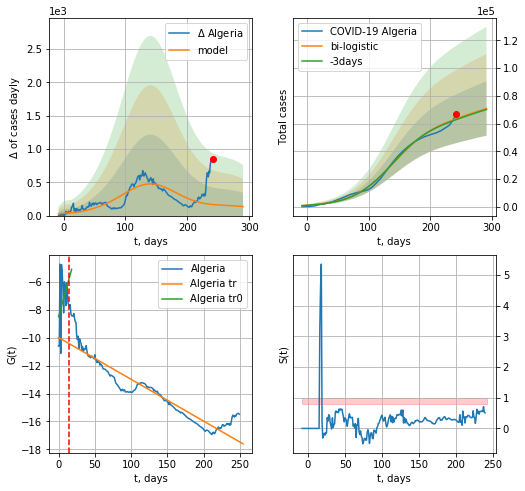

Algeria data at: 2020-11-14
+3 day model MAPE: 0.009898349856565614
model: bi-logistic
coeffs:  [6.23165079e+04 3.01144501e-02 1.40003631e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2770056388504946
forecast at the end of period: +49 days
	 deltaDaycases:  134
	 total cases:  70899 ± 19639
	 total death:  2269 ± 1885
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.868393
 intercept: -9.983724
 slope: -0.029979


In [731]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


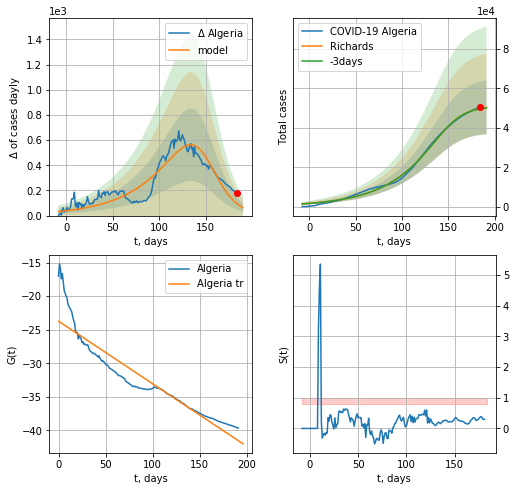

Algeria data at: 2020-11-14
+3 day model MAPE: 0.005813
model: Richards
coeffs: [5.12320244e+04 2.27589775e-02 1.50468918e+02 3.13865465e+00]
rational stdev: 0.269869
forecast at the end of period: +7 days
	 deltaDaycases: 62
	 total cases: 50361 ± 13590
	 total death: 1612 ± 1305
trend coefficient of determination: 0.872474
 intercept: -23.731544
 slope: -0.093154
diffStd0a 0.6938012386892531


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


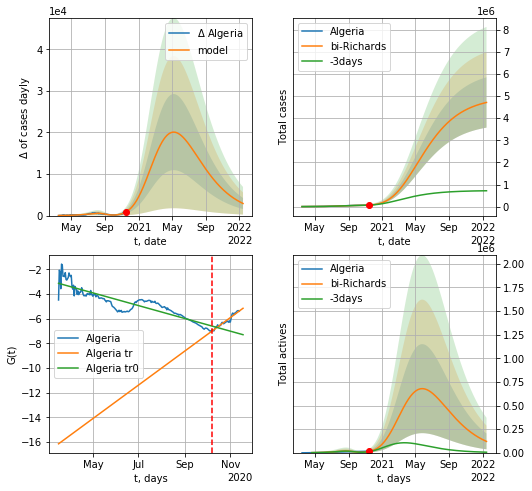

Algeria data at: 2020-11-14
+3 day model MAPE: 0.014695
model: bi-Richards
coeffs: [4.91898634e+06 1.26449686e-01 2.04249453e+02 9.17522641e-02]
rational stdev: 0.241772
forecast at the end of period: +427 days
	 deltaDaycases: 2912
	 total cases: 4713111 ± 1139496
	 total death: 150875 ± 109431
bi-Richards approximation splitting point: 205
trend coefficient of determination: 0.795488
 intercept: -3.136824
 slope: -0.016855
trend coefficient of determination: 0.935411
 intercept: -16.142002
 slope: 0.044461


In [734]:
vL =205+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Algeria",dfAR[12:],d1,94*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [735]:
#x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
243 2020-11-10  6296.0  4385.0   29.0
244 2020-11-11  6461.0  4546.0   33.0
245 2020-11-12  6646.0  4730.0   34.0
246 2020-11-13  6853.0  4794.0   38.0
247 2020-11-14  7051.0  4991.0   39.0


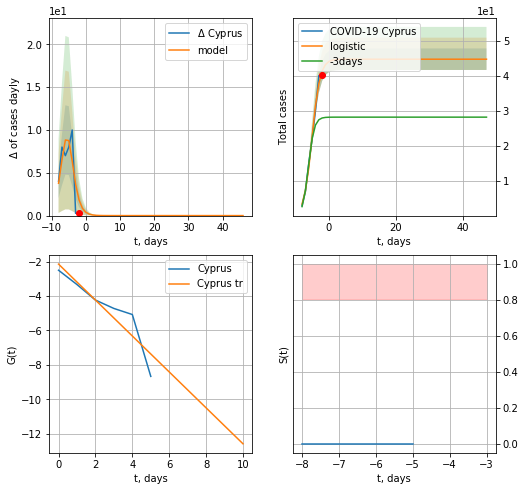

Cyprus data at: 2020-11-14
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


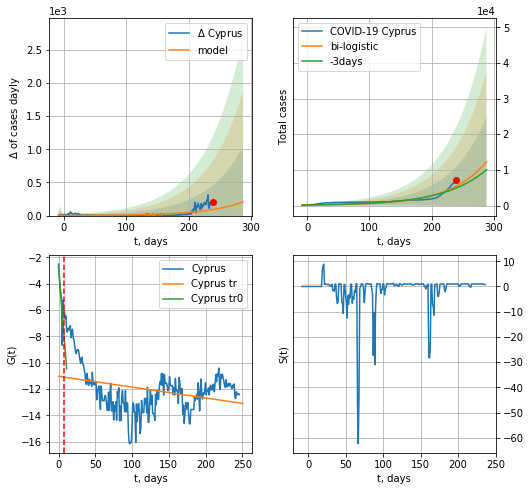

Cyprus data at: 2020-11-14
+3 day model MAPE: 0.1075477064504625
model: bi-logistic
coeffs:  [5.86324183e+07 1.69842338e-02 7.86886073e+02] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  1.0245732230055264
forecast at the end of period: +49 days
	 deltaDaycases:  206
	 total cases:  12296 ± 12598
	 total death:  68 ± 209
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.101514
 intercept: -11.027318
 slope: -0.008241


In [736]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


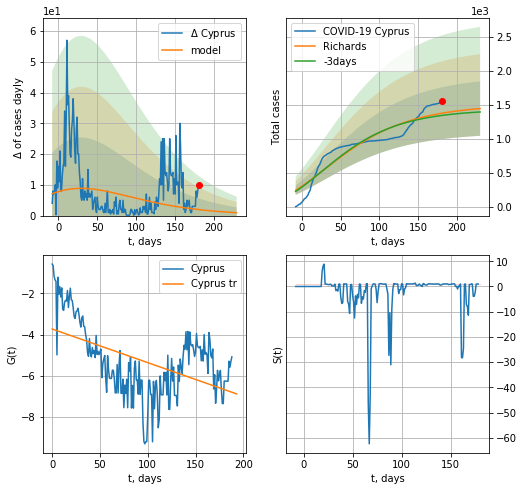

Cyprus data at: 2020-11-14
+3 day model MAPE: 0.024435
model: Richards
coeffs: [ 1.50521752e+03  2.72486761e+00 -2.90172794e+02  5.89172949e-03]
rational stdev: 0.277159
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 1446 ± 400
	 total death: 7 ± 5
trend coefficient of determination: 0.254348
 intercept: -3.732430
 slope: -0.016375
diffStd0a 0.8498699281810446


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


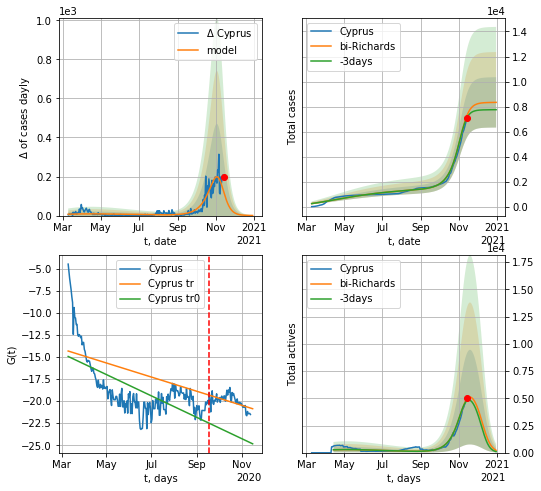

Cyprus data at: 2020-11-14
+3 day model MAPE: 0.020873
model: bi-Richards
coeffs: [6.85318143e+03 7.44872617e-02 2.34928447e+02 2.02492325e+00]
rational stdev: 0.241293
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 8333 ± 2010
	 total death: 46 ± 33
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.444818
 intercept: -14.949231
 slope: -0.039375
trend coefficient of determination: 0.311241
 intercept: -14.333302
 slope: -0.026009


In [737]:
iL = 0
vL=190+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RRD("Cyprus",dfCP[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [738]:
#vL=33
#x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
248 2020-11-10  925431  39769.0  34992.0
249 2020-11-11  928006  39767.0  35031.0
250 2020-11-12  930237  39147.0  35067.0
251 2020-11-13  932650  39156.0  35106.0
252 2020-11-14  934899  38705.0  35177.0


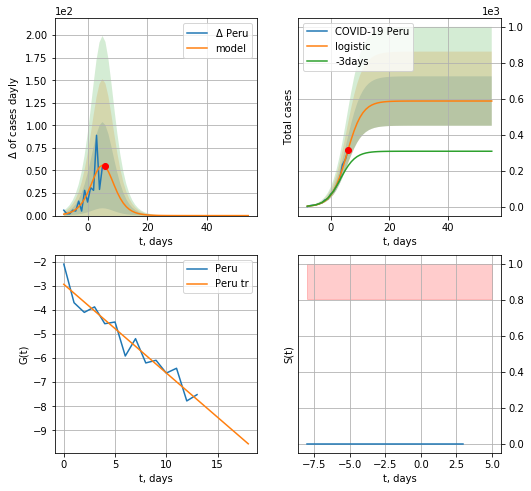

Peru data at: 2020-11-14
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  22 ± 15
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


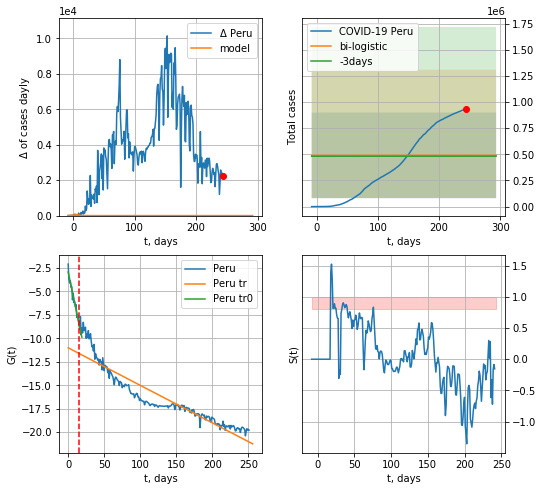

Peru data at: 2020-11-14
+3 day model MAPE: 0.016789589246733554
model: bi-logistic
coeffs:  [ 3.91980882e+05 -4.42449495e+01  1.05573363e+03] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.834679532961393
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  490565 ± 409464
	 total death:  18458 ± 46219
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.859521
 intercept: -11.014482
 slope: -0.039939


In [739]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


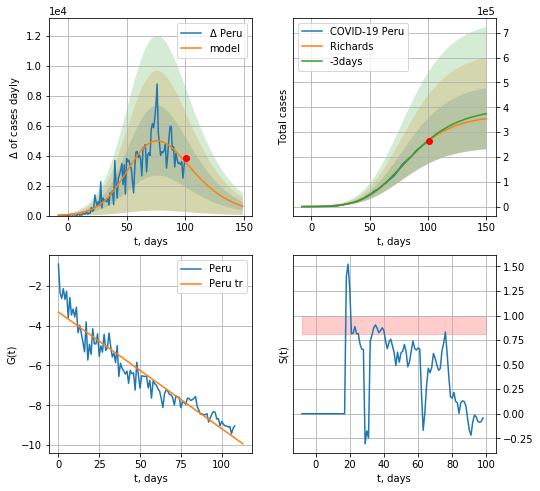

Peru data at: 2020-11-14
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +49 days
	 deltaDaycases: 623
	 total cases: 354186 ± 123044
	 total death: 13326 ± 13888
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598
diffStd0a 0.26469908415461524


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


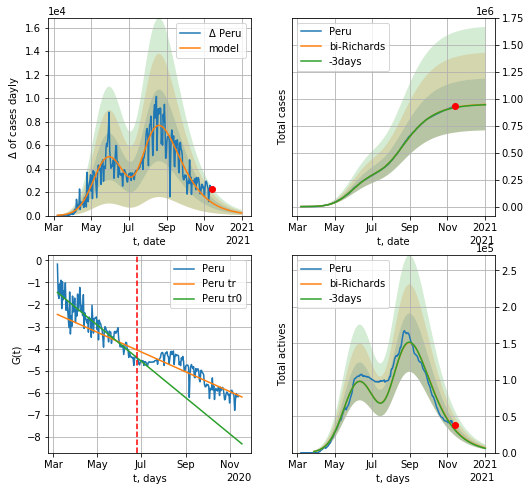

Peru data at: 2020-11-14
+3 day model MAPE: 0.002307
model: bi-Richards
coeffs: [5.85707198e+05 3.27051548e+00 2.48207422e+01 1.03517412e-02]
rational stdev: 0.253005
forecast at the end of period: +49 days
	 deltaDaycases: 220
	 total cases: 947740 ± 239783
	 total death: 35660 ± 27066
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.801438
 intercept: -1.456319
 slope: -0.026755
trend coefficient of determination: 0.742130
 intercept: -2.452423
 slope: -0.014582


In [740]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.625)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [741]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active     death
255 2020-11-10  8636011  494613.0  127615.0
256 2020-11-11  8684039  491326.0  128165.0
257 2020-11-12  8728795  484529.0  128686.0
258 2020-11-13  8773479  480682.0  129225.0
259 2020-11-14  8814902  479500.0  129674.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


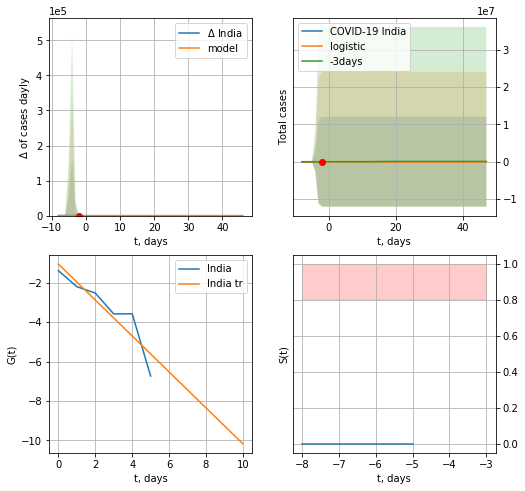

India data at: 2020-11-14
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


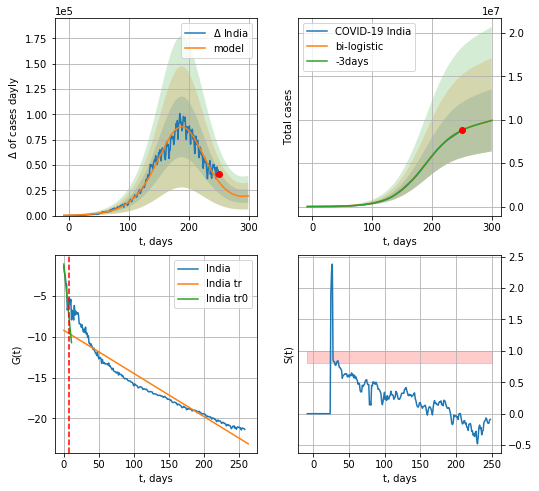

India data at: 2020-11-14
+3 day model MAPE: 0.0018675827230559881
model: bi-logistic
coeffs:  [9.63041082e+06 3.62903709e-02 1.88461949e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.36066857452660694
forecast at the end of period: +49 days
	 deltaDaycases:  19514
	 total cases:  9932427 ± 3582314
	 total death:  146113 ± 158095
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.912404
 intercept: -9.223269
 slope: -0.052837


In [742]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

In [743]:
dfID.head()

,date,cases,active,death
0,2020-01-30,1,0.0,0.0
1,2020-02-02,2,0.0,0.0
2,2020-02-04,3,0.0,0.0
3,2020-03-03,5,0.0,0.0
4,2020-03-04,6,0.0,0.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


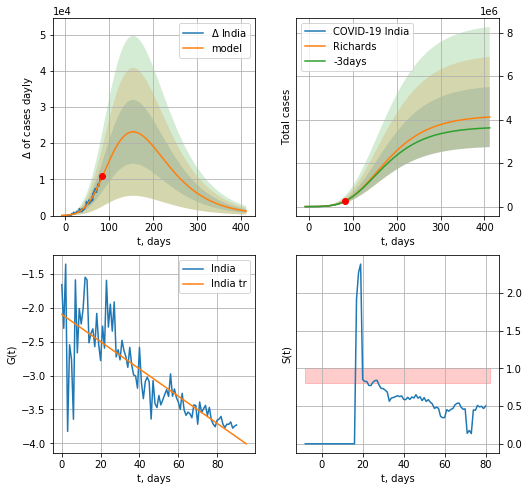

India data at: 2020-11-14
+3 day model MAPE: 0.006742
model: Richards
coeffs: [ 4.20225634e+06  3.29565236e-01 -4.59203879e+01  4.64727771e-02]
rational stdev: 0.335203
forecast at the end of period: +329 days
	 deltaDaycases: 1230
	 total cases: 4121718 ± 1381610
	 total death: 60633 ± 60973
trend coefficient of determination: 0.670933
 intercept: -2.097175
 slope: -0.020112
diffStd0a 0.3569966539754342


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


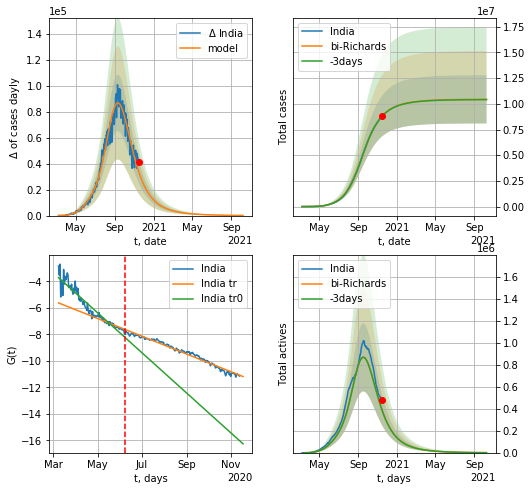

India data at: 2020-11-14
+3 day model MAPE: 0.001127
model: bi-Richards
coeffs: [6.24362660e+06 9.22367037e-02 1.50065786e+02 3.61896030e-01]
rational stdev: 0.224881
forecast at the end of period: +329 days
	 deltaDaycases: 108
	 total cases: 10438859 ± 2347497
	 total death: 153563 ± 103600
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.906911
 intercept: -3.724350
 slope: -0.049159
trend coefficient of determination: 0.978379
 intercept: -5.633168
 slope: -0.021778


In [744]:
vL = 100
x = forecastRR("India",dfID[8:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("India",dfID[8:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8,amc=1./3.)

In [745]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date      cases    active    death
251 2020-11-10  1262476.0  146396.0  34183.0
252 2020-11-11  1273356.0  156928.0  34531.0
253 2020-11-12  1284519.0  149557.0  34782.0
254 2020-11-13  1296378.0  150856.0  35045.0
255 2020-11-14  1304846.0  150173.0  35307.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


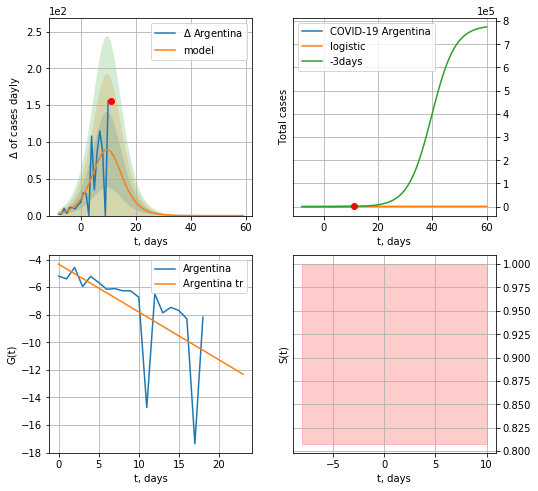

Argentina data at: 2020-11-14
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  1306 ± 362
	 total death:  35 ± 29
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


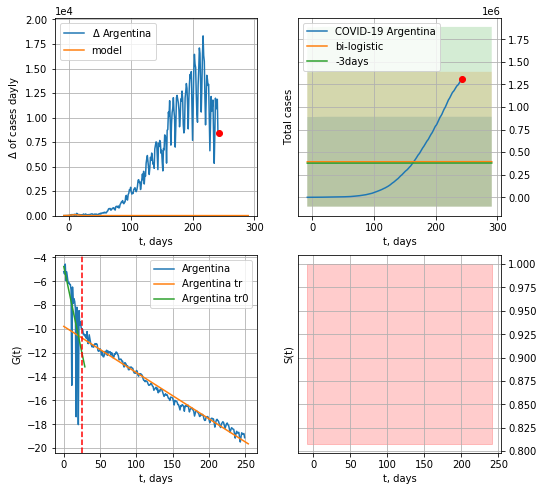

Argentina data at: 2020-11-14
+3 day model MAPE: 0.03900834895779836
model: bi-logistic
coeffs:  [ 3.14526608e+05 -2.59425975e+01  6.21911319e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2612104248208724
forecast at the end of period: +49 days
	 deltaDaycases:  0
	 total cases:  394464 ± 497502
	 total death:  10673 ± 40382
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.984823
 intercept: -9.787822
 slope: -0.038761


In [746]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


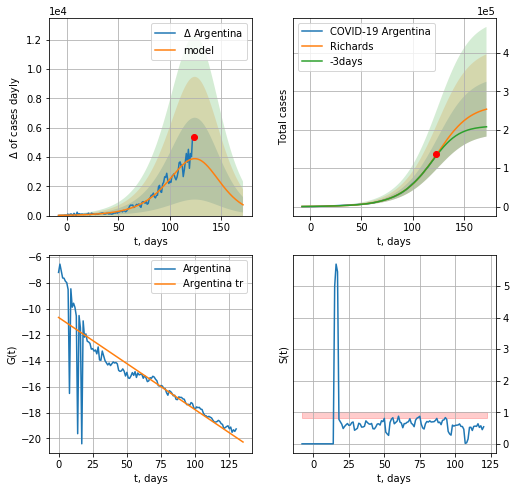

Argentina data at: 2020-11-14
+3 day model MAPE: 0.019206
model: Richards
coeffs: [2.65005155e+05 4.79026563e-02 1.29327238e+02 1.35592311e+00]
rational stdev: 0.281344
forecast at the end of period: +49 days
	 deltaDaycases: 735
	 total cases: 253407 ± 71294
	 total death: 6856 ± 5786
trend coefficient of determination: 0.758651
 intercept: -10.677920
 slope: -0.071075
diffStd0a 0.42702583324383403


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


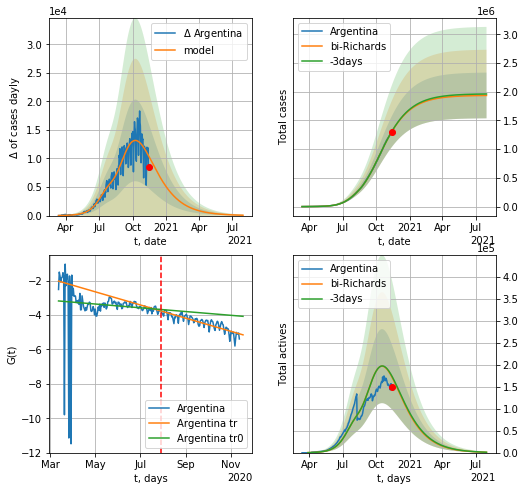

Argentina data at: 2020-11-14
+3 day model MAPE: 0.002538
model: bi-Richards
coeffs: [1.67240854e+06 8.61434915e-01 3.21971870e+01 2.49562272e-02]
rational stdev: 0.205591
forecast at the end of period: +259 days
	 deltaDaycases: 65
	 total cases: 1934416 ± 397698
	 total death: 52342 ± 32283
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.013305
 intercept: -3.182062
 slope: -0.003555
trend coefficient of determination: 0.761969
 intercept: -2.029027
 slope: -0.012437


In [747]:
vL = 140+8#38
x = forecastRR('Argentina',dfAG[8:vL-8].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Argentina',dfAG[8:].fillna(0),d1,70*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8,amc=0.475)

In [748]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

In [749]:
#vL=33
#x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
#xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

QR
           date   cases  active  death
250 2020-11-10  134663  2697.0  233.0
251 2020-11-11  134887  2728.0  233.0
252 2020-11-12  135132  2745.0  234.0
253 2020-11-13  135367  2777.0  234.0
254 2020-11-14  135570  2759.0  234.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


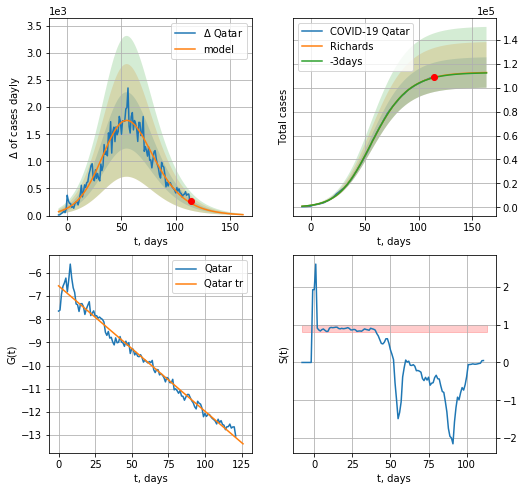

Qatar data at: 2020-11-14
+3 day model MAPE: 0.001883
model: Richards
coeffs: [1.13070089e+05 8.99170413e-02 4.60810469e+01 6.06536184e-01]
rational stdev: 0.112907
forecast at the end of period: +49 days
	 deltaDaycases: 17
	 total cases: 112753 ± 12730
	 total death: 194 ± 65
trend coefficient of determination: 0.979229
 intercept: -6.558422
 slope: -0.054146
diffStd0a 0.3212487357361091


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


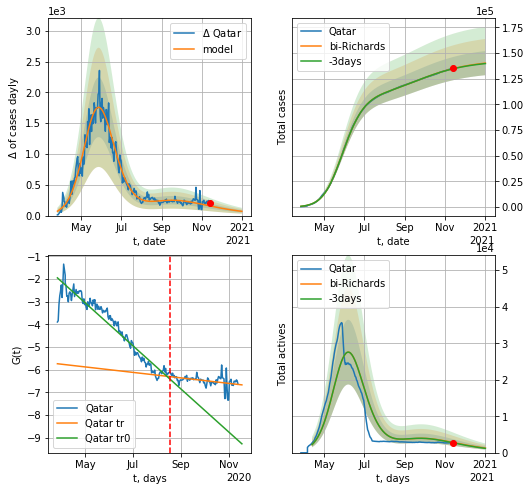

Qatar data at: 2020-11-14
+3 day model MAPE: 0.001310
model: bi-Richards
coeffs: [ 3.06168697e+04  1.82054808e+00 -3.60867715e+01  1.16635635e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.083808
forecast at the end of period: +49 days
	 deltaDaycases: 69
	 total cases: 140267 ± 11755
	 total death: 242 ± 60
bi-Richards approximation splitting point: 144
trend coefficient of determination: 0.918668
 intercept: -1.950312
 slope: -0.030893
trend coefficient of determination: 0.169333
 intercept: -5.739192
 slope: -0.003931


In [750]:
iL = 21
vL = 144 + iL
dfQR = read_df(pd.DataFrame(),"QR")
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Qatar',dfQR[iL:].fillna(0),d12f(1),40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [751]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date     cases  active  death
269 2020-11-10  144385.0    4166  518.0
270 2020-11-11  145599.0    4637  520.0
271 2020-11-12  146735.0    4997  523.0
272 2020-11-13  147961.0    5550  528.0
273 2020-11-14  149135.0    6046  528.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


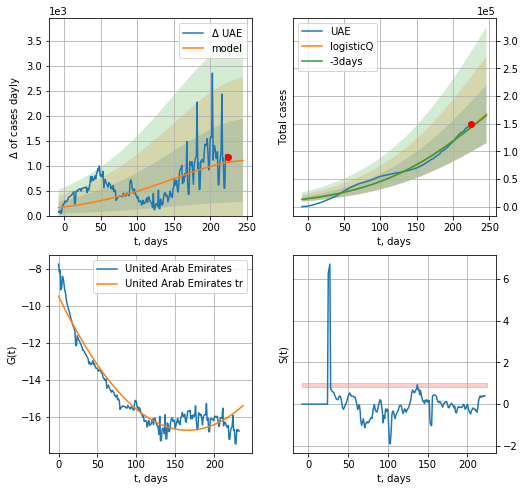

UAE data at: 2020-11-14
+3 day model MAPE: 0.009877
model: logisticQ
coeffs: [ 3.59994285e+05  1.23467448e-07  2.57792933e+02 -9.92486713e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313043
forecast at the end of period: +21 days
	 deltaDaycases: 1102
	 total cases: 167548 ± 52449
	 total death: 593 ± 556
trend coefficient of determination: 0.926750
 intercept_: -9.469026235469151
 coeffs_: [ 0.         -0.0874364   0.00026363]


In [752]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


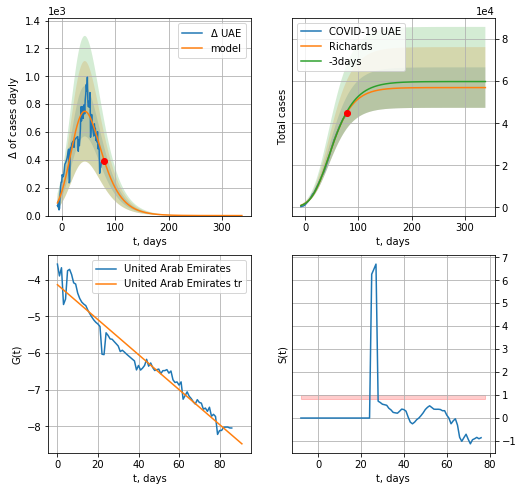

UAE data at: 2020-11-14
+3 day model MAPE: 0.009891
model: Richards
coeffs: [5.69575832e+04 1.33404785e-01 1.50634020e+01 3.08321872e-01]
rational stdev: 0.168958
forecast at the end of period: +259 days
	 deltaDaycases: 0
	 total cases: 56957 ± 9623
	 total death: 201 ± 101
trend coefficient of determination: 0.950927
 intercept: -4.139656
 slope: -0.047646
diffStd0a 0.9189486561289336


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


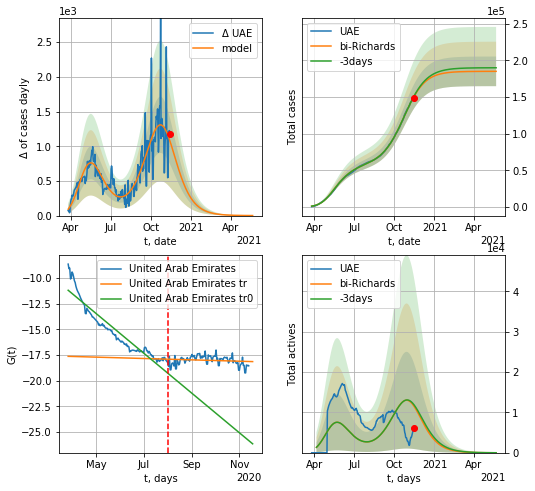

UAE data at: 2020-11-14
+3 day model MAPE: 0.003354
model: bi-Richards
coeffs: [1.28080720e+05 3.70264141e-02 2.06469468e+02 1.15174160e+00]
rational stdev: 0.109302
forecast at the end of period: +189 days
	 deltaDaycases: 0
	 total cases: 185022 ± 20223
	 total death: 655 ± 214
bi-Richards approximation splitting point: 128
trend coefficient of determination: 0.896615
 intercept: -11.192108
 slope: -0.063181
trend coefficient of determination: 0.021074
 intercept: -17.635757
 slope: -0.002161


In [753]:
iL = 40
vL = 128 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('UAE',dfUAE[iL:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [754]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

In [755]:
dfSA = read_df(pd.DataFrame(),"SA")
#x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

SA
           date     cases  active   death
252 2020-11-10  351455.0    7598  5576.0
253 2020-11-11  351849.0    7557  5590.0
254 2020-11-12  352160.0    7441  5605.0
255 2020-11-13  352601.0    7408  5625.0
256 2020-11-14  352950.0    7362  5641.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


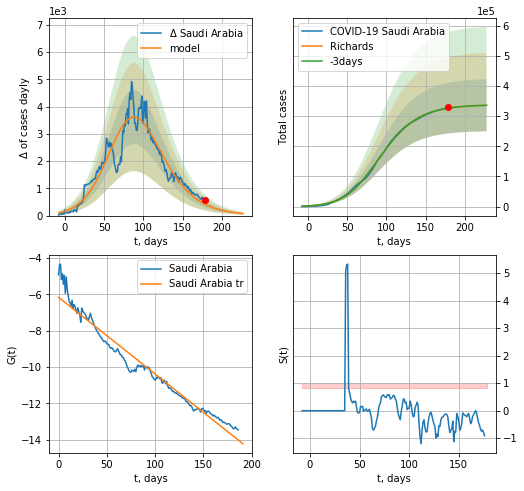

Saudi Arabia data at: 2020-11-14
+3 day model MAPE: 0.001288
model: Richards
coeffs: [3.38127321e+05 6.59352178e-02 7.28001513e+01 5.59722104e-01]
rational stdev: 0.257065
forecast at the end of period: +49 days
	 deltaDaycases: 73
	 total cases: 336170 ± 86417
	 total death: 5372 ± 4142
trend coefficient of determination: 0.960421
 intercept: -6.158396
 slope: -0.042260
diffStd0a 0.442080845447115


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


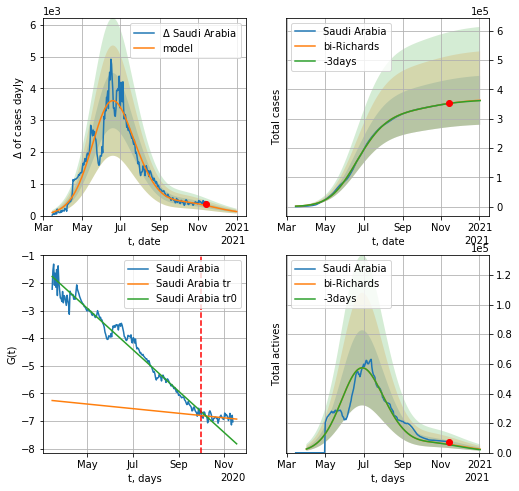

Saudi Arabia data at: 2020-11-14
+3 day model MAPE: 0.000884
model: bi-Richards
coeffs: [2.98467490e+04 3.05535153e+00 3.81612953e+01 8.60539824e-03]
rational stdev: 0.229919
forecast at the end of period: +49 days
	 deltaDaycases: 126
	 total cases: 362909 ± 83439
	 total death: 5800 ± 4000
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.970536
 intercept: -1.764021
 slope: -0.024450
trend coefficient of determination: 0.086769
 intercept: -6.258423
 slope: -0.002714


In [756]:
iL = 12
vL = 200 + iL
x = forecastRR('Saudi Arabia',dfSA[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Saudi Arabia',dfSA[iL:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [757]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    #x = forecastRRR('Sri Lanka',dfSri[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    #xx = forecast2RRR('Sri Lanka',dfSri[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

Sri
           date    cases  active  death
245 2020-11-10  14715.0    5137   41.0
246 2020-11-11  15350.0    5121   46.0
247 2020-11-12  15723.0    5022   48.0
248 2020-11-13  16191.0    5107   53.0
249 2020-11-14  16583.0    5206   53.0


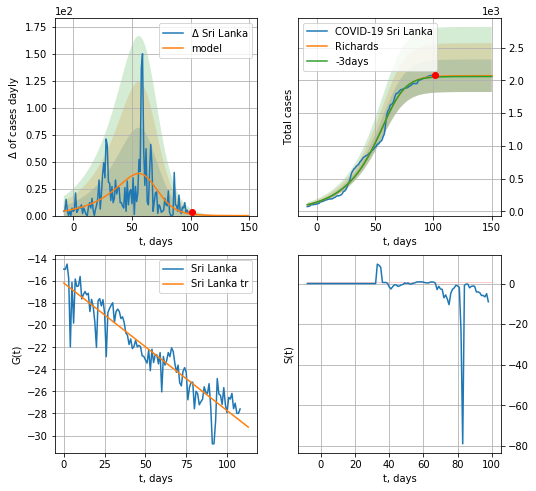

Sri Lanka data at: 2020-11-14
+3 day model MAPE: 0.004977
model: Richards
coeffs: [2.07051731e+03 4.15080701e-02 6.51914811e+01 2.75459097e+00]
rational stdev: 0.119919
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 2070 ± 248
	 total death: 6 ± 2
trend coefficient of determination: 0.877174
 intercept: -16.184142
 slope: -0.115477
diffStd0a 4.0900578549596895


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


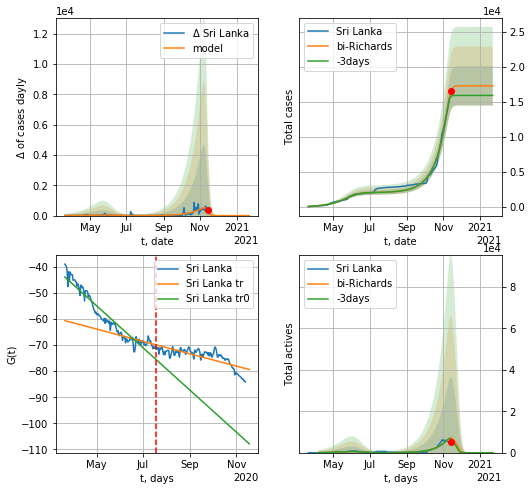

Sri Lanka data at: 2020-11-14
+3 day model MAPE: 0.055672
model: bi-Richards
coeffs: [1.51977164e+04 5.03770309e-02 2.29634267e+02 8.27439643e+00]
rational stdev: 0.162009
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 17268 ± 2797
	 total death: 55 ± 26
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.917599
 intercept: -43.852469
 slope: -0.263447
trend coefficient of determination: 0.588210
 intercept: -60.594234
 slope: -0.077227


In [758]:
vL=130#88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Sri Lanka',dfSri[10:],d1,43*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10,amc=0.5)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
257 2020-11-10  348184.0   21098  7021.0
258 2020-11-11  349992.0   22088  7055.0
259 2020-11-12  352296.0   23641  7092.0
260 2020-11-13  354461.0   24938  7109.0
261 2020-11-14  356904.0   26538  7141.0


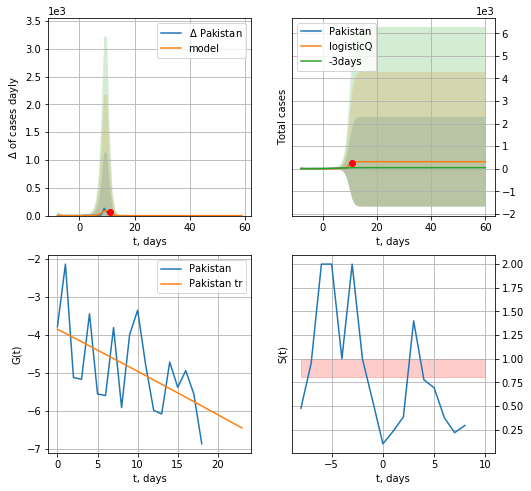

Pakistan data at: 2020-11-14
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


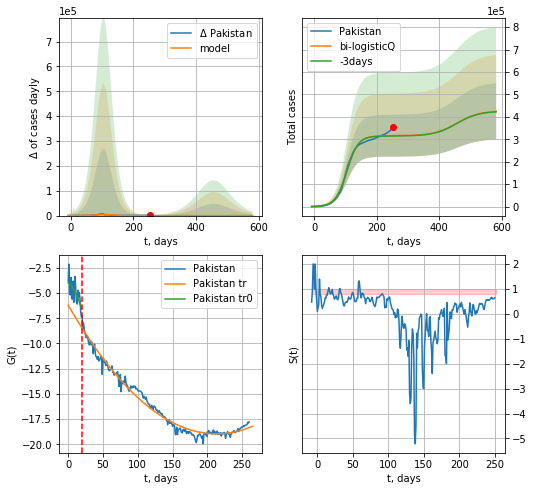

Pakistan data at: 2020-11-14
+3 day model MAPE: 0.004989
model: bi-logisticQ
coeffs: [ 3.15711693e+05  1.00249939e-07  1.04762899e+02 -5.48889359e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295845
forecast at the end of period: +329 days
	 deltaDaycases: 91
	 total cases: 424467 ± 125576
	 total death: 8492 ± 7536
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.981007
 intercept_: -6.200305903888921
 coeffs_: [ 0.         -0.11970759  0.00028085]


In [759]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


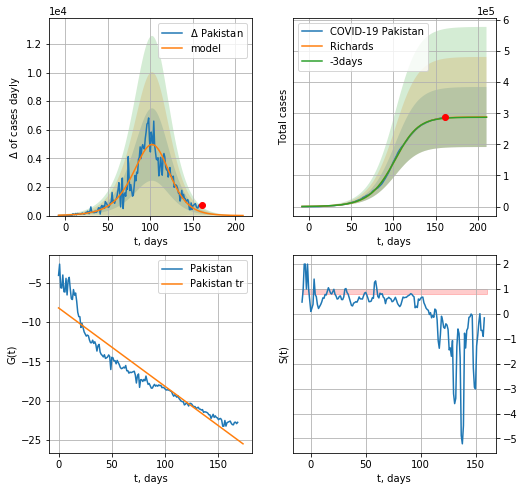

Pakistan data at: 2020-11-14
+3 day model MAPE: 0.002417
model: Richards
coeffs: [2.88169103e+05 5.68558279e-02 1.06265073e+02 1.33731169e+00]
rational stdev: 0.335042
forecast at the end of period: +49 days
	 deltaDaycases: 6
	 total cases: 288088 ± 96521
	 total death: 5764 ± 5793
trend coefficient of determination: 0.903657
 intercept: -8.180854
 slope: -0.100161
diffStd0a 0.17467248626568035


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


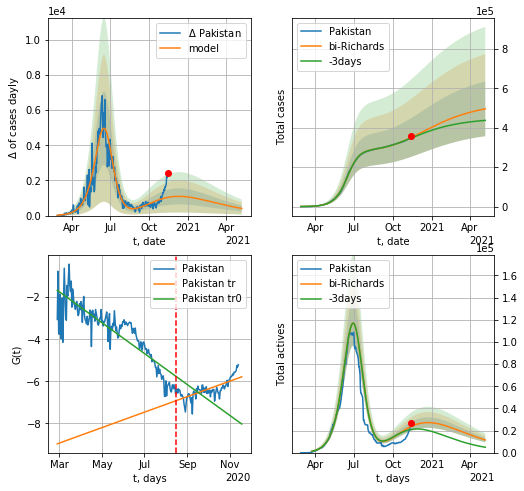

Pakistan data at: 2020-11-14
+3 day model MAPE: 0.008624
model: bi-Richards
coeffs: [ 2.42638014e+05  7.18869995e-01 -4.97014737e+01  1.72075025e-02]
rational stdev: 0.279560
forecast at the end of period: +175 days
	 deltaDaycases: 405
	 total cases: 495441 ± 138505
	 total death: 9912 ± 8312
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.755290
 intercept: -1.675821
 slope: -0.023963
trend coefficient of determination: 0.525492
 intercept: -8.964967
 slope: 0.012008


In [760]:
vL = 170#25
x = forecastRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Pakistan',dfPS[:],d12f(1),58*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
247 2020-11-10  423620.0   76096  6108.0
248 2020-11-11  425353.0   76095  6127.0
249 2020-11-12  427198.0   76190  6140.0
250 2020-11-13  428965.0   76419  6159.0
251 2020-11-14  430496.0   76474  6173.0


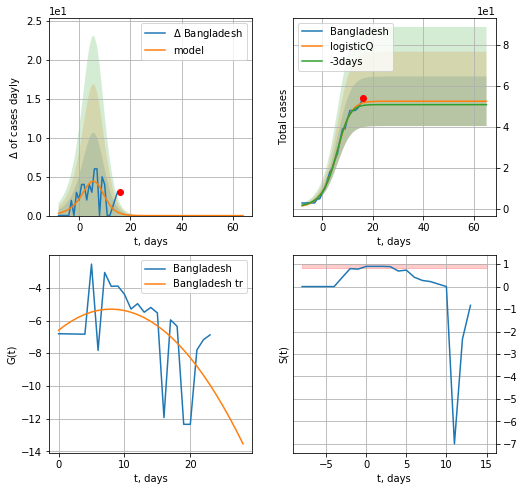

Bangladesh data at: 2020-11-14
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


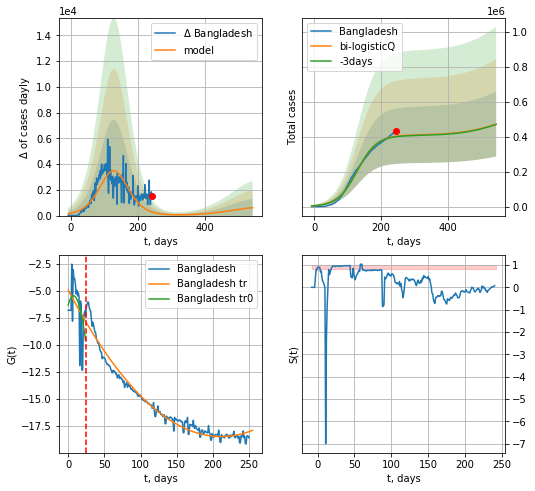

Bangladesh data at: 2020-11-14
+3 day model MAPE: 0.006926
model: bi-logisticQ
coeffs: [ 4.08983232e+05  7.04253687e-08  1.28558032e+02 -4.84069097e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392669
forecast at the end of period: +301 days
	 deltaDaycases: 608
	 total cases: 471381 ± 185096
	 total death: 6759 ± 7962
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.970611
 intercept_: -4.939895963646833
 coeffs_: [ 0.         -0.12820269  0.00030311]


In [761]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


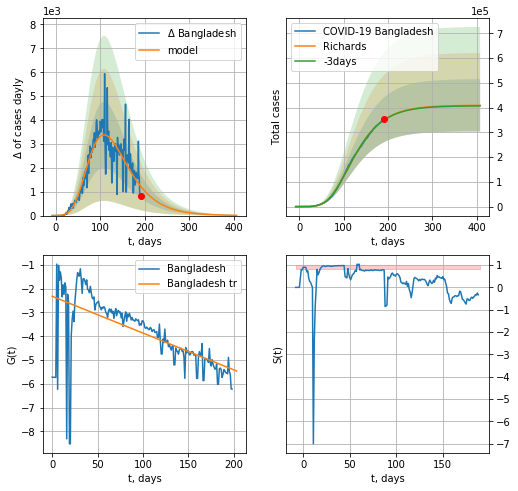

Bangladesh data at: 2020-11-14
+3 day model MAPE: 0.002602
model: Richards
coeffs: [ 4.09448499e+05  1.69324920e+00 -8.20191843e+01  1.33360757e-02]
rational stdev: 0.258135
forecast at the end of period: +217 days
	 deltaDaycases: 10
	 total cases: 408968 ± 105569
	 total death: 5864 ± 4541
trend coefficient of determination: 0.402732
 intercept: -2.317249
 slope: -0.015497
diffStd0a 0.28401899260032304


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


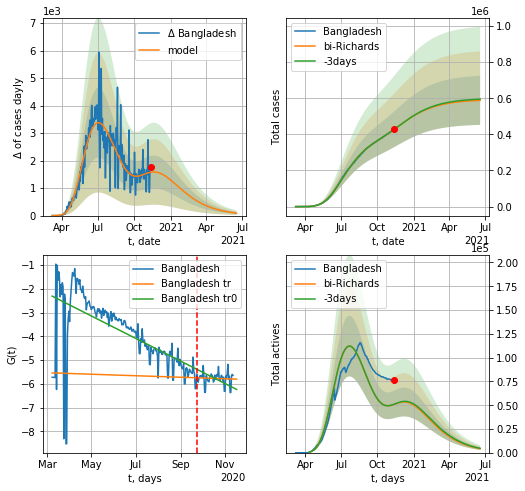

Bangladesh data at: 2020-11-14
+3 day model MAPE: 0.000379
model: bi-Richards
coeffs: [1.83431959e+05 1.58758171e+00 3.24087038e+01 1.19741232e-02]
rational stdev: 0.230454
forecast at the end of period: +217 days
	 deltaDaycases: 89
	 total cases: 588180 ± 135548
	 total death: 8434 ± 5830
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.404710
 intercept: -2.308563
 slope: -0.015459
trend coefficient of determination: 0.003287
 intercept: -5.538931
 slope: -0.001031


In [762]:
vL=200
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Bangladesh',dfBN[:-1],d1,64*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date     cases  active  death
260 2020-11-10  133381.0    8404  821.0
261 2020-11-11  134159.0    8428  826.0
262 2020-11-12  134932.0    8509  830.0
263 2020-11-13  135650.0    8473  833.0
264 2020-11-14  136341.0    8604  835.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


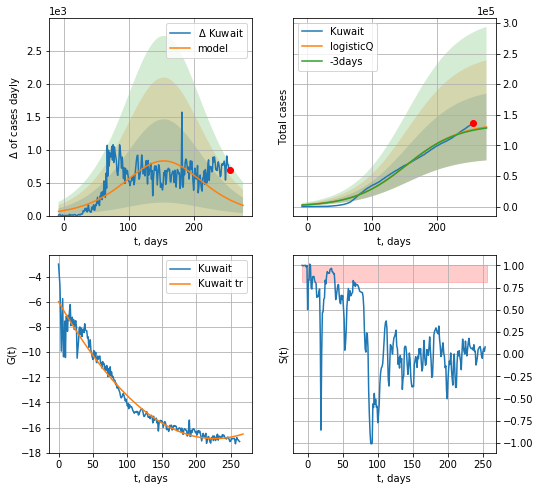

Kuwait data at: 2020-11-14
+3 day model MAPE: 0.011244
model: logisticQ
coeffs: [ 1.36735280e+05  4.66080863e-08  1.54330845e+02 -5.19755925e+05]
rational stdev: 0.419040
forecast at the end of period: +21 days
	 deltaDaycases: 155
	 total cases: 130083 ± 54510
	 total death: 796 ± 1000
trend coefficient of determination: 0.957654
 intercept_: -5.991395644706774
 coeffs_: [ 0.         -0.09598582  0.00021166]


In [763]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


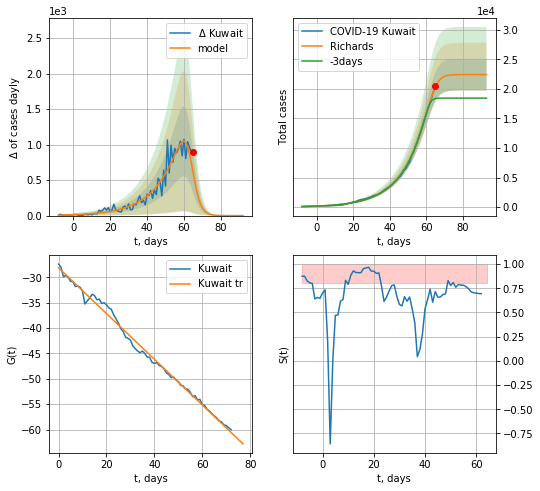

Kuwait data at: 2020-11-14
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 137 ± 49
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232
diffStd0a 0.2059603083477342


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


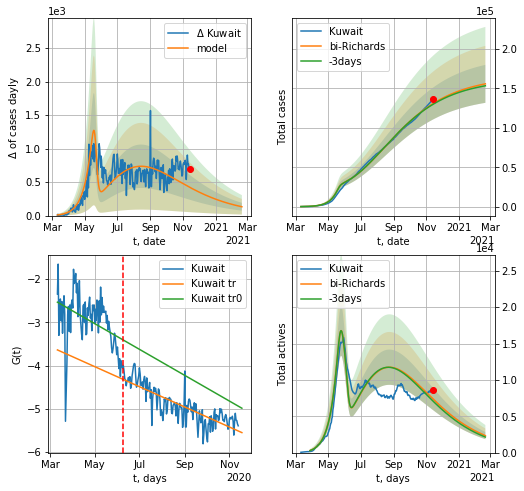

Kuwait data at: 2020-11-14
+3 day model MAPE: 0.007160
model: bi-Richards
coeffs: [ 1.42978641e+05  1.50194131e+00 -1.83399600e+02  9.36186093e-03]
rational stdev: 0.154552
forecast at the end of period: +98 days
	 deltaDaycases: 131
	 total cases: 155761 ± 24073
	 total death: 953 ± 441
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.167532
 intercept: -2.533596
 slope: -0.009742
trend coefficient of determination: 0.670607
 intercept: -3.638768
 slope: -0.007595


In [764]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Kuwait',dfKW[iL:],d1,47*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

DM
           date     cases  active   death
254 2020-11-10  131131.0   20097  2269.0
255 2020-11-11  131265.0   19936  2272.0
256 2020-11-12  131636.0   20227  2274.0
257 2020-11-13  132554.0   21006  2280.0
258 2020-11-14  133225.0   21353  2282.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


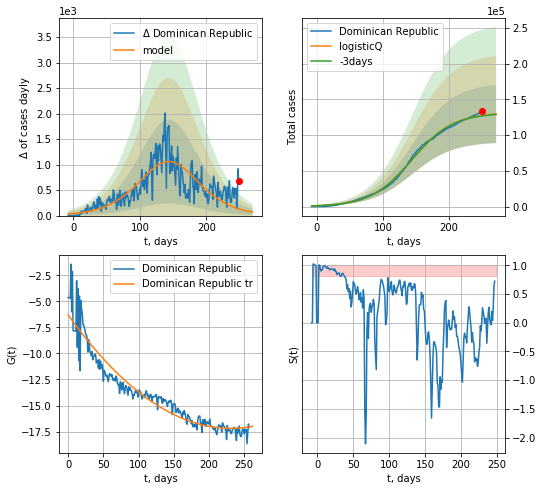

Dominican Republic data at: 2020-11-14
+3 day model MAPE: 0.004447
model: logisticQ
coeffs: [ 1.31616287e+05  2.42034043e-07  1.43917564e+02 -1.33131445e+05]
rational stdev: 0.313650
forecast at the end of period: +21 days
	 deltaDaycases: 69
	 total cases: 129477 ± 40610
	 total death: 2217 ± 2086
trend coefficient of determination: 0.911636
 intercept_: -6.309955862194024
 coeffs_: [ 0.         -0.09431435  0.00020441]


In [765]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


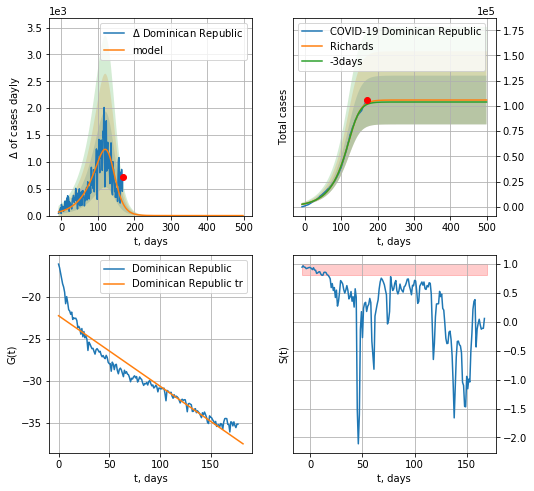

Dominican Republic data at: 2020-11-14
+3 day model MAPE: 0.011313
model: Richards
coeffs: [1.05835362e+05 2.63609615e-02 1.34410899e+02 2.61091122e+00]
rational stdev: 0.228213
forecast at the end of period: +329 days
	 deltaDaycases: 0
	 total cases: 105835 ± 24153
	 total death: 1812 ± 1240
trend coefficient of determination: 0.908946
 intercept: -22.261295
 slope: -0.083964
diffStd0a 0.24575743125034344


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


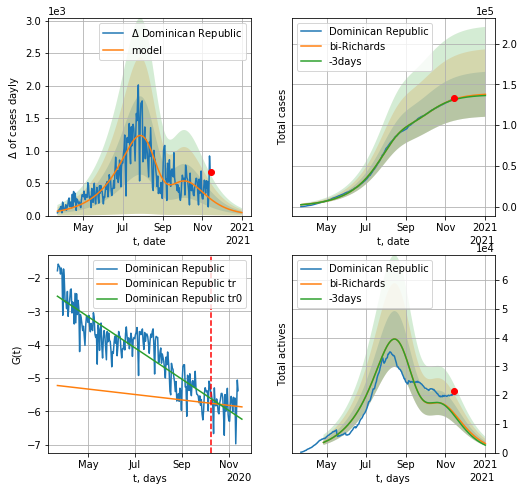

Dominican Republic data at: 2020-11-14
+3 day model MAPE: 0.004440
model: bi-Richards
coeffs: [3.31519257e+04 5.28266305e+00 6.95049119e+01 7.46767898e-03]
rational stdev: 0.199831
forecast at the end of period: +49 days
	 deltaDaycases: 46
	 total cases: 137817 ± 27540
	 total death: 2360 ± 1414
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.783804
 intercept: -2.544944
 slope: -0.015312
trend coefficient of determination: 0.004990
 intercept: -5.224802
 slope: -0.002662


In [766]:
vL = 200+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Dominican Republic',dfDM[21:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
248 2020-11-10  83592.0   16836  1930.0
249 2020-11-11  84707.0   16642  1950.0
250 2020-11-12  86038.0   16799  1969.0
251 2020-11-13  87361.0   16982  1987.0
252 2020-11-14  88772.0   17240  2006.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


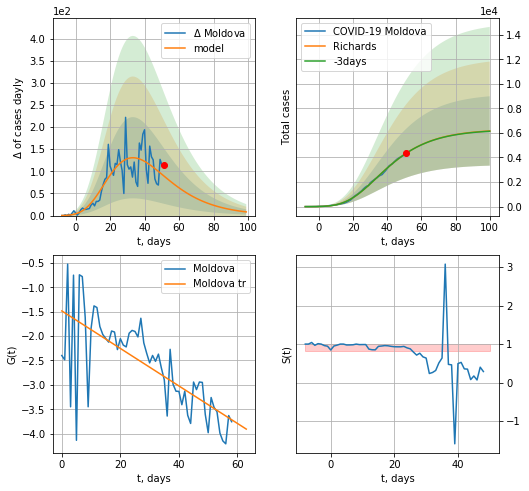

Moldova data at: 2020-11-14
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +49 days
	 deltaDaycases: 8
	 total cases: 6160 ± 2823
	 total death: 139 ± 191
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427
diffStd0a 0.20138610870563223


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


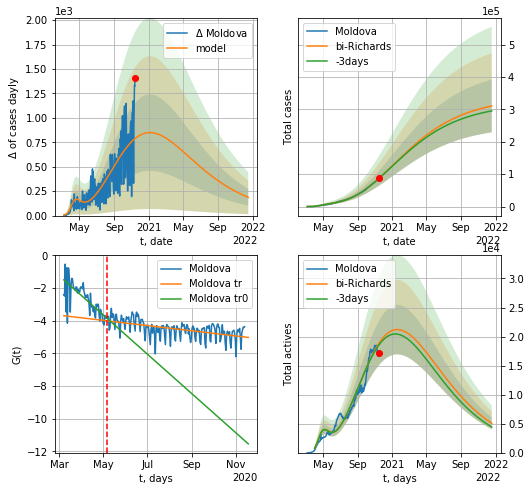

Moldova data at: 2020-11-14
+3 day model MAPE: 0.005148
model: bi-Richards
coeffs: [ 3.31995196e+05  3.54896049e-01 -2.62744327e+02  1.97887615e-02]
rational stdev: 0.261701
forecast at the end of period: +399 days
	 deltaDaycases: 186
	 total cases: 310568 ± 81276
	 total death: 7017 ± 5509
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.536070
 intercept: -1.497165
 slope: -0.039196
trend coefficient of determination: 0.298773
 intercept: -3.691950
 slope: -0.005184


In [767]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Moldova",dfMD[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
except:
    print("Exception occurs")

In [768]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
250 2020-11-10  740254.0   37109  19951.0
251 2020-11-11  742394.0   35925  20011.0
252 2020-11-12  744732.0   33753  20076.0
253 2020-11-13  746945.0   34615  20153.0
254 2020-11-14  749182.0   35715  20206.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


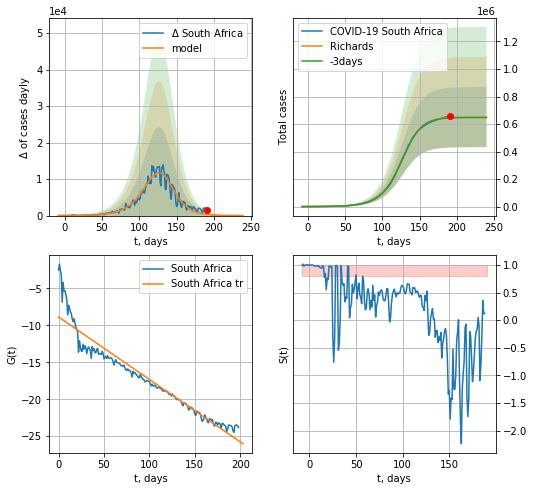

South Africa data at: 2020-11-14
+3 day model MAPE: 0.004049
model: Richards
coeffs: [6.50495420e+05 6.00130177e-02 1.30420741e+02 1.32516636e+00]
rational stdev: 0.335865
forecast at the end of period: +49 days
	 deltaDaycases: 6
	 total cases: 650414 ± 218451
	 total death: 17542 ± 17675
trend coefficient of determination: 0.917893
 intercept: -8.866953
 slope: -0.084547
diffStd0a 0.6342470140875933


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


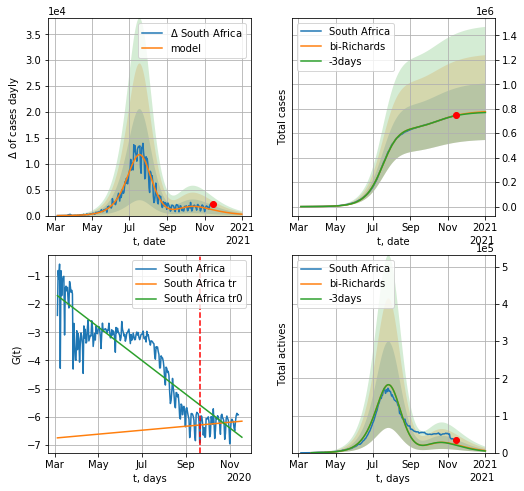

South Africa data at: 2020-11-14
+3 day model MAPE: 0.002771
model: bi-Richards
coeffs: [1.32433869e+05 4.12685546e+00 8.29511574e+01 8.65826422e-03]
rational stdev: 0.298047
forecast at the end of period: +49 days
	 deltaDaycases: 268
	 total cases: 775323 ± 231082
	 total death: 20911 ± 18697
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.701147
 intercept: -1.698251
 slope: -0.019504
trend coefficient of determination: 0.015876
 intercept: -6.753694
 slope: 0.002298


In [770]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 200#30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("South Africa",dfAF[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
except:
    print("Exception occurs")

UB
           date  cases  active  death
240 2020-11-10  69173    2151  589.0
241 2020-11-11  69397    2134  591.0
242 2020-11-12  69617    2138  593.0
243 2020-11-13  69830    2144  594.0
244 2020-11-14  70102    2189  598.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


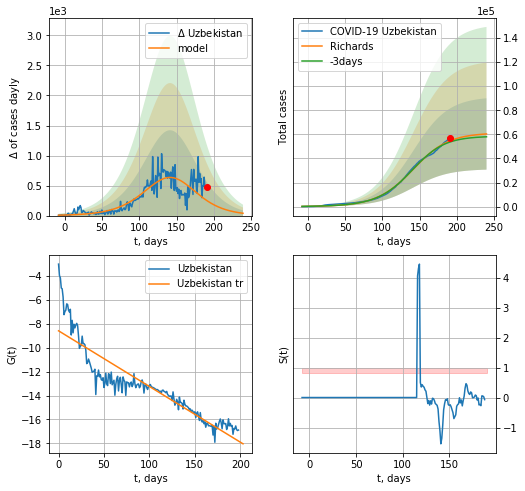

Uzbekistan data at: 2020-11-14
+3 day model MAPE: 0.018828
model: Richards
coeffs: [6.12494031e+04 3.87618713e-02 1.44107365e+02 1.10533721e+00]
rational stdev: 0.491066
forecast at the end of period: +49 days
	 deltaDaycases: 38
	 total cases: 60352 ± 29637
	 total death: 514 ± 757
trend coefficient of determination: 0.822556
 intercept: -8.575606
 slope: -0.046611
diffStd0a 0.5428928649090601


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


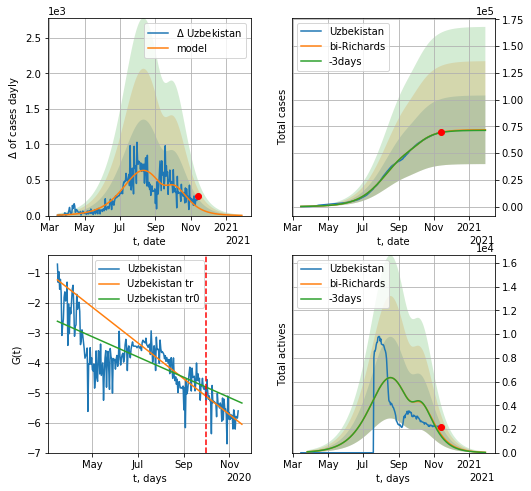

Uzbekistan data at: 2020-11-14
+3 day model MAPE: 0.003881
model: bi-Richards
coeffs: [1.05870761e+04 1.16344345e+01 1.08274912e+02 4.93157937e-03]
rational stdev: 0.446444
forecast at the end of period: +77 days
	 deltaDaycases: 2
	 total cases: 71779 ± 32045
	 total death: 612 ± 819
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.459567
 intercept: -2.612689
 slope: -0.011014
trend coefficient of determination: 0.356038
 intercept: -1.230300
 slope: -0.019450


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


In [772]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 200#45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Uzbekistan",dfUB[:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.33)
except:
    print("Exception occurs")

In [773]:
dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAFG['active'] = np.zeros(len(dfAFG))
#dfAFG.tail()

AFG
           date  cases  active   death
224 2020-11-10  42609  6061.0  1581.0
225 2020-11-11  42795  6180.0  1591.0
226 2020-11-12  42969  6338.0  1595.0
227 2020-11-13  43035  6367.0  1605.0
228 2020-11-14  43240  6531.0  1617.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


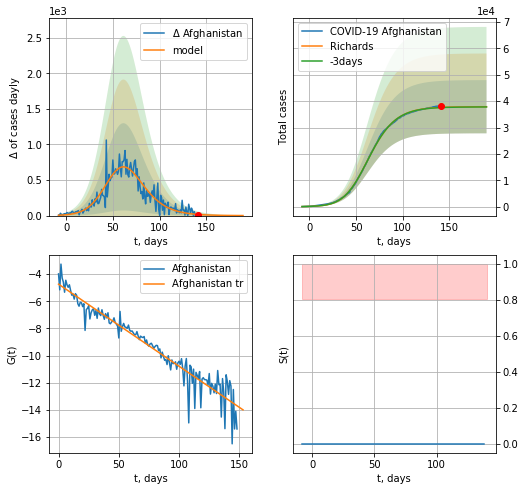

Afghanistan data at: 2020-11-14
+3 day model MAPE: 0.002095
model: Richards
coeffs: [3.79142308e+04 1.10640933e-01 5.26336374e+01 5.65351441e-01]
rational stdev: 0.266062
forecast at the end of period: +49 days
	 deltaDaycases: 0
	 total cases: 37901 ± 10084
	 total death: 1417 ± 1131
trend coefficient of determination: 0.920101
 intercept: -4.739385
 slope: -0.060561
diffStd0a 0.7152653813523909


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


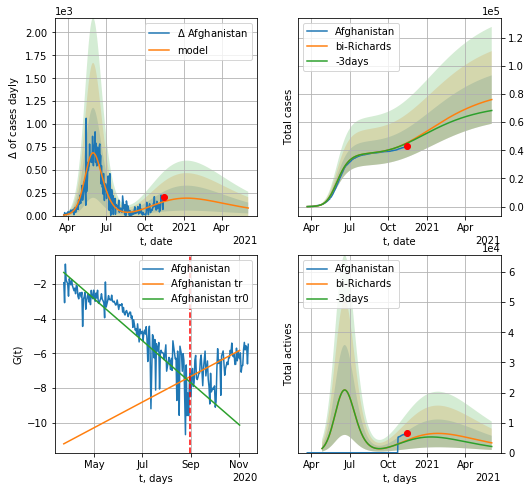

Afghanistan data at: 2020-11-14
+3 day model MAPE: 0.002475
model: bi-Richards
coeffs: [ 4.62075791e+04  9.64887525e-01 -1.11714798e+02  1.16907259e-02]
rational stdev: 0.226183
forecast at the end of period: +217 days
	 deltaDaycases: 82
	 total cases: 76059 ± 17203
	 total death: 2844 ± 1929
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.788766
 intercept: -1.352961
 slope: -0.039151
trend coefficient of determination: 0.296142
 intercept: -11.196893
 slope: 0.023967


In [774]:
#dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 150 + 8
    x = forecastRR("Afghanistan",dfAFG[8:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Afghanistan",dfAFG[8:],d1,64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8)
except:
    print("Exception occurs")

In [795]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [408]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707]


In [409]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"13,249,685","+6,404","376,284",645,"8,408,516","+4,361","4,464,885","24,370",,,,,,North America,\n,,
1,,\nAsia\n,"15,009,108","+9,821","264,937",149,"13,390,798","+19,108","1,353,373","24,514",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,325,074",112,"309,404",6,"9,311,461",323,"704,209","17,410",,,,,,South America,\n,,
3,,\nEurope\n,"13,772,573","+45,185","320,179",752,"5,123,229","+41,531","8,329,165","29,225",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,975,039",,"47,141",,"1,660,128",,"267,770","2,609",,,,,,Africa,\n,,
5,,\nOceania\n,"42,119",20,994,,"32,903",8,"8,222",26,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"54,374,319","+61,542","1,318,954","+1,552","37,927,694","+65,331","15,127,671","98,158","6,976",169.2,,,,All,\n,,
8,1,USA,"11,226,218",,"251,256",,"6,891,031",,"4,083,931","20,415","33,842",757,"166,751,484","502,676","331,727,464",North America,30,"1,320",2
9,2,India,"8,814,902",,"129,674",,"8,205,728","+1,991","479,500","8,944","6,364",94,"124,836,819","90,132","1,385,049,027",Asia,157,"10,681",11


In [410]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"13,249,685","+6,404","376,284",645,"8,408,516","+4,361","4,464,885","24,370",,,,,,North America,\n,,
1,,\nAsia\n,"15,009,108","+9,821","264,937",149,"13,390,798","+19,108","1,353,373","24,514",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,325,074",112,"309,404",6,"9,311,461",323,"704,209","17,410",,,,,,South America,\n,,
3,,\nEurope\n,"13,772,573","+45,185","320,179",752,"5,123,229","+41,531","8,329,165","29,225",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,975,039",,"47,141",,"1,660,128",,"267,770","2,609",,,,,,Africa,\n,,


In [411]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
95,88,Lithuania,"33,387",,266,,"7,697",,"25,424",87,"12,330",98,"1,176,612","434,523","2,707,822",Europe,81,"10,180",2
332,89,Lithuania,"33,387","+1,531",266,13,"7,697",450,"25,424",87,"12,330",98,"1,176,612","434,523","2,707,822",Europe,81,"10,180",2
568,89,Lithuania,"31,856","+2,044",253,9,"7,247",151,"24,356",87,"11,764",93,"1,162,033","429,139","2,707,822",Europe,85,"10,703",2


In [412]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

235


In [413]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"13,249,685","+6,404","376,284",645,"8,408,516","+4,361","4,464,885","24,370",,,,,,North America,\n,,
1,,\nAsia\n,"15,009,108","+9,821","264,937",149,"13,390,798","+19,108","1,353,373","24,514",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,325,074",112,"309,404",6,"9,311,461",323,"704,209","17,410",,,,,,South America,\n,,
3,,\nEurope\n,"13,772,573","+45,185","320,179",752,"5,123,229","+41,531","8,329,165","29,225",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,975,039",,"47,141",,"1,660,128",,"267,770","2,609",,,,,,Africa,\n,,
5,,\nOceania\n,"42,119",20,994,,"32,903",8,"8,222",26,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"54,374,319","+61,542","1,318,954","+1,552","37,927,694","+65,331","15,127,671","98,158","6,976",169.2,,,,All,\n,,
8,1,USA,"11,226,218",,"251,256",,"6,891,031",,"4,083,931","20,415","33,842",757,"166,751,484","502,676","331,727,464",North America,30,"1,320",2
9,2,India,"8,814,902",,"129,674",,"8,205,728","+1,991","479,500","8,944","6,364",94,"124,836,819","90,132","1,385,049,027",Asia,157,"10,681",11


In [414]:
df.at[14, 'TotalRecovered'] = 0
df.at[13, 'TotalRecovered'] = 0
df.at[30, 'TotalRecovered'] = 0
df.at[45, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[14,"ActiveCases"] = 0
df.at[13,"ActiveCases"] = 0
df.at[30,"ActiveCases"] = 0
df.at[45,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [415]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,13249685,6404.0,376284.0,645.0,8408516.0,"+4,361",4464885,24370.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,15009108,9821.0,264937.0,149.0,13390798.0,"+19,108",1353373,24514.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,10325074,112.0,309404.0,6.0,9311461.0,323,704209,17410.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1975039,NaN,47141.0,NaN,1660128.0,,267770,2609.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,42119,20.0,994.0,NaN,32903.0,8,8222,26.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,54374319,61542.0,1318954.0,1552.0,37927694.0,"+65,331",15127671,98158.0,6976.0,169.2,NaN,NaN,,All,\n,,
8,1,USA,11226218,NaN,251256.0,NaN,6891031.0,,4083931,20415.0,33842.0,757.0,166751484.0,502676.0,"331,727,464",North America,30,"1,320",2
9,2,India,8814902,NaN,129674.0,NaN,8205728.0,"+1,991",479500,8944.0,6364.0,94.0,124836819.0,90132.0,"1,385,049,027",Asia,157,"10,681",11


In [416]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
230,,Total:,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,,Europe,,,
231,,Total:,1975039,NaN,47141.0,NaN,1660128.0,,267770,2609.0,NaN,NaN,NaN,NaN,,Africa,,,
232,,Total:,42119,20.0,994.0,NaN,32903.0,,8222,26.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
233,,Total:,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,,,
234,NaN,European Union,9217952,11932.0,213626.0,305.0,2503179.0,NaN,4444102,24247.0,20702.844152,479.788329,132440132.0,297450.823381,NaN,Europe,NaN,NaN,NaN


In [417]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,13249685,6404.0,376284.0,645.0,8408516.0,"+4,361",4464885,24370.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,15009108,9821.0,264937.0,149.0,13390798.0,"+19,108",1353373,24514.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,10325074,112.0,309404.0,6.0,9311461.0,323,704209,17410.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1975039,NaN,47141.0,NaN,1660128.0,,267770,2609.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [418]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [419]:
#df

In [420]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,13249685,6404.0,376284.0,645.0,8408516.0,"+4,361",4464885,24370.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,15009108,9821.0,264937.0,149.0,13390798.0,"+19,108",1353373,24514.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,10325074,112.0,309404.0,6.0,9311461.0,323,704209,17410.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,13772573,45185.0,320179.0,752.0,5123229.0,"+41,531",8329165,29225.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1975039,NaN,47141.0,NaN,1660128.0,,267770,2609.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,42119,20.0,994.0,NaN,32903.0,8,8222,26.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,54374319,61542.0,1318954.0,1552.0,37927694.0,"+65,331",15127671,98158.0,6976.0,169.2,NaN,NaN,,All,\n,,
8,1,USA,11226218,NaN,251256.0,NaN,6891031.0,,4083931,20415.0,33842.0,757.0,166751484.0,502676.0,"331,727,464",North America,30,"1,320",2
9,2,India,8814902,NaN,129674.0,NaN,8205728.0,"+1,991",479500,8944.0,6364.0,94.0,124836819.0,90132.0,"1,385,049,027",Asia,157,"10,681",11
10,3,Brazil,5848959,NaN,165673.0,NaN,5291511.0,,391775,8318.0,27444.0,777.0,21900000.0,102758.0,"213,122,892",South America,36,"1,286",10


In [421]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [422]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB",
    "Afghanistan":"AFG"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB
Afghanistan AFG


In [423]:
len(countryDic)

77

In [424]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-11-14,13249685,4464885,376284.0
Asia
Asia
Asia 2020-11-14,15009108,1353373,264937.0
South America
South America
South America 2020-11-14,10325074,704209,309404.0
Europe
Europe
Europe 2020-11-14,13772573,8329165,320179.0
Africa
Africa
Africa 2020-11-14,1975039,267770,47141.0
Oceania
Oceania
Oceania 2020-11-14,42119,8222,994.0
World
World
World 2020-11-14,54374319,15127671,1318954.0
USA
USA
USA 2020-11-14,11226218,4083931,251256.0
India
India
India 2020-11-14,8814902,479500,129674.0
Brazil
Brazil
Brazil 2020-11-14,5848959,391775,165673.0
France
France
France 2020-11-14,1954599,1771213,44246.0
Russia
Russia
Russia 2020-11-14,1925825,452654,33186.0
Spain
Spain
Spain 2020-11-14,1492608,0,40769.0
UK
UK
UK 2020-11-14,1344356,0,51766.0
Argentina
Argentina
Argentina 2020-11-14,1304846,150173,35307.0
Colombia
Colombia
Colombia 2020-11-14,1191004,59599,33829.0
Italy
Italy
Italy 2020-11-14,1144552,688435,44683.0
Mexico
Mexico
Mexico 2020-11-14,1003253

Gibraltar 2020-11-14,887,144,1.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-11-14,720,19,6.0
Diamond Princess
Diamond Princess
Diamond Princess 2020-11-14,712,40,13.0
Saint Martin
Saint Martin
Saint Martin 2020-11-14,655,92,12.0
Burundi
Burundi
Burundi 2020-11-14,627,77,1.0
Taiwan
Taiwan
Taiwan 2020-11-14,602,59,7.0
Papua New Guinea
Papua New Guinea
Papua New Guinea 2020-11-14,600,7,7.0
Comoros
Comoros
Comoros 2020-11-14,579,23,7.0
Monaco
Monaco
Monaco 2020-11-14,545,97,2.0
Tanzania
Tanzania
Tanzania 2020-11-14,509,305,21.0
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-11-14,497,3,nan
Eritrea
Eritrea
Eritrea 2020-11-14,493,49,nan
Mauritius
Mauritius
Mauritius 2020-11-14,470,32,10.0
Mongolia
Mongolia
Mongolia 2020-11-14,428,100,nan
Bhutan
Bhutan
Bhutan 2020-11-14,375,22,nan
Isle of Man
Isle of Man
Isle of Man 2020-11-14,363,9,25.0
Cambodia
Cambodia
Cambodia 2020-11-14,302,13,nan
Cayman Islands
Cayman Islands
Cayman Islands 2020-11-14,254,13,1.0
Barbados
Barbados
Barbado

In [425]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [426]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-11-14,11226218,4083931,251256.0

append data/coronaIT.csv 2020-11-14,1144552,688435,44683.0

append data/coronaSP.csv 2020-11-14,1492608,0,40769.0

append data/coronaGR.csv 2020-11-14,788899,273980,12619.0

append data/coronaFR.csv 2020-11-14,1954599,1771213,44246.0

append data/coronaIN.csv 2020-11-14,749525,155744,41034.0

append data/coronaGB.csv 2020-11-14,1344356,0,51766.0

append data/coronaSZ.csv 2020-11-14,257135,112784,3351.0

append data/coronaKR.csv 2020-11-14,28546,2362,493.0

append data/coronaNG.csv 2020-11-14,28434,16277,294.0

append data/coronaSW.csv 2020-11-14,177355,0,6164.0

append data/coronaIS.csv 2020-11-14,323460,7916,2721.0

append data/coronaDK.csv 2020-11-14,61078,13547,757.0

append data/coronaPL.csv 2020-11-14,691118,386290,10045.0

append data/coronaES.csv 2020-11-14,7637,2815,81.0

append data/coronaUkr.csv 2020-11-14,535857,284810,9603.0

append data/coronaLV.csv 2020-11-14,10231,8595,121.0

append data/coronaLT.csv 2020-11-

In [427]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [428]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/data1/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 43035


In [582]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [583]:
dfc.tail()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
4,2020-11-04,4,11,2020,41814,4,Afghanistan,AF,AFG,38041757.0,Asia,3.782685
3,2020-11-05,5,11,2020,41935,6,Afghanistan,AF,AFG,38041757.0,Asia,3.745884
2,2020-11-06,6,11,2020,41975,0,Afghanistan,AF,AFG,38041757.0,Asia,3.546103
1,2020-11-07,7,11,2020,42033,2,Afghanistan,AF,AFG,38041757.0,Asia,3.538217
0,2020-11-08,8,11,2020,42159,6,Afghanistan,AF,AFG,38041757.0,Asia,3.656508


In [584]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [585]:
len(countriesEU)

27

In [586]:
dfc = pd.read_csv("data/europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('data/corona%s_new.csv'%("EU"), index=False)

Afghanistan 7862826


In [3589]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [3590]:
#dfD

In [3591]:
#dfAll[dfAll['Country'].isin(cLst)]

In [3592]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

825115267.0 106088.67349825139


In [3593]:
TT/7.7776e3

106088.67349825139

In [3594]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

257921.18232119546

In [3595]:
sum(dfp.Population)/1e6

16014.157998

In [3596]:
dfAll[dfAll.TotalTests>0]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
7,1.0,USA,9475788,1877.0,236501.0,30.0,6104417.0,812,3134870,17205.0,28571.00000,713.000000,145042416.0,437324.000000,"331,658,650",North America,35,"1,402",2
8,2.0,India,8230711,1389.0,122651.0,9.0,7544798.0,"+1,893",563262,8944.0,5945.00000,89.000000,110743103.0,79984.000000,"1,384,567,503",Asia,168,"11,289",13
9,3.0,Brazil,5545705,0.0,160104.0,0.0,4980942.0,0,404659,8318.0,26028.00000,751.000000,21900000.0,102783.000000,"213,069,306",South America,38,"1,331",10
10,4.0,Russia,1655038,18257.0,28473.0,238.0,1236033.0,"+10,360",390532,2300.0,11339.00000,195.000000,61541970.0,421648.000000,"145,955,748",Europe,88,"5,126",2
11,5.0,France,1413915,0.0,37019.0,0.0,118227.0,0,1258669,3578.0,21645.00000,567.000000,16303968.0,249592.000000,"65,322,540",Europe,46,"1,765",4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,212.0,Solomon Islands,13,5.0,0.0,0.0,4.0,0,9,0.0,19.00000,0.000000,115.0,166.000000,"692,441",Australia/Oceania,"53,265",0,"6,021"
221,215.0,Anguilla,3,0.0,0.0,0.0,3.0,0,0,0.0,199.00000,0.000000,1329.0,88317.000000,"15,048",North America,"5,016",0,11
223,217.0,Wallis and Futuna,1,0.0,0.0,0.0,1.0,0,0,0.0,90.00000,0.000000,1046.0,93635.000000,"11,171",Australia/Oceania,"11,171",0,11
224,218.0,China,86021,24.0,4634.0,0.0,81024.0,20,363,12.0,60.00000,3.000000,160000000.0,111163.000000,"1,439,323,776",Asia,"16,732","310,601",9


In [3597]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [3598]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [3599]:
#cDicEU["Ireland"][1]

In [3600]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

257921.18232119546

In [3601]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [3602]:
#dfAll

In [3603]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

112540.02452969245

In [3604]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [3605]:
len(CList)

73

In [3606]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5610505190

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400